In [2]:
import numpy as np
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense,Reshape,Conv2D,Conv2DTranspose,LeakyReLU,BatchNormalization,Dropout,Flatten
import matplotlib.pyplot as plt
import cv2
import glob
from numpy import expand_dims
from numpy import zeros
from numpy import ones
from numpy import vstack
from numpy.random import randn
from numpy.random import randint

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# import dataset

In [22]:
X_data = []
Y_data = []

path = "/content/drive/MyDrive/Colab Notebooks/Dataset/Class "
for i in range(5):
  files = glob.glob(path + str(i+1) + "/*.png")
  for myFile in files:
    image = cv2.imread(myFile,0)
    reshapeimg = cv2.resize(image, dsize=(64, 64))
    # gry to rgb for create 3 channel
    finalimg = cv2.cvtColor(reshapeimg, cv2.COLOR_GRAY2BGR)
    X_data.append (finalimg)
    Y_data.append (i+1)

X_data = np.array(X_data)
Y_data = np.array(Y_data)

print('X_data shape:', X_data.shape)
print('Y_data shape:', Y_data.shape)

X_data shape: (1005, 64, 64, 3)
Y_data shape: (1005,)


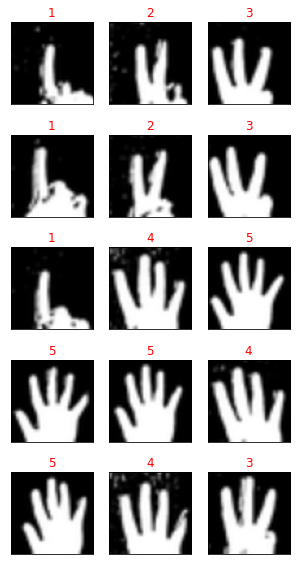

In [ ]:
fig = plt.figure(figsize=(5, 10))
for i in range(15):
  ax = fig. add_subplot(5, 3, i+1, xticks=[], yticks=[])
  j = np.random.randint(0,len(X_data))
  ax.imshow(X_data[j], cmap='gray', vmin=0, vmax=255)
  ax.set_title("{}".format(Y_data[j]), color=("red"))

#create model

In [18]:
# define the standalone discriminator model
def define_discriminator(in_shape=(64,64,3)):
  model = Sequential()
  # normal
  model.add(Conv2D(3, (5,5), strides=(2,2), padding='same', input_shape=in_shape))
  model.add(LeakyReLU())
  #model.add(BatchNormalization())
	# downsample
  model.add(Conv2D(128, (5,5), strides=(2,2), padding='same'))
  model.add(LeakyReLU())
  #model.add(BatchNormalization())
  # downsample
  model.add(Conv2D(256, (5,5), strides=(2,2), padding='same'))
  model.add(LeakyReLU())
  #model.add(BatchNormalization())
  # downsample
  model.add(Conv2D(512, (5,5), strides=(2,2), padding='same'))
  model.add(LeakyReLU())
  #model.add(BatchNormalization())
  # downsample
  model.add(Conv2D(1024, (5,5), strides=(2,2), padding='same'))
  model.add(LeakyReLU())
  #model.add(BatchNormalization())
  # classifier
  model.add(Flatten())
  #model.add(Dropout(0.4))
  model.add(Dense(1, activation='sigmoid'))
  # compile model
  opt = Adam(learning_rate=0.001, beta_1=0.5)
  model.compile(loss='binary_crossentropy', optimizer=opt, metrics=['accuracy'])
  return model

# define the standalone generator model
def define_generator(latent_dim):
  model = Sequential()
  # foundation for 4x4 image
  n_nodes = 1024 * 4 * 4
  model.add(Dense(n_nodes, input_dim=latent_dim))
  model.add(Reshape((4, 4, 1024)))
  # upsample to 8x8
  model.add(Conv2DTranspose(512, (5,5), strides=(2,2), activation='relu', padding='same'))
  #model.add(BatchNormalization())
  # upsample to 16x16
  model.add(Conv2DTranspose(256, (5,5), strides=(2,2), activation='relu', padding='same'))
  #model.add(BatchNormalization())
  # upsample to 32x32
  model.add(Conv2DTranspose(128, (5,5), strides=(2,2), activation='relu', padding='same'))
  #model.add(BatchNormalization())
  # upsample to 64x64
  model.add(Conv2DTranspose(3, (5,5), strides=(2,2), activation='relu', padding='same'))
  #model.add(BatchNormalization())
  # output layer
  model.add(Conv2D(3, (5,5), activation='tanh', padding='same'))
  #model.add(BatchNormalization())
  return model

# define the combined generator and discriminator model, for updating the generator
def define_gan(g_model, d_model):
	# make weights in the discriminator not trainable
	d_model.trainable = False
	# connect them
	model = Sequential()
	# add generator
	model.add(g_model)
	# add the discriminator
	model.add(d_model)
	# compile model
	opt = Adam(learning_rate=0.0002, beta_1=0.5)
	model.compile(loss='binary_crossentropy', optimizer=opt)
	return model

# load and prepare  images
def load_real_samples():
	# load dataset
	# convert from unsigned ints to floats
	X = X_data.astype('float32')
	# scale from [0,255] to [0,1]
	X = X / 255
	return X

# select real samples
def generate_real_samples(dataset, n_samples):
	# choose random instances
	ix = randint(0, dataset.shape[0], n_samples)
	# retrieve selected images
	X = dataset[ix]
	# generate 'real' class labels (1)
	y = np.ones((n_samples, 1))#*0.9		# One sided label smoothing
	return X, y

# generate points in latent space as input for the generator
def generate_latent_points(latent_dim, n_samples):
	# generate points in the latent space
	x_input = randn(latent_dim * n_samples)
	# reshape into a batch of inputs for the network
	x_input = x_input.reshape(n_samples, latent_dim)
	return x_input

# use the generator to generate n fake examples, with class labels
def generate_fake_samples(g_model, latent_dim, n_samples):
	# generate points in latent space
	x_input = generate_latent_points(latent_dim, n_samples)
	# predict outputs
	X = g_model.predict(x_input)
	# create 'fake' class labels (0)
	y = zeros((n_samples, 1))#*0.9   # One sided lable smoothing
	return X, y

# create and save a plot of generated images
def save_plot(examples, epoch, n= 4):
    
    examples = (examples + 1) / 2.0
    plt.figure(figsize=(10,10))
    
    for i in range (n*n):
        
        plt.subplot(n, n, 1+i)
        plt.axis('off')
        plt.imshow(examples[i])
        
    filename = 'generated_plot_e%03d.png' % (epoch+1)
    plt.savefig(filename)

# evaluate the discriminator, plot generated images, save generator model
accuracy_real = []
accuracy_fake = []
def summarize_performance(epoch, g_model, d_model, dataset, latent_dim, n_samples=100):
	  
    # prepare real samples
    X_real, y_real = generate_real_samples(dataset, n_samples)
    # evaluate discriminator on real samples
    _, acc_real = d_model.evaluate(X_real, y_real, verbose=0)
    # prepare fake samples
    x_fake, y_fake = generate_fake_samples(g_model, latent_dim, n_samples)
    # evaluate discriminator on fake examples
    _, acc_fake = d_model.evaluate(x_fake, y_fake, verbose=0)
    # summarize discriminator performance
    print('>Accuracy real: %.0f%%, fake: %.0f%%' %(acc_real*100, acc_fake*100))
    # save plot
    save_plot(x_fake, epoch)
    # save the generator model tile file
    filename= 'generator_model_%03d.h5' % (epoch+1)
    g_model.save(filename)
    
    accuracy_real.append(acc_real)
    accuracy_fake.append(acc_fake)
    
    return accuracy_real, accuracy_fake 
    

# train the generator and discriminator
def train(g_model, d_model, gan_model, dataset, latent_dim, n_epochs=200, n_batch=64):
    
    d_loss_total = np.zeros(n_epochs)
    g_loss_total  = np.zeros(n_epochs)
    d_loss        = 0
    
    bat_per_epo = int(dataset.shape[0]/ n_batch)
    half_batch = int(n_batch / 2)
    # manually enumerate epochs
    for i in range (n_epochs):
        # enumerate batches over the training set
        
        g_loss_sum    = 0
        d_loss_sum    = 0
        
        for j in range(bat_per_epo):                        
            # get randomly selected 'real' samples
            X_real, y_real = generate_real_samples(dataset,half_batch)
            # update discriminator model weights
            d_loss1, _ = d_model.train_on_batch(X_real,y_real)
            # generate 'fake' examples
            X_fake, y_fake = generate_fake_samples(g_model, latent_dim, half_batch)
            # update discriminator model weights
            d_loss2, _ = d_model.train_on_batch(X_fake,y_fake)
            # prepare points in latent space as input for the generator
            X_gan = generate_latent_points(latent_dim, n_batch)
            # create inverted labels for the fake samples
            y_gan = ones((n_batch, 1))
            # update the generator via the discriminator's error
            g_loss = gan_model.train_on_batch(X_gan, y_gan)
            # summarize loss on this batch
            print('>%d, %d/%d, d1=%.5f, d2=%.5f, g=%.5f' %
                  (i+1, j+1, bat_per_epo, d_loss1, d_loss2, g_loss))
            
            # Total Discriminator Loss = Real data loss + Fake data loss
            d_loss      = 0.5*(d_loss1 + d_loss2)
            d_loss_sum  = d_loss_sum + d_loss
            g_loss_sum  = g_loss_sum + g_loss
            
        d_loss_total[i] = d_loss_sum
        g_loss_total[i]  = g_loss_sum
        
        # evaluate the model performance, sometimes
        if (i+1) % 1 == 0:
            accuracy_real, accuracy_fake = summarize_performance(i, g_model, d_model, dataset, latent_dim)
    
    return d_loss_total, g_loss_total, accuracy_real, accuracy_fake



/usr/local/lib/python3.8/dist-packages/keras/optimizers/optimizer_v2/adam.py:110: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(Adam, self).__init__(name, **kwargs)


1/1 [==============================] - 0s 78ms/step
>1, 1/15, d1=0.68751, d2=0.69534, g=0.69196
1/1 [==============================] - 0s 12ms/step
>1, 2/15, d1=0.59515, d2=0.69758, g=0.68964
1/1 [==============================] - 0s 12ms/step
>1, 3/15, d1=0.49063, d2=0.70374, g=0.68307
1/1 [==============================] - 0s 12ms/step
>1, 4/15, d1=0.36510, d2=0.72009, g=0.66676
1/1 [==============================] - 0s 12ms/step
>1, 5/15, d1=0.24154, d2=0.76279, g=0.63154
1/1 [==============================] - 0s 15ms/step
>1, 6/15, d1=0.13319, d2=0.84088, g=0.57908
1/1 [==============================] - 0s 12ms/step
>1, 7/15, d1=0.07388, d2=0.96417, g=0.54029
1/1 [==============================] - 0s 12ms/step
>1, 8/15, d1=0.11195, d2=1.02400, g=0.54181
1/1 [==============================] - 0s 15ms/step
>1, 9/15, d1=0.14064, d2=0.97435, g=0.62317
1/1 [==============================] - 0s 13ms/step
>1, 10/15, d1=0.20600, d2=0.80027, g=0.79965
1/1 [==============================] - 

1/1 [==============================] - 0s 14ms/step
>2, 1/15, d1=0.04823, d2=0.69361, g=0.71915
1/1 [==============================] - 0s 17ms/step
>2, 2/15, d1=0.04235, d2=0.72262, g=0.67639
1/1 [==============================] - 0s 14ms/step
>2, 3/15, d1=0.02217, d2=0.74486, g=0.65549
1/1 [==============================] - 0s 13ms/step
>2, 4/15, d1=0.01995, d2=0.75730, g=0.64683
1/1 [==============================] - 0s 12ms/step
>2, 5/15, d1=0.02157, d2=0.77109, g=0.63642
1/1 [==============================] - 0s 11ms/step
>2, 6/15, d1=0.01608, d2=0.80169, g=0.62807
1/1 [==============================] - 0s 13ms/step
>2, 7/15, d1=0.02175, d2=0.81913, g=0.63703
1/1 [==============================] - 0s 11ms/step
>2, 8/15, d1=0.03958, d2=0.80603, g=0.66707
1/1 [==============================] - 0s 12ms/step
>2, 9/15, d1=0.07546, d2=0.80308, g=0.69403
1/1 [==============================] - 0s 12ms/step
>2, 10/15, d1=0.08323, d2=0.76764, g=0.70119
1/1 [==============================] - 

1/1 [==============================] - 0s 13ms/step
>3, 1/15, d1=0.10886, d2=0.63193, g=0.86853
1/1 [==============================] - 0s 11ms/step
>3, 2/15, d1=0.09632, d2=0.62011, g=0.89583
1/1 [==============================] - 0s 14ms/step
>3, 3/15, d1=0.11393, d2=0.64165, g=0.89289
1/1 [==============================] - 0s 12ms/step
>3, 4/15, d1=0.08709, d2=0.58606, g=0.99105
1/1 [==============================] - 0s 12ms/step
>3, 5/15, d1=0.12689, d2=0.54539, g=1.01659
1/1 [==============================] - 0s 14ms/step
>3, 6/15, d1=0.08453, d2=0.53922, g=1.11602
1/1 [==============================] - 0s 15ms/step
>3, 7/15, d1=0.08923, d2=0.50491, g=1.18779
1/1 [==============================] - 0s 12ms/step
>3, 8/15, d1=0.07379, d2=0.47702, g=1.30115
1/1 [==============================] - 0s 12ms/step
>3, 9/15, d1=0.07815, d2=0.42295, g=1.31227
1/1 [==============================] - 0s 12ms/step
>3, 10/15, d1=0.08342, d2=0.54639, g=1.84734
1/1 [==============================] - 

1/1 [==============================] - 0s 14ms/step
>4, 1/15, d1=0.08903, d2=0.30334, g=1.43283
1/1 [==============================] - 0s 14ms/step
>4, 2/15, d1=0.06831, d2=0.31420, g=1.47797
1/1 [==============================] - 0s 15ms/step
>4, 3/15, d1=0.09493, d2=0.36761, g=1.55532
1/1 [==============================] - 0s 15ms/step
>4, 4/15, d1=0.15685, d2=0.34141, g=1.66741
1/1 [==============================] - 0s 15ms/step
>4, 5/15, d1=0.13896, d2=0.32733, g=1.81628
1/1 [==============================] - 0s 14ms/step
>4, 6/15, d1=0.18570, d2=0.35857, g=1.69855
1/1 [==============================] - 0s 14ms/step
>4, 7/15, d1=0.15016, d2=0.38870, g=1.92759
1/1 [==============================] - 0s 14ms/step
>4, 8/15, d1=0.29044, d2=0.39515, g=2.34893
1/1 [==============================] - 0s 17ms/step
>4, 9/15, d1=0.59530, d2=0.41029, g=1.47718
1/1 [==============================] - 0s 14ms/step
>4, 10/15, d1=0.18368, d2=0.87851, g=2.97491
1/1 [==============================] - 

1/1 [==============================] - 0s 17ms/step
>5, 1/15, d1=0.34455, d2=0.61487, g=2.92127
1/1 [==============================] - 0s 12ms/step
>5, 2/15, d1=0.84926, d2=0.42988, g=1.69586
1/1 [==============================] - 0s 12ms/step
>5, 3/15, d1=0.18713, d2=0.45044, g=2.80341
1/1 [==============================] - 0s 14ms/step
>5, 4/15, d1=0.43098, d2=0.23352, g=2.58804
1/1 [==============================] - 0s 14ms/step
>5, 5/15, d1=0.39375, d2=0.33232, g=2.37208
1/1 [==============================] - 0s 14ms/step
>5, 6/15, d1=0.10396, d2=0.21526, g=2.87423
1/1 [==============================] - 0s 14ms/step
>5, 7/15, d1=0.22293, d2=0.25571, g=3.15193
1/1 [==============================] - 0s 15ms/step
>5, 8/15, d1=0.31562, d2=0.64579, g=3.16954
1/1 [==============================] - 0s 14ms/step
>5, 9/15, d1=0.66015, d2=0.35445, g=2.30605
1/1 [==============================] - 0s 16ms/step
>5, 10/15, d1=0.52623, d2=0.75169, g=2.48733
1/1 [==============================] - 

1/1 [==============================] - 0s 13ms/step
>6, 1/15, d1=0.25485, d2=0.54615, g=1.92069
1/1 [==============================] - 0s 43ms/step
>6, 2/15, d1=0.31843, d2=0.39416, g=1.85836
1/1 [==============================] - 0s 53ms/step
>6, 3/15, d1=0.51318, d2=0.69191, g=2.57451
1/1 [==============================] - 0s 13ms/step
>6, 4/15, d1=0.76344, d2=0.24934, g=2.17326
1/1 [==============================] - 0s 15ms/step
>6, 5/15, d1=0.47988, d2=0.48401, g=1.83339
1/1 [==============================] - 0s 15ms/step
>6, 6/15, d1=0.30597, d2=0.33141, g=2.17761
1/1 [==============================] - 0s 13ms/step
>6, 7/15, d1=0.48980, d2=0.29818, g=2.06646
1/1 [==============================] - 0s 12ms/step
>6, 8/15, d1=0.39211, d2=0.36711, g=2.22843
1/1 [==============================] - 0s 15ms/step
>6, 9/15, d1=0.36952, d2=0.28500, g=2.36920
1/1 [==============================] - 0s 48ms/step
>6, 10/15, d1=0.50411, d2=0.24126, g=2.63005
1/1 [==============================] - 

1/1 [==============================] - 0s 15ms/step
>7, 1/15, d1=0.41315, d2=0.24600, g=2.01093
1/1 [==============================] - 0s 18ms/step
>7, 2/15, d1=0.33142, d2=0.27485, g=2.17215
1/1 [==============================] - 0s 11ms/step
>7, 3/15, d1=0.31296, d2=0.26440, g=2.07038
1/1 [==============================] - 0s 14ms/step
>7, 4/15, d1=0.48357, d2=0.41142, g=2.10663
1/1 [==============================] - 0s 16ms/step
>7, 5/15, d1=0.42167, d2=0.25938, g=2.12544
1/1 [==============================] - 0s 16ms/step
>7, 6/15, d1=0.28942, d2=0.32439, g=2.31340
1/1 [==============================] - 0s 12ms/step
>7, 7/15, d1=0.55713, d2=0.33517, g=2.23000
1/1 [==============================] - 0s 12ms/step
>7, 8/15, d1=0.27803, d2=0.18003, g=2.55243
1/1 [==============================] - 0s 12ms/step
>7, 9/15, d1=0.49145, d2=0.32317, g=2.15406
1/1 [==============================] - 0s 13ms/step
>7, 10/15, d1=0.18201, d2=0.21992, g=2.85597
1/1 [==============================] - 

1/1 [==============================] - 0s 16ms/step
>8, 1/15, d1=0.24757, d2=0.10720, g=2.60780
1/1 [==============================] - 0s 12ms/step
>8, 2/15, d1=0.17073, d2=0.25973, g=2.64362
1/1 [==============================] - 0s 16ms/step
>8, 3/15, d1=0.20489, d2=0.17404, g=2.78709
1/1 [==============================] - 0s 12ms/step
>8, 4/15, d1=0.07768, d2=0.24938, g=3.45309
1/1 [==============================] - 0s 14ms/step
>8, 5/15, d1=0.38579, d2=0.16717, g=2.79384
1/1 [==============================] - 0s 13ms/step
>8, 6/15, d1=0.34892, d2=0.57366, g=2.96906
1/1 [==============================] - 0s 12ms/step
>8, 7/15, d1=0.71022, d2=1.25982, g=3.04641
1/1 [==============================] - 0s 14ms/step
>8, 8/15, d1=0.47596, d2=0.23701, g=4.84531
1/1 [==============================] - 0s 12ms/step
>8, 9/15, d1=1.31493, d2=0.42109, g=2.16409
1/1 [==============================] - 0s 13ms/step
>8, 10/15, d1=0.38688, d2=0.31196, g=3.18798
1/1 [==============================] - 

1/1 [==============================] - 0s 14ms/step
>9, 1/15, d1=0.11425, d2=0.07567, g=3.54630
1/1 [==============================] - 0s 12ms/step
>9, 2/15, d1=0.29091, d2=0.17751, g=2.94570
1/1 [==============================] - 0s 12ms/step
>9, 3/15, d1=0.16849, d2=0.27744, g=3.00983
1/1 [==============================] - 0s 12ms/step
>9, 4/15, d1=0.15995, d2=0.12463, g=2.70975
1/1 [==============================] - 0s 20ms/step
>9, 5/15, d1=0.24242, d2=0.43871, g=2.94585
1/1 [==============================] - 0s 16ms/step
>9, 6/15, d1=0.37580, d2=0.34406, g=3.40200
1/1 [==============================] - 0s 13ms/step
>9, 7/15, d1=0.60661, d2=0.35291, g=2.32503
1/1 [==============================] - 0s 13ms/step
>9, 8/15, d1=0.34177, d2=0.92310, g=3.36490
1/1 [==============================] - 0s 12ms/step
>9, 9/15, d1=1.30775, d2=0.60587, g=2.02119
1/1 [==============================] - 0s 12ms/step
>9, 10/15, d1=0.48175, d2=0.42469, g=2.10664
1/1 [==============================] - 

1/1 [==============================] - 0s 15ms/step
>10, 1/15, d1=0.38943, d2=0.28137, g=2.21360
1/1 [==============================] - 0s 12ms/step
>10, 2/15, d1=0.60531, d2=0.43269, g=1.92698
1/1 [==============================] - 0s 12ms/step
>10, 3/15, d1=0.64153, d2=0.41344, g=1.78909
1/1 [==============================] - 0s 13ms/step
>10, 4/15, d1=0.40784, d2=0.33717, g=1.84630
1/1 [==============================] - 0s 12ms/step
>10, 5/15, d1=0.54484, d2=0.49940, g=1.93453
1/1 [==============================] - 0s 12ms/step
>10, 6/15, d1=0.48828, d2=0.33065, g=2.07319
1/1 [==============================] - 0s 12ms/step
>10, 7/15, d1=0.54914, d2=0.32402, g=2.16343
1/1 [==============================] - 0s 12ms/step
>10, 8/15, d1=0.41560, d2=0.27776, g=1.94104
1/1 [==============================] - 0s 12ms/step
>10, 9/15, d1=0.37341, d2=0.22470, g=2.04704
1/1 [==============================] - 0s 14ms/step
>10, 10/15, d1=0.50972, d2=0.25276, g=1.99308
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>11, 1/15, d1=0.28914, d2=0.31968, g=2.17641
1/1 [==============================] - 0s 13ms/step
>11, 2/15, d1=0.42889, d2=0.21080, g=1.93375
1/1 [==============================] - 0s 12ms/step
>11, 3/15, d1=0.41784, d2=0.35153, g=1.74831
1/1 [==============================] - 0s 14ms/step
>11, 4/15, d1=0.49459, d2=0.37073, g=1.81661
1/1 [==============================] - 0s 12ms/step
>11, 5/15, d1=0.36411, d2=0.28886, g=1.74299
1/1 [==============================] - 0s 12ms/step
>11, 6/15, d1=0.41648, d2=0.42113, g=2.11509
1/1 [==============================] - 0s 14ms/step
>11, 7/15, d1=0.41074, d2=0.28705, g=2.15646
1/1 [==============================] - 0s 12ms/step
>11, 8/15, d1=0.56321, d2=0.27459, g=1.87821
1/1 [==============================] - 0s 14ms/step
>11, 9/15, d1=0.29460, d2=0.34192, g=1.98556
1/1 [==============================] - 0s 12ms/step
>11, 10/15, d1=0.23042, d2=0.22367, g=2.15442
1/1 [========================

1/1 [==============================] - 0s 15ms/step
>12, 1/15, d1=0.34223, d2=0.30029, g=2.12341
1/1 [==============================] - 0s 12ms/step
>12, 2/15, d1=0.50639, d2=0.41462, g=1.69948
1/1 [==============================] - 0s 13ms/step
>12, 3/15, d1=0.33693, d2=0.40418, g=2.33587
1/1 [==============================] - 0s 15ms/step
>12, 4/15, d1=0.53971, d2=0.34520, g=2.12068
1/1 [==============================] - 0s 12ms/step
>12, 5/15, d1=0.48350, d2=0.41290, g=2.07674
1/1 [==============================] - 0s 13ms/step
>12, 6/15, d1=0.29508, d2=0.27727, g=2.37633
1/1 [==============================] - 0s 15ms/step
>12, 7/15, d1=0.29462, d2=0.17769, g=2.62104
1/1 [==============================] - 0s 14ms/step
>12, 8/15, d1=0.36547, d2=0.24775, g=2.30780
1/1 [==============================] - 0s 14ms/step
>12, 9/15, d1=0.21101, d2=0.15064, g=2.45308
1/1 [==============================] - 0s 12ms/step
>12, 10/15, d1=0.15846, d2=0.22037, g=2.53195
1/1 [========================

1/1 [==============================] - 0s 14ms/step
>13, 1/15, d1=0.41270, d2=0.30493, g=2.28420
1/1 [==============================] - 0s 14ms/step
>13, 2/15, d1=0.32350, d2=0.23719, g=2.21049
1/1 [==============================] - 0s 14ms/step
>13, 3/15, d1=0.23477, d2=0.18904, g=2.18516
1/1 [==============================] - 0s 14ms/step
>13, 4/15, d1=0.37703, d2=0.49014, g=2.52806
1/1 [==============================] - 0s 14ms/step
>13, 5/15, d1=0.47933, d2=0.30702, g=2.19409
1/1 [==============================] - 0s 13ms/step
>13, 6/15, d1=0.40837, d2=0.34631, g=2.25791
1/1 [==============================] - 0s 12ms/step
>13, 7/15, d1=0.60083, d2=0.50559, g=2.47849
1/1 [==============================] - 0s 14ms/step
>13, 8/15, d1=0.34768, d2=0.21207, g=2.70953
1/1 [==============================] - 0s 15ms/step
>13, 9/15, d1=0.54383, d2=0.28513, g=2.25372
1/1 [==============================] - 0s 16ms/step
>13, 10/15, d1=0.34436, d2=0.29264, g=2.21031
1/1 [========================

1/1 [==============================] - 0s 12ms/step
>14, 1/15, d1=0.37118, d2=0.23281, g=2.50133
1/1 [==============================] - 0s 14ms/step
>14, 2/15, d1=0.37744, d2=0.24315, g=2.36532
1/1 [==============================] - 0s 18ms/step
>14, 3/15, d1=0.25843, d2=0.20915, g=2.67747
1/1 [==============================] - 0s 12ms/step
>14, 4/15, d1=0.35602, d2=0.18165, g=2.32255
1/1 [==============================] - 0s 14ms/step
>14, 5/15, d1=0.33283, d2=0.28039, g=2.56086
1/1 [==============================] - 0s 17ms/step
>14, 6/15, d1=0.28747, d2=0.21839, g=2.68551
1/1 [==============================] - 0s 11ms/step
>14, 7/15, d1=0.49434, d2=0.23675, g=2.31056
1/1 [==============================] - 0s 13ms/step
>14, 8/15, d1=0.50649, d2=0.24378, g=2.03793
1/1 [==============================] - 0s 15ms/step
>14, 9/15, d1=0.28861, d2=0.20553, g=2.73742
1/1 [==============================] - 0s 12ms/step
>14, 10/15, d1=0.11279, d2=0.11634, g=2.81986
1/1 [========================

1/1 [==============================] - 0s 15ms/step
>15, 1/15, d1=0.19914, d2=0.27690, g=2.79933
1/1 [==============================] - 0s 13ms/step
>15, 2/15, d1=0.31919, d2=0.21867, g=2.70427
1/1 [==============================] - 0s 16ms/step
>15, 3/15, d1=0.24597, d2=0.22102, g=2.83164
1/1 [==============================] - 0s 14ms/step
>15, 4/15, d1=0.29947, d2=0.13353, g=2.78744
1/1 [==============================] - 0s 15ms/step
>15, 5/15, d1=0.27513, d2=0.28327, g=2.66740
1/1 [==============================] - 0s 12ms/step
>15, 6/15, d1=0.28487, d2=0.25103, g=2.85273
1/1 [==============================] - 0s 15ms/step
>15, 7/15, d1=0.24873, d2=0.14063, g=2.65393
1/1 [==============================] - 0s 13ms/step
>15, 8/15, d1=0.30035, d2=0.27933, g=2.52228
1/1 [==============================] - 0s 13ms/step
>15, 9/15, d1=0.33641, d2=0.21753, g=2.76058
1/1 [==============================] - 0s 14ms/step
>15, 10/15, d1=0.24629, d2=0.27286, g=2.72320
1/1 [========================

1/1 [==============================] - 0s 14ms/step
>16, 1/15, d1=0.51560, d2=0.51432, g=2.44842
1/1 [==============================] - 0s 12ms/step
>16, 2/15, d1=0.44856, d2=0.34710, g=2.67016
1/1 [==============================] - 0s 12ms/step
>16, 3/15, d1=0.43723, d2=0.32370, g=2.11653
1/1 [==============================] - 0s 14ms/step
>16, 4/15, d1=0.38059, d2=0.26354, g=2.42384
1/1 [==============================] - 0s 14ms/step
>16, 5/15, d1=0.35557, d2=0.34993, g=2.43130
1/1 [==============================] - 0s 16ms/step
>16, 6/15, d1=0.41532, d2=0.23947, g=2.27433
1/1 [==============================] - 0s 14ms/step
>16, 7/15, d1=0.30896, d2=0.21768, g=2.50553
1/1 [==============================] - 0s 12ms/step
>16, 8/15, d1=0.26264, d2=0.35783, g=2.45317
1/1 [==============================] - 0s 15ms/step
>16, 9/15, d1=0.38255, d2=0.12681, g=2.98998
1/1 [==============================] - 0s 13ms/step
>16, 10/15, d1=0.31170, d2=0.35148, g=2.84803
1/1 [========================

1/1 [==============================] - 0s 12ms/step
>17, 1/15, d1=0.43516, d2=0.34116, g=2.24867
1/1 [==============================] - 0s 13ms/step
>17, 2/15, d1=0.36546, d2=0.41584, g=2.31726
1/1 [==============================] - 0s 12ms/step
>17, 3/15, d1=0.44129, d2=0.42814, g=2.85154
1/1 [==============================] - 0s 14ms/step
>17, 4/15, d1=0.37715, d2=0.24078, g=2.36824
1/1 [==============================] - 0s 14ms/step
>17, 5/15, d1=0.29027, d2=0.20137, g=2.32442
1/1 [==============================] - 0s 14ms/step
>17, 6/15, d1=0.45892, d2=0.26995, g=2.04280
1/1 [==============================] - 0s 16ms/step
>17, 7/15, d1=0.35803, d2=0.39456, g=2.26130
1/1 [==============================] - 0s 13ms/step
>17, 8/15, d1=0.30963, d2=0.24077, g=2.55935
1/1 [==============================] - 0s 21ms/step
>17, 9/15, d1=0.48447, d2=0.16175, g=2.83645
1/1 [==============================] - 0s 15ms/step
>17, 10/15, d1=0.31312, d2=0.38831, g=2.27607
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>18, 1/15, d1=0.30673, d2=0.17779, g=2.64216
1/1 [==============================] - 0s 13ms/step
>18, 2/15, d1=0.24944, d2=0.53685, g=3.03564
1/1 [==============================] - 0s 13ms/step
>18, 3/15, d1=0.66840, d2=0.29080, g=2.10399
1/1 [==============================] - 0s 14ms/step
>18, 4/15, d1=0.52256, d2=0.72682, g=2.57797
1/1 [==============================] - 0s 13ms/step
>18, 5/15, d1=0.55618, d2=0.45000, g=2.79065
1/1 [==============================] - 0s 12ms/step
>18, 6/15, d1=0.76180, d2=0.43010, g=2.43713
1/1 [==============================] - 0s 13ms/step
>18, 7/15, d1=0.52471, d2=0.45912, g=2.61303
1/1 [==============================] - 0s 12ms/step
>18, 8/15, d1=0.87227, d2=0.40182, g=2.07504
1/1 [==============================] - 0s 14ms/step
>18, 9/15, d1=0.34357, d2=0.45853, g=2.47849
1/1 [==============================] - 0s 14ms/step
>18, 10/15, d1=0.33073, d2=0.12596, g=2.86615
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>19, 1/15, d1=0.22168, d2=0.17362, g=2.55649
1/1 [==============================] - 0s 12ms/step
>19, 2/15, d1=0.27336, d2=0.19242, g=2.43208
1/1 [==============================] - 0s 12ms/step
>19, 3/15, d1=0.18300, d2=0.12780, g=2.85416
1/1 [==============================] - 0s 14ms/step
>19, 4/15, d1=0.16586, d2=0.20078, g=2.54619
1/1 [==============================] - 0s 14ms/step
>19, 5/15, d1=0.27428, d2=0.31398, g=2.37396
1/1 [==============================] - 0s 14ms/step
>19, 6/15, d1=0.26397, d2=0.22904, g=2.32407
1/1 [==============================] - 0s 12ms/step
>19, 7/15, d1=0.19198, d2=0.19640, g=2.66377
1/1 [==============================] - 0s 16ms/step
>19, 8/15, d1=0.25107, d2=0.24089, g=2.89719
1/1 [==============================] - 0s 13ms/step
>19, 9/15, d1=0.32231, d2=0.21591, g=2.68707
1/1 [==============================] - 0s 13ms/step
>19, 10/15, d1=0.23821, d2=0.14756, g=2.67217
1/1 [========================

1/1 [==============================] - 0s 15ms/step
>20, 1/15, d1=0.16535, d2=0.10225, g=3.00378
1/1 [==============================] - 0s 33ms/step
>20, 2/15, d1=0.39032, d2=0.29997, g=2.46900
1/1 [==============================] - 0s 18ms/step
>20, 3/15, d1=0.19766, d2=0.18088, g=2.83744
1/1 [==============================] - 0s 12ms/step
>20, 4/15, d1=0.49402, d2=0.28046, g=2.23249
1/1 [==============================] - 0s 14ms/step
>20, 5/15, d1=0.33027, d2=0.30435, g=2.52350
1/1 [==============================] - 0s 12ms/step
>20, 6/15, d1=0.19605, d2=0.20074, g=2.81623
1/1 [==============================] - 0s 15ms/step
>20, 7/15, d1=0.42763, d2=0.25738, g=2.23664
1/1 [==============================] - 0s 16ms/step
>20, 8/15, d1=0.35920, d2=0.26097, g=2.49530
1/1 [==============================] - 0s 16ms/step
>20, 9/15, d1=0.33219, d2=0.17823, g=2.45357
1/1 [==============================] - 0s 16ms/step
>20, 10/15, d1=0.35660, d2=0.33452, g=2.17150
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>21, 1/15, d1=0.42485, d2=0.24260, g=2.10784
1/1 [==============================] - 0s 14ms/step
>21, 2/15, d1=0.17241, d2=0.26540, g=2.29594
1/1 [==============================] - 0s 14ms/step
>21, 3/15, d1=0.23164, d2=0.13602, g=2.49744
1/1 [==============================] - 0s 15ms/step
>21, 4/15, d1=0.21121, d2=0.26689, g=2.51267
1/1 [==============================] - 0s 13ms/step
>21, 5/15, d1=0.35839, d2=0.21484, g=2.53983
1/1 [==============================] - 0s 13ms/step
>21, 6/15, d1=0.28316, d2=0.19493, g=2.50618
1/1 [==============================] - 0s 12ms/step
>21, 7/15, d1=0.29627, d2=0.23663, g=2.24056
1/1 [==============================] - 0s 16ms/step
>21, 8/15, d1=0.14876, d2=0.19578, g=2.73333
1/1 [==============================] - 0s 14ms/step
>21, 9/15, d1=0.28772, d2=0.10575, g=2.91248
1/1 [==============================] - 0s 13ms/step
>21, 10/15, d1=0.21081, d2=0.47043, g=3.71323
1/1 [========================

<ipython-input-18-0559fd95caf3>:102: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(10,10))


1/1 [==============================] - 0s 12ms/step
>22, 1/15, d1=0.64016, d2=0.27090, g=3.38089
1/1 [==============================] - 0s 12ms/step
>22, 2/15, d1=0.64998, d2=0.25178, g=2.83618
1/1 [==============================] - 0s 13ms/step
>22, 3/15, d1=0.32755, d2=0.40149, g=2.65266
1/1 [==============================] - 0s 14ms/step
>22, 4/15, d1=0.32137, d2=0.17562, g=2.93651
1/1 [==============================] - 0s 14ms/step
>22, 5/15, d1=0.34341, d2=0.29562, g=2.43942
1/1 [==============================] - 0s 11ms/step
>22, 6/15, d1=0.40465, d2=0.48637, g=2.71145
1/1 [==============================] - 0s 14ms/step
>22, 7/15, d1=0.32586, d2=0.30991, g=2.73354
1/1 [==============================] - 0s 13ms/step
>22, 8/15, d1=0.66981, d2=0.69125, g=2.16156
1/1 [==============================] - 0s 11ms/step
>22, 9/15, d1=0.28810, d2=0.32690, g=2.70589
1/1 [==============================] - 0s 13ms/step
>22, 10/15, d1=0.46515, d2=0.29090, g=2.18852
1/1 [========================

1/1 [==============================] - 0s 12ms/step
>23, 1/15, d1=0.29176, d2=0.37631, g=2.12517
1/1 [==============================] - 0s 12ms/step
>23, 2/15, d1=0.30723, d2=0.22943, g=2.29492
1/1 [==============================] - 0s 12ms/step
>23, 3/15, d1=0.40312, d2=0.23057, g=2.11381
1/1 [==============================] - 0s 16ms/step
>23, 4/15, d1=0.19356, d2=0.26208, g=2.37018
1/1 [==============================] - 0s 13ms/step
>23, 5/15, d1=0.28342, d2=0.07707, g=2.79487
1/1 [==============================] - 0s 13ms/step
>23, 6/15, d1=0.24154, d2=0.17843, g=2.25177
1/1 [==============================] - 0s 12ms/step
>23, 7/15, d1=0.16059, d2=0.36534, g=2.53867
1/1 [==============================] - 0s 12ms/step
>23, 8/15, d1=0.18704, d2=0.11118, g=2.84511
1/1 [==============================] - 0s 19ms/step
>23, 9/15, d1=0.34740, d2=0.19955, g=2.52726
1/1 [==============================] - 0s 12ms/step
>23, 10/15, d1=0.29324, d2=0.08653, g=3.18710
1/1 [========================

1/1 [==============================] - 0s 15ms/step
>24, 1/15, d1=0.32707, d2=0.18025, g=2.51832
1/1 [==============================] - 0s 12ms/step
>24, 2/15, d1=0.18331, d2=0.14889, g=2.72586
1/1 [==============================] - 0s 13ms/step
>24, 3/15, d1=0.23150, d2=0.14695, g=2.41584
1/1 [==============================] - 0s 14ms/step
>24, 4/15, d1=0.25447, d2=0.12591, g=2.61041
1/1 [==============================] - 0s 12ms/step
>24, 5/15, d1=0.20285, d2=0.30607, g=2.36232
1/1 [==============================] - 0s 18ms/step
>24, 6/15, d1=0.19671, d2=0.06012, g=3.13176
1/1 [==============================] - 0s 13ms/step
>24, 7/15, d1=0.11377, d2=0.07874, g=3.03781
1/1 [==============================] - 0s 13ms/step
>24, 8/15, d1=0.23961, d2=0.19139, g=2.31185
1/1 [==============================] - 0s 12ms/step
>24, 9/15, d1=0.11093, d2=0.30938, g=2.57261
1/1 [==============================] - 0s 13ms/step
>24, 10/15, d1=0.17367, d2=0.12854, g=2.88914
1/1 [========================

1/1 [==============================] - 0s 14ms/step
>25, 1/15, d1=0.31930, d2=0.18962, g=2.74312
1/1 [==============================] - 0s 12ms/step
>25, 2/15, d1=0.14279, d2=0.12798, g=3.37657
1/1 [==============================] - 0s 13ms/step
>25, 3/15, d1=0.23335, d2=0.09168, g=3.13313
1/1 [==============================] - 0s 16ms/step
>25, 4/15, d1=0.12302, d2=0.14031, g=2.50041
1/1 [==============================] - 0s 13ms/step
>25, 5/15, d1=0.10165, d2=0.04988, g=3.34443
1/1 [==============================] - 0s 14ms/step
>25, 6/15, d1=0.07034, d2=0.14928, g=2.64325
1/1 [==============================] - 0s 15ms/step
>25, 7/15, d1=0.19263, d2=0.02826, g=3.96969
1/1 [==============================] - 0s 12ms/step
>25, 8/15, d1=0.10257, d2=0.11387, g=2.51044
1/1 [==============================] - 0s 13ms/step
>25, 9/15, d1=0.07201, d2=0.14260, g=3.00205
1/1 [==============================] - 0s 14ms/step
>25, 10/15, d1=0.08640, d2=0.21942, g=2.81506
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>26, 1/15, d1=0.22623, d2=0.31936, g=3.76824
1/1 [==============================] - 0s 12ms/step
>26, 2/15, d1=1.07318, d2=0.37707, g=4.00805
1/1 [==============================] - 0s 13ms/step
>26, 3/15, d1=0.95479, d2=0.66758, g=3.71406
1/1 [==============================] - 0s 13ms/step
>26, 4/15, d1=0.28933, d2=0.02716, g=4.93364
1/1 [==============================] - 0s 15ms/step
>26, 5/15, d1=0.32300, d2=0.11423, g=2.89498
1/1 [==============================] - 0s 12ms/step
>26, 6/15, d1=0.16916, d2=0.23891, g=2.93543
1/1 [==============================] - 0s 12ms/step
>26, 7/15, d1=0.21184, d2=0.18982, g=2.86873
1/1 [==============================] - 0s 14ms/step
>26, 8/15, d1=0.06194, d2=0.12899, g=3.24861
1/1 [==============================] - 0s 13ms/step
>26, 9/15, d1=0.15742, d2=0.07093, g=3.13530
1/1 [==============================] - 0s 11ms/step
>26, 10/15, d1=0.15008, d2=0.32495, g=2.60733
1/1 [========================

1/1 [==============================] - 0s 15ms/step
>27, 1/15, d1=0.46059, d2=0.42126, g=2.20727
1/1 [==============================] - 0s 14ms/step
>27, 2/15, d1=0.41889, d2=0.27433, g=3.13364
1/1 [==============================] - 0s 12ms/step
>27, 3/15, d1=0.37437, d2=0.63824, g=2.69517
1/1 [==============================] - 0s 13ms/step
>27, 4/15, d1=0.47266, d2=0.12433, g=2.83923
1/1 [==============================] - 0s 14ms/step
>27, 5/15, d1=0.29269, d2=0.10855, g=2.55593
1/1 [==============================] - 0s 16ms/step
>27, 6/15, d1=0.30135, d2=0.34911, g=2.39570
1/1 [==============================] - 0s 16ms/step
>27, 7/15, d1=0.14856, d2=0.20759, g=2.77584
1/1 [==============================] - 0s 14ms/step
>27, 8/15, d1=0.43450, d2=0.22679, g=2.41449
1/1 [==============================] - 0s 16ms/step
>27, 9/15, d1=0.28985, d2=0.15311, g=2.36941
1/1 [==============================] - 0s 14ms/step
>27, 10/15, d1=0.18897, d2=0.30647, g=2.36211
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>28, 1/15, d1=0.30428, d2=0.32560, g=2.85652
1/1 [==============================] - 0s 12ms/step
>28, 2/15, d1=0.25170, d2=0.40522, g=2.82087
1/1 [==============================] - 0s 12ms/step
>28, 3/15, d1=0.35031, d2=0.07381, g=3.22591
1/1 [==============================] - 0s 13ms/step
>28, 4/15, d1=0.28294, d2=0.18265, g=2.47298
1/1 [==============================] - 0s 12ms/step
>28, 5/15, d1=0.14621, d2=0.24251, g=2.87616
1/1 [==============================] - 0s 14ms/step
>28, 6/15, d1=0.20363, d2=0.20898, g=2.53078
1/1 [==============================] - 0s 12ms/step
>28, 7/15, d1=0.43991, d2=0.33974, g=2.42176
1/1 [==============================] - 0s 15ms/step
>28, 8/15, d1=0.27351, d2=0.15464, g=2.94598
1/1 [==============================] - 0s 14ms/step
>28, 9/15, d1=0.11999, d2=0.22522, g=2.62056
1/1 [==============================] - 0s 14ms/step
>28, 10/15, d1=0.21003, d2=0.08695, g=3.11149
1/1 [========================

1/1 [==============================] - 0s 14ms/step
>29, 1/15, d1=0.39443, d2=0.54280, g=2.84295
1/1 [==============================] - 0s 12ms/step
>29, 2/15, d1=0.14488, d2=0.09923, g=3.22112
1/1 [==============================] - 0s 13ms/step
>29, 3/15, d1=0.55471, d2=0.62065, g=2.02882
1/1 [==============================] - 0s 13ms/step
>29, 4/15, d1=0.54055, d2=0.56029, g=2.37867
1/1 [==============================] - 0s 15ms/step
>29, 5/15, d1=0.30826, d2=0.18345, g=2.54010
1/1 [==============================] - 0s 12ms/step
>29, 6/15, d1=0.29237, d2=0.30017, g=2.96424
1/1 [==============================] - 0s 15ms/step
>29, 7/15, d1=0.26209, d2=0.21409, g=2.93512
1/1 [==============================] - 0s 12ms/step
>29, 8/15, d1=0.23448, d2=0.16809, g=2.88109
1/1 [==============================] - 0s 13ms/step
>29, 9/15, d1=0.16785, d2=0.08513, g=2.79011
1/1 [==============================] - 0s 12ms/step
>29, 10/15, d1=0.28933, d2=0.10305, g=2.84659
1/1 [========================

1/1 [==============================] - 0s 12ms/step
>30, 1/15, d1=0.24307, d2=0.19714, g=2.99054
1/1 [==============================] - 0s 12ms/step
>30, 2/15, d1=0.14376, d2=0.20168, g=3.13128
1/1 [==============================] - 0s 12ms/step
>30, 3/15, d1=0.10528, d2=0.21089, g=2.93576
1/1 [==============================] - 0s 13ms/step
>30, 4/15, d1=0.36442, d2=0.13460, g=2.97738
1/1 [==============================] - 0s 14ms/step
>30, 5/15, d1=0.27714, d2=0.36624, g=3.04344
1/1 [==============================] - 0s 13ms/step
>30, 6/15, d1=0.25808, d2=0.16694, g=2.98462
1/1 [==============================] - 0s 14ms/step
>30, 7/15, d1=0.49928, d2=0.67112, g=2.83782
1/1 [==============================] - 0s 15ms/step
>30, 8/15, d1=0.38218, d2=0.16582, g=2.97564
1/1 [==============================] - 0s 12ms/step
>30, 9/15, d1=0.38798, d2=0.24578, g=2.58234
1/1 [==============================] - 0s 14ms/step
>30, 10/15, d1=0.23709, d2=0.24715, g=2.97461
1/1 [========================

1/1 [==============================] - 0s 15ms/step
>31, 1/15, d1=0.29733, d2=0.04686, g=3.44840
1/1 [==============================] - 0s 12ms/step
>31, 2/15, d1=0.40401, d2=0.23667, g=2.58998
1/1 [==============================] - 0s 12ms/step
>31, 3/15, d1=0.28941, d2=0.31285, g=2.46166
1/1 [==============================] - 0s 12ms/step
>31, 4/15, d1=0.22055, d2=0.32545, g=3.10123
1/1 [==============================] - 0s 14ms/step
>31, 5/15, d1=0.37776, d2=0.26677, g=2.70197
1/1 [==============================] - 0s 12ms/step
>31, 6/15, d1=0.41031, d2=0.21155, g=2.60993
1/1 [==============================] - 0s 14ms/step
>31, 7/15, d1=0.29551, d2=0.21332, g=2.62168
1/1 [==============================] - 0s 17ms/step
>31, 8/15, d1=0.27784, d2=0.23325, g=2.40525
1/1 [==============================] - 0s 13ms/step
>31, 9/15, d1=0.35869, d2=0.23276, g=2.34639
1/1 [==============================] - 0s 13ms/step
>31, 10/15, d1=0.16650, d2=0.29121, g=3.12936
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>32, 1/15, d1=0.37011, d2=0.23382, g=3.06829
1/1 [==============================] - 0s 15ms/step
>32, 2/15, d1=0.38854, d2=0.34940, g=3.06806
1/1 [==============================] - 0s 13ms/step
>32, 3/15, d1=0.36576, d2=0.14747, g=3.10655
1/1 [==============================] - 0s 12ms/step
>32, 4/15, d1=0.35438, d2=0.39866, g=2.87194
1/1 [==============================] - 0s 15ms/step
>32, 5/15, d1=0.26528, d2=0.11606, g=2.91826
1/1 [==============================] - 0s 12ms/step
>32, 6/15, d1=0.47075, d2=0.29883, g=2.34923
1/1 [==============================] - 0s 12ms/step
>32, 7/15, d1=0.18130, d2=0.26673, g=3.06374
1/1 [==============================] - 0s 12ms/step
>32, 8/15, d1=0.37460, d2=0.25242, g=2.54225
1/1 [==============================] - 0s 12ms/step
>32, 9/15, d1=0.23088, d2=0.19532, g=2.40476
1/1 [==============================] - 0s 16ms/step
>32, 10/15, d1=0.28340, d2=0.26071, g=2.35865
1/1 [========================

1/1 [==============================] - 0s 16ms/step
>33, 1/15, d1=0.65620, d2=0.44909, g=2.84260
1/1 [==============================] - 0s 11ms/step
>33, 2/15, d1=0.45545, d2=0.45178, g=3.08917
1/1 [==============================] - 0s 11ms/step
>33, 3/15, d1=0.38625, d2=0.07532, g=3.36789
1/1 [==============================] - 0s 18ms/step
>33, 4/15, d1=0.29921, d2=0.17960, g=2.62397
1/1 [==============================] - 0s 16ms/step
>33, 5/15, d1=0.18582, d2=0.17796, g=2.92862
1/1 [==============================] - 0s 12ms/step
>33, 6/15, d1=0.18466, d2=0.10754, g=2.84291
1/1 [==============================] - 0s 16ms/step
>33, 7/15, d1=0.15683, d2=0.22673, g=2.56936
1/1 [==============================] - 0s 13ms/step
>33, 8/15, d1=0.21265, d2=0.33468, g=2.57348
1/1 [==============================] - 0s 12ms/step
>33, 9/15, d1=0.26064, d2=0.19696, g=2.87261
1/1 [==============================] - 0s 13ms/step
>33, 10/15, d1=0.42014, d2=0.41257, g=2.61339
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>34, 1/15, d1=0.19881, d2=0.15435, g=3.09776
1/1 [==============================] - 0s 12ms/step
>34, 2/15, d1=0.32848, d2=0.30168, g=2.44567
1/1 [==============================] - 0s 15ms/step
>34, 3/15, d1=0.44158, d2=0.32027, g=2.60680
1/1 [==============================] - 0s 15ms/step
>34, 4/15, d1=0.34752, d2=0.35289, g=2.85997
1/1 [==============================] - 0s 12ms/step
>34, 5/15, d1=0.69382, d2=0.08996, g=2.74984
1/1 [==============================] - 0s 14ms/step
>34, 6/15, d1=0.23590, d2=0.21437, g=2.37706
1/1 [==============================] - 0s 13ms/step
>34, 7/15, d1=0.28793, d2=0.29116, g=2.20923
1/1 [==============================] - 0s 81ms/step
>34, 8/15, d1=0.28521, d2=0.33372, g=2.51045
1/1 [==============================] - 0s 45ms/step
>34, 9/15, d1=0.31631, d2=0.26554, g=2.57314
1/1 [==============================] - 0s 16ms/step
>34, 10/15, d1=0.45526, d2=0.24691, g=2.10515
1/1 [========================

1/1 [==============================] - 0s 12ms/step
>35, 1/15, d1=0.17755, d2=0.18611, g=2.68077
1/1 [==============================] - 0s 21ms/step
>35, 2/15, d1=0.35329, d2=0.23181, g=2.38706
1/1 [==============================] - 0s 60ms/step
>35, 3/15, d1=0.18528, d2=0.19545, g=3.05409
1/1 [==============================] - 0s 18ms/step
>35, 4/15, d1=0.35841, d2=0.15916, g=2.47639
1/1 [==============================] - 0s 11ms/step
>35, 5/15, d1=0.13590, d2=0.52362, g=2.89819
1/1 [==============================] - 0s 18ms/step
>35, 6/15, d1=0.32212, d2=0.17340, g=3.14447
1/1 [==============================] - 0s 12ms/step
>35, 7/15, d1=0.55383, d2=0.72428, g=3.10798
1/1 [==============================] - 0s 13ms/step
>35, 8/15, d1=0.59400, d2=0.30107, g=2.32031
1/1 [==============================] - 0s 13ms/step
>35, 9/15, d1=0.29182, d2=0.47046, g=2.57776
1/1 [==============================] - 0s 13ms/step
>35, 10/15, d1=0.16621, d2=0.17381, g=3.34289
1/1 [========================

1/1 [==============================] - 0s 14ms/step
>36, 1/15, d1=0.08834, d2=0.40844, g=2.72462
1/1 [==============================] - 0s 14ms/step
>36, 2/15, d1=0.30982, d2=0.13133, g=2.51103
1/1 [==============================] - 0s 12ms/step
>36, 3/15, d1=0.38147, d2=0.39038, g=2.38486
1/1 [==============================] - 0s 14ms/step
>36, 4/15, d1=0.41293, d2=0.17194, g=2.31098
1/1 [==============================] - 0s 13ms/step
>36, 5/15, d1=0.28438, d2=0.48975, g=2.41243
1/1 [==============================] - 0s 12ms/step
>36, 6/15, d1=0.26570, d2=0.28599, g=2.95718
1/1 [==============================] - 0s 13ms/step
>36, 7/15, d1=0.34529, d2=0.25526, g=2.44927
1/1 [==============================] - 0s 14ms/step
>36, 8/15, d1=0.17147, d2=0.42170, g=2.73135
1/1 [==============================] - 0s 12ms/step
>36, 9/15, d1=0.45913, d2=0.43766, g=3.07836
1/1 [==============================] - 0s 14ms/step
>36, 10/15, d1=0.41848, d2=0.10087, g=2.49497
1/1 [========================

1/1 [==============================] - 0s 15ms/step
>37, 1/15, d1=0.27242, d2=0.45033, g=2.51444
1/1 [==============================] - 0s 20ms/step
>37, 2/15, d1=0.28065, d2=0.05465, g=3.38223
1/1 [==============================] - 0s 12ms/step
>37, 3/15, d1=0.26399, d2=0.21644, g=2.60377
1/1 [==============================] - 0s 12ms/step
>37, 4/15, d1=0.08955, d2=0.21531, g=3.18115
1/1 [==============================] - 0s 15ms/step
>37, 5/15, d1=0.45699, d2=0.46629, g=2.56932
1/1 [==============================] - 0s 13ms/step
>37, 6/15, d1=0.32543, d2=0.30365, g=2.88096
1/1 [==============================] - 0s 14ms/step
>37, 7/15, d1=0.51704, d2=0.15326, g=2.39743
1/1 [==============================] - 0s 12ms/step
>37, 8/15, d1=0.19500, d2=0.43984, g=2.41219
1/1 [==============================] - 0s 13ms/step
>37, 9/15, d1=0.25854, d2=0.12088, g=3.03277
1/1 [==============================] - 0s 15ms/step
>37, 10/15, d1=0.28247, d2=0.19710, g=2.80635
1/1 [========================

1/1 [==============================] - 0s 16ms/step
>38, 1/15, d1=0.28074, d2=0.42106, g=2.52070
1/1 [==============================] - 0s 12ms/step
>38, 2/15, d1=0.24718, d2=0.06627, g=3.49368
1/1 [==============================] - 0s 12ms/step
>38, 3/15, d1=0.23750, d2=0.10766, g=2.46713
1/1 [==============================] - 0s 18ms/step
>38, 4/15, d1=0.09635, d2=0.23014, g=2.65633
1/1 [==============================] - 0s 19ms/step
>38, 5/15, d1=0.12254, d2=0.20550, g=2.95508
1/1 [==============================] - 0s 16ms/step
>38, 6/15, d1=0.45481, d2=0.21033, g=2.37261
1/1 [==============================] - 0s 16ms/step
>38, 7/15, d1=0.16631, d2=0.55900, g=2.70484
1/1 [==============================] - 0s 12ms/step
>38, 8/15, d1=0.31181, d2=0.07540, g=2.98622
1/1 [==============================] - 0s 12ms/step
>38, 9/15, d1=0.19778, d2=0.44617, g=3.24191
1/1 [==============================] - 0s 13ms/step
>38, 10/15, d1=0.33355, d2=0.22139, g=2.49936
1/1 [========================

1/1 [==============================] - 0s 12ms/step
>39, 1/15, d1=0.27353, d2=0.12195, g=2.44539
1/1 [==============================] - 0s 12ms/step
>39, 2/15, d1=0.22837, d2=0.25975, g=2.58650
1/1 [==============================] - 0s 12ms/step
>39, 3/15, d1=0.20837, d2=0.13086, g=3.04811
1/1 [==============================] - 0s 12ms/step
>39, 4/15, d1=0.20371, d2=0.17610, g=2.33785
1/1 [==============================] - 0s 13ms/step
>39, 5/15, d1=0.22424, d2=0.23394, g=2.68576
1/1 [==============================] - 0s 14ms/step
>39, 6/15, d1=0.27289, d2=0.22976, g=3.00603
1/1 [==============================] - 0s 14ms/step
>39, 7/15, d1=0.20060, d2=0.22154, g=2.73424
1/1 [==============================] - 0s 15ms/step
>39, 8/15, d1=0.22104, d2=0.23067, g=2.99027
1/1 [==============================] - 0s 13ms/step
>39, 9/15, d1=0.23273, d2=0.09828, g=2.75879
1/1 [==============================] - 0s 12ms/step
>39, 10/15, d1=0.19258, d2=0.25498, g=2.32585
1/1 [========================

1/1 [==============================] - 0s 14ms/step
>40, 1/15, d1=0.38783, d2=0.32152, g=2.12746
1/1 [==============================] - 0s 13ms/step
>40, 2/15, d1=0.29985, d2=0.30148, g=2.56725
1/1 [==============================] - 0s 13ms/step
>40, 3/15, d1=0.31390, d2=0.20188, g=2.61884
1/1 [==============================] - 0s 15ms/step
>40, 4/15, d1=0.19248, d2=0.20948, g=2.65748
1/1 [==============================] - 0s 13ms/step
>40, 5/15, d1=0.20762, d2=0.37680, g=2.71318
1/1 [==============================] - 0s 12ms/step
>40, 6/15, d1=0.16689, d2=0.07298, g=2.93526
1/1 [==============================] - 0s 12ms/step
>40, 7/15, d1=0.41600, d2=0.13118, g=1.98026
1/1 [==============================] - 0s 12ms/step
>40, 8/15, d1=0.05893, d2=0.38437, g=2.67667
1/1 [==============================] - 0s 13ms/step
>40, 9/15, d1=0.16216, d2=0.17089, g=3.68288
1/1 [==============================] - 0s 12ms/step
>40, 10/15, d1=0.26195, d2=0.08451, g=3.10452
1/1 [========================

1/1 [==============================] - 0s 12ms/step
>41, 1/15, d1=0.33222, d2=0.25677, g=2.70468
1/1 [==============================] - 0s 12ms/step
>41, 2/15, d1=0.21265, d2=0.35664, g=3.28815
1/1 [==============================] - 0s 11ms/step
>41, 3/15, d1=0.44193, d2=0.26438, g=2.88659
1/1 [==============================] - 0s 17ms/step
>41, 4/15, d1=0.22453, d2=0.15128, g=2.85439
1/1 [==============================] - 0s 12ms/step
>41, 5/15, d1=0.10321, d2=0.30752, g=3.18325
1/1 [==============================] - 0s 12ms/step
>41, 6/15, d1=0.29968, d2=0.11477, g=3.54388
1/1 [==============================] - 0s 12ms/step
>41, 7/15, d1=0.22896, d2=0.21754, g=2.58913
1/1 [==============================] - 0s 13ms/step
>41, 8/15, d1=0.17819, d2=0.25905, g=2.78915
1/1 [==============================] - 0s 17ms/step
>41, 9/15, d1=0.32792, d2=0.33189, g=2.66656
1/1 [==============================] - 0s 15ms/step
>41, 10/15, d1=0.31028, d2=0.26610, g=2.81084
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>42, 1/15, d1=0.19505, d2=0.25435, g=2.52940
1/1 [==============================] - 0s 12ms/step
>42, 2/15, d1=0.26600, d2=0.05995, g=3.14542
1/1 [==============================] - 0s 13ms/step
>42, 3/15, d1=0.13905, d2=0.29373, g=2.85514
1/1 [==============================] - 0s 12ms/step
>42, 4/15, d1=0.19418, d2=0.16393, g=3.22546
1/1 [==============================] - 0s 11ms/step
>42, 5/15, d1=0.36776, d2=0.94799, g=2.76453
1/1 [==============================] - 0s 16ms/step
>42, 6/15, d1=0.46104, d2=0.18981, g=2.85631
1/1 [==============================] - 0s 16ms/step
>42, 7/15, d1=0.26231, d2=0.18137, g=2.73496
1/1 [==============================] - 0s 17ms/step
>42, 8/15, d1=0.45748, d2=0.44871, g=2.21160
1/1 [==============================] - 0s 17ms/step
>42, 9/15, d1=0.27970, d2=0.36236, g=2.33791
1/1 [==============================] - 0s 13ms/step
>42, 10/15, d1=0.20156, d2=0.12309, g=2.82444
1/1 [========================

1/1 [==============================] - 0s 12ms/step
>43, 1/15, d1=0.22360, d2=0.56357, g=2.76420
1/1 [==============================] - 0s 12ms/step
>43, 2/15, d1=0.37620, d2=0.15786, g=3.54685
1/1 [==============================] - 0s 12ms/step
>43, 3/15, d1=0.25395, d2=0.38739, g=3.31077
1/1 [==============================] - 0s 13ms/step
>43, 4/15, d1=0.48454, d2=0.40091, g=2.95934
1/1 [==============================] - 0s 17ms/step
>43, 5/15, d1=0.40153, d2=0.40385, g=2.08170
1/1 [==============================] - 0s 15ms/step
>43, 6/15, d1=0.10731, d2=0.53573, g=3.59906
1/1 [==============================] - 0s 15ms/step
>43, 7/15, d1=0.64263, d2=0.26034, g=2.32454
1/1 [==============================] - 0s 14ms/step
>43, 8/15, d1=0.66126, d2=0.60873, g=2.88711
1/1 [==============================] - 0s 13ms/step
>43, 9/15, d1=0.38325, d2=0.22041, g=2.70448
1/1 [==============================] - 0s 15ms/step
>43, 10/15, d1=0.39037, d2=0.31740, g=2.63262
1/1 [========================

1/1 [==============================] - 0s 14ms/step
>44, 1/15, d1=0.38491, d2=0.29522, g=2.28349
1/1 [==============================] - 0s 13ms/step
>44, 2/15, d1=0.29340, d2=0.32747, g=2.60094
1/1 [==============================] - 0s 21ms/step
>44, 3/15, d1=0.30177, d2=0.37252, g=2.64985
1/1 [==============================] - 0s 12ms/step
>44, 4/15, d1=0.40865, d2=0.15479, g=2.68489
1/1 [==============================] - 0s 14ms/step
>44, 5/15, d1=0.33471, d2=0.52674, g=2.23572
1/1 [==============================] - 0s 14ms/step
>44, 6/15, d1=0.38621, d2=0.18697, g=3.06606
1/1 [==============================] - 0s 12ms/step
>44, 7/15, d1=0.29607, d2=0.22586, g=2.48595
1/1 [==============================] - 0s 16ms/step
>44, 8/15, d1=0.26829, d2=0.35949, g=2.62281
1/1 [==============================] - 0s 14ms/step
>44, 9/15, d1=0.15275, d2=0.32936, g=3.04128
1/1 [==============================] - 0s 14ms/step
>44, 10/15, d1=0.36236, d2=0.17183, g=2.84397
1/1 [========================

1/1 [==============================] - 0s 12ms/step
>45, 1/15, d1=0.32674, d2=0.35063, g=3.14313
1/1 [==============================] - 0s 12ms/step
>45, 2/15, d1=0.36435, d2=0.19102, g=2.42093
1/1 [==============================] - 0s 12ms/step
>45, 3/15, d1=0.21337, d2=0.33007, g=2.85695
1/1 [==============================] - 0s 14ms/step
>45, 4/15, d1=0.35633, d2=0.67577, g=2.76394
1/1 [==============================] - 0s 14ms/step
>45, 5/15, d1=0.65116, d2=0.31271, g=2.23085
1/1 [==============================] - 0s 12ms/step
>45, 6/15, d1=0.34677, d2=0.44009, g=2.58126
1/1 [==============================] - 0s 13ms/step
>45, 7/15, d1=0.22266, d2=0.25465, g=2.96097
1/1 [==============================] - 0s 13ms/step
>45, 8/15, d1=0.73709, d2=0.51959, g=2.42625
1/1 [==============================] - 0s 17ms/step
>45, 9/15, d1=0.26030, d2=0.45931, g=2.88556
1/1 [==============================] - 0s 12ms/step
>45, 10/15, d1=0.46341, d2=0.28796, g=2.38235
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>46, 1/15, d1=0.43381, d2=0.20438, g=2.54036
1/1 [==============================] - 0s 12ms/step
>46, 2/15, d1=0.29612, d2=0.42058, g=2.50518
1/1 [==============================] - 0s 12ms/step
>46, 3/15, d1=0.24793, d2=0.26377, g=2.56832
1/1 [==============================] - 0s 12ms/step
>46, 4/15, d1=0.41689, d2=0.32368, g=2.46928
1/1 [==============================] - 0s 12ms/step
>46, 5/15, d1=0.31929, d2=0.21728, g=2.06606
1/1 [==============================] - 0s 13ms/step
>46, 6/15, d1=0.22204, d2=0.58015, g=2.63392
1/1 [==============================] - 0s 12ms/step
>46, 7/15, d1=0.43039, d2=0.22197, g=2.62845
1/1 [==============================] - 0s 15ms/step
>46, 8/15, d1=0.40536, d2=0.51386, g=2.43685
1/1 [==============================] - 0s 15ms/step
>46, 9/15, d1=0.40303, d2=0.23752, g=2.39514
1/1 [==============================] - 0s 13ms/step
>46, 10/15, d1=0.35438, d2=0.67269, g=2.96184
1/1 [========================

1/1 [==============================] - 0s 12ms/step
>47, 1/15, d1=0.29078, d2=0.15511, g=3.34317
1/1 [==============================] - 0s 14ms/step
>47, 2/15, d1=0.43568, d2=0.36935, g=2.26211
1/1 [==============================] - 0s 15ms/step
>47, 3/15, d1=0.22700, d2=0.30792, g=2.67723
1/1 [==============================] - 0s 13ms/step
>47, 4/15, d1=0.35148, d2=0.43121, g=2.92845
1/1 [==============================] - 0s 12ms/step
>47, 5/15, d1=0.49423, d2=0.52191, g=2.63749
1/1 [==============================] - 0s 13ms/step
>47, 6/15, d1=0.52281, d2=0.47939, g=2.22358
1/1 [==============================] - 0s 14ms/step
>47, 7/15, d1=0.42385, d2=0.38363, g=2.58052
1/1 [==============================] - 0s 15ms/step
>47, 8/15, d1=0.34107, d2=0.34004, g=2.57897
1/1 [==============================] - 0s 12ms/step
>47, 9/15, d1=0.36537, d2=0.19712, g=2.29953
1/1 [==============================] - 0s 14ms/step
>47, 10/15, d1=0.34352, d2=0.41487, g=2.39030
1/1 [========================

1/1 [==============================] - 0s 14ms/step
>48, 1/15, d1=0.20483, d2=0.39107, g=2.64037
1/1 [==============================] - 0s 13ms/step
>48, 2/15, d1=0.32757, d2=0.30671, g=2.42947
1/1 [==============================] - 0s 14ms/step
>48, 3/15, d1=0.40174, d2=0.25006, g=2.53951
1/1 [==============================] - 0s 15ms/step
>48, 4/15, d1=0.34991, d2=0.36512, g=2.53211
1/1 [==============================] - 0s 12ms/step
>48, 5/15, d1=0.44256, d2=0.60076, g=2.59849
1/1 [==============================] - 0s 12ms/step
>48, 6/15, d1=0.40843, d2=0.22780, g=2.89309
1/1 [==============================] - 0s 15ms/step
>48, 7/15, d1=0.39467, d2=0.31890, g=2.40984
1/1 [==============================] - 0s 12ms/step
>48, 8/15, d1=0.24970, d2=0.19503, g=2.39476
1/1 [==============================] - 0s 13ms/step
>48, 9/15, d1=0.36948, d2=0.49611, g=2.50955
1/1 [==============================] - 0s 12ms/step
>48, 10/15, d1=0.45654, d2=0.24615, g=2.34131
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>49, 1/15, d1=0.38953, d2=0.33711, g=2.75190
1/1 [==============================] - 0s 12ms/step
>49, 2/15, d1=0.62060, d2=0.37687, g=1.87481
1/1 [==============================] - 0s 19ms/step
>49, 3/15, d1=0.30052, d2=0.60858, g=2.67839
1/1 [==============================] - 0s 12ms/step
>49, 4/15, d1=0.41509, d2=0.17132, g=2.44184
1/1 [==============================] - 0s 12ms/step
>49, 5/15, d1=0.48040, d2=0.46748, g=2.20212
1/1 [==============================] - 0s 12ms/step
>49, 6/15, d1=0.49016, d2=0.47307, g=2.33780
1/1 [==============================] - 0s 14ms/step
>49, 7/15, d1=0.21765, d2=0.18006, g=3.45279
1/1 [==============================] - 0s 16ms/step
>49, 8/15, d1=0.39407, d2=0.27755, g=2.25436
1/1 [==============================] - 0s 12ms/step
>49, 9/15, d1=0.35134, d2=0.21988, g=2.47324
1/1 [==============================] - 0s 12ms/step
>49, 10/15, d1=0.33425, d2=0.29627, g=2.53735
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>50, 1/15, d1=0.50771, d2=0.59069, g=2.59651
1/1 [==============================] - 0s 12ms/step
>50, 2/15, d1=0.56384, d2=0.39827, g=2.60220
1/1 [==============================] - 0s 12ms/step
>50, 3/15, d1=0.50789, d2=0.48751, g=2.18589
1/1 [==============================] - 0s 16ms/step
>50, 4/15, d1=0.55251, d2=0.47805, g=2.81168
1/1 [==============================] - 0s 13ms/step
>50, 5/15, d1=0.43244, d2=0.20004, g=2.90293
1/1 [==============================] - 0s 12ms/step
>50, 6/15, d1=0.24074, d2=0.21664, g=2.58687
1/1 [==============================] - 0s 14ms/step
>50, 7/15, d1=0.17973, d2=0.36030, g=2.61090
1/1 [==============================] - 0s 15ms/step
>50, 8/15, d1=0.39957, d2=0.46741, g=2.54666
1/1 [==============================] - 0s 12ms/step
>50, 9/15, d1=0.42071, d2=0.34888, g=2.29257
1/1 [==============================] - 0s 17ms/step
>50, 10/15, d1=0.39314, d2=0.22681, g=2.22800
1/1 [========================

1/1 [==============================] - 0s 14ms/step
>51, 1/15, d1=0.35644, d2=0.30637, g=2.31993
1/1 [==============================] - 0s 26ms/step
>51, 2/15, d1=0.18147, d2=0.36381, g=2.51082
1/1 [==============================] - 0s 17ms/step
>51, 3/15, d1=0.55183, d2=0.11822, g=2.22609
1/1 [==============================] - 0s 17ms/step
>51, 4/15, d1=0.16095, d2=0.41762, g=2.72627
1/1 [==============================] - 0s 14ms/step
>51, 5/15, d1=0.54382, d2=0.42889, g=2.45071
1/1 [==============================] - 0s 14ms/step
>51, 6/15, d1=0.39756, d2=0.31197, g=2.60197
1/1 [==============================] - 0s 12ms/step
>51, 7/15, d1=0.33015, d2=0.18089, g=2.37885
1/1 [==============================] - 0s 12ms/step
>51, 8/15, d1=0.23494, d2=0.20457, g=2.18198
1/1 [==============================] - 0s 16ms/step
>51, 9/15, d1=0.38829, d2=0.49065, g=2.84653
1/1 [==============================] - 0s 13ms/step
>51, 10/15, d1=0.51784, d2=0.18145, g=2.25735
1/1 [========================

1/1 [==============================] - 0s 15ms/step
>52, 1/15, d1=0.51510, d2=0.25047, g=2.16004
1/1 [==============================] - 0s 12ms/step
>52, 2/15, d1=0.38217, d2=0.33453, g=2.11601
1/1 [==============================] - 0s 16ms/step
>52, 3/15, d1=0.22121, d2=0.28858, g=2.59103
1/1 [==============================] - 0s 13ms/step
>52, 4/15, d1=0.61944, d2=0.21143, g=2.03365
1/1 [==============================] - 0s 12ms/step
>52, 5/15, d1=0.22106, d2=0.41354, g=2.15820
1/1 [==============================] - 0s 17ms/step
>52, 6/15, d1=0.61792, d2=0.24557, g=2.64502
1/1 [==============================] - 0s 13ms/step
>52, 7/15, d1=0.22978, d2=0.14774, g=2.68110
1/1 [==============================] - 0s 13ms/step
>52, 8/15, d1=0.22107, d2=0.17428, g=2.52719
1/1 [==============================] - 0s 21ms/step
>52, 9/15, d1=0.30011, d2=0.62119, g=2.81092
1/1 [==============================] - 0s 13ms/step
>52, 10/15, d1=0.46156, d2=0.09535, g=2.82510
1/1 [========================

1/1 [==============================] - 0s 23ms/step
>53, 1/15, d1=0.48131, d2=0.39885, g=2.19430
1/1 [==============================] - 0s 19ms/step
>53, 2/15, d1=0.60454, d2=0.40580, g=2.08146
1/1 [==============================] - 0s 22ms/step
>53, 3/15, d1=0.31473, d2=0.32327, g=2.38218
1/1 [==============================] - 0s 18ms/step
>53, 4/15, d1=0.51056, d2=0.27200, g=2.17212
1/1 [==============================] - 0s 18ms/step
>53, 5/15, d1=0.29130, d2=0.52441, g=2.45904
1/1 [==============================] - 0s 20ms/step
>53, 6/15, d1=0.45264, d2=0.21280, g=2.67609
1/1 [==============================] - 0s 24ms/step
>53, 7/15, d1=0.46519, d2=0.16665, g=1.98921
1/1 [==============================] - 0s 15ms/step
>53, 8/15, d1=0.28009, d2=0.48699, g=2.40999
1/1 [==============================] - 0s 16ms/step
>53, 9/15, d1=0.27267, d2=0.11367, g=3.39514
1/1 [==============================] - 0s 12ms/step
>53, 10/15, d1=0.62779, d2=0.18837, g=2.29484
1/1 [========================

1/1 [==============================] - 0s 14ms/step
>54, 1/15, d1=0.41830, d2=0.39421, g=2.01015
1/1 [==============================] - 0s 12ms/step
>54, 2/15, d1=0.58062, d2=0.49599, g=2.24450
1/1 [==============================] - 0s 12ms/step
>54, 3/15, d1=0.40384, d2=0.26798, g=1.89501
1/1 [==============================] - 0s 12ms/step
>54, 4/15, d1=0.42913, d2=0.45783, g=2.00855
1/1 [==============================] - 0s 12ms/step
>54, 5/15, d1=0.40625, d2=0.33050, g=2.51007
1/1 [==============================] - 0s 13ms/step
>54, 6/15, d1=0.55871, d2=0.32299, g=2.26126
1/1 [==============================] - 0s 12ms/step
>54, 7/15, d1=0.32642, d2=0.46221, g=2.39413
1/1 [==============================] - 0s 13ms/step
>54, 8/15, d1=0.74245, d2=0.46106, g=1.81962
1/1 [==============================] - 0s 13ms/step
>54, 9/15, d1=0.28699, d2=0.42773, g=2.39775
1/1 [==============================] - 0s 15ms/step
>54, 10/15, d1=0.57653, d2=0.23564, g=2.15279
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>55, 1/15, d1=0.39526, d2=0.55474, g=2.56465
1/1 [==============================] - 0s 13ms/step
>55, 2/15, d1=0.27988, d2=0.15970, g=3.04474
1/1 [==============================] - 0s 12ms/step
>55, 3/15, d1=0.44147, d2=0.23534, g=2.18064
1/1 [==============================] - 0s 16ms/step
>55, 4/15, d1=0.30123, d2=0.34532, g=2.40925
1/1 [==============================] - 0s 19ms/step
>55, 5/15, d1=0.49641, d2=0.37239, g=2.41188
1/1 [==============================] - 0s 12ms/step
>55, 6/15, d1=0.41880, d2=0.43966, g=2.01767
1/1 [==============================] - 0s 13ms/step
>55, 7/15, d1=0.38194, d2=0.22286, g=2.54629
1/1 [==============================] - 0s 15ms/step
>55, 8/15, d1=0.27470, d2=0.26494, g=2.85067
1/1 [==============================] - 0s 14ms/step
>55, 9/15, d1=0.40586, d2=0.21942, g=2.40236
1/1 [==============================] - 0s 12ms/step
>55, 10/15, d1=0.19253, d2=0.52552, g=2.35768
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>56, 1/15, d1=0.50523, d2=0.39349, g=2.12391
1/1 [==============================] - 0s 14ms/step
>56, 2/15, d1=0.19930, d2=0.33154, g=2.47286
1/1 [==============================] - 0s 14ms/step
>56, 3/15, d1=0.41636, d2=0.40071, g=2.28022
1/1 [==============================] - 0s 12ms/step
>56, 4/15, d1=0.50240, d2=0.35978, g=2.46440
1/1 [==============================] - 0s 13ms/step
>56, 5/15, d1=0.43700, d2=0.32773, g=2.17372
1/1 [==============================] - 0s 14ms/step
>56, 6/15, d1=0.31387, d2=0.34668, g=2.26525
1/1 [==============================] - 0s 13ms/step
>56, 7/15, d1=0.43643, d2=0.51109, g=1.93188
1/1 [==============================] - 0s 12ms/step
>56, 8/15, d1=0.54087, d2=0.78808, g=2.44556
1/1 [==============================] - 0s 12ms/step
>56, 9/15, d1=0.51451, d2=0.36203, g=2.08144
1/1 [==============================] - 0s 14ms/step
>56, 10/15, d1=0.43402, d2=0.31312, g=1.99618
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>57, 1/15, d1=0.31291, d2=0.17847, g=2.10529
1/1 [==============================] - 0s 13ms/step
>57, 2/15, d1=0.23509, d2=0.46497, g=2.30360
1/1 [==============================] - 0s 12ms/step
>57, 3/15, d1=0.46060, d2=0.40148, g=2.70232
1/1 [==============================] - 0s 14ms/step
>57, 4/15, d1=0.53907, d2=0.35319, g=2.78976
1/1 [==============================] - 0s 15ms/step
>57, 5/15, d1=0.36802, d2=0.19264, g=2.61492
1/1 [==============================] - 0s 14ms/step
>57, 6/15, d1=0.19471, d2=0.36634, g=2.49633
1/1 [==============================] - 0s 14ms/step
>57, 7/15, d1=0.61236, d2=0.42795, g=2.36879
1/1 [==============================] - 0s 14ms/step
>57, 8/15, d1=0.28681, d2=0.27559, g=2.63990
1/1 [==============================] - 0s 12ms/step
>57, 9/15, d1=0.23600, d2=0.26358, g=2.63708
1/1 [==============================] - 0s 15ms/step
>57, 10/15, d1=0.41278, d2=0.50414, g=2.61092
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>58, 1/15, d1=0.27873, d2=0.31357, g=2.58708
1/1 [==============================] - 0s 13ms/step
>58, 2/15, d1=0.24439, d2=0.26160, g=2.56463
1/1 [==============================] - 0s 12ms/step
>58, 3/15, d1=0.27794, d2=0.58026, g=2.38584
1/1 [==============================] - 0s 15ms/step
>58, 4/15, d1=0.59077, d2=0.22615, g=2.55466
1/1 [==============================] - 0s 13ms/step
>58, 5/15, d1=0.39812, d2=0.49270, g=2.61261
1/1 [==============================] - 0s 13ms/step
>58, 6/15, d1=0.42249, d2=0.28489, g=2.36440
1/1 [==============================] - 0s 14ms/step
>58, 7/15, d1=0.39245, d2=0.70829, g=2.56502
1/1 [==============================] - 0s 13ms/step
>58, 8/15, d1=0.51045, d2=0.30580, g=2.52764
1/1 [==============================] - 0s 12ms/step
>58, 9/15, d1=0.34667, d2=0.18084, g=2.43702
1/1 [==============================] - 0s 13ms/step
>58, 10/15, d1=0.31585, d2=0.55746, g=2.52474
1/1 [========================

1/1 [==============================] - 0s 14ms/step
>59, 1/15, d1=0.27301, d2=0.38617, g=2.10550
1/1 [==============================] - 0s 14ms/step
>59, 2/15, d1=0.34077, d2=0.38780, g=2.55706
1/1 [==============================] - 0s 12ms/step
>59, 3/15, d1=0.59521, d2=0.43399, g=2.29105
1/1 [==============================] - 0s 12ms/step
>59, 4/15, d1=0.25630, d2=0.23073, g=2.33597
1/1 [==============================] - 0s 12ms/step
>59, 5/15, d1=0.32472, d2=0.61113, g=2.23170
1/1 [==============================] - 0s 18ms/step
>59, 6/15, d1=0.39177, d2=0.20786, g=2.74070
1/1 [==============================] - 0s 18ms/step
>59, 7/15, d1=0.30210, d2=0.36796, g=3.50904
1/1 [==============================] - 0s 12ms/step
>59, 8/15, d1=0.56011, d2=0.65577, g=2.15963
1/1 [==============================] - 0s 16ms/step
>59, 9/15, d1=0.24723, d2=0.41690, g=2.54394
1/1 [==============================] - 0s 13ms/step
>59, 10/15, d1=0.41642, d2=0.16486, g=2.70595
1/1 [========================

1/1 [==============================] - 0s 25ms/step
>60, 1/15, d1=0.31874, d2=0.62303, g=2.75534
1/1 [==============================] - 0s 14ms/step
>60, 2/15, d1=0.68160, d2=0.28609, g=2.29623
1/1 [==============================] - 0s 18ms/step
>60, 3/15, d1=0.24920, d2=0.39812, g=2.82019
1/1 [==============================] - 0s 17ms/step
>60, 4/15, d1=0.28437, d2=0.13189, g=2.82042
1/1 [==============================] - 0s 17ms/step
>60, 5/15, d1=0.27019, d2=0.34728, g=2.22200
1/1 [==============================] - 0s 13ms/step
>60, 6/15, d1=0.32514, d2=0.17370, g=2.36135
1/1 [==============================] - 0s 14ms/step
>60, 7/15, d1=0.24295, d2=0.53993, g=2.56931
1/1 [==============================] - 0s 14ms/step
>60, 8/15, d1=0.33884, d2=0.14848, g=2.54866
1/1 [==============================] - 0s 12ms/step
>60, 9/15, d1=0.26212, d2=0.31544, g=2.45188
1/1 [==============================] - 0s 14ms/step
>60, 10/15, d1=0.36962, d2=0.31593, g=2.60745
1/1 [========================

1/1 [==============================] - 0s 18ms/step
>61, 1/15, d1=0.30328, d2=0.15611, g=3.04961
1/1 [==============================] - 0s 12ms/step
>61, 2/15, d1=0.41634, d2=0.14273, g=3.03801
1/1 [==============================] - 0s 14ms/step
>61, 3/15, d1=0.17956, d2=0.21291, g=2.84526
1/1 [==============================] - 0s 12ms/step
>61, 4/15, d1=0.12946, d2=0.20596, g=2.50151
1/1 [==============================] - 0s 14ms/step
>61, 5/15, d1=0.21432, d2=0.40650, g=2.79885
1/1 [==============================] - 0s 14ms/step
>61, 6/15, d1=0.54485, d2=0.23762, g=2.67698
1/1 [==============================] - 0s 13ms/step
>61, 7/15, d1=0.19889, d2=0.49794, g=2.44403
1/1 [==============================] - 0s 13ms/step
>61, 8/15, d1=0.40122, d2=0.30549, g=2.91647
1/1 [==============================] - 0s 13ms/step
>61, 9/15, d1=0.28918, d2=0.49285, g=2.92236
1/1 [==============================] - 0s 14ms/step
>61, 10/15, d1=0.59361, d2=0.24820, g=2.37738
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>62, 1/15, d1=0.25820, d2=0.39395, g=2.29176
1/1 [==============================] - 0s 14ms/step
>62, 2/15, d1=0.33366, d2=0.23423, g=2.28774
1/1 [==============================] - 0s 12ms/step
>62, 3/15, d1=0.23155, d2=0.37577, g=2.69580
1/1 [==============================] - 0s 19ms/step
>62, 4/15, d1=0.58921, d2=0.30485, g=2.23918
1/1 [==============================] - 0s 13ms/step
>62, 5/15, d1=0.25499, d2=0.23856, g=2.80097
1/1 [==============================] - 0s 13ms/step
>62, 6/15, d1=0.47792, d2=0.44607, g=2.37042
1/1 [==============================] - 0s 12ms/step
>62, 7/15, d1=0.30663, d2=0.16083, g=2.84046
1/1 [==============================] - 0s 15ms/step
>62, 8/15, d1=0.41738, d2=0.32905, g=3.00907
1/1 [==============================] - 0s 12ms/step
>62, 9/15, d1=0.24560, d2=0.33013, g=3.61930
1/1 [==============================] - 0s 13ms/step
>62, 10/15, d1=0.60255, d2=0.82971, g=2.33875
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>63, 1/15, d1=0.37964, d2=0.10023, g=2.73537
1/1 [==============================] - 0s 12ms/step
>63, 2/15, d1=0.26985, d2=0.26871, g=2.66944
1/1 [==============================] - 0s 12ms/step
>63, 3/15, d1=0.19181, d2=0.47935, g=2.67838
1/1 [==============================] - 0s 13ms/step
>63, 4/15, d1=0.46836, d2=0.25713, g=2.41507
1/1 [==============================] - 0s 12ms/step
>63, 5/15, d1=0.22813, d2=0.19328, g=2.70345
1/1 [==============================] - 0s 12ms/step
>63, 6/15, d1=0.32020, d2=0.32552, g=2.51968
1/1 [==============================] - 0s 13ms/step
>63, 7/15, d1=0.41468, d2=0.46159, g=2.14150
1/1 [==============================] - 0s 14ms/step
>63, 8/15, d1=0.39664, d2=0.50574, g=3.07867
1/1 [==============================] - 0s 12ms/step
>63, 9/15, d1=0.78318, d2=0.35289, g=1.98163
1/1 [==============================] - 0s 14ms/step
>63, 10/15, d1=0.15263, d2=0.47298, g=2.57855
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>64, 1/15, d1=0.24704, d2=0.52993, g=2.58832
1/1 [==============================] - 0s 12ms/step
>64, 2/15, d1=0.58927, d2=0.12462, g=2.86898
1/1 [==============================] - 0s 15ms/step
>64, 3/15, d1=0.16631, d2=0.25234, g=2.42801
1/1 [==============================] - 0s 14ms/step
>64, 4/15, d1=0.18669, d2=0.21391, g=2.73831
1/1 [==============================] - 0s 14ms/step
>64, 5/15, d1=0.29749, d2=0.46849, g=2.42468
1/1 [==============================] - 0s 16ms/step
>64, 6/15, d1=0.40163, d2=0.26470, g=2.13261
1/1 [==============================] - 0s 12ms/step
>64, 7/15, d1=0.40180, d2=0.53911, g=2.26362
1/1 [==============================] - 0s 12ms/step
>64, 8/15, d1=0.48180, d2=0.39083, g=2.15099
1/1 [==============================] - 0s 13ms/step
>64, 9/15, d1=0.26904, d2=0.33125, g=2.37841
1/1 [==============================] - 0s 12ms/step
>64, 10/15, d1=0.58345, d2=0.46969, g=2.01349
1/1 [========================

1/1 [==============================] - 0s 20ms/step
>65, 1/15, d1=0.30448, d2=0.44123, g=3.01334
1/1 [==============================] - 0s 14ms/step
>65, 2/15, d1=0.82977, d2=0.37403, g=2.29210
1/1 [==============================] - 0s 14ms/step
>65, 3/15, d1=0.26428, d2=0.35087, g=2.68179
1/1 [==============================] - 0s 13ms/step
>65, 4/15, d1=0.23456, d2=0.23480, g=2.26855
1/1 [==============================] - 0s 15ms/step
>65, 5/15, d1=0.32492, d2=0.58594, g=2.06703
1/1 [==============================] - 0s 14ms/step
>65, 6/15, d1=0.45424, d2=0.26377, g=2.39266
1/1 [==============================] - 0s 14ms/step
>65, 7/15, d1=0.27332, d2=0.34097, g=2.52132
1/1 [==============================] - 0s 12ms/step
>65, 8/15, d1=0.27051, d2=0.32762, g=2.71338
1/1 [==============================] - 0s 12ms/step
>65, 9/15, d1=0.37156, d2=0.39113, g=2.04067
1/1 [==============================] - 0s 14ms/step
>65, 10/15, d1=0.30435, d2=0.36779, g=2.57663
1/1 [========================

1/1 [==============================] - 0s 15ms/step
>66, 1/15, d1=0.35025, d2=0.45119, g=2.15590
1/1 [==============================] - 0s 13ms/step
>66, 2/15, d1=0.46895, d2=0.49487, g=2.32357
1/1 [==============================] - 0s 14ms/step
>66, 3/15, d1=0.55608, d2=0.51742, g=1.88795
1/1 [==============================] - 0s 12ms/step
>66, 4/15, d1=0.50050, d2=0.50211, g=2.61963
1/1 [==============================] - 0s 17ms/step
>66, 5/15, d1=0.41054, d2=0.40967, g=2.11636
1/1 [==============================] - 0s 23ms/step
>66, 6/15, d1=0.29623, d2=0.39372, g=2.11274
1/1 [==============================] - 0s 14ms/step
>66, 7/15, d1=0.45550, d2=0.48984, g=2.85153
1/1 [==============================] - 0s 13ms/step
>66, 8/15, d1=0.31118, d2=0.17544, g=2.87106
1/1 [==============================] - 0s 12ms/step
>66, 9/15, d1=0.27259, d2=0.24812, g=2.26331
1/1 [==============================] - 0s 13ms/step
>66, 10/15, d1=0.15408, d2=0.49648, g=2.78065
1/1 [========================

1/1 [==============================] - 0s 14ms/step
>67, 1/15, d1=0.25392, d2=0.74674, g=2.94898
1/1 [==============================] - 0s 13ms/step
>67, 2/15, d1=0.55979, d2=0.39461, g=2.35045
1/1 [==============================] - 0s 13ms/step
>67, 3/15, d1=0.46064, d2=0.45348, g=2.62820
1/1 [==============================] - 0s 12ms/step
>67, 4/15, d1=0.29104, d2=0.29980, g=2.05896
1/1 [==============================] - 0s 14ms/step
>67, 5/15, d1=0.42603, d2=0.36072, g=2.03130
1/1 [==============================] - 0s 14ms/step
>67, 6/15, d1=0.25298, d2=0.27372, g=2.25758
1/1 [==============================] - 0s 16ms/step
>67, 7/15, d1=0.20550, d2=0.14004, g=2.32102
1/1 [==============================] - 0s 13ms/step
>67, 8/15, d1=0.46533, d2=0.37480, g=2.36262
1/1 [==============================] - 0s 12ms/step
>67, 9/15, d1=0.20234, d2=0.47877, g=2.52553
1/1 [==============================] - 0s 15ms/step
>67, 10/15, d1=0.58925, d2=0.23010, g=2.21468
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>68, 1/15, d1=0.25608, d2=0.38788, g=2.62762
1/1 [==============================] - 0s 12ms/step
>68, 2/15, d1=0.16795, d2=0.16399, g=3.30645
1/1 [==============================] - 0s 12ms/step
>68, 3/15, d1=0.45612, d2=0.24098, g=2.54422
1/1 [==============================] - 0s 14ms/step
>68, 4/15, d1=0.26453, d2=0.28589, g=2.59030
1/1 [==============================] - 0s 16ms/step
>68, 5/15, d1=0.21535, d2=0.47747, g=3.31910
1/1 [==============================] - 0s 12ms/step
>68, 6/15, d1=0.73704, d2=0.50887, g=1.93681
1/1 [==============================] - 0s 14ms/step
>68, 7/15, d1=0.30208, d2=0.37977, g=2.44806
1/1 [==============================] - 0s 22ms/step
>68, 8/15, d1=0.35272, d2=0.36730, g=2.77613
1/1 [==============================] - 0s 18ms/step
>68, 9/15, d1=0.59016, d2=0.41110, g=2.08352
1/1 [==============================] - 0s 17ms/step
>68, 10/15, d1=0.29425, d2=0.33722, g=2.53553
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>69, 1/15, d1=0.28652, d2=0.32975, g=2.64047
1/1 [==============================] - 0s 12ms/step
>69, 2/15, d1=0.48967, d2=0.19134, g=2.60099
1/1 [==============================] - 0s 14ms/step
>69, 3/15, d1=0.17288, d2=0.34552, g=2.33535
1/1 [==============================] - 0s 15ms/step
>69, 4/15, d1=0.26184, d2=0.32380, g=3.00648
1/1 [==============================] - 0s 19ms/step
>69, 5/15, d1=0.52228, d2=0.65196, g=2.69262
1/1 [==============================] - 0s 16ms/step
>69, 6/15, d1=0.54048, d2=0.54571, g=2.56553
1/1 [==============================] - 0s 15ms/step
>69, 7/15, d1=0.77824, d2=0.87107, g=1.93692
1/1 [==============================] - 0s 13ms/step
>69, 8/15, d1=0.47589, d2=0.64385, g=3.49715
1/1 [==============================] - 0s 13ms/step
>69, 9/15, d1=1.11836, d2=0.27238, g=2.17322
1/1 [==============================] - 0s 13ms/step
>69, 10/15, d1=0.17141, d2=0.57851, g=2.61515
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>70, 1/15, d1=0.57540, d2=0.32924, g=2.11591
1/1 [==============================] - 0s 12ms/step
>70, 2/15, d1=0.26025, d2=0.59307, g=3.25474
1/1 [==============================] - 0s 12ms/step
>70, 3/15, d1=0.55830, d2=0.27232, g=2.15844
1/1 [==============================] - 0s 13ms/step
>70, 4/15, d1=0.33615, d2=0.37406, g=2.23071
1/1 [==============================] - 0s 13ms/step
>70, 5/15, d1=0.40452, d2=0.47034, g=2.50117
1/1 [==============================] - 0s 16ms/step
>70, 6/15, d1=0.42251, d2=0.18268, g=2.46541
1/1 [==============================] - 0s 12ms/step
>70, 7/15, d1=0.23565, d2=0.24036, g=2.79859
1/1 [==============================] - 0s 12ms/step
>70, 8/15, d1=0.30152, d2=0.40172, g=2.80493
1/1 [==============================] - 0s 14ms/step
>70, 9/15, d1=0.48769, d2=0.20013, g=2.90696
1/1 [==============================] - 0s 18ms/step
>70, 10/15, d1=0.22991, d2=0.24934, g=2.33732
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>71, 1/15, d1=0.28072, d2=0.31121, g=2.35535
1/1 [==============================] - 0s 12ms/step
>71, 2/15, d1=0.40695, d2=0.28504, g=2.45701
1/1 [==============================] - 0s 12ms/step
>71, 3/15, d1=0.36475, d2=0.30677, g=2.67056
1/1 [==============================] - 0s 12ms/step
>71, 4/15, d1=0.29775, d2=0.35092, g=2.75376
1/1 [==============================] - 0s 12ms/step
>71, 5/15, d1=0.61253, d2=0.37143, g=1.85990
1/1 [==============================] - 0s 15ms/step
>71, 6/15, d1=0.19091, d2=0.41115, g=2.30398
1/1 [==============================] - 0s 14ms/step
>71, 7/15, d1=0.34895, d2=0.27023, g=2.52396
1/1 [==============================] - 0s 12ms/step
>71, 8/15, d1=0.30357, d2=0.37109, g=2.94963
1/1 [==============================] - 0s 12ms/step
>71, 9/15, d1=0.43190, d2=0.21088, g=2.32705
1/1 [==============================] - 0s 15ms/step
>71, 10/15, d1=0.32762, d2=0.65277, g=2.40721
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>72, 1/15, d1=0.27273, d2=0.29347, g=2.59045
1/1 [==============================] - 0s 14ms/step
>72, 2/15, d1=0.25463, d2=0.42667, g=2.51564
1/1 [==============================] - 0s 12ms/step
>72, 3/15, d1=0.40004, d2=0.30446, g=2.68976
1/1 [==============================] - 0s 17ms/step
>72, 4/15, d1=0.34602, d2=0.23973, g=2.18533
1/1 [==============================] - 0s 14ms/step
>72, 5/15, d1=0.26735, d2=0.33375, g=2.44344
1/1 [==============================] - 0s 13ms/step
>72, 6/15, d1=0.50528, d2=0.49649, g=3.45747
1/1 [==============================] - 0s 14ms/step
>72, 7/15, d1=0.68361, d2=0.39045, g=2.29828
1/1 [==============================] - 0s 13ms/step
>72, 8/15, d1=0.17958, d2=0.24931, g=2.68570
1/1 [==============================] - 0s 14ms/step
>72, 9/15, d1=0.27734, d2=0.55242, g=2.77244
1/1 [==============================] - 0s 14ms/step
>72, 10/15, d1=0.55826, d2=0.35356, g=3.07939
1/1 [========================

1/1 [==============================] - 0s 15ms/step
>73, 1/15, d1=0.41194, d2=0.37835, g=2.82818
1/1 [==============================] - 0s 16ms/step
>73, 2/15, d1=0.19115, d2=0.36477, g=3.14331
1/1 [==============================] - 0s 12ms/step
>73, 3/15, d1=0.54531, d2=0.21971, g=2.21681
1/1 [==============================] - 0s 15ms/step
>73, 4/15, d1=0.32675, d2=0.66780, g=1.91505
1/1 [==============================] - 0s 13ms/step
>73, 5/15, d1=0.44033, d2=0.13028, g=2.70831
1/1 [==============================] - 0s 14ms/step
>73, 6/15, d1=0.28750, d2=0.34479, g=2.55462
1/1 [==============================] - 0s 13ms/step
>73, 7/15, d1=0.21737, d2=0.30534, g=3.01651
1/1 [==============================] - 0s 15ms/step
>73, 8/15, d1=0.33662, d2=0.48390, g=2.42519
1/1 [==============================] - 0s 14ms/step
>73, 9/15, d1=0.38590, d2=0.27096, g=3.12268
1/1 [==============================] - 0s 13ms/step
>73, 10/15, d1=0.28298, d2=0.43753, g=3.38230
1/1 [========================

1/1 [==============================] - 0s 24ms/step
>74, 1/15, d1=0.52177, d2=0.58762, g=2.53238
1/1 [==============================] - 0s 15ms/step
>74, 2/15, d1=0.65781, d2=0.46986, g=2.55990
1/1 [==============================] - 0s 14ms/step
>74, 3/15, d1=0.45067, d2=0.28654, g=2.34037
1/1 [==============================] - 0s 15ms/step
>74, 4/15, d1=0.25585, d2=0.35054, g=2.35675
1/1 [==============================] - 0s 19ms/step
>74, 5/15, d1=0.27009, d2=0.56995, g=2.65354
1/1 [==============================] - 0s 12ms/step
>74, 6/15, d1=0.54366, d2=0.20969, g=2.57891
1/1 [==============================] - 0s 12ms/step
>74, 7/15, d1=0.41027, d2=0.42115, g=2.82489
1/1 [==============================] - 0s 17ms/step
>74, 8/15, d1=0.51519, d2=0.35217, g=2.14305
1/1 [==============================] - 0s 17ms/step
>74, 9/15, d1=0.22763, d2=0.54416, g=2.68091
1/1 [==============================] - 0s 14ms/step
>74, 10/15, d1=0.54877, d2=0.49332, g=2.35717
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>75, 1/15, d1=0.57154, d2=0.24176, g=2.72512
1/1 [==============================] - 0s 12ms/step
>75, 2/15, d1=0.18251, d2=0.23700, g=2.60545
1/1 [==============================] - 0s 14ms/step
>75, 3/15, d1=0.19052, d2=0.49566, g=2.55347
1/1 [==============================] - 0s 13ms/step
>75, 4/15, d1=0.38234, d2=0.04277, g=3.21812
1/1 [==============================] - 0s 13ms/step
>75, 5/15, d1=0.27989, d2=0.39598, g=2.41525
1/1 [==============================] - 0s 14ms/step
>75, 6/15, d1=0.21799, d2=0.28607, g=3.39290
1/1 [==============================] - 0s 16ms/step
>75, 7/15, d1=0.38999, d2=0.43740, g=2.57790
1/1 [==============================] - 0s 14ms/step
>75, 8/15, d1=0.30973, d2=0.19675, g=2.76708
1/1 [==============================] - 0s 14ms/step
>75, 9/15, d1=0.35548, d2=0.18691, g=2.40056
1/1 [==============================] - 0s 12ms/step
>75, 10/15, d1=0.22577, d2=0.21261, g=2.34370
1/1 [========================

1/1 [==============================] - 0s 14ms/step
>76, 1/15, d1=0.40864, d2=0.62159, g=2.81665
1/1 [==============================] - 0s 13ms/step
>76, 2/15, d1=0.34755, d2=0.34906, g=2.46745
1/1 [==============================] - 0s 12ms/step
>76, 3/15, d1=0.62314, d2=0.59895, g=2.17104
1/1 [==============================] - 0s 14ms/step
>76, 4/15, d1=0.47655, d2=0.47553, g=2.61923
1/1 [==============================] - 0s 12ms/step
>76, 5/15, d1=0.32116, d2=0.33601, g=2.99353
1/1 [==============================] - 0s 12ms/step
>76, 6/15, d1=0.49183, d2=0.22006, g=2.13719
1/1 [==============================] - 0s 12ms/step
>76, 7/15, d1=0.16031, d2=0.35858, g=2.48097
1/1 [==============================] - 0s 13ms/step
>76, 8/15, d1=0.34778, d2=0.25398, g=2.72358
1/1 [==============================] - 0s 15ms/step
>76, 9/15, d1=0.41143, d2=0.29832, g=2.41169
1/1 [==============================] - 0s 15ms/step
>76, 10/15, d1=0.18963, d2=0.26686, g=2.81094
1/1 [========================

1/1 [==============================] - 0s 12ms/step
>77, 1/15, d1=0.64211, d2=0.29955, g=2.72621
1/1 [==============================] - 0s 12ms/step
>77, 2/15, d1=0.14831, d2=0.24422, g=2.72639
1/1 [==============================] - 0s 12ms/step
>77, 3/15, d1=0.16873, d2=0.11262, g=3.32977
1/1 [==============================] - 0s 13ms/step
>77, 4/15, d1=0.19886, d2=0.28175, g=2.70810
1/1 [==============================] - 0s 12ms/step
>77, 5/15, d1=0.21454, d2=0.43462, g=2.79737
1/1 [==============================] - 0s 13ms/step
>77, 6/15, d1=0.52428, d2=0.25286, g=2.83824
1/1 [==============================] - 0s 12ms/step
>77, 7/15, d1=0.27736, d2=0.17933, g=3.26590
1/1 [==============================] - 0s 12ms/step
>77, 8/15, d1=0.19464, d2=0.20285, g=2.56236
1/1 [==============================] - 0s 15ms/step
>77, 9/15, d1=0.40700, d2=0.72320, g=3.37661
1/1 [==============================] - 0s 13ms/step
>77, 10/15, d1=0.45460, d2=0.35525, g=3.30752
1/1 [========================

1/1 [==============================] - 0s 12ms/step
>78, 1/15, d1=0.53346, d2=0.48776, g=2.46826
1/1 [==============================] - 0s 12ms/step
>78, 2/15, d1=0.37113, d2=0.31380, g=2.58711
1/1 [==============================] - 0s 15ms/step
>78, 3/15, d1=0.37873, d2=0.49875, g=2.53240
1/1 [==============================] - 0s 18ms/step
>78, 4/15, d1=0.32182, d2=0.18367, g=3.06696
1/1 [==============================] - 0s 14ms/step
>78, 5/15, d1=0.45143, d2=0.21739, g=2.52941
1/1 [==============================] - 0s 13ms/step
>78, 6/15, d1=0.25605, d2=0.31718, g=2.64761
1/1 [==============================] - 0s 14ms/step
>78, 7/15, d1=0.22159, d2=0.41086, g=2.89597
1/1 [==============================] - 0s 16ms/step
>78, 8/15, d1=0.59405, d2=0.17136, g=2.38680
1/1 [==============================] - 0s 15ms/step
>78, 9/15, d1=0.19681, d2=0.53119, g=3.00092
1/1 [==============================] - 0s 12ms/step
>78, 10/15, d1=0.35835, d2=0.22604, g=2.90991
1/1 [========================

1/1 [==============================] - 0s 12ms/step
>79, 1/15, d1=0.39292, d2=0.66334, g=3.21668
1/1 [==============================] - 0s 15ms/step
>79, 2/15, d1=0.51068, d2=0.31872, g=2.72130
1/1 [==============================] - 0s 16ms/step
>79, 3/15, d1=0.40036, d2=0.49803, g=2.53099
1/1 [==============================] - 0s 14ms/step
>79, 4/15, d1=0.41655, d2=0.21688, g=3.04482
1/1 [==============================] - 0s 12ms/step
>79, 5/15, d1=0.42837, d2=0.38114, g=2.50982
1/1 [==============================] - 0s 14ms/step
>79, 6/15, d1=0.23525, d2=0.13358, g=2.79399
1/1 [==============================] - 0s 13ms/step
>79, 7/15, d1=0.22509, d2=0.52045, g=3.14251
1/1 [==============================] - 0s 13ms/step
>79, 8/15, d1=0.44252, d2=0.26831, g=2.40064
1/1 [==============================] - 0s 12ms/step
>79, 9/15, d1=0.33278, d2=0.43015, g=2.72434
1/1 [==============================] - 0s 13ms/step
>79, 10/15, d1=0.34467, d2=0.29434, g=2.25019
1/1 [========================

1/1 [==============================] - 0s 15ms/step
>80, 1/15, d1=0.42055, d2=0.41530, g=2.54890
1/1 [==============================] - 0s 14ms/step
>80, 2/15, d1=0.36194, d2=0.56491, g=3.23816
1/1 [==============================] - 0s 12ms/step
>80, 3/15, d1=0.90330, d2=0.63707, g=2.74888
1/1 [==============================] - 0s 13ms/step
>80, 4/15, d1=0.51734, d2=0.22452, g=2.37647
1/1 [==============================] - 0s 12ms/step
>80, 5/15, d1=0.22491, d2=0.53587, g=3.32291
1/1 [==============================] - 0s 14ms/step
>80, 6/15, d1=0.43283, d2=0.56352, g=2.84172
1/1 [==============================] - 0s 13ms/step
>80, 7/15, d1=0.57175, d2=0.23525, g=2.25072
1/1 [==============================] - 0s 15ms/step
>80, 8/15, d1=0.22051, d2=0.37207, g=2.61536
1/1 [==============================] - 0s 14ms/step
>80, 9/15, d1=0.34302, d2=0.34834, g=2.99205
1/1 [==============================] - 0s 12ms/step
>80, 10/15, d1=0.54471, d2=0.16649, g=2.03580
1/1 [========================

1/1 [==============================] - 0s 14ms/step
>81, 1/15, d1=0.46192, d2=0.20822, g=2.61424
1/1 [==============================] - 0s 12ms/step
>81, 2/15, d1=0.59004, d2=0.45010, g=3.18858
1/1 [==============================] - 0s 12ms/step
>81, 3/15, d1=0.24182, d2=0.25841, g=2.89538
1/1 [==============================] - 0s 16ms/step
>81, 4/15, d1=0.29727, d2=0.52564, g=2.40211
1/1 [==============================] - 0s 18ms/step
>81, 5/15, d1=0.32167, d2=0.27696, g=3.01278
1/1 [==============================] - 0s 13ms/step
>81, 6/15, d1=0.31443, d2=0.17308, g=2.52440
1/1 [==============================] - 0s 15ms/step
>81, 7/15, d1=0.25643, d2=0.36751, g=3.21108
1/1 [==============================] - 0s 14ms/step
>81, 8/15, d1=0.36933, d2=0.44601, g=2.87324
1/1 [==============================] - 0s 12ms/step
>81, 9/15, d1=0.48453, d2=0.36244, g=1.40560
1/1 [==============================] - 0s 13ms/step
>81, 10/15, d1=0.17798, d2=0.73235, g=3.00752
1/1 [========================

1/1 [==============================] - 0s 15ms/step
>82, 1/15, d1=0.40053, d2=0.32185, g=2.92590
1/1 [==============================] - 0s 13ms/step
>82, 2/15, d1=0.18773, d2=0.29518, g=2.98307
1/1 [==============================] - 0s 14ms/step
>82, 3/15, d1=0.27840, d2=0.35730, g=3.02454
1/1 [==============================] - 0s 20ms/step
>82, 4/15, d1=0.50807, d2=0.44989, g=2.27685
1/1 [==============================] - 0s 13ms/step
>82, 5/15, d1=0.59159, d2=0.62169, g=1.97254
1/1 [==============================] - 0s 13ms/step
>82, 6/15, d1=0.30339, d2=0.52764, g=2.83580
1/1 [==============================] - 0s 12ms/step
>82, 7/15, d1=0.74015, d2=0.61566, g=2.24778
1/1 [==============================] - 0s 13ms/step
>82, 8/15, d1=0.37534, d2=0.62833, g=2.82124
1/1 [==============================] - 0s 14ms/step
>82, 9/15, d1=0.53235, d2=0.23982, g=2.44108
1/1 [==============================] - 0s 13ms/step
>82, 10/15, d1=0.38519, d2=0.78071, g=2.46244
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>83, 1/15, d1=0.15689, d2=0.55157, g=3.68718
1/1 [==============================] - 0s 12ms/step
>83, 2/15, d1=0.84660, d2=0.35415, g=2.21804
1/1 [==============================] - 0s 14ms/step
>83, 3/15, d1=0.37054, d2=0.92823, g=2.49204
1/1 [==============================] - 0s 16ms/step
>83, 4/15, d1=0.32660, d2=0.16422, g=2.82852
1/1 [==============================] - 0s 13ms/step
>83, 5/15, d1=0.58745, d2=0.79081, g=2.15897
1/1 [==============================] - 0s 14ms/step
>83, 6/15, d1=0.38100, d2=0.42031, g=2.84231
1/1 [==============================] - 0s 22ms/step
>83, 7/15, d1=0.63072, d2=0.33038, g=2.08590
1/1 [==============================] - 0s 13ms/step
>83, 8/15, d1=0.17937, d2=0.34417, g=2.28645
1/1 [==============================] - 0s 13ms/step
>83, 9/15, d1=0.51421, d2=0.35164, g=2.40510
1/1 [==============================] - 0s 14ms/step
>83, 10/15, d1=0.32347, d2=0.28790, g=2.59573
1/1 [========================

1/1 [==============================] - 0s 14ms/step
>84, 1/15, d1=0.50006, d2=0.06404, g=3.12704
1/1 [==============================] - 0s 14ms/step
>84, 2/15, d1=0.30638, d2=0.39772, g=2.28976
1/1 [==============================] - 0s 15ms/step
>84, 3/15, d1=0.29137, d2=0.34650, g=2.81082
1/1 [==============================] - 0s 12ms/step
>84, 4/15, d1=0.42246, d2=0.51156, g=2.61513
1/1 [==============================] - 0s 14ms/step
>84, 5/15, d1=0.53304, d2=0.43617, g=2.06426
1/1 [==============================] - 0s 18ms/step
>84, 6/15, d1=0.44020, d2=0.58404, g=2.71251
1/1 [==============================] - 0s 12ms/step
>84, 7/15, d1=0.59412, d2=0.42963, g=1.79516
1/1 [==============================] - 0s 12ms/step
>84, 8/15, d1=0.17572, d2=0.38702, g=3.17159
1/1 [==============================] - 0s 13ms/step
>84, 9/15, d1=0.47099, d2=0.37275, g=2.40327
1/1 [==============================] - 0s 14ms/step
>84, 10/15, d1=0.36682, d2=0.31867, g=2.65342
1/1 [========================

1/1 [==============================] - 0s 15ms/step
>85, 1/15, d1=0.52250, d2=0.16888, g=2.10445
1/1 [==============================] - 0s 12ms/step
>85, 2/15, d1=0.18188, d2=0.61401, g=2.34601
1/1 [==============================] - 0s 16ms/step
>85, 3/15, d1=0.33655, d2=0.08952, g=3.23338
1/1 [==============================] - 0s 12ms/step
>85, 4/15, d1=0.33792, d2=0.22953, g=2.74378
1/1 [==============================] - 0s 12ms/step
>85, 5/15, d1=0.23631, d2=0.26372, g=2.51604
1/1 [==============================] - 0s 17ms/step
>85, 6/15, d1=0.17422, d2=0.55669, g=2.81563
1/1 [==============================] - 0s 17ms/step
>85, 7/15, d1=0.84835, d2=0.40368, g=2.31131
1/1 [==============================] - 0s 12ms/step
>85, 8/15, d1=0.19444, d2=0.55192, g=2.98395
1/1 [==============================] - 0s 12ms/step
>85, 9/15, d1=0.36061, d2=0.15256, g=2.96033
1/1 [==============================] - 0s 14ms/step
>85, 10/15, d1=0.27137, d2=0.40384, g=2.25253
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>86, 1/15, d1=0.34377, d2=0.47677, g=2.48394
1/1 [==============================] - 0s 12ms/step
>86, 2/15, d1=0.38176, d2=0.18758, g=2.46305
1/1 [==============================] - 0s 14ms/step
>86, 3/15, d1=0.24841, d2=0.26754, g=2.54292
1/1 [==============================] - 0s 13ms/step
>86, 4/15, d1=0.23330, d2=0.19477, g=2.51678
1/1 [==============================] - 0s 14ms/step
>86, 5/15, d1=0.16385, d2=0.59299, g=2.76878
1/1 [==============================] - 0s 13ms/step
>86, 6/15, d1=0.59780, d2=0.47514, g=2.26781
1/1 [==============================] - 0s 14ms/step
>86, 7/15, d1=0.46380, d2=0.36087, g=2.08966
1/1 [==============================] - 0s 12ms/step
>86, 8/15, d1=0.28543, d2=0.60127, g=2.58019
1/1 [==============================] - 0s 12ms/step
>86, 9/15, d1=0.70659, d2=0.62490, g=1.71752
1/1 [==============================] - 0s 12ms/step
>86, 10/15, d1=0.43527, d2=0.61228, g=1.96222
1/1 [========================

1/1 [==============================] - 0s 16ms/step
>87, 1/15, d1=0.30941, d2=0.27982, g=3.06122
1/1 [==============================] - 0s 12ms/step
>87, 2/15, d1=0.57351, d2=0.83719, g=2.14118
1/1 [==============================] - 0s 16ms/step
>87, 3/15, d1=0.41806, d2=0.20974, g=2.61123
1/1 [==============================] - 0s 21ms/step
>87, 4/15, d1=0.46936, d2=0.30810, g=2.43106
1/1 [==============================] - 0s 18ms/step
>87, 5/15, d1=0.31768, d2=0.47350, g=2.56216
1/1 [==============================] - 0s 18ms/step
>87, 6/15, d1=0.46257, d2=0.67522, g=2.45755
1/1 [==============================] - 0s 12ms/step
>87, 7/15, d1=0.48878, d2=0.16599, g=2.42529
1/1 [==============================] - 0s 18ms/step
>87, 8/15, d1=0.39299, d2=0.32452, g=2.53073
1/1 [==============================] - 0s 16ms/step
>87, 9/15, d1=0.18700, d2=0.33213, g=2.74219
1/1 [==============================] - 0s 15ms/step
>87, 10/15, d1=0.58569, d2=0.36717, g=2.35264
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>88, 1/15, d1=0.41569, d2=0.25716, g=2.60743
1/1 [==============================] - 0s 16ms/step
>88, 2/15, d1=0.48798, d2=0.19922, g=2.31516
1/1 [==============================] - 0s 15ms/step
>88, 3/15, d1=0.10797, d2=0.27596, g=2.75674
1/1 [==============================] - 0s 14ms/step
>88, 4/15, d1=0.29303, d2=0.23079, g=2.68087
1/1 [==============================] - 0s 12ms/step
>88, 5/15, d1=0.30933, d2=0.36303, g=2.40610
1/1 [==============================] - 0s 13ms/step
>88, 6/15, d1=0.21396, d2=0.23251, g=2.67156
1/1 [==============================] - 0s 12ms/step
>88, 7/15, d1=0.27680, d2=0.40523, g=3.19867
1/1 [==============================] - 0s 18ms/step
>88, 8/15, d1=0.59942, d2=0.46435, g=2.07219
1/1 [==============================] - 0s 14ms/step
>88, 9/15, d1=0.31062, d2=0.31310, g=2.19691
1/1 [==============================] - 0s 12ms/step
>88, 10/15, d1=0.38465, d2=0.41946, g=2.31126
1/1 [========================

1/1 [==============================] - 0s 16ms/step
>89, 1/15, d1=0.35648, d2=0.23548, g=2.33410
1/1 [==============================] - 0s 15ms/step
>89, 2/15, d1=0.41993, d2=0.22243, g=2.17512
1/1 [==============================] - 0s 13ms/step
>89, 3/15, d1=0.14370, d2=0.39896, g=2.34680
1/1 [==============================] - 0s 15ms/step
>89, 4/15, d1=0.38080, d2=0.19270, g=2.93286
1/1 [==============================] - 0s 16ms/step
>89, 5/15, d1=0.33359, d2=0.14637, g=2.61470
1/1 [==============================] - 0s 16ms/step
>89, 6/15, d1=0.20784, d2=0.33436, g=2.63311
1/1 [==============================] - 0s 12ms/step
>89, 7/15, d1=0.30176, d2=0.53607, g=3.28031
1/1 [==============================] - 0s 16ms/step
>89, 8/15, d1=1.00161, d2=0.80371, g=1.77575
1/1 [==============================] - 0s 14ms/step
>89, 9/15, d1=0.16146, d2=0.32379, g=2.70940
1/1 [==============================] - 0s 15ms/step
>89, 10/15, d1=0.72346, d2=0.70881, g=2.32506
1/1 [========================

1/1 [==============================] - 0s 14ms/step
>90, 1/15, d1=0.37992, d2=0.24246, g=2.51975
1/1 [==============================] - 0s 13ms/step
>90, 2/15, d1=0.26617, d2=0.33553, g=2.67698
1/1 [==============================] - 0s 13ms/step
>90, 3/15, d1=0.25660, d2=0.33501, g=2.77770
1/1 [==============================] - 0s 14ms/step
>90, 4/15, d1=0.57229, d2=0.39289, g=1.92416
1/1 [==============================] - 0s 16ms/step
>90, 5/15, d1=0.23355, d2=0.59265, g=2.97574
1/1 [==============================] - 0s 16ms/step
>90, 6/15, d1=0.83585, d2=0.47542, g=2.27570
1/1 [==============================] - 0s 19ms/step
>90, 7/15, d1=0.19778, d2=0.33632, g=3.19690
1/1 [==============================] - 0s 16ms/step
>90, 8/15, d1=0.57076, d2=0.28405, g=2.21613
1/1 [==============================] - 0s 15ms/step
>90, 9/15, d1=0.19115, d2=0.26460, g=2.50631
1/1 [==============================] - 0s 16ms/step
>90, 10/15, d1=0.32659, d2=0.34616, g=2.46078
1/1 [========================

1/1 [==============================] - 0s 14ms/step
>91, 1/15, d1=0.31070, d2=0.36899, g=2.71613
1/1 [==============================] - 0s 15ms/step
>91, 2/15, d1=0.47299, d2=0.25850, g=2.48501
1/1 [==============================] - 0s 18ms/step
>91, 3/15, d1=0.31980, d2=0.37336, g=2.37639
1/1 [==============================] - 0s 17ms/step
>91, 4/15, d1=0.28476, d2=0.36825, g=2.82745
1/1 [==============================] - 0s 16ms/step
>91, 5/15, d1=0.38512, d2=0.32813, g=2.75158
1/1 [==============================] - 0s 13ms/step
>91, 6/15, d1=0.23869, d2=0.27771, g=2.66238
1/1 [==============================] - 0s 13ms/step
>91, 7/15, d1=0.23349, d2=0.38791, g=2.65792
1/1 [==============================] - 0s 14ms/step
>91, 8/15, d1=0.25895, d2=0.14691, g=2.61490
1/1 [==============================] - 0s 14ms/step
>91, 9/15, d1=0.41980, d2=0.23057, g=2.79287
1/1 [==============================] - 0s 15ms/step
>91, 10/15, d1=0.24601, d2=0.30745, g=2.67407
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>92, 1/15, d1=0.56135, d2=0.44384, g=2.57151
1/1 [==============================] - 0s 14ms/step
>92, 2/15, d1=0.37388, d2=0.29891, g=2.17223
1/1 [==============================] - 0s 18ms/step
>92, 3/15, d1=0.42798, d2=0.42914, g=2.44359
1/1 [==============================] - 0s 12ms/step
>92, 4/15, d1=0.37932, d2=0.45204, g=2.38415
1/1 [==============================] - 0s 12ms/step
>92, 5/15, d1=0.46647, d2=0.41785, g=2.65168
1/1 [==============================] - 0s 13ms/step
>92, 6/15, d1=0.36250, d2=0.54118, g=2.81275
1/1 [==============================] - 0s 13ms/step
>92, 7/15, d1=0.51592, d2=0.11433, g=2.52129
1/1 [==============================] - 0s 20ms/step
>92, 8/15, d1=0.33942, d2=0.43598, g=2.20188
1/1 [==============================] - 0s 12ms/step
>92, 9/15, d1=0.27682, d2=0.34054, g=2.02465
1/1 [==============================] - 0s 13ms/step
>92, 10/15, d1=0.28413, d2=0.17885, g=2.44640
1/1 [========================

1/1 [==============================] - 0s 15ms/step
>93, 1/15, d1=0.23041, d2=0.30879, g=2.96171
1/1 [==============================] - 0s 12ms/step
>93, 2/15, d1=0.32746, d2=0.19628, g=2.22494
1/1 [==============================] - 0s 13ms/step
>93, 3/15, d1=0.38541, d2=0.35285, g=2.78815
1/1 [==============================] - 0s 12ms/step
>93, 4/15, d1=0.15919, d2=0.16682, g=2.99273
1/1 [==============================] - 0s 14ms/step
>93, 5/15, d1=0.27130, d2=0.17289, g=2.98941
1/1 [==============================] - 0s 14ms/step
>93, 6/15, d1=0.16438, d2=0.42112, g=3.27611
1/1 [==============================] - 0s 12ms/step
>93, 7/15, d1=0.47425, d2=0.42701, g=2.81510
1/1 [==============================] - 0s 11ms/step
>93, 8/15, d1=0.40253, d2=0.28313, g=2.80549
1/1 [==============================] - 0s 12ms/step
>93, 9/15, d1=0.28435, d2=0.16277, g=2.54430
1/1 [==============================] - 0s 16ms/step
>93, 10/15, d1=0.17835, d2=0.79593, g=3.21207
1/1 [========================

1/1 [==============================] - 0s 12ms/step
>94, 1/15, d1=0.23573, d2=0.21966, g=3.14804
1/1 [==============================] - 0s 12ms/step
>94, 2/15, d1=0.24597, d2=0.23082, g=2.55500
1/1 [==============================] - 0s 15ms/step
>94, 3/15, d1=0.21514, d2=0.21160, g=3.05064
1/1 [==============================] - 0s 12ms/step
>94, 4/15, d1=0.21221, d2=0.20415, g=2.65650
1/1 [==============================] - 0s 16ms/step
>94, 5/15, d1=0.14994, d2=0.17854, g=3.69301
1/1 [==============================] - 0s 13ms/step
>94, 6/15, d1=0.29429, d2=0.28045, g=2.89338
1/1 [==============================] - 0s 16ms/step
>94, 7/15, d1=0.21903, d2=0.10221, g=3.01425
1/1 [==============================] - 0s 15ms/step
>94, 8/15, d1=0.28603, d2=0.23805, g=2.80131
1/1 [==============================] - 0s 13ms/step
>94, 9/15, d1=0.09325, d2=0.18390, g=3.10974
1/1 [==============================] - 0s 14ms/step
>94, 10/15, d1=0.23028, d2=0.28942, g=2.79723
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>95, 1/15, d1=0.53185, d2=0.07351, g=3.16533
1/1 [==============================] - 0s 12ms/step
>95, 2/15, d1=0.11538, d2=0.35655, g=2.57602
1/1 [==============================] - 0s 14ms/step
>95, 3/15, d1=0.31165, d2=0.16038, g=2.99465
1/1 [==============================] - 0s 16ms/step
>95, 4/15, d1=0.25582, d2=0.40719, g=2.42974
1/1 [==============================] - 0s 13ms/step
>95, 5/15, d1=0.23402, d2=0.16315, g=3.20520
1/1 [==============================] - 0s 12ms/step
>95, 6/15, d1=0.22331, d2=0.27189, g=2.66558
1/1 [==============================] - 0s 12ms/step
>95, 7/15, d1=0.31368, d2=0.28066, g=2.78533
1/1 [==============================] - 0s 14ms/step
>95, 8/15, d1=0.29688, d2=0.70949, g=3.33155
1/1 [==============================] - 0s 12ms/step
>95, 9/15, d1=0.52312, d2=0.37263, g=2.63944
1/1 [==============================] - 0s 15ms/step
>95, 10/15, d1=0.53318, d2=0.41237, g=2.46561
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>96, 1/15, d1=0.18735, d2=0.35472, g=3.07211
1/1 [==============================] - 0s 13ms/step
>96, 2/15, d1=0.39433, d2=0.23602, g=3.07478
1/1 [==============================] - 0s 13ms/step
>96, 3/15, d1=0.22864, d2=0.32976, g=2.69799
1/1 [==============================] - 0s 12ms/step
>96, 4/15, d1=0.31958, d2=0.17253, g=2.45092
1/1 [==============================] - 0s 12ms/step
>96, 5/15, d1=0.22757, d2=0.31449, g=2.84420
1/1 [==============================] - 0s 14ms/step
>96, 6/15, d1=0.28665, d2=0.21130, g=3.36167
1/1 [==============================] - 0s 12ms/step
>96, 7/15, d1=0.19204, d2=0.12303, g=3.09241
1/1 [==============================] - 0s 12ms/step
>96, 8/15, d1=0.20359, d2=0.17507, g=2.55263
1/1 [==============================] - 0s 16ms/step
>96, 9/15, d1=0.18084, d2=0.56016, g=3.44307
1/1 [==============================] - 0s 14ms/step
>96, 10/15, d1=0.59199, d2=0.59816, g=3.20226
1/1 [========================

1/1 [==============================] - 0s 15ms/step
>97, 1/15, d1=0.45070, d2=0.18026, g=2.72694
1/1 [==============================] - 0s 12ms/step
>97, 2/15, d1=0.23365, d2=0.15572, g=2.96751
1/1 [==============================] - 0s 18ms/step
>97, 3/15, d1=0.16943, d2=0.15449, g=2.89860
1/1 [==============================] - 0s 16ms/step
>97, 4/15, d1=0.22350, d2=0.65171, g=3.74533
1/1 [==============================] - 0s 12ms/step
>97, 5/15, d1=0.47721, d2=0.20000, g=2.77267
1/1 [==============================] - 0s 12ms/step
>97, 6/15, d1=0.38075, d2=0.46181, g=2.66743
1/1 [==============================] - 0s 18ms/step
>97, 7/15, d1=0.24901, d2=0.18729, g=3.12517
1/1 [==============================] - 0s 14ms/step
>97, 8/15, d1=0.41821, d2=0.34374, g=2.40609
1/1 [==============================] - 0s 17ms/step
>97, 9/15, d1=0.21698, d2=0.38694, g=2.77570
1/1 [==============================] - 0s 17ms/step
>97, 10/15, d1=0.29040, d2=0.25116, g=2.69001
1/1 [========================

1/1 [==============================] - 0s 14ms/step
>98, 1/15, d1=0.26157, d2=0.62270, g=3.07165
1/1 [==============================] - 0s 12ms/step
>98, 2/15, d1=0.66430, d2=0.29692, g=2.70471
1/1 [==============================] - 0s 12ms/step
>98, 3/15, d1=0.31749, d2=0.26403, g=2.56402
1/1 [==============================] - 0s 12ms/step
>98, 4/15, d1=0.18192, d2=0.17397, g=2.40571
1/1 [==============================] - 0s 12ms/step
>98, 5/15, d1=0.21119, d2=0.37654, g=3.62737
1/1 [==============================] - 0s 12ms/step
>98, 6/15, d1=0.42868, d2=0.07762, g=2.69831
1/1 [==============================] - 0s 13ms/step
>98, 7/15, d1=0.18479, d2=0.31078, g=2.75942
1/1 [==============================] - 0s 12ms/step
>98, 8/15, d1=0.24717, d2=0.39006, g=3.05697
1/1 [==============================] - 0s 16ms/step
>98, 9/15, d1=0.42508, d2=0.36249, g=2.19420
1/1 [==============================] - 0s 17ms/step
>98, 10/15, d1=0.22795, d2=0.34680, g=2.98952
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>99, 1/15, d1=0.32304, d2=0.14758, g=3.46425
1/1 [==============================] - 0s 12ms/step
>99, 2/15, d1=0.25184, d2=0.27239, g=2.64143
1/1 [==============================] - 0s 12ms/step
>99, 3/15, d1=0.16555, d2=0.24078, g=3.47151
1/1 [==============================] - 0s 13ms/step
>99, 4/15, d1=0.51885, d2=0.54246, g=2.68062
1/1 [==============================] - 0s 14ms/step
>99, 5/15, d1=0.38281, d2=0.20611, g=2.98717
1/1 [==============================] - 0s 13ms/step
>99, 6/15, d1=0.44080, d2=0.32008, g=2.70213
1/1 [==============================] - 0s 12ms/step
>99, 7/15, d1=0.27581, d2=0.39325, g=3.08316
1/1 [==============================] - 0s 14ms/step
>99, 8/15, d1=0.32147, d2=0.36599, g=3.07669
1/1 [==============================] - 0s 12ms/step
>99, 9/15, d1=0.42152, d2=0.27184, g=2.82733
1/1 [==============================] - 0s 12ms/step
>99, 10/15, d1=0.29162, d2=0.55100, g=2.43937
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>100, 1/15, d1=0.19362, d2=0.28340, g=3.15056
1/1 [==============================] - 0s 12ms/step
>100, 2/15, d1=0.35200, d2=0.28636, g=2.63934
1/1 [==============================] - 0s 12ms/step
>100, 3/15, d1=0.25436, d2=0.58651, g=2.94889
1/1 [==============================] - 0s 12ms/step
>100, 4/15, d1=0.45012, d2=0.25078, g=2.75992
1/1 [==============================] - 0s 12ms/step
>100, 5/15, d1=0.30185, d2=0.25299, g=3.19122
1/1 [==============================] - 0s 12ms/step
>100, 6/15, d1=0.32500, d2=0.34699, g=2.95784
1/1 [==============================] - 0s 13ms/step
>100, 7/15, d1=0.39833, d2=0.56314, g=2.86343
1/1 [==============================] - 0s 14ms/step
>100, 8/15, d1=0.38763, d2=0.41206, g=2.35527
1/1 [==============================] - 0s 14ms/step
>100, 9/15, d1=0.35498, d2=0.44688, g=3.23960
1/1 [==============================] - 0s 14ms/step
>100, 10/15, d1=0.51253, d2=0.38323, g=2.64966
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>101, 1/15, d1=0.40721, d2=0.13216, g=3.18505
1/1 [==============================] - 0s 12ms/step
>101, 2/15, d1=0.21379, d2=0.19534, g=2.69751
1/1 [==============================] - 0s 15ms/step
>101, 3/15, d1=0.18038, d2=0.57367, g=3.21887
1/1 [==============================] - 0s 18ms/step
>101, 4/15, d1=0.51841, d2=0.27873, g=3.16209
1/1 [==============================] - 0s 20ms/step
>101, 5/15, d1=0.55120, d2=0.34524, g=2.22813
1/1 [==============================] - 0s 13ms/step
>101, 6/15, d1=0.14362, d2=0.32572, g=3.15488
1/1 [==============================] - 0s 14ms/step
>101, 7/15, d1=0.65062, d2=0.73964, g=2.27605
1/1 [==============================] - 0s 16ms/step
>101, 8/15, d1=0.26911, d2=0.38404, g=3.29514
1/1 [==============================] - 0s 12ms/step
>101, 9/15, d1=0.92302, d2=0.26463, g=1.82701
1/1 [==============================] - 0s 14ms/step
>101, 10/15, d1=0.16678, d2=0.84706, g=2.86337
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>102, 1/15, d1=0.57786, d2=0.44052, g=2.12711
1/1 [==============================] - 0s 12ms/step
>102, 2/15, d1=0.18450, d2=0.32219, g=2.90059
1/1 [==============================] - 0s 13ms/step
>102, 3/15, d1=0.39626, d2=0.48332, g=2.41651
1/1 [==============================] - 0s 12ms/step
>102, 4/15, d1=0.41736, d2=0.23686, g=2.39168
1/1 [==============================] - 0s 12ms/step
>102, 5/15, d1=0.31318, d2=0.32277, g=2.55743
1/1 [==============================] - 0s 12ms/step
>102, 6/15, d1=0.24107, d2=0.38387, g=3.36160
1/1 [==============================] - 0s 12ms/step
>102, 7/15, d1=0.58453, d2=0.60936, g=2.19252
1/1 [==============================] - 0s 18ms/step
>102, 8/15, d1=0.45326, d2=0.48586, g=2.43000
1/1 [==============================] - 0s 13ms/step
>102, 9/15, d1=0.46132, d2=0.50807, g=2.62002
1/1 [==============================] - 0s 12ms/step
>102, 10/15, d1=0.52183, d2=0.42443, g=2.92321
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>103, 1/15, d1=0.49032, d2=0.78458, g=2.90241
1/1 [==============================] - 0s 12ms/step
>103, 2/15, d1=0.46603, d2=0.43835, g=2.71041
1/1 [==============================] - 0s 17ms/step
>103, 3/15, d1=0.58875, d2=0.26886, g=2.11595
1/1 [==============================] - 0s 21ms/step
>103, 4/15, d1=0.24755, d2=0.21187, g=2.58501
1/1 [==============================] - 0s 18ms/step
>103, 5/15, d1=0.17938, d2=0.30565, g=2.55826
1/1 [==============================] - 0s 16ms/step
>103, 6/15, d1=0.33997, d2=0.13322, g=2.66350
1/1 [==============================] - 0s 19ms/step
>103, 7/15, d1=0.11996, d2=0.25146, g=3.03165
1/1 [==============================] - 0s 14ms/step
>103, 8/15, d1=0.22480, d2=0.10202, g=3.08914
1/1 [==============================] - 0s 14ms/step
>103, 9/15, d1=0.17382, d2=0.24975, g=2.15932
1/1 [==============================] - 0s 12ms/step
>103, 10/15, d1=0.17956, d2=0.21975, g=3.10290
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>104, 1/15, d1=0.74632, d2=0.08354, g=2.63472
1/1 [==============================] - 0s 14ms/step
>104, 2/15, d1=0.12419, d2=0.36191, g=3.04950
1/1 [==============================] - 0s 14ms/step
>104, 3/15, d1=0.14730, d2=0.17794, g=2.95160
1/1 [==============================] - 0s 13ms/step
>104, 4/15, d1=0.27420, d2=0.47730, g=2.78425
1/1 [==============================] - 0s 16ms/step
>104, 5/15, d1=0.46811, d2=0.18376, g=2.64805
1/1 [==============================] - 0s 12ms/step
>104, 6/15, d1=0.17056, d2=0.25087, g=2.74768
1/1 [==============================] - 0s 12ms/step
>104, 7/15, d1=0.19980, d2=0.33217, g=2.55975
1/1 [==============================] - 0s 12ms/step
>104, 8/15, d1=0.60934, d2=0.46463, g=2.47047
1/1 [==============================] - 0s 19ms/step
>104, 9/15, d1=0.43464, d2=0.22422, g=1.98699
1/1 [==============================] - 0s 27ms/step
>104, 10/15, d1=0.15889, d2=0.36277, g=2.60107
1/1 [==============

1/1 [==============================] - 0s 16ms/step
>105, 1/15, d1=0.47124, d2=0.37171, g=2.00360
1/1 [==============================] - 0s 13ms/step
>105, 2/15, d1=0.28183, d2=0.32541, g=2.47511
1/1 [==============================] - 0s 13ms/step
>105, 3/15, d1=0.36478, d2=0.29060, g=3.01982
1/1 [==============================] - 0s 12ms/step
>105, 4/15, d1=0.40825, d2=0.53071, g=3.11589
1/1 [==============================] - 0s 12ms/step
>105, 5/15, d1=0.55347, d2=0.47279, g=2.09977
1/1 [==============================] - 0s 13ms/step
>105, 6/15, d1=0.30579, d2=0.60300, g=3.15115
1/1 [==============================] - 0s 15ms/step
>105, 7/15, d1=0.57180, d2=0.37916, g=3.06542
1/1 [==============================] - 0s 14ms/step
>105, 8/15, d1=0.52943, d2=0.36038, g=2.21493
1/1 [==============================] - 0s 12ms/step
>105, 9/15, d1=0.41561, d2=0.33376, g=2.69439
1/1 [==============================] - 0s 15ms/step
>105, 10/15, d1=0.33543, d2=0.37244, g=2.70364
1/1 [==============

1/1 [==============================] - 0s 12ms/step
>106, 1/15, d1=0.21003, d2=0.46513, g=3.28070
1/1 [==============================] - 0s 13ms/step
>106, 2/15, d1=0.64443, d2=0.25404, g=2.39037
1/1 [==============================] - 0s 12ms/step
>106, 3/15, d1=0.15239, d2=0.32537, g=2.73008
1/1 [==============================] - 0s 16ms/step
>106, 4/15, d1=0.31867, d2=0.36490, g=2.66312
1/1 [==============================] - 0s 18ms/step
>106, 5/15, d1=0.52270, d2=0.30025, g=2.33216
1/1 [==============================] - 0s 20ms/step
>106, 6/15, d1=0.26849, d2=0.25307, g=2.73398
1/1 [==============================] - 0s 12ms/step
>106, 7/15, d1=0.22799, d2=0.32028, g=2.44051
1/1 [==============================] - 0s 18ms/step
>106, 8/15, d1=0.35614, d2=0.32542, g=3.14578
1/1 [==============================] - 0s 14ms/step
>106, 9/15, d1=0.24771, d2=0.11567, g=2.93417
1/1 [==============================] - 0s 14ms/step
>106, 10/15, d1=0.18279, d2=0.17141, g=2.69747
1/1 [==============

1/1 [==============================] - 0s 14ms/step
>107, 1/15, d1=0.42811, d2=0.21625, g=2.26746
1/1 [==============================] - 0s 12ms/step
>107, 2/15, d1=0.23222, d2=0.47325, g=2.81807
1/1 [==============================] - 0s 12ms/step
>107, 3/15, d1=0.40970, d2=0.19483, g=2.80456
1/1 [==============================] - 0s 12ms/step
>107, 4/15, d1=0.26425, d2=0.35879, g=3.22560
1/1 [==============================] - 0s 13ms/step
>107, 5/15, d1=0.35831, d2=0.39810, g=3.12675
1/1 [==============================] - 0s 13ms/step
>107, 6/15, d1=0.36434, d2=0.23135, g=2.44913
1/1 [==============================] - 0s 12ms/step
>107, 7/15, d1=0.20347, d2=0.46690, g=2.83009
1/1 [==============================] - 0s 17ms/step
>107, 8/15, d1=0.35588, d2=0.30655, g=2.55967
1/1 [==============================] - 0s 13ms/step
>107, 9/15, d1=0.35882, d2=0.36250, g=2.66151
1/1 [==============================] - 0s 15ms/step
>107, 10/15, d1=0.41746, d2=0.11047, g=2.92663
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>108, 1/15, d1=0.27566, d2=0.22917, g=2.98396
1/1 [==============================] - 0s 12ms/step
>108, 2/15, d1=0.41615, d2=0.38210, g=2.33686
1/1 [==============================] - 0s 13ms/step
>108, 3/15, d1=0.24870, d2=0.37704, g=2.99514
1/1 [==============================] - 0s 17ms/step
>108, 4/15, d1=0.49095, d2=0.36092, g=2.60278
1/1 [==============================] - 0s 18ms/step
>108, 5/15, d1=0.24675, d2=0.19949, g=2.75063
1/1 [==============================] - 0s 13ms/step
>108, 6/15, d1=0.33307, d2=0.44838, g=2.71452
1/1 [==============================] - 0s 16ms/step
>108, 7/15, d1=0.32303, d2=0.20132, g=2.89611
1/1 [==============================] - 0s 12ms/step
>108, 8/15, d1=0.41530, d2=0.17742, g=2.38614
1/1 [==============================] - 0s 12ms/step
>108, 9/15, d1=0.17336, d2=0.33682, g=3.23011
1/1 [==============================] - 0s 12ms/step
>108, 10/15, d1=0.28663, d2=0.40049, g=3.28447
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>109, 1/15, d1=0.45945, d2=0.40016, g=2.59854
1/1 [==============================] - 0s 15ms/step
>109, 2/15, d1=0.44797, d2=0.45813, g=2.36640
1/1 [==============================] - 0s 19ms/step
>109, 3/15, d1=0.28535, d2=0.43623, g=3.19316
1/1 [==============================] - 0s 13ms/step
>109, 4/15, d1=0.55150, d2=0.18340, g=2.19519
1/1 [==============================] - 0s 12ms/step
>109, 5/15, d1=0.15498, d2=0.19647, g=3.18371
1/1 [==============================] - 0s 15ms/step
>109, 6/15, d1=0.11391, d2=0.19460, g=3.08786
1/1 [==============================] - 0s 15ms/step
>109, 7/15, d1=0.22349, d2=0.24571, g=3.24889
1/1 [==============================] - 0s 17ms/step
>109, 8/15, d1=0.49279, d2=0.29361, g=2.51665
1/1 [==============================] - 0s 14ms/step
>109, 9/15, d1=0.20596, d2=0.31315, g=3.47693
1/1 [==============================] - 0s 12ms/step
>109, 10/15, d1=0.26562, d2=0.18512, g=2.93252
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>110, 1/15, d1=0.26874, d2=0.39356, g=3.03710
1/1 [==============================] - 0s 12ms/step
>110, 2/15, d1=0.54200, d2=0.53195, g=2.91455
1/1 [==============================] - 0s 13ms/step
>110, 3/15, d1=0.28724, d2=0.21568, g=3.65693
1/1 [==============================] - 0s 14ms/step
>110, 4/15, d1=0.44474, d2=0.44380, g=2.27929
1/1 [==============================] - 0s 14ms/step
>110, 5/15, d1=0.36299, d2=0.35551, g=3.23897
1/1 [==============================] - 0s 12ms/step
>110, 6/15, d1=0.60573, d2=0.23210, g=2.29654
1/1 [==============================] - 0s 16ms/step
>110, 7/15, d1=0.06738, d2=0.27826, g=3.30351
1/1 [==============================] - 0s 12ms/step
>110, 8/15, d1=0.16808, d2=0.32407, g=3.22321
1/1 [==============================] - 0s 13ms/step
>110, 9/15, d1=0.40455, d2=0.23312, g=2.54562
1/1 [==============================] - 0s 12ms/step
>110, 10/15, d1=0.34046, d2=0.39937, g=2.69901
1/1 [==============

1/1 [==============================] - 0s 14ms/step
>111, 1/15, d1=0.44155, d2=0.49953, g=3.19775
1/1 [==============================] - 0s 13ms/step
>111, 2/15, d1=0.37264, d2=0.29734, g=2.90215
1/1 [==============================] - 0s 13ms/step
>111, 3/15, d1=0.34876, d2=0.21564, g=2.77651
1/1 [==============================] - 0s 12ms/step
>111, 4/15, d1=0.28765, d2=0.33263, g=2.69610
1/1 [==============================] - 0s 12ms/step
>111, 5/15, d1=0.16220, d2=0.32191, g=3.20983
1/1 [==============================] - 0s 12ms/step
>111, 6/15, d1=0.58537, d2=0.48637, g=1.76497
1/1 [==============================] - 0s 14ms/step
>111, 7/15, d1=0.19981, d2=0.73153, g=3.48289
1/1 [==============================] - 0s 13ms/step
>111, 8/15, d1=0.58363, d2=0.26004, g=2.50340
1/1 [==============================] - 0s 18ms/step
>111, 9/15, d1=0.37766, d2=0.45280, g=2.21632
1/1 [==============================] - 0s 14ms/step
>111, 10/15, d1=0.31952, d2=0.50046, g=3.13933
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>112, 1/15, d1=0.25589, d2=0.31061, g=2.93362
1/1 [==============================] - 0s 13ms/step
>112, 2/15, d1=0.39841, d2=0.19406, g=2.49854
1/1 [==============================] - 0s 16ms/step
>112, 3/15, d1=0.21581, d2=0.32555, g=2.51713
1/1 [==============================] - 0s 14ms/step
>112, 4/15, d1=0.25855, d2=0.40495, g=3.16977
1/1 [==============================] - 0s 18ms/step
>112, 5/15, d1=0.42998, d2=0.26025, g=3.01136
1/1 [==============================] - 0s 12ms/step
>112, 6/15, d1=0.38473, d2=0.31364, g=2.47256
1/1 [==============================] - 0s 12ms/step
>112, 7/15, d1=0.23135, d2=0.53106, g=3.61779
1/1 [==============================] - 0s 12ms/step
>112, 8/15, d1=0.59028, d2=0.29862, g=3.14801
1/1 [==============================] - 0s 12ms/step
>112, 9/15, d1=0.41215, d2=0.21899, g=2.42594
1/1 [==============================] - 0s 14ms/step
>112, 10/15, d1=0.13720, d2=0.45609, g=3.60255
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>113, 1/15, d1=0.31317, d2=0.38223, g=3.59401
1/1 [==============================] - 0s 12ms/step
>113, 2/15, d1=0.81477, d2=0.95095, g=2.30419
1/1 [==============================] - 0s 13ms/step
>113, 3/15, d1=0.52679, d2=0.73021, g=2.65942
1/1 [==============================] - 0s 14ms/step
>113, 4/15, d1=0.64931, d2=0.48605, g=3.70183
1/1 [==============================] - 0s 18ms/step
>113, 5/15, d1=1.06003, d2=0.22957, g=2.29012
1/1 [==============================] - 0s 15ms/step
>113, 6/15, d1=0.31609, d2=0.55891, g=2.43992
1/1 [==============================] - 0s 16ms/step
>113, 7/15, d1=0.56640, d2=0.93958, g=1.93179
1/1 [==============================] - 0s 12ms/step
>113, 8/15, d1=0.12496, d2=0.30209, g=3.33414
1/1 [==============================] - 0s 16ms/step
>113, 9/15, d1=0.53716, d2=0.27046, g=2.94744
1/1 [==============================] - 0s 12ms/step
>113, 10/15, d1=0.49810, d2=0.64637, g=2.44749
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>114, 1/15, d1=0.32684, d2=0.52731, g=2.39343
1/1 [==============================] - 0s 15ms/step
>114, 2/15, d1=0.31480, d2=0.32610, g=2.57599
1/1 [==============================] - 0s 17ms/step
>114, 3/15, d1=0.49014, d2=0.27320, g=1.95177
1/1 [==============================] - 0s 13ms/step
>114, 4/15, d1=0.44506, d2=0.54723, g=2.79298
1/1 [==============================] - 0s 16ms/step
>114, 5/15, d1=0.25434, d2=0.18569, g=2.56519
1/1 [==============================] - 0s 19ms/step
>114, 6/15, d1=0.49968, d2=0.83894, g=2.59267
1/1 [==============================] - 0s 17ms/step
>114, 7/15, d1=0.49017, d2=0.21682, g=2.25282
1/1 [==============================] - 0s 17ms/step
>114, 8/15, d1=0.14936, d2=0.24492, g=2.82097
1/1 [==============================] - 0s 12ms/step
>114, 9/15, d1=0.14393, d2=0.29843, g=2.91877
1/1 [==============================] - 0s 18ms/step
>114, 10/15, d1=0.42960, d2=0.19304, g=2.91116
1/1 [==============

1/1 [==============================] - 0s 16ms/step
>115, 1/15, d1=0.29177, d2=0.27330, g=2.69839
1/1 [==============================] - 0s 12ms/step
>115, 2/15, d1=0.46498, d2=0.47411, g=2.66602
1/1 [==============================] - 0s 15ms/step
>115, 3/15, d1=0.36460, d2=0.34231, g=2.47338
1/1 [==============================] - 0s 14ms/step
>115, 4/15, d1=0.44673, d2=0.49585, g=2.59244
1/1 [==============================] - 0s 12ms/step
>115, 5/15, d1=0.20078, d2=0.18041, g=2.82929
1/1 [==============================] - 0s 17ms/step
>115, 6/15, d1=0.50545, d2=0.45929, g=2.13330
1/1 [==============================] - 0s 14ms/step
>115, 7/15, d1=0.36986, d2=0.57245, g=2.40572
1/1 [==============================] - 0s 18ms/step
>115, 8/15, d1=0.31909, d2=0.20744, g=2.85970
1/1 [==============================] - 0s 14ms/step
>115, 9/15, d1=0.48915, d2=0.23012, g=2.20310
1/1 [==============================] - 0s 12ms/step
>115, 10/15, d1=0.14350, d2=0.50790, g=2.74568
1/1 [==============

1/1 [==============================] - 0s 15ms/step
>116, 1/15, d1=0.70342, d2=0.44312, g=2.12805
1/1 [==============================] - 0s 12ms/step
>116, 2/15, d1=0.32984, d2=0.46478, g=2.19911
1/1 [==============================] - 0s 14ms/step
>116, 3/15, d1=0.24503, d2=0.23220, g=2.64073
1/1 [==============================] - 0s 13ms/step
>116, 4/15, d1=0.40034, d2=0.21619, g=2.16968
1/1 [==============================] - 0s 14ms/step
>116, 5/15, d1=0.17490, d2=0.51381, g=3.29066
1/1 [==============================] - 0s 14ms/step
>116, 6/15, d1=0.44164, d2=0.17858, g=2.74803
1/1 [==============================] - 0s 12ms/step
>116, 7/15, d1=0.47381, d2=0.35290, g=2.59305
1/1 [==============================] - 0s 14ms/step
>116, 8/15, d1=0.21153, d2=0.28747, g=2.61560
1/1 [==============================] - 0s 12ms/step
>116, 9/15, d1=0.24161, d2=0.12851, g=3.08020
1/1 [==============================] - 0s 12ms/step
>116, 10/15, d1=0.28991, d2=0.22297, g=2.49750
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>117, 1/15, d1=0.24860, d2=0.38068, g=3.21493
1/1 [==============================] - 0s 14ms/step
>117, 2/15, d1=0.54853, d2=0.51360, g=3.14089
1/1 [==============================] - 0s 17ms/step
>117, 3/15, d1=0.56219, d2=0.22492, g=2.84769
1/1 [==============================] - 0s 18ms/step
>117, 4/15, d1=0.17634, d2=0.29873, g=2.32551
1/1 [==============================] - 0s 15ms/step
>117, 5/15, d1=0.26213, d2=0.25309, g=2.85643
1/1 [==============================] - 0s 12ms/step
>117, 6/15, d1=0.39051, d2=0.16877, g=2.66594
1/1 [==============================] - 0s 12ms/step
>117, 7/15, d1=0.18672, d2=0.28636, g=2.44262
1/1 [==============================] - 0s 13ms/step
>117, 8/15, d1=0.22527, d2=0.38270, g=3.03060
1/1 [==============================] - 0s 13ms/step
>117, 9/15, d1=0.42504, d2=0.25726, g=2.31498
1/1 [==============================] - 0s 12ms/step
>117, 10/15, d1=0.32137, d2=0.61282, g=2.66234
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>118, 1/15, d1=0.32728, d2=0.27224, g=2.82736
1/1 [==============================] - 0s 14ms/step
>118, 2/15, d1=0.19684, d2=0.35377, g=2.71670
1/1 [==============================] - 0s 13ms/step
>118, 3/15, d1=0.45357, d2=0.21095, g=2.81847
1/1 [==============================] - 0s 12ms/step
>118, 4/15, d1=0.19861, d2=0.18804, g=2.61594
1/1 [==============================] - 0s 12ms/step
>118, 5/15, d1=0.37825, d2=0.40531, g=2.44332
1/1 [==============================] - 0s 15ms/step
>118, 6/15, d1=0.22002, d2=0.17128, g=2.99765
1/1 [==============================] - 0s 12ms/step
>118, 7/15, d1=0.25107, d2=0.38195, g=2.95778
1/1 [==============================] - 0s 12ms/step
>118, 8/15, d1=0.23997, d2=0.24856, g=2.94372
1/1 [==============================] - 0s 12ms/step
>118, 9/15, d1=0.41676, d2=0.31442, g=2.41449
1/1 [==============================] - 0s 13ms/step
>118, 10/15, d1=0.35414, d2=0.41065, g=2.86125
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>119, 1/15, d1=0.29095, d2=0.28714, g=3.37919
1/1 [==============================] - 0s 13ms/step
>119, 2/15, d1=0.27905, d2=0.39231, g=3.19008
1/1 [==============================] - 0s 19ms/step
>119, 3/15, d1=0.49335, d2=0.26357, g=2.96451
1/1 [==============================] - 0s 20ms/step
>119, 4/15, d1=0.25831, d2=0.30242, g=3.16822
1/1 [==============================] - 0s 16ms/step
>119, 5/15, d1=0.28942, d2=0.32377, g=2.43406
1/1 [==============================] - 0s 12ms/step
>119, 6/15, d1=0.29544, d2=0.49188, g=3.36464
1/1 [==============================] - 0s 13ms/step
>119, 7/15, d1=0.54919, d2=0.12795, g=2.40397
1/1 [==============================] - 0s 12ms/step
>119, 8/15, d1=0.21782, d2=0.44864, g=2.64039
1/1 [==============================] - 0s 12ms/step
>119, 9/15, d1=0.30180, d2=0.34542, g=2.89215
1/1 [==============================] - 0s 12ms/step
>119, 10/15, d1=0.34778, d2=0.24422, g=2.44692
1/1 [==============

1/1 [==============================] - 0s 15ms/step
>120, 1/15, d1=0.16539, d2=0.25422, g=2.94672
1/1 [==============================] - 0s 14ms/step
>120, 2/15, d1=0.27082, d2=0.21024, g=3.27266
1/1 [==============================] - 0s 14ms/step
>120, 3/15, d1=0.34299, d2=0.28603, g=2.77285
1/1 [==============================] - 0s 14ms/step
>120, 4/15, d1=0.20772, d2=0.27180, g=3.29286
1/1 [==============================] - 0s 12ms/step
>120, 5/15, d1=0.50252, d2=0.19770, g=2.44067
1/1 [==============================] - 0s 13ms/step
>120, 6/15, d1=0.17517, d2=0.30207, g=2.33372
1/1 [==============================] - 0s 12ms/step
>120, 7/15, d1=0.24460, d2=0.28327, g=2.75778
1/1 [==============================] - 0s 12ms/step
>120, 8/15, d1=0.31715, d2=0.22506, g=3.15589
1/1 [==============================] - 0s 14ms/step
>120, 9/15, d1=0.28045, d2=0.17526, g=2.62134
1/1 [==============================] - 0s 13ms/step
>120, 10/15, d1=0.19352, d2=0.44125, g=3.28687
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>121, 1/15, d1=0.33059, d2=0.34059, g=2.66218
1/1 [==============================] - 0s 13ms/step
>121, 2/15, d1=0.35710, d2=0.16808, g=3.15618
1/1 [==============================] - 0s 12ms/step
>121, 3/15, d1=0.23500, d2=0.22706, g=3.14365
1/1 [==============================] - 0s 15ms/step
>121, 4/15, d1=0.14764, d2=0.18920, g=3.18511
1/1 [==============================] - 0s 12ms/step
>121, 5/15, d1=0.35917, d2=0.46679, g=2.73470
1/1 [==============================] - 0s 18ms/step
>121, 6/15, d1=0.33827, d2=0.27329, g=3.53975
1/1 [==============================] - 0s 17ms/step
>121, 7/15, d1=0.48503, d2=0.37547, g=2.45711
1/1 [==============================] - 0s 12ms/step
>121, 8/15, d1=0.14552, d2=0.31221, g=3.12941
1/1 [==============================] - 0s 12ms/step
>121, 9/15, d1=0.46106, d2=0.49163, g=2.36373
1/1 [==============================] - 0s 12ms/step
>121, 10/15, d1=0.35401, d2=0.18385, g=3.47566
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>122, 1/15, d1=0.48662, d2=0.28626, g=2.64603
1/1 [==============================] - 0s 12ms/step
>122, 2/15, d1=0.42348, d2=0.21758, g=2.38345
1/1 [==============================] - 0s 15ms/step
>122, 3/15, d1=0.25105, d2=0.18796, g=3.00999
1/1 [==============================] - 0s 13ms/step
>122, 4/15, d1=0.21694, d2=0.31651, g=3.32294
1/1 [==============================] - 0s 14ms/step
>122, 5/15, d1=0.27750, d2=0.42413, g=3.80177
1/1 [==============================] - 0s 14ms/step
>122, 6/15, d1=0.83678, d2=0.61581, g=1.89236
1/1 [==============================] - 0s 15ms/step
>122, 7/15, d1=0.16698, d2=0.41935, g=3.74285
1/1 [==============================] - 0s 13ms/step
>122, 8/15, d1=0.69562, d2=0.38195, g=2.33878
1/1 [==============================] - 0s 12ms/step
>122, 9/15, d1=0.42598, d2=0.61854, g=2.50886
1/1 [==============================] - 0s 12ms/step
>122, 10/15, d1=0.18173, d2=0.61025, g=4.22270
1/1 [==============

1/1 [==============================] - 0s 14ms/step
>123, 1/15, d1=0.40317, d2=0.37804, g=2.78894
1/1 [==============================] - 0s 17ms/step
>123, 2/15, d1=0.26629, d2=0.34103, g=3.18239
1/1 [==============================] - 0s 14ms/step
>123, 3/15, d1=0.44137, d2=0.35820, g=2.64244
1/1 [==============================] - 0s 12ms/step
>123, 4/15, d1=0.43688, d2=0.44662, g=2.80533
1/1 [==============================] - 0s 14ms/step
>123, 5/15, d1=0.41801, d2=0.31040, g=2.12145
1/1 [==============================] - 0s 18ms/step
>123, 6/15, d1=0.28910, d2=0.27080, g=2.55666
1/1 [==============================] - 0s 15ms/step
>123, 7/15, d1=0.21574, d2=0.34209, g=3.47687
1/1 [==============================] - 0s 12ms/step
>123, 8/15, d1=0.64070, d2=0.49249, g=2.78184
1/1 [==============================] - 0s 13ms/step
>123, 9/15, d1=0.38369, d2=0.28993, g=2.64074
1/1 [==============================] - 0s 12ms/step
>123, 10/15, d1=0.14311, d2=0.23517, g=2.65541
1/1 [==============

1/1 [==============================] - 0s 28ms/step
>124, 1/15, d1=0.32219, d2=0.24695, g=2.86615
1/1 [==============================] - 0s 17ms/step
>124, 2/15, d1=0.31277, d2=0.16791, g=2.31677
1/1 [==============================] - 0s 21ms/step
>124, 3/15, d1=0.32306, d2=0.45163, g=2.41557
1/1 [==============================] - 0s 20ms/step
>124, 4/15, d1=0.19777, d2=0.16324, g=3.02289
1/1 [==============================] - 0s 20ms/step
>124, 5/15, d1=0.31484, d2=0.44692, g=3.03045
1/1 [==============================] - 0s 20ms/step
>124, 6/15, d1=0.29455, d2=0.45979, g=4.28966
1/1 [==============================] - 0s 17ms/step
>124, 7/15, d1=1.00545, d2=0.60807, g=1.90893
1/1 [==============================] - 0s 18ms/step
>124, 8/15, d1=0.14117, d2=0.44768, g=2.72103
1/1 [==============================] - 0s 20ms/step
>124, 9/15, d1=0.53715, d2=0.48038, g=2.39627
1/1 [==============================] - 0s 23ms/step
>124, 10/15, d1=0.34696, d2=0.33233, g=3.18016
1/1 [==============

1/1 [==============================] - 0s 14ms/step
>125, 1/15, d1=0.14798, d2=0.27216, g=3.25675
1/1 [==============================] - 0s 12ms/step
>125, 2/15, d1=0.33429, d2=0.23703, g=2.38859
1/1 [==============================] - 0s 18ms/step
>125, 3/15, d1=0.29519, d2=0.50592, g=3.07497
1/1 [==============================] - 0s 23ms/step
>125, 4/15, d1=0.44824, d2=0.33725, g=3.00487
1/1 [==============================] - 0s 12ms/step
>125, 5/15, d1=0.55468, d2=0.70410, g=2.26066
1/1 [==============================] - 0s 12ms/step
>125, 6/15, d1=0.18736, d2=0.28045, g=2.89604
1/1 [==============================] - 0s 17ms/step
>125, 7/15, d1=0.51993, d2=0.31531, g=1.67515
1/1 [==============================] - 0s 15ms/step
>125, 8/15, d1=0.31309, d2=0.59149, g=3.06049
1/1 [==============================] - 0s 21ms/step
>125, 9/15, d1=0.55612, d2=0.14911, g=3.10370
1/1 [==============================] - 0s 19ms/step
>125, 10/15, d1=0.28391, d2=0.42436, g=2.31757
1/1 [==============

1/1 [==============================] - 0s 14ms/step
>126, 1/15, d1=0.22838, d2=0.20309, g=2.94856
1/1 [==============================] - 0s 12ms/step
>126, 2/15, d1=0.41913, d2=0.64752, g=2.81787
1/1 [==============================] - 0s 11ms/step
>126, 3/15, d1=0.54790, d2=0.34004, g=2.53159
1/1 [==============================] - 0s 18ms/step
>126, 4/15, d1=0.44275, d2=0.61790, g=2.88525
1/1 [==============================] - 0s 12ms/step
>126, 5/15, d1=0.43100, d2=0.49602, g=2.14001
1/1 [==============================] - 0s 12ms/step
>126, 6/15, d1=0.38876, d2=0.69794, g=2.93296
1/1 [==============================] - 0s 12ms/step
>126, 7/15, d1=0.53752, d2=0.49070, g=2.95751
1/1 [==============================] - 0s 12ms/step
>126, 8/15, d1=0.51121, d2=0.22467, g=2.87247
1/1 [==============================] - 0s 17ms/step
>126, 9/15, d1=0.45126, d2=0.38258, g=2.29176
1/1 [==============================] - 0s 14ms/step
>126, 10/15, d1=0.29083, d2=0.35638, g=3.07899
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>127, 1/15, d1=0.22216, d2=0.59147, g=2.87542
1/1 [==============================] - 0s 12ms/step
>127, 2/15, d1=0.27331, d2=0.34373, g=3.43292
1/1 [==============================] - 0s 12ms/step
>127, 3/15, d1=0.59979, d2=0.38597, g=2.09325
1/1 [==============================] - 0s 20ms/step
>127, 4/15, d1=0.23276, d2=0.29138, g=2.54971
1/1 [==============================] - 0s 20ms/step
>127, 5/15, d1=0.33455, d2=0.33646, g=2.30974
1/1 [==============================] - 0s 12ms/step
>127, 6/15, d1=0.26874, d2=0.34557, g=2.90332
1/1 [==============================] - 0s 12ms/step
>127, 7/15, d1=0.50859, d2=0.28243, g=2.50934
1/1 [==============================] - 0s 12ms/step
>127, 8/15, d1=0.21761, d2=0.17769, g=2.94831
1/1 [==============================] - 0s 12ms/step
>127, 9/15, d1=0.25637, d2=0.20495, g=2.62512
1/1 [==============================] - 0s 15ms/step
>127, 10/15, d1=0.27075, d2=0.33253, g=2.80576
1/1 [==============

1/1 [==============================] - 0s 15ms/step
>128, 1/15, d1=0.20306, d2=0.19864, g=3.01058
1/1 [==============================] - 0s 14ms/step
>128, 2/15, d1=0.30469, d2=0.50651, g=2.99731
1/1 [==============================] - 0s 16ms/step
>128, 3/15, d1=0.36794, d2=0.34698, g=3.33728
1/1 [==============================] - 0s 13ms/step
>128, 4/15, d1=0.64046, d2=0.37872, g=2.20367
1/1 [==============================] - 0s 21ms/step
>128, 5/15, d1=0.35652, d2=0.84861, g=3.32932
1/1 [==============================] - 0s 20ms/step
>128, 6/15, d1=0.48254, d2=0.17226, g=3.20678
1/1 [==============================] - 0s 15ms/step
>128, 7/15, d1=0.24748, d2=0.31129, g=2.92529
1/1 [==============================] - 0s 18ms/step
>128, 8/15, d1=0.28741, d2=0.14064, g=2.78610
1/1 [==============================] - 0s 17ms/step
>128, 9/15, d1=0.21855, d2=0.24670, g=2.35804
1/1 [==============================] - 0s 17ms/step
>128, 10/15, d1=0.17365, d2=0.23643, g=2.12623
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>129, 1/15, d1=0.51458, d2=0.33186, g=2.27641
1/1 [==============================] - 0s 12ms/step
>129, 2/15, d1=0.30771, d2=0.47609, g=3.20007
1/1 [==============================] - 0s 13ms/step
>129, 3/15, d1=0.30422, d2=0.21062, g=3.01074
1/1 [==============================] - 0s 15ms/step
>129, 4/15, d1=0.32177, d2=0.26627, g=2.99895
1/1 [==============================] - 0s 12ms/step
>129, 5/15, d1=0.21053, d2=0.26751, g=3.07456
1/1 [==============================] - 0s 13ms/step
>129, 6/15, d1=0.21340, d2=0.18746, g=3.14635
1/1 [==============================] - 0s 12ms/step
>129, 7/15, d1=0.33292, d2=0.36287, g=2.78984
1/1 [==============================] - 0s 15ms/step
>129, 8/15, d1=0.35437, d2=0.23821, g=2.66915
1/1 [==============================] - 0s 20ms/step
>129, 9/15, d1=0.18291, d2=0.31487, g=3.33376
1/1 [==============================] - 0s 19ms/step
>129, 10/15, d1=0.45662, d2=0.69738, g=3.06781
1/1 [==============

1/1 [==============================] - 0s 14ms/step
>130, 1/15, d1=0.20596, d2=0.38875, g=2.95856
1/1 [==============================] - 0s 14ms/step
>130, 2/15, d1=0.42715, d2=0.62315, g=3.23979
1/1 [==============================] - 0s 19ms/step
>130, 3/15, d1=0.73538, d2=0.29473, g=2.41207
1/1 [==============================] - 0s 16ms/step
>130, 4/15, d1=0.30652, d2=0.44223, g=2.80458
1/1 [==============================] - 0s 18ms/step
>130, 5/15, d1=0.42897, d2=0.40141, g=2.47107
1/1 [==============================] - 0s 13ms/step
>130, 6/15, d1=0.27950, d2=0.32450, g=2.96171
1/1 [==============================] - 0s 16ms/step
>130, 7/15, d1=0.59957, d2=0.24813, g=1.90523
1/1 [==============================] - 0s 17ms/step
>130, 8/15, d1=0.20492, d2=0.21586, g=3.17895
1/1 [==============================] - 0s 16ms/step
>130, 9/15, d1=0.25071, d2=0.13284, g=2.50459
1/1 [==============================] - 0s 15ms/step
>130, 10/15, d1=0.30299, d2=0.62744, g=2.92970
1/1 [==============

1/1 [==============================] - 0s 12ms/step
>131, 1/15, d1=0.49149, d2=0.77380, g=4.43783
1/1 [==============================] - 0s 12ms/step
>131, 2/15, d1=0.95529, d2=0.44332, g=1.78517
1/1 [==============================] - 0s 12ms/step
>131, 3/15, d1=0.11237, d2=0.29669, g=2.94956
1/1 [==============================] - 0s 12ms/step
>131, 4/15, d1=0.28691, d2=0.50313, g=3.27744
1/1 [==============================] - 0s 15ms/step
>131, 5/15, d1=0.43079, d2=0.15007, g=3.38686
1/1 [==============================] - 0s 16ms/step
>131, 6/15, d1=0.34016, d2=0.13479, g=3.01273
1/1 [==============================] - 0s 14ms/step
>131, 7/15, d1=0.21248, d2=0.29067, g=2.87819
1/1 [==============================] - 0s 12ms/step
>131, 8/15, d1=0.24618, d2=0.48048, g=3.33570
1/1 [==============================] - 0s 14ms/step
>131, 9/15, d1=0.63390, d2=0.34740, g=2.18515
1/1 [==============================] - 0s 14ms/step
>131, 10/15, d1=0.20655, d2=0.32083, g=2.85053
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>132, 1/15, d1=0.15015, d2=0.28605, g=3.08033
1/1 [==============================] - 0s 13ms/step
>132, 2/15, d1=0.43879, d2=0.56890, g=3.10416
1/1 [==============================] - 0s 12ms/step
>132, 3/15, d1=0.67291, d2=0.45878, g=2.57999
1/1 [==============================] - 0s 14ms/step
>132, 4/15, d1=0.52776, d2=0.40456, g=2.30185
1/1 [==============================] - 0s 16ms/step
>132, 5/15, d1=0.46539, d2=0.60383, g=2.73196
1/1 [==============================] - 0s 22ms/step
>132, 6/15, d1=0.36401, d2=0.09464, g=2.99249
1/1 [==============================] - 0s 12ms/step
>132, 7/15, d1=0.38435, d2=0.56341, g=2.72604
1/1 [==============================] - 0s 14ms/step
>132, 8/15, d1=0.25629, d2=0.26080, g=3.22569
1/1 [==============================] - 0s 12ms/step
>132, 9/15, d1=0.43089, d2=0.30346, g=2.72155
1/1 [==============================] - 0s 19ms/step
>132, 10/15, d1=0.22233, d2=0.34577, g=2.67830
1/1 [==============

1/1 [==============================] - 0s 14ms/step
>133, 1/15, d1=0.25249, d2=0.64433, g=3.42252
1/1 [==============================] - 0s 15ms/step
>133, 2/15, d1=0.56120, d2=0.17487, g=2.31343
1/1 [==============================] - 0s 20ms/step
>133, 3/15, d1=0.25479, d2=0.62779, g=2.45384
1/1 [==============================] - 0s 19ms/step
>133, 4/15, d1=0.28278, d2=0.24843, g=3.29377
1/1 [==============================] - 0s 18ms/step
>133, 5/15, d1=0.38164, d2=0.30275, g=2.81898
1/1 [==============================] - 0s 18ms/step
>133, 6/15, d1=0.26022, d2=0.29081, g=3.02872
1/1 [==============================] - 0s 18ms/step
>133, 7/15, d1=0.33806, d2=0.44840, g=3.10646
1/1 [==============================] - 0s 20ms/step
>133, 8/15, d1=0.58628, d2=0.35703, g=2.20787
1/1 [==============================] - 0s 14ms/step
>133, 9/15, d1=0.24709, d2=0.17513, g=2.93774
1/1 [==============================] - 0s 12ms/step
>133, 10/15, d1=0.31792, d2=0.44441, g=2.21959
1/1 [==============

1/1 [==============================] - 0s 19ms/step
>134, 1/15, d1=0.48372, d2=0.32361, g=2.52894
1/1 [==============================] - 0s 12ms/step
>134, 2/15, d1=0.35245, d2=0.44342, g=3.71467
1/1 [==============================] - 0s 18ms/step
>134, 3/15, d1=0.51563, d2=0.30861, g=2.36988
1/1 [==============================] - 0s 18ms/step
>134, 4/15, d1=0.27580, d2=0.46645, g=2.32112
1/1 [==============================] - 0s 15ms/step
>134, 5/15, d1=0.46867, d2=0.34653, g=2.27416
1/1 [==============================] - 0s 16ms/step
>134, 6/15, d1=0.22686, d2=0.31930, g=3.41398
1/1 [==============================] - 0s 18ms/step
>134, 7/15, d1=0.77367, d2=0.32434, g=2.29593
1/1 [==============================] - 0s 24ms/step
>134, 8/15, d1=0.22231, d2=0.42168, g=2.74404
1/1 [==============================] - 0s 15ms/step
>134, 9/15, d1=0.26083, d2=0.52344, g=2.61922
1/1 [==============================] - 0s 12ms/step
>134, 10/15, d1=0.62133, d2=0.38600, g=3.46450
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>135, 1/15, d1=0.63419, d2=0.37630, g=2.43445
1/1 [==============================] - 0s 14ms/step
>135, 2/15, d1=0.33485, d2=0.29213, g=2.38825
1/1 [==============================] - 0s 15ms/step
>135, 3/15, d1=0.41296, d2=0.49082, g=2.83605
1/1 [==============================] - 0s 14ms/step
>135, 4/15, d1=0.56979, d2=0.47744, g=2.11412
1/1 [==============================] - 0s 14ms/step
>135, 5/15, d1=0.25497, d2=0.44463, g=2.90544
1/1 [==============================] - 0s 18ms/step
>135, 6/15, d1=0.60526, d2=0.36473, g=2.45094
1/1 [==============================] - 0s 12ms/step
>135, 7/15, d1=0.29649, d2=0.59128, g=3.10059
1/1 [==============================] - 0s 18ms/step
>135, 8/15, d1=0.50514, d2=0.31709, g=2.50734
1/1 [==============================] - 0s 18ms/step
>135, 9/15, d1=0.22270, d2=0.39687, g=2.60833
1/1 [==============================] - 0s 16ms/step
>135, 10/15, d1=0.49422, d2=0.48382, g=2.51714
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>136, 1/15, d1=0.66430, d2=0.34188, g=2.33513
1/1 [==============================] - 0s 14ms/step
>136, 2/15, d1=0.18103, d2=0.40277, g=2.87994
1/1 [==============================] - 0s 14ms/step
>136, 3/15, d1=0.69099, d2=0.57720, g=2.32246
1/1 [==============================] - 0s 14ms/step
>136, 4/15, d1=0.38392, d2=0.39630, g=2.51052
1/1 [==============================] - 0s 16ms/step
>136, 5/15, d1=0.63677, d2=0.64759, g=2.27282
1/1 [==============================] - 0s 14ms/step
>136, 6/15, d1=0.34085, d2=0.39876, g=3.38922
1/1 [==============================] - 0s 18ms/step
>136, 7/15, d1=0.71846, d2=0.27252, g=1.70103
1/1 [==============================] - 0s 16ms/step
>136, 8/15, d1=0.23085, d2=0.47785, g=2.82057
1/1 [==============================] - 0s 15ms/step
>136, 9/15, d1=0.56046, d2=0.28277, g=3.32210
1/1 [==============================] - 0s 11ms/step
>136, 10/15, d1=0.37174, d2=0.44993, g=2.50942
1/1 [==============

1/1 [==============================] - 0s 22ms/step
>137, 1/15, d1=0.49277, d2=0.62313, g=2.52288
1/1 [==============================] - 0s 14ms/step
>137, 2/15, d1=0.49283, d2=0.34555, g=2.49880
1/1 [==============================] - 0s 15ms/step
>137, 3/15, d1=0.26945, d2=0.19714, g=2.94447
1/1 [==============================] - 0s 13ms/step
>137, 4/15, d1=0.33390, d2=0.31638, g=2.50700
1/1 [==============================] - 0s 13ms/step
>137, 5/15, d1=0.22150, d2=0.16958, g=3.17692
1/1 [==============================] - 0s 14ms/step
>137, 6/15, d1=0.22297, d2=0.26106, g=2.93453
1/1 [==============================] - 0s 14ms/step
>137, 7/15, d1=0.25220, d2=0.24789, g=2.85337
1/1 [==============================] - 0s 13ms/step
>137, 8/15, d1=0.31142, d2=0.34234, g=2.63720
1/1 [==============================] - 0s 14ms/step
>137, 9/15, d1=0.32732, d2=0.34873, g=3.17626
1/1 [==============================] - 0s 12ms/step
>137, 10/15, d1=0.56488, d2=0.19248, g=2.70919
1/1 [==============

1/1 [==============================] - 0s 14ms/step
>138, 1/15, d1=0.34797, d2=0.63770, g=3.13152
1/1 [==============================] - 0s 12ms/step
>138, 2/15, d1=0.73459, d2=0.56958, g=2.87740
1/1 [==============================] - 0s 16ms/step
>138, 3/15, d1=0.38770, d2=0.22332, g=2.66342
1/1 [==============================] - 0s 17ms/step
>138, 4/15, d1=0.38442, d2=0.24478, g=2.65633
1/1 [==============================] - 0s 12ms/step
>138, 5/15, d1=0.35136, d2=0.39244, g=2.57574
1/1 [==============================] - 0s 14ms/step
>138, 6/15, d1=0.28346, d2=0.25126, g=2.60857
1/1 [==============================] - 0s 13ms/step
>138, 7/15, d1=0.37754, d2=0.40478, g=2.61908
1/1 [==============================] - 0s 17ms/step
>138, 8/15, d1=0.30796, d2=0.43536, g=2.90706
1/1 [==============================] - 0s 15ms/step
>138, 9/15, d1=0.43076, d2=0.28727, g=2.10371
1/1 [==============================] - 0s 17ms/step
>138, 10/15, d1=0.27392, d2=0.28866, g=2.68406
1/1 [==============

1/1 [==============================] - 0s 12ms/step
>139, 1/15, d1=0.42168, d2=0.37360, g=2.71516
1/1 [==============================] - 0s 12ms/step
>139, 2/15, d1=0.28043, d2=0.19454, g=2.54564
1/1 [==============================] - 0s 12ms/step
>139, 3/15, d1=0.16361, d2=0.31261, g=3.00415
1/1 [==============================] - 0s 13ms/step
>139, 4/15, d1=0.40199, d2=0.37261, g=3.05824
1/1 [==============================] - 0s 12ms/step
>139, 5/15, d1=0.59002, d2=0.48958, g=2.18773
1/1 [==============================] - 0s 12ms/step
>139, 6/15, d1=0.30585, d2=0.38649, g=2.46009
1/1 [==============================] - 0s 18ms/step
>139, 7/15, d1=0.38581, d2=0.39703, g=2.78160
1/1 [==============================] - 0s 13ms/step
>139, 8/15, d1=0.29316, d2=0.19100, g=2.72692
1/1 [==============================] - 0s 13ms/step
>139, 9/15, d1=0.43337, d2=0.39833, g=2.47109
1/1 [==============================] - 0s 14ms/step
>139, 10/15, d1=0.20113, d2=0.34194, g=3.89307
1/1 [==============

1/1 [==============================] - 0s 12ms/step
>140, 1/15, d1=0.26821, d2=0.36649, g=2.37153
1/1 [==============================] - 0s 12ms/step
>140, 2/15, d1=0.36807, d2=0.39708, g=3.06405
1/1 [==============================] - 0s 15ms/step
>140, 3/15, d1=0.47094, d2=0.24504, g=2.55741
1/1 [==============================] - 0s 14ms/step
>140, 4/15, d1=0.23915, d2=0.42658, g=2.68070
1/1 [==============================] - 0s 14ms/step
>140, 5/15, d1=0.28510, d2=0.28181, g=2.91430
1/1 [==============================] - 0s 13ms/step
>140, 6/15, d1=0.42600, d2=0.25423, g=2.32399
1/1 [==============================] - 0s 13ms/step
>140, 7/15, d1=0.19537, d2=0.26727, g=2.98251
1/1 [==============================] - 0s 16ms/step
>140, 8/15, d1=0.32270, d2=0.48896, g=2.92199
1/1 [==============================] - 0s 16ms/step
>140, 9/15, d1=0.61628, d2=0.28400, g=2.42765
1/1 [==============================] - 0s 12ms/step
>140, 10/15, d1=0.30912, d2=0.53066, g=2.61214
1/1 [==============

1/1 [==============================] - 0s 15ms/step
>141, 1/15, d1=0.44799, d2=0.35852, g=2.25108
1/1 [==============================] - 0s 12ms/step
>141, 2/15, d1=0.39269, d2=0.33470, g=2.79068
1/1 [==============================] - 0s 12ms/step
>141, 3/15, d1=0.42881, d2=0.31577, g=2.71762
1/1 [==============================] - 0s 12ms/step
>141, 4/15, d1=0.73301, d2=0.83838, g=2.87718
1/1 [==============================] - 0s 18ms/step
>141, 5/15, d1=0.53322, d2=0.59875, g=2.96432
1/1 [==============================] - 0s 18ms/step
>141, 6/15, d1=0.56310, d2=0.19969, g=2.58724
1/1 [==============================] - 0s 12ms/step
>141, 7/15, d1=0.19853, d2=0.30443, g=3.70100
1/1 [==============================] - 0s 13ms/step
>141, 8/15, d1=0.34860, d2=0.35345, g=2.62006
1/1 [==============================] - 0s 14ms/step
>141, 9/15, d1=0.43598, d2=0.34624, g=3.22902
1/1 [==============================] - 0s 13ms/step
>141, 10/15, d1=0.44961, d2=0.26948, g=2.47134
1/1 [==============

1/1 [==============================] - 0s 14ms/step
>142, 1/15, d1=0.18708, d2=0.27977, g=3.22100
1/1 [==============================] - 0s 16ms/step
>142, 2/15, d1=0.40251, d2=0.73981, g=2.59501
1/1 [==============================] - 0s 17ms/step
>142, 3/15, d1=0.32627, d2=0.13463, g=3.16553
1/1 [==============================] - 0s 12ms/step
>142, 4/15, d1=0.39009, d2=0.17272, g=2.78443
1/1 [==============================] - 0s 25ms/step
>142, 5/15, d1=0.25267, d2=0.23689, g=2.51578
1/1 [==============================] - 0s 14ms/step
>142, 6/15, d1=0.31707, d2=0.53014, g=3.05777
1/1 [==============================] - 0s 17ms/step
>142, 7/15, d1=0.47437, d2=0.18398, g=2.65084
1/1 [==============================] - 0s 16ms/step
>142, 8/15, d1=0.23586, d2=0.24151, g=2.83159
1/1 [==============================] - 0s 17ms/step
>142, 9/15, d1=0.35840, d2=0.43367, g=2.59473
1/1 [==============================] - 0s 12ms/step
>142, 10/15, d1=0.32148, d2=0.29991, g=3.02951
1/1 [==============

1/1 [==============================] - 0s 12ms/step
>143, 1/15, d1=0.56375, d2=0.34571, g=2.53725
1/1 [==============================] - 0s 13ms/step
>143, 2/15, d1=0.31867, d2=0.50489, g=3.10920
1/1 [==============================] - 0s 12ms/step
>143, 3/15, d1=0.41154, d2=0.42717, g=2.51161
1/1 [==============================] - 0s 13ms/step
>143, 4/15, d1=0.36074, d2=0.36652, g=2.97224
1/1 [==============================] - 0s 14ms/step
>143, 5/15, d1=0.54549, d2=0.62642, g=2.34418
1/1 [==============================] - 0s 13ms/step
>143, 6/15, d1=0.44073, d2=0.43168, g=2.83859
1/1 [==============================] - 0s 13ms/step
>143, 7/15, d1=0.71870, d2=0.53965, g=2.26010
1/1 [==============================] - 0s 15ms/step
>143, 8/15, d1=0.34279, d2=0.43966, g=3.16975
1/1 [==============================] - 0s 13ms/step
>143, 9/15, d1=0.50662, d2=0.17122, g=2.65193
1/1 [==============================] - 0s 12ms/step
>143, 10/15, d1=0.18707, d2=0.54466, g=2.97401
1/1 [==============

1/1 [==============================] - 0s 15ms/step
>144, 1/15, d1=0.26949, d2=0.23095, g=2.72884
1/1 [==============================] - 0s 13ms/step
>144, 2/15, d1=0.32060, d2=0.22041, g=2.51079
1/1 [==============================] - 0s 12ms/step
>144, 3/15, d1=0.33500, d2=0.32631, g=2.90959
1/1 [==============================] - 0s 13ms/step
>144, 4/15, d1=0.20443, d2=0.22038, g=2.70470
1/1 [==============================] - 0s 13ms/step
>144, 5/15, d1=0.61936, d2=0.58772, g=2.84835
1/1 [==============================] - 0s 13ms/step
>144, 6/15, d1=0.55393, d2=0.32071, g=2.31136
1/1 [==============================] - 0s 13ms/step
>144, 7/15, d1=0.27251, d2=0.51031, g=3.13398
1/1 [==============================] - 0s 13ms/step
>144, 8/15, d1=0.57151, d2=0.50251, g=2.68562
1/1 [==============================] - 0s 13ms/step
>144, 9/15, d1=0.47547, d2=0.26669, g=2.58530
1/1 [==============================] - 0s 12ms/step
>144, 10/15, d1=0.39096, d2=0.32033, g=2.63846
1/1 [==============

1/1 [==============================] - 0s 15ms/step
>145, 1/15, d1=0.31374, d2=0.52797, g=3.02626
1/1 [==============================] - 0s 12ms/step
>145, 2/15, d1=0.37970, d2=0.15750, g=3.14540
1/1 [==============================] - 0s 17ms/step
>145, 3/15, d1=0.62280, d2=0.63139, g=2.10547
1/1 [==============================] - 0s 23ms/step
>145, 4/15, d1=0.28744, d2=0.41278, g=2.35225
1/1 [==============================] - 0s 17ms/step
>145, 5/15, d1=0.36181, d2=0.30897, g=2.94101
1/1 [==============================] - 0s 15ms/step
>145, 6/15, d1=0.42345, d2=0.22208, g=3.17318
1/1 [==============================] - 0s 12ms/step
>145, 7/15, d1=0.24611, d2=0.38686, g=2.86715
1/1 [==============================] - 0s 19ms/step
>145, 8/15, d1=0.50450, d2=0.18589, g=2.56309
1/1 [==============================] - 0s 12ms/step
>145, 9/15, d1=0.31855, d2=0.29617, g=2.58091
1/1 [==============================] - 0s 16ms/step
>145, 10/15, d1=0.15193, d2=0.30583, g=3.53254
1/1 [==============

1/1 [==============================] - 0s 15ms/step
>146, 1/15, d1=0.52030, d2=0.30999, g=2.44069
1/1 [==============================] - 0s 14ms/step
>146, 2/15, d1=0.20483, d2=0.19674, g=2.87494
1/1 [==============================] - 0s 13ms/step
>146, 3/15, d1=0.23558, d2=0.35322, g=2.93755
1/1 [==============================] - 0s 13ms/step
>146, 4/15, d1=0.56534, d2=0.27877, g=2.56851
1/1 [==============================] - 0s 14ms/step
>146, 5/15, d1=0.31806, d2=0.36098, g=2.94607
1/1 [==============================] - 0s 14ms/step
>146, 6/15, d1=0.30196, d2=0.32770, g=3.34400
1/1 [==============================] - 0s 18ms/step
>146, 7/15, d1=0.25760, d2=0.24647, g=2.91666
1/1 [==============================] - 0s 12ms/step
>146, 8/15, d1=0.58907, d2=0.46828, g=2.54690
1/1 [==============================] - 0s 18ms/step
>146, 9/15, d1=0.31168, d2=0.26056, g=2.49034
1/1 [==============================] - 0s 18ms/step
>146, 10/15, d1=0.32716, d2=0.26384, g=2.76684
1/1 [==============

1/1 [==============================] - 0s 24ms/step
>147, 1/15, d1=0.28968, d2=0.16192, g=2.96300
1/1 [==============================] - 0s 19ms/step
>147, 2/15, d1=0.23441, d2=0.24704, g=2.82629
1/1 [==============================] - 0s 17ms/step
>147, 3/15, d1=0.42053, d2=0.53953, g=2.66424
1/1 [==============================] - 0s 18ms/step
>147, 4/15, d1=0.68663, d2=0.45582, g=2.35554
1/1 [==============================] - 0s 13ms/step
>147, 5/15, d1=0.25327, d2=0.38306, g=3.28580
1/1 [==============================] - 0s 15ms/step
>147, 6/15, d1=0.75310, d2=0.55835, g=2.09417
1/1 [==============================] - 0s 13ms/step
>147, 7/15, d1=0.16891, d2=0.28307, g=2.79380
1/1 [==============================] - 0s 16ms/step
>147, 8/15, d1=0.35071, d2=0.48899, g=3.29353
1/1 [==============================] - 0s 12ms/step
>147, 9/15, d1=0.75344, d2=0.27427, g=1.65096
1/1 [==============================] - 0s 12ms/step
>147, 10/15, d1=0.19920, d2=0.65171, g=3.04388
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>148, 1/15, d1=0.20148, d2=0.42732, g=2.69487
1/1 [==============================] - 0s 14ms/step
>148, 2/15, d1=0.40160, d2=0.34540, g=2.82252
1/1 [==============================] - 0s 15ms/step
>148, 3/15, d1=0.26591, d2=0.17606, g=2.79348
1/1 [==============================] - 0s 13ms/step
>148, 4/15, d1=0.44293, d2=0.38394, g=2.66576
1/1 [==============================] - 0s 15ms/step
>148, 5/15, d1=0.40857, d2=0.40482, g=2.42927
1/1 [==============================] - 0s 12ms/step
>148, 6/15, d1=0.30305, d2=0.43923, g=2.72838
1/1 [==============================] - 0s 13ms/step
>148, 7/15, d1=0.38004, d2=0.24481, g=2.64545
1/1 [==============================] - 0s 13ms/step
>148, 8/15, d1=0.49154, d2=0.23984, g=2.75152
1/1 [==============================] - 0s 19ms/step
>148, 9/15, d1=0.36569, d2=0.38527, g=2.28437
1/1 [==============================] - 0s 14ms/step
>148, 10/15, d1=0.39009, d2=0.41626, g=3.21072
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>149, 1/15, d1=0.25648, d2=0.31482, g=2.98156
1/1 [==============================] - 0s 12ms/step
>149, 2/15, d1=0.33193, d2=0.32687, g=3.08506
1/1 [==============================] - 0s 12ms/step
>149, 3/15, d1=0.42488, d2=0.35931, g=2.69104
1/1 [==============================] - 0s 12ms/step
>149, 4/15, d1=0.27292, d2=0.30179, g=2.57830
1/1 [==============================] - 0s 12ms/step
>149, 5/15, d1=0.57101, d2=0.43969, g=2.57438
1/1 [==============================] - 0s 13ms/step
>149, 6/15, d1=0.45525, d2=0.60442, g=3.19320
1/1 [==============================] - 0s 12ms/step
>149, 7/15, d1=0.48494, d2=0.42930, g=2.72193
1/1 [==============================] - 0s 14ms/step
>149, 8/15, d1=0.38846, d2=0.34388, g=3.07841
1/1 [==============================] - 0s 13ms/step
>149, 9/15, d1=0.66244, d2=0.56958, g=2.85145
1/1 [==============================] - 0s 17ms/step
>149, 10/15, d1=0.46793, d2=0.17311, g=2.49479
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>150, 1/15, d1=0.41645, d2=0.23840, g=2.30680
1/1 [==============================] - 0s 12ms/step
>150, 2/15, d1=0.33443, d2=0.27505, g=2.37692
1/1 [==============================] - 0s 12ms/step
>150, 3/15, d1=0.22357, d2=0.24236, g=2.89837
1/1 [==============================] - 0s 12ms/step
>150, 4/15, d1=0.48464, d2=0.42969, g=2.78621
1/1 [==============================] - 0s 14ms/step
>150, 5/15, d1=0.37125, d2=0.30417, g=2.81252
1/1 [==============================] - 0s 14ms/step
>150, 6/15, d1=0.44281, d2=0.32994, g=2.38302
1/1 [==============================] - 0s 13ms/step
>150, 7/15, d1=0.19210, d2=0.30797, g=3.23930
1/1 [==============================] - 0s 18ms/step
>150, 8/15, d1=0.51000, d2=0.29620, g=3.10162
1/1 [==============================] - 0s 13ms/step
>150, 9/15, d1=0.42000, d2=0.32724, g=2.49198
1/1 [==============================] - 0s 13ms/step
>150, 10/15, d1=0.33027, d2=0.46358, g=2.67525
1/1 [==============

1/1 [==============================] - 0s 16ms/step
>151, 1/15, d1=0.28816, d2=0.26225, g=2.90053
1/1 [==============================] - 0s 12ms/step
>151, 2/15, d1=0.18714, d2=0.25820, g=2.82255
1/1 [==============================] - 0s 19ms/step
>151, 3/15, d1=0.65298, d2=0.62857, g=2.55279
1/1 [==============================] - 0s 19ms/step
>151, 4/15, d1=0.67872, d2=0.53153, g=1.83447
1/1 [==============================] - 0s 17ms/step
>151, 5/15, d1=0.12465, d2=0.41548, g=2.75323
1/1 [==============================] - 0s 18ms/step
>151, 6/15, d1=0.55988, d2=0.27902, g=2.45625
1/1 [==============================] - 0s 25ms/step
>151, 7/15, d1=0.34543, d2=0.44939, g=3.12287
1/1 [==============================] - 0s 12ms/step
>151, 8/15, d1=0.39280, d2=0.19426, g=3.08625
1/1 [==============================] - 0s 13ms/step
>151, 9/15, d1=0.49465, d2=0.47609, g=2.46487
1/1 [==============================] - 0s 22ms/step
>151, 10/15, d1=0.40404, d2=0.27709, g=2.41345
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>152, 1/15, d1=0.41743, d2=0.38909, g=3.02761
1/1 [==============================] - 0s 14ms/step
>152, 2/15, d1=0.35849, d2=0.21705, g=2.75395
1/1 [==============================] - 0s 14ms/step
>152, 3/15, d1=0.30497, d2=0.28950, g=2.26643
1/1 [==============================] - 0s 13ms/step
>152, 4/15, d1=0.23018, d2=0.40721, g=2.73590
1/1 [==============================] - 0s 12ms/step
>152, 5/15, d1=0.41535, d2=0.20480, g=3.24557
1/1 [==============================] - 0s 12ms/step
>152, 6/15, d1=0.44613, d2=0.63908, g=2.30142
1/1 [==============================] - 0s 12ms/step
>152, 7/15, d1=0.32820, d2=0.28409, g=3.14307
1/1 [==============================] - 0s 17ms/step
>152, 8/15, d1=0.51772, d2=0.18037, g=2.32336
1/1 [==============================] - 0s 14ms/step
>152, 9/15, d1=0.17304, d2=0.33790, g=2.50091
1/1 [==============================] - 0s 24ms/step
>152, 10/15, d1=0.27139, d2=0.40276, g=3.07363
1/1 [==============

1/1 [==============================] - 0s 15ms/step
>153, 1/15, d1=0.32696, d2=0.36982, g=2.98061
1/1 [==============================] - 0s 12ms/step
>153, 2/15, d1=0.63705, d2=0.34606, g=2.53952
1/1 [==============================] - 0s 17ms/step
>153, 3/15, d1=0.16079, d2=0.34728, g=2.67767
1/1 [==============================] - 0s 16ms/step
>153, 4/15, d1=0.29852, d2=0.26451, g=2.70498
1/1 [==============================] - 0s 20ms/step
>153, 5/15, d1=0.27514, d2=0.29374, g=3.11824
1/1 [==============================] - 0s 19ms/step
>153, 6/15, d1=0.40124, d2=0.27171, g=2.54051
1/1 [==============================] - 0s 25ms/step
>153, 7/15, d1=0.25507, d2=0.34042, g=2.36053
1/1 [==============================] - 0s 13ms/step
>153, 8/15, d1=0.58162, d2=0.34714, g=2.94035
1/1 [==============================] - 0s 19ms/step
>153, 9/15, d1=0.50734, d2=0.31255, g=2.11520
1/1 [==============================] - 0s 16ms/step
>153, 10/15, d1=0.20250, d2=0.38610, g=2.70680
1/1 [==============

1/1 [==============================] - 0s 12ms/step
>154, 1/15, d1=0.55311, d2=0.37354, g=2.63247
1/1 [==============================] - 0s 12ms/step
>154, 2/15, d1=0.51470, d2=0.32288, g=1.97959
1/1 [==============================] - 0s 14ms/step
>154, 3/15, d1=0.29579, d2=0.31681, g=2.85247
1/1 [==============================] - 0s 13ms/step
>154, 4/15, d1=0.47997, d2=0.37363, g=2.36147
1/1 [==============================] - 0s 12ms/step
>154, 5/15, d1=0.38110, d2=0.63353, g=3.35090
1/1 [==============================] - 0s 14ms/step
>154, 6/15, d1=0.90642, d2=0.70295, g=2.81548
1/1 [==============================] - 0s 12ms/step
>154, 7/15, d1=0.48422, d2=0.31731, g=2.55075
1/1 [==============================] - 0s 16ms/step
>154, 8/15, d1=0.71622, d2=0.55208, g=2.20571
1/1 [==============================] - 0s 16ms/step
>154, 9/15, d1=0.33806, d2=0.49169, g=2.88723
1/1 [==============================] - 0s 16ms/step
>154, 10/15, d1=0.39858, d2=0.23812, g=3.13564
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>155, 1/15, d1=0.40193, d2=0.29157, g=2.79107
1/1 [==============================] - 0s 14ms/step
>155, 2/15, d1=0.51212, d2=0.33200, g=2.24697
1/1 [==============================] - 0s 13ms/step
>155, 3/15, d1=0.18141, d2=0.38586, g=2.63163
1/1 [==============================] - 0s 13ms/step
>155, 4/15, d1=0.55325, d2=0.51127, g=2.46124
1/1 [==============================] - 0s 12ms/step
>155, 5/15, d1=0.42586, d2=0.51024, g=2.67737
1/1 [==============================] - 0s 13ms/step
>155, 6/15, d1=0.44726, d2=0.47188, g=2.59100
1/1 [==============================] - 0s 14ms/step
>155, 7/15, d1=0.43517, d2=0.41704, g=2.74594
1/1 [==============================] - 0s 17ms/step
>155, 8/15, d1=0.51015, d2=0.22811, g=1.85585
1/1 [==============================] - 0s 13ms/step
>155, 9/15, d1=0.28290, d2=0.42067, g=2.14827
1/1 [==============================] - 0s 15ms/step
>155, 10/15, d1=0.42312, d2=0.38876, g=2.52434
1/1 [==============

1/1 [==============================] - 0s 12ms/step
>156, 1/15, d1=0.22226, d2=0.23941, g=3.19453
1/1 [==============================] - 0s 23ms/step
>156, 2/15, d1=0.33716, d2=0.35616, g=2.60703
1/1 [==============================] - 0s 15ms/step
>156, 3/15, d1=0.33509, d2=0.24334, g=2.31048
1/1 [==============================] - 0s 13ms/step
>156, 4/15, d1=0.43432, d2=0.34824, g=3.19015
1/1 [==============================] - 0s 13ms/step
>156, 5/15, d1=0.53399, d2=0.23991, g=2.84553
1/1 [==============================] - 0s 12ms/step
>156, 6/15, d1=0.32462, d2=0.58972, g=2.45115
1/1 [==============================] - 0s 15ms/step
>156, 7/15, d1=0.27258, d2=0.55151, g=3.14442
1/1 [==============================] - 0s 13ms/step
>156, 8/15, d1=0.91891, d2=0.47690, g=2.07527
1/1 [==============================] - 0s 14ms/step
>156, 9/15, d1=0.31928, d2=0.50401, g=2.45597
1/1 [==============================] - 0s 14ms/step
>156, 10/15, d1=0.30721, d2=0.26976, g=2.32329
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>157, 1/15, d1=0.29467, d2=0.22780, g=2.74753
1/1 [==============================] - 0s 14ms/step
>157, 2/15, d1=0.31919, d2=0.33726, g=2.24354
1/1 [==============================] - 0s 20ms/step
>157, 3/15, d1=0.33680, d2=0.28083, g=2.38597
1/1 [==============================] - 0s 12ms/step
>157, 4/15, d1=0.32173, d2=0.37557, g=2.45374
1/1 [==============================] - 0s 12ms/step
>157, 5/15, d1=0.31997, d2=0.41313, g=3.06162
1/1 [==============================] - 0s 13ms/step
>157, 6/15, d1=0.47964, d2=0.44202, g=2.27074
1/1 [==============================] - 0s 11ms/step
>157, 7/15, d1=0.41970, d2=0.29418, g=2.12006
1/1 [==============================] - 0s 13ms/step
>157, 8/15, d1=0.38059, d2=0.40881, g=2.69497
1/1 [==============================] - 0s 12ms/step
>157, 9/15, d1=0.25079, d2=0.33646, g=3.66411
1/1 [==============================] - 0s 12ms/step
>157, 10/15, d1=0.90215, d2=0.22362, g=2.03183
1/1 [==============

1/1 [==============================] - 0s 12ms/step
>158, 1/15, d1=0.29077, d2=0.37077, g=3.04766
1/1 [==============================] - 0s 14ms/step
>158, 2/15, d1=0.63281, d2=0.22103, g=2.11610
1/1 [==============================] - 0s 13ms/step
>158, 3/15, d1=0.28379, d2=0.38639, g=2.47967
1/1 [==============================] - 0s 13ms/step
>158, 4/15, d1=0.38420, d2=0.46780, g=2.78824
1/1 [==============================] - 0s 21ms/step
>158, 5/15, d1=0.51828, d2=0.35956, g=2.65398
1/1 [==============================] - 0s 16ms/step
>158, 6/15, d1=0.31179, d2=0.31721, g=2.60038
1/1 [==============================] - 0s 12ms/step
>158, 7/15, d1=0.36820, d2=0.26613, g=2.64687
1/1 [==============================] - 0s 12ms/step
>158, 8/15, d1=0.28246, d2=0.30465, g=2.59124
1/1 [==============================] - 0s 15ms/step
>158, 9/15, d1=0.32111, d2=0.35380, g=2.73269
1/1 [==============================] - 0s 24ms/step
>158, 10/15, d1=0.41206, d2=0.29859, g=2.29283
1/1 [==============

1/1 [==============================] - 0s 14ms/step
>159, 1/15, d1=0.53525, d2=0.25393, g=2.39551
1/1 [==============================] - 0s 14ms/step
>159, 2/15, d1=0.13586, d2=0.35167, g=2.91704
1/1 [==============================] - 0s 14ms/step
>159, 3/15, d1=0.22086, d2=0.35094, g=2.96115
1/1 [==============================] - 0s 16ms/step
>159, 4/15, d1=0.35091, d2=0.36834, g=2.97404
1/1 [==============================] - 0s 14ms/step
>159, 5/15, d1=0.63900, d2=0.46772, g=2.16454
1/1 [==============================] - 0s 17ms/step
>159, 6/15, d1=0.27859, d2=0.41697, g=2.70839
1/1 [==============================] - 0s 12ms/step
>159, 7/15, d1=0.33180, d2=0.53170, g=3.03639
1/1 [==============================] - 0s 13ms/step
>159, 8/15, d1=0.33695, d2=0.15251, g=2.61070
1/1 [==============================] - 0s 14ms/step
>159, 9/15, d1=0.28633, d2=0.39968, g=2.80752
1/1 [==============================] - 0s 18ms/step
>159, 10/15, d1=0.40197, d2=0.32068, g=2.92420
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>160, 1/15, d1=0.37978, d2=0.38669, g=2.59275
1/1 [==============================] - 0s 12ms/step
>160, 2/15, d1=0.24847, d2=0.40284, g=2.79533
1/1 [==============================] - 0s 13ms/step
>160, 3/15, d1=0.37915, d2=0.10806, g=2.33392
1/1 [==============================] - 0s 12ms/step
>160, 4/15, d1=0.35745, d2=0.62264, g=2.24376
1/1 [==============================] - 0s 13ms/step
>160, 5/15, d1=0.31102, d2=0.22080, g=2.95429
1/1 [==============================] - 0s 14ms/step
>160, 6/15, d1=0.37757, d2=0.20152, g=2.55334
1/1 [==============================] - 0s 12ms/step
>160, 7/15, d1=0.17851, d2=0.34327, g=2.86286
1/1 [==============================] - 0s 12ms/step
>160, 8/15, d1=0.15544, d2=0.08388, g=3.28615
1/1 [==============================] - 0s 12ms/step
>160, 9/15, d1=0.35793, d2=0.14072, g=2.50696
1/1 [==============================] - 0s 14ms/step
>160, 10/15, d1=0.30169, d2=0.30796, g=2.27957
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>161, 1/15, d1=0.17635, d2=0.24711, g=3.05025
1/1 [==============================] - 0s 14ms/step
>161, 2/15, d1=0.55590, d2=0.56171, g=2.51556
1/1 [==============================] - 0s 17ms/step
>161, 3/15, d1=0.34567, d2=0.30416, g=2.84652
1/1 [==============================] - 0s 18ms/step
>161, 4/15, d1=0.48153, d2=0.31527, g=2.28664
1/1 [==============================] - 0s 12ms/step
>161, 5/15, d1=0.24238, d2=0.40853, g=2.75563
1/1 [==============================] - 0s 12ms/step
>161, 6/15, d1=0.32154, d2=0.28776, g=3.03899
1/1 [==============================] - 0s 14ms/step
>161, 7/15, d1=0.47083, d2=0.40728, g=2.90587
1/1 [==============================] - 0s 23ms/step
>161, 8/15, d1=0.42575, d2=0.43185, g=2.37492
1/1 [==============================] - 0s 18ms/step
>161, 9/15, d1=0.33986, d2=0.48001, g=2.84591
1/1 [==============================] - 0s 19ms/step
>161, 10/15, d1=0.61479, d2=0.25924, g=2.12221
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>162, 1/15, d1=0.48442, d2=0.36752, g=2.95233
1/1 [==============================] - 0s 15ms/step
>162, 2/15, d1=0.40017, d2=0.30614, g=2.59835
1/1 [==============================] - 0s 14ms/step
>162, 3/15, d1=0.32582, d2=0.25074, g=2.89151
1/1 [==============================] - 0s 12ms/step
>162, 4/15, d1=0.28799, d2=0.15466, g=2.44726
1/1 [==============================] - 0s 14ms/step
>162, 5/15, d1=0.41890, d2=0.32574, g=2.29455
1/1 [==============================] - 0s 12ms/step
>162, 6/15, d1=0.11330, d2=0.40427, g=3.43441
1/1 [==============================] - 0s 12ms/step
>162, 7/15, d1=0.78056, d2=0.24652, g=2.26386
1/1 [==============================] - 0s 12ms/step
>162, 8/15, d1=0.33111, d2=0.57155, g=2.81703
1/1 [==============================] - 0s 16ms/step
>162, 9/15, d1=0.37724, d2=0.33817, g=2.89076
1/1 [==============================] - 0s 14ms/step
>162, 10/15, d1=0.55732, d2=0.27601, g=2.23875
1/1 [==============

1/1 [==============================] - 0s 12ms/step
>163, 1/15, d1=0.37794, d2=0.38045, g=3.19913
1/1 [==============================] - 0s 12ms/step
>163, 2/15, d1=0.33862, d2=0.11462, g=3.10531
1/1 [==============================] - 0s 18ms/step
>163, 3/15, d1=0.32295, d2=0.23072, g=2.06681
1/1 [==============================] - 0s 16ms/step
>163, 4/15, d1=0.16711, d2=0.38601, g=3.27286
1/1 [==============================] - 0s 12ms/step
>163, 5/15, d1=0.78055, d2=0.43945, g=2.13808
1/1 [==============================] - 0s 14ms/step
>163, 6/15, d1=0.25589, d2=0.50983, g=2.92314
1/1 [==============================] - 0s 14ms/step
>163, 7/15, d1=0.76705, d2=0.37177, g=1.87172
1/1 [==============================] - 0s 13ms/step
>163, 8/15, d1=0.27424, d2=0.66959, g=2.64834
1/1 [==============================] - 0s 19ms/step
>163, 9/15, d1=0.52654, d2=0.37610, g=2.72506
1/1 [==============================] - 0s 12ms/step
>163, 10/15, d1=0.60615, d2=0.47930, g=2.44287
1/1 [==============

1/1 [==============================] - 0s 14ms/step
>164, 1/15, d1=0.24895, d2=0.23726, g=2.74944
1/1 [==============================] - 0s 12ms/step
>164, 2/15, d1=0.39803, d2=0.34502, g=2.72624
1/1 [==============================] - 0s 16ms/step
>164, 3/15, d1=0.37429, d2=0.30887, g=2.50872
1/1 [==============================] - 0s 22ms/step
>164, 4/15, d1=0.38053, d2=0.41910, g=2.58377
1/1 [==============================] - 0s 16ms/step
>164, 5/15, d1=0.31468, d2=0.29208, g=2.79239
1/1 [==============================] - 0s 14ms/step
>164, 6/15, d1=0.50568, d2=0.24213, g=2.30586
1/1 [==============================] - 0s 12ms/step
>164, 7/15, d1=0.18855, d2=0.53245, g=2.81125
1/1 [==============================] - 0s 16ms/step
>164, 8/15, d1=0.52100, d2=0.12277, g=2.99317
1/1 [==============================] - 0s 21ms/step
>164, 9/15, d1=0.25367, d2=0.31654, g=2.80397
1/1 [==============================] - 0s 14ms/step
>164, 10/15, d1=0.36712, d2=0.28728, g=3.05200
1/1 [==============

1/1 [==============================] - 0s 12ms/step
>165, 1/15, d1=0.57962, d2=0.34571, g=2.71492
1/1 [==============================] - 0s 14ms/step
>165, 2/15, d1=0.38702, d2=0.44690, g=1.76500
1/1 [==============================] - 0s 12ms/step
>165, 3/15, d1=0.28679, d2=0.38944, g=2.57252
1/1 [==============================] - 0s 12ms/step
>165, 4/15, d1=0.41295, d2=0.43159, g=2.59036
1/1 [==============================] - 0s 12ms/step
>165, 5/15, d1=0.43917, d2=0.34178, g=2.80657
1/1 [==============================] - 0s 12ms/step
>165, 6/15, d1=0.61215, d2=0.35138, g=2.06585
1/1 [==============================] - 0s 16ms/step
>165, 7/15, d1=0.29498, d2=0.43472, g=2.44359
1/1 [==============================] - 0s 13ms/step
>165, 8/15, d1=0.25115, d2=0.12132, g=2.99174
1/1 [==============================] - 0s 14ms/step
>165, 9/15, d1=0.35649, d2=0.21888, g=2.58398
1/1 [==============================] - 0s 14ms/step
>165, 10/15, d1=0.23007, d2=0.26880, g=2.33136
1/1 [==============

1/1 [==============================] - 0s 14ms/step
>166, 1/15, d1=0.18915, d2=0.21293, g=2.42944
1/1 [==============================] - 0s 14ms/step
>166, 2/15, d1=0.34797, d2=0.40101, g=2.53937
1/1 [==============================] - 0s 17ms/step
>166, 3/15, d1=0.47288, d2=0.35233, g=2.43590
1/1 [==============================] - 0s 20ms/step
>166, 4/15, d1=0.37631, d2=0.34875, g=2.66924
1/1 [==============================] - 0s 17ms/step
>166, 5/15, d1=0.42853, d2=0.40177, g=2.21610
1/1 [==============================] - 0s 16ms/step
>166, 6/15, d1=0.38802, d2=0.44328, g=2.91478
1/1 [==============================] - 0s 16ms/step
>166, 7/15, d1=0.48904, d2=0.27306, g=3.03875
1/1 [==============================] - 0s 13ms/step
>166, 8/15, d1=0.34887, d2=0.47317, g=2.71166
1/1 [==============================] - 0s 14ms/step
>166, 9/15, d1=0.41023, d2=0.20797, g=2.74912
1/1 [==============================] - 0s 18ms/step
>166, 10/15, d1=0.46397, d2=0.65819, g=2.07659
1/1 [==============

1/1 [==============================] - 0s 12ms/step
>167, 1/15, d1=0.37374, d2=0.26212, g=2.97616
1/1 [==============================] - 0s 12ms/step
>167, 2/15, d1=0.57721, d2=0.31055, g=2.26885
1/1 [==============================] - 0s 12ms/step
>167, 3/15, d1=0.24101, d2=0.25835, g=2.35847
1/1 [==============================] - 0s 16ms/step
>167, 4/15, d1=0.47308, d2=0.39400, g=2.19479
1/1 [==============================] - 0s 12ms/step
>167, 5/15, d1=0.15124, d2=0.35905, g=2.93463
1/1 [==============================] - 0s 18ms/step
>167, 6/15, d1=0.48459, d2=0.25153, g=2.73015
1/1 [==============================] - 0s 12ms/step
>167, 7/15, d1=0.43146, d2=0.37237, g=2.03351
1/1 [==============================] - 0s 15ms/step
>167, 8/15, d1=0.36873, d2=0.37000, g=2.71465
1/1 [==============================] - 0s 16ms/step
>167, 9/15, d1=0.41517, d2=0.32882, g=2.38935
1/1 [==============================] - 0s 14ms/step
>167, 10/15, d1=0.21999, d2=0.28878, g=2.82375
1/1 [==============

1/1 [==============================] - 0s 15ms/step
>168, 1/15, d1=0.23622, d2=0.21491, g=2.63063
1/1 [==============================] - 0s 19ms/step
>168, 2/15, d1=0.27510, d2=0.40179, g=3.09098
1/1 [==============================] - 0s 17ms/step
>168, 3/15, d1=0.51947, d2=0.37734, g=2.51357
1/1 [==============================] - 0s 12ms/step
>168, 4/15, d1=0.35466, d2=0.26893, g=2.60660
1/1 [==============================] - 0s 12ms/step
>168, 5/15, d1=0.59634, d2=0.43301, g=2.62395
1/1 [==============================] - 0s 15ms/step
>168, 6/15, d1=0.43007, d2=0.60678, g=2.30987
1/1 [==============================] - 0s 13ms/step
>168, 7/15, d1=0.30558, d2=0.22803, g=2.60010
1/1 [==============================] - 0s 20ms/step
>168, 8/15, d1=0.62132, d2=0.63318, g=2.33231
1/1 [==============================] - 0s 21ms/step
>168, 9/15, d1=0.36829, d2=0.32286, g=3.34032
1/1 [==============================] - 0s 19ms/step
>168, 10/15, d1=0.71730, d2=0.58701, g=2.05499
1/1 [==============

1/1 [==============================] - 0s 12ms/step
>169, 1/15, d1=0.48032, d2=0.18995, g=2.84695
1/1 [==============================] - 0s 20ms/step
>169, 2/15, d1=0.25514, d2=0.37303, g=2.64853
1/1 [==============================] - 0s 18ms/step
>169, 3/15, d1=0.39059, d2=0.16178, g=2.72825
1/1 [==============================] - 0s 18ms/step
>169, 4/15, d1=0.22074, d2=0.29866, g=2.61770
1/1 [==============================] - 0s 12ms/step
>169, 5/15, d1=0.26189, d2=0.32792, g=3.12476
1/1 [==============================] - 0s 13ms/step
>169, 6/15, d1=0.53445, d2=0.48064, g=2.40585
1/1 [==============================] - 0s 12ms/step
>169, 7/15, d1=0.43511, d2=0.34677, g=2.82300
1/1 [==============================] - 0s 15ms/step
>169, 8/15, d1=0.26707, d2=0.28522, g=2.54238
1/1 [==============================] - 0s 24ms/step
>169, 9/15, d1=0.51533, d2=0.33198, g=2.86634
1/1 [==============================] - 0s 15ms/step
>169, 10/15, d1=0.52211, d2=0.20686, g=1.93953
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>170, 1/15, d1=0.36924, d2=0.25090, g=2.59073
1/1 [==============================] - 0s 14ms/step
>170, 2/15, d1=0.50167, d2=0.42125, g=2.26162
1/1 [==============================] - 0s 18ms/step
>170, 3/15, d1=0.30665, d2=0.39080, g=2.59195
1/1 [==============================] - 0s 14ms/step
>170, 4/15, d1=0.51539, d2=0.26786, g=2.58435
1/1 [==============================] - 0s 19ms/step
>170, 5/15, d1=0.32970, d2=0.23165, g=2.50145
1/1 [==============================] - 0s 16ms/step
>170, 6/15, d1=0.37537, d2=0.55032, g=3.00597
1/1 [==============================] - 0s 14ms/step
>170, 7/15, d1=0.44049, d2=0.20926, g=2.36819
1/1 [==============================] - 0s 12ms/step
>170, 8/15, d1=0.26173, d2=0.31091, g=2.51519
1/1 [==============================] - 0s 17ms/step
>170, 9/15, d1=0.33442, d2=0.30926, g=2.50904
1/1 [==============================] - 0s 17ms/step
>170, 10/15, d1=0.47212, d2=0.34824, g=2.32745
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>171, 1/15, d1=0.40939, d2=0.31540, g=2.08322
1/1 [==============================] - 0s 12ms/step
>171, 2/15, d1=0.34576, d2=0.50921, g=2.90747
1/1 [==============================] - 0s 13ms/step
>171, 3/15, d1=0.55594, d2=0.31047, g=2.33826
1/1 [==============================] - 0s 14ms/step
>171, 4/15, d1=0.33347, d2=0.42253, g=2.78621
1/1 [==============================] - 0s 20ms/step
>171, 5/15, d1=0.35460, d2=0.26262, g=2.63189
1/1 [==============================] - 0s 16ms/step
>171, 6/15, d1=0.33351, d2=0.37075, g=2.49889
1/1 [==============================] - 0s 15ms/step
>171, 7/15, d1=0.36062, d2=0.34306, g=2.45370
1/1 [==============================] - 0s 14ms/step
>171, 8/15, d1=0.42303, d2=0.33556, g=2.55997
1/1 [==============================] - 0s 17ms/step
>171, 9/15, d1=0.35222, d2=0.26440, g=2.45010
1/1 [==============================] - 0s 17ms/step
>171, 10/15, d1=0.40005, d2=0.41993, g=2.41809
1/1 [==============

1/1 [==============================] - 0s 27ms/step
>172, 1/15, d1=0.16094, d2=0.19590, g=2.61938
1/1 [==============================] - 0s 14ms/step
>172, 2/15, d1=0.48673, d2=0.70364, g=2.53599
1/1 [==============================] - 0s 14ms/step
>172, 3/15, d1=0.35367, d2=0.13527, g=2.90007
1/1 [==============================] - 0s 14ms/step
>172, 4/15, d1=0.43137, d2=0.18898, g=2.40776
1/1 [==============================] - 0s 18ms/step
>172, 5/15, d1=0.18958, d2=0.24883, g=2.78763
1/1 [==============================] - 0s 12ms/step
>172, 6/15, d1=0.21821, d2=0.30675, g=2.38710
1/1 [==============================] - 0s 12ms/step
>172, 7/15, d1=0.29526, d2=0.22378, g=3.13926
1/1 [==============================] - 0s 17ms/step
>172, 8/15, d1=0.56326, d2=0.20003, g=2.01189
1/1 [==============================] - 0s 15ms/step
>172, 9/15, d1=0.22629, d2=0.48414, g=2.82048
1/1 [==============================] - 0s 13ms/step
>172, 10/15, d1=0.38525, d2=0.30625, g=2.77269
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>173, 1/15, d1=0.27843, d2=0.47569, g=3.17605
1/1 [==============================] - 0s 12ms/step
>173, 2/15, d1=0.57669, d2=0.30662, g=2.66490
1/1 [==============================] - 0s 14ms/step
>173, 3/15, d1=0.58984, d2=0.57433, g=2.26398
1/1 [==============================] - 0s 14ms/step
>173, 4/15, d1=0.30787, d2=0.23165, g=3.19215
1/1 [==============================] - 0s 15ms/step
>173, 5/15, d1=0.73312, d2=0.44152, g=2.54725
1/1 [==============================] - 0s 15ms/step
>173, 6/15, d1=0.47409, d2=0.44202, g=2.94307
1/1 [==============================] - 0s 16ms/step
>173, 7/15, d1=0.51396, d2=0.16393, g=2.59449
1/1 [==============================] - 0s 14ms/step
>173, 8/15, d1=0.16038, d2=0.42713, g=2.69796
1/1 [==============================] - 0s 14ms/step
>173, 9/15, d1=0.35916, d2=0.22588, g=2.74372
1/1 [==============================] - 0s 20ms/step
>173, 10/15, d1=0.30079, d2=0.29115, g=3.05863
1/1 [==============

1/1 [==============================] - 0s 15ms/step
>174, 1/15, d1=0.36681, d2=0.33546, g=2.79681
1/1 [==============================] - 0s 15ms/step
>174, 2/15, d1=0.22455, d2=0.19003, g=2.78819
1/1 [==============================] - 0s 12ms/step
>174, 3/15, d1=0.35067, d2=0.66880, g=3.26916
1/1 [==============================] - 0s 15ms/step
>174, 4/15, d1=0.71355, d2=0.23935, g=2.58037
1/1 [==============================] - 0s 14ms/step
>174, 5/15, d1=0.38510, d2=0.56176, g=3.07227
1/1 [==============================] - 0s 16ms/step
>174, 6/15, d1=0.39137, d2=0.24743, g=2.75689
1/1 [==============================] - 0s 20ms/step
>174, 7/15, d1=0.46124, d2=0.49165, g=2.55744
1/1 [==============================] - 0s 22ms/step
>174, 8/15, d1=0.40182, d2=0.31121, g=2.12358
1/1 [==============================] - 0s 18ms/step
>174, 9/15, d1=0.32610, d2=0.37909, g=2.78542
1/1 [==============================] - 0s 17ms/step
>174, 10/15, d1=0.35922, d2=0.21480, g=2.92446
1/1 [==============

1/1 [==============================] - 0s 15ms/step
>175, 1/15, d1=0.51089, d2=0.26616, g=3.01945
1/1 [==============================] - 0s 14ms/step
>175, 2/15, d1=0.30366, d2=0.11415, g=2.79358
1/1 [==============================] - 0s 16ms/step
>175, 3/15, d1=0.32611, d2=0.29441, g=2.19020
1/1 [==============================] - 0s 13ms/step
>175, 4/15, d1=0.26527, d2=0.40188, g=2.08299
1/1 [==============================] - 0s 21ms/step
>175, 5/15, d1=0.27322, d2=0.23235, g=2.70613
1/1 [==============================] - 0s 16ms/step
>175, 6/15, d1=0.37190, d2=0.25724, g=2.39001
1/1 [==============================] - 0s 18ms/step
>175, 7/15, d1=0.25130, d2=0.32248, g=2.72696
1/1 [==============================] - 0s 14ms/step
>175, 8/15, d1=0.35236, d2=0.24902, g=2.77372
1/1 [==============================] - 0s 13ms/step
>175, 9/15, d1=0.69629, d2=0.56814, g=2.35161
1/1 [==============================] - 0s 15ms/step
>175, 10/15, d1=0.47237, d2=0.37478, g=2.20551
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>176, 1/15, d1=0.33873, d2=0.48529, g=2.47800
1/1 [==============================] - 0s 13ms/step
>176, 2/15, d1=0.42323, d2=0.31121, g=2.52704
1/1 [==============================] - 0s 12ms/step
>176, 3/15, d1=0.36601, d2=0.43717, g=2.68429
1/1 [==============================] - 0s 14ms/step
>176, 4/15, d1=0.34380, d2=0.28047, g=3.06224
1/1 [==============================] - 0s 14ms/step
>176, 5/15, d1=0.47415, d2=0.53584, g=2.39216
1/1 [==============================] - 0s 16ms/step
>176, 6/15, d1=0.38431, d2=0.21335, g=2.55656
1/1 [==============================] - 0s 23ms/step
>176, 7/15, d1=0.42375, d2=0.31145, g=2.19732
1/1 [==============================] - 0s 16ms/step
>176, 8/15, d1=0.27467, d2=0.25471, g=2.37214
1/1 [==============================] - 0s 12ms/step
>176, 9/15, d1=0.24865, d2=0.27111, g=3.27856
1/1 [==============================] - 0s 19ms/step
>176, 10/15, d1=0.43717, d2=0.22837, g=2.53738
1/1 [==============

1/1 [==============================] - 0s 15ms/step
>177, 1/15, d1=0.29279, d2=0.31612, g=2.93540
1/1 [==============================] - 0s 14ms/step
>177, 2/15, d1=0.37206, d2=0.19496, g=2.36419
1/1 [==============================] - 0s 14ms/step
>177, 3/15, d1=0.44088, d2=0.50644, g=2.59444
1/1 [==============================] - 0s 14ms/step
>177, 4/15, d1=0.40396, d2=0.29545, g=2.56616
1/1 [==============================] - 0s 19ms/step
>177, 5/15, d1=0.40792, d2=0.40175, g=2.37456
1/1 [==============================] - 0s 13ms/step
>177, 6/15, d1=0.31067, d2=0.31533, g=2.52735
1/1 [==============================] - 0s 12ms/step
>177, 7/15, d1=0.47750, d2=0.58790, g=2.81430
1/1 [==============================] - 0s 16ms/step
>177, 8/15, d1=0.30380, d2=0.20006, g=3.13111
1/1 [==============================] - 0s 16ms/step
>177, 9/15, d1=0.68437, d2=0.74210, g=2.79443
1/1 [==============================] - 0s 13ms/step
>177, 10/15, d1=0.49161, d2=0.30637, g=2.42762
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>178, 1/15, d1=0.48983, d2=0.44998, g=3.37580
1/1 [==============================] - 0s 13ms/step
>178, 2/15, d1=0.48598, d2=0.13163, g=2.49740
1/1 [==============================] - 0s 12ms/step
>178, 3/15, d1=0.36615, d2=0.59651, g=2.93447
1/1 [==============================] - 0s 20ms/step
>178, 4/15, d1=0.27277, d2=0.27320, g=2.61030
1/1 [==============================] - 0s 14ms/step
>178, 5/15, d1=0.35357, d2=0.36917, g=2.62760
1/1 [==============================] - 0s 12ms/step
>178, 6/15, d1=0.43992, d2=0.38717, g=2.65790
1/1 [==============================] - 0s 12ms/step
>178, 7/15, d1=0.34108, d2=0.37229, g=2.73536
1/1 [==============================] - 0s 14ms/step
>178, 8/15, d1=0.38485, d2=0.38616, g=2.41027
1/1 [==============================] - 0s 15ms/step
>178, 9/15, d1=0.35498, d2=0.24834, g=2.80974
1/1 [==============================] - 0s 13ms/step
>178, 10/15, d1=0.56382, d2=0.64455, g=2.48553
1/1 [==============

1/1 [==============================] - 0s 14ms/step
>179, 1/15, d1=0.37526, d2=0.39989, g=2.63470
1/1 [==============================] - 0s 12ms/step
>179, 2/15, d1=0.31316, d2=0.32793, g=3.01886
1/1 [==============================] - 0s 18ms/step
>179, 3/15, d1=0.32264, d2=0.20799, g=2.63954
1/1 [==============================] - 0s 13ms/step
>179, 4/15, d1=0.32858, d2=0.37699, g=2.54993
1/1 [==============================] - 0s 17ms/step
>179, 5/15, d1=0.52596, d2=0.25756, g=2.39062
1/1 [==============================] - 0s 16ms/step
>179, 6/15, d1=0.27914, d2=0.26657, g=2.30779
1/1 [==============================] - 0s 15ms/step
>179, 7/15, d1=0.20769, d2=0.32476, g=2.77651
1/1 [==============================] - 0s 19ms/step
>179, 8/15, d1=0.31298, d2=0.41851, g=2.88164
1/1 [==============================] - 0s 18ms/step
>179, 9/15, d1=0.45005, d2=0.29053, g=2.44278
1/1 [==============================] - 0s 19ms/step
>179, 10/15, d1=0.39683, d2=0.43572, g=2.31128
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>180, 1/15, d1=0.34548, d2=0.44189, g=2.41037
1/1 [==============================] - 0s 12ms/step
>180, 2/15, d1=0.35301, d2=0.40570, g=2.76722
1/1 [==============================] - 0s 13ms/step
>180, 3/15, d1=0.36728, d2=0.22479, g=2.77577
1/1 [==============================] - 0s 13ms/step
>180, 4/15, d1=0.47096, d2=0.54642, g=2.31867
1/1 [==============================] - 0s 15ms/step
>180, 5/15, d1=0.49425, d2=0.38099, g=2.22469
1/1 [==============================] - 0s 14ms/step
>180, 6/15, d1=0.28725, d2=0.23367, g=2.48681
1/1 [==============================] - 0s 13ms/step
>180, 7/15, d1=0.24151, d2=0.34145, g=2.60126
1/1 [==============================] - 0s 16ms/step
>180, 8/15, d1=0.36964, d2=0.27740, g=2.84061
1/1 [==============================] - 0s 18ms/step
>180, 9/15, d1=0.47265, d2=0.39236, g=2.32424
1/1 [==============================] - 0s 19ms/step
>180, 10/15, d1=0.36944, d2=0.61760, g=2.78873
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>181, 1/15, d1=0.43118, d2=0.69940, g=2.66226
1/1 [==============================] - 0s 12ms/step
>181, 2/15, d1=0.43519, d2=0.36409, g=2.18163
1/1 [==============================] - 0s 12ms/step
>181, 3/15, d1=0.23971, d2=0.38199, g=3.08207
1/1 [==============================] - 0s 15ms/step
>181, 4/15, d1=0.57614, d2=0.30703, g=2.28162
1/1 [==============================] - 0s 23ms/step
>181, 5/15, d1=0.32196, d2=0.40512, g=2.44031
1/1 [==============================] - 0s 16ms/step
>181, 6/15, d1=0.47657, d2=0.29816, g=2.53079
1/1 [==============================] - 0s 18ms/step
>181, 7/15, d1=0.59851, d2=0.38009, g=1.77650
1/1 [==============================] - 0s 14ms/step
>181, 8/15, d1=0.34294, d2=0.33308, g=2.22021
1/1 [==============================] - 0s 13ms/step
>181, 9/15, d1=0.22333, d2=0.31281, g=2.93517
1/1 [==============================] - 0s 15ms/step
>181, 10/15, d1=0.51906, d2=0.43350, g=1.91310
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>182, 1/15, d1=0.56696, d2=0.32661, g=2.57204
1/1 [==============================] - 0s 15ms/step
>182, 2/15, d1=0.35144, d2=0.32581, g=2.42551
1/1 [==============================] - 0s 19ms/step
>182, 3/15, d1=0.25434, d2=0.28433, g=2.71385
1/1 [==============================] - 0s 20ms/step
>182, 4/15, d1=0.38449, d2=0.34618, g=2.86458
1/1 [==============================] - 0s 19ms/step
>182, 5/15, d1=0.42756, d2=0.40369, g=2.45635
1/1 [==============================] - 0s 19ms/step
>182, 6/15, d1=0.30645, d2=0.31122, g=2.77439
1/1 [==============================] - 0s 17ms/step
>182, 7/15, d1=0.39393, d2=0.36484, g=2.71045
1/1 [==============================] - 0s 22ms/step
>182, 8/15, d1=0.37697, d2=0.29128, g=2.52932
1/1 [==============================] - 0s 19ms/step
>182, 9/15, d1=0.51707, d2=0.32626, g=2.09102
1/1 [==============================] - 0s 16ms/step
>182, 10/15, d1=0.27764, d2=0.50114, g=2.47932
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>183, 1/15, d1=0.17230, d2=0.31974, g=2.82623
1/1 [==============================] - 0s 12ms/step
>183, 2/15, d1=0.40825, d2=0.43806, g=2.88774
1/1 [==============================] - 0s 19ms/step
>183, 3/15, d1=0.54522, d2=0.45543, g=2.27992
1/1 [==============================] - 0s 18ms/step
>183, 4/15, d1=0.36647, d2=0.27203, g=2.09147
1/1 [==============================] - 0s 17ms/step
>183, 5/15, d1=0.39052, d2=0.51905, g=2.64884
1/1 [==============================] - 0s 15ms/step
>183, 6/15, d1=0.34429, d2=0.17587, g=2.87810
1/1 [==============================] - 0s 25ms/step
>183, 7/15, d1=0.44034, d2=0.30585, g=1.89585
1/1 [==============================] - 0s 17ms/step
>183, 8/15, d1=0.21688, d2=0.39714, g=2.76804
1/1 [==============================] - 0s 15ms/step
>183, 9/15, d1=0.26816, d2=0.18424, g=2.86399
1/1 [==============================] - 0s 13ms/step
>183, 10/15, d1=0.87188, d2=0.39270, g=1.43656
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>184, 1/15, d1=0.20363, d2=0.45702, g=3.34717
1/1 [==============================] - 0s 12ms/step
>184, 2/15, d1=0.50125, d2=0.21753, g=2.23610
1/1 [==============================] - 0s 12ms/step
>184, 3/15, d1=0.36162, d2=0.37798, g=2.67159
1/1 [==============================] - 0s 13ms/step
>184, 4/15, d1=0.31627, d2=0.31938, g=2.90034
1/1 [==============================] - 0s 18ms/step
>184, 5/15, d1=0.31744, d2=0.34002, g=2.65087
1/1 [==============================] - 0s 14ms/step
>184, 6/15, d1=0.53593, d2=0.55028, g=2.21953
1/1 [==============================] - 0s 13ms/step
>184, 7/15, d1=0.28887, d2=0.36379, g=2.86264
1/1 [==============================] - 0s 16ms/step
>184, 8/15, d1=0.45881, d2=0.24120, g=2.71944
1/1 [==============================] - 0s 14ms/step
>184, 9/15, d1=0.35902, d2=0.44131, g=2.01095
1/1 [==============================] - 0s 14ms/step
>184, 10/15, d1=0.49306, d2=0.43092, g=2.75126
1/1 [==============

1/1 [==============================] - 0s 15ms/step
>185, 1/15, d1=0.16670, d2=0.43877, g=2.63976
1/1 [==============================] - 0s 12ms/step
>185, 2/15, d1=0.34665, d2=0.22839, g=2.65062
1/1 [==============================] - 0s 16ms/step
>185, 3/15, d1=0.46192, d2=0.30757, g=2.42196
1/1 [==============================] - 0s 19ms/step
>185, 4/15, d1=0.19736, d2=0.36033, g=3.13938
1/1 [==============================] - 0s 16ms/step
>185, 5/15, d1=0.54733, d2=0.26521, g=2.01233
1/1 [==============================] - 0s 12ms/step
>185, 6/15, d1=0.30906, d2=0.34235, g=2.23414
1/1 [==============================] - 0s 14ms/step
>185, 7/15, d1=0.28666, d2=0.23859, g=2.61186
1/1 [==============================] - 0s 16ms/step
>185, 8/15, d1=0.34845, d2=0.41488, g=3.12776
1/1 [==============================] - 0s 18ms/step
>185, 9/15, d1=0.82780, d2=0.71203, g=1.84773
1/1 [==============================] - 0s 16ms/step
>185, 10/15, d1=0.44173, d2=0.66541, g=2.45303
1/1 [==============

1/1 [==============================] - 0s 12ms/step
>186, 1/15, d1=0.38441, d2=0.32326, g=2.23133
1/1 [==============================] - 0s 14ms/step
>186, 2/15, d1=0.29290, d2=0.35110, g=2.99513
1/1 [==============================] - 0s 12ms/step
>186, 3/15, d1=0.43284, d2=0.34406, g=2.63180
1/1 [==============================] - 0s 19ms/step
>186, 4/15, d1=0.24567, d2=0.24507, g=2.65462
1/1 [==============================] - 0s 18ms/step
>186, 5/15, d1=0.50022, d2=0.43394, g=2.76308
1/1 [==============================] - 0s 16ms/step
>186, 6/15, d1=0.36496, d2=0.29414, g=2.80758
1/1 [==============================] - 0s 12ms/step
>186, 7/15, d1=0.43490, d2=0.36334, g=2.53741
1/1 [==============================] - 0s 13ms/step
>186, 8/15, d1=0.40250, d2=0.35056, g=2.57352
1/1 [==============================] - 0s 12ms/step
>186, 9/15, d1=0.66487, d2=0.35048, g=1.99844
1/1 [==============================] - 0s 19ms/step
>186, 10/15, d1=0.31289, d2=0.42020, g=2.13673
1/1 [==============

1/1 [==============================] - 0s 20ms/step
>187, 1/15, d1=0.14437, d2=0.31782, g=2.01785
1/1 [==============================] - 0s 17ms/step
>187, 2/15, d1=0.27391, d2=0.59054, g=2.78711
1/1 [==============================] - 0s 15ms/step
>187, 3/15, d1=0.41958, d2=0.23792, g=3.03087
1/1 [==============================] - 0s 16ms/step
>187, 4/15, d1=0.30468, d2=0.18183, g=2.58044
1/1 [==============================] - 0s 18ms/step
>187, 5/15, d1=0.39796, d2=0.42874, g=2.65962
1/1 [==============================] - 0s 16ms/step
>187, 6/15, d1=0.51235, d2=0.36459, g=2.56059
1/1 [==============================] - 0s 12ms/step
>187, 7/15, d1=0.31443, d2=0.24286, g=2.34771
1/1 [==============================] - 0s 12ms/step
>187, 8/15, d1=0.34543, d2=0.29633, g=2.57252
1/1 [==============================] - 0s 12ms/step
>187, 9/15, d1=0.42575, d2=0.36109, g=1.93302
1/1 [==============================] - 0s 14ms/step
>187, 10/15, d1=0.27165, d2=0.25479, g=2.32375
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>188, 1/15, d1=0.23005, d2=0.20376, g=3.26880
1/1 [==============================] - 0s 12ms/step
>188, 2/15, d1=0.61051, d2=0.38912, g=2.35930
1/1 [==============================] - 0s 12ms/step
>188, 3/15, d1=0.23996, d2=0.26165, g=2.18634
1/1 [==============================] - 0s 14ms/step
>188, 4/15, d1=0.22368, d2=0.39069, g=2.73374
1/1 [==============================] - 0s 20ms/step
>188, 5/15, d1=0.41379, d2=0.25598, g=2.32709
1/1 [==============================] - 0s 18ms/step
>188, 6/15, d1=0.34789, d2=0.40973, g=2.42050
1/1 [==============================] - 0s 12ms/step
>188, 7/15, d1=0.60957, d2=0.61583, g=2.60569
1/1 [==============================] - 0s 14ms/step
>188, 8/15, d1=0.55714, d2=0.45361, g=2.84659
1/1 [==============================] - 0s 20ms/step
>188, 9/15, d1=0.45400, d2=0.21077, g=2.49332
1/1 [==============================] - 0s 12ms/step
>188, 10/15, d1=0.42425, d2=0.63749, g=3.01068
1/1 [==============

1/1 [==============================] - 0s 12ms/step
>189, 1/15, d1=0.28338, d2=0.24042, g=2.83885
1/1 [==============================] - 0s 12ms/step
>189, 2/15, d1=0.46333, d2=0.27946, g=2.43677
1/1 [==============================] - 0s 13ms/step
>189, 3/15, d1=0.37557, d2=0.38401, g=2.15866
1/1 [==============================] - 0s 16ms/step
>189, 4/15, d1=0.44386, d2=0.35118, g=2.17632
1/1 [==============================] - 0s 20ms/step
>189, 5/15, d1=0.37531, d2=0.42888, g=2.73433
1/1 [==============================] - 0s 18ms/step
>189, 6/15, d1=0.25331, d2=0.17353, g=2.79561
1/1 [==============================] - 0s 14ms/step
>189, 7/15, d1=0.41280, d2=0.38517, g=2.47414
1/1 [==============================] - 0s 15ms/step
>189, 8/15, d1=0.36481, d2=0.25374, g=2.34612
1/1 [==============================] - 0s 13ms/step
>189, 9/15, d1=0.46431, d2=0.37317, g=2.16039
1/1 [==============================] - 0s 14ms/step
>189, 10/15, d1=0.33306, d2=0.46502, g=2.87690
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>190, 1/15, d1=0.32837, d2=0.61967, g=2.83453
1/1 [==============================] - 0s 14ms/step
>190, 2/15, d1=0.42197, d2=0.21627, g=2.65378
1/1 [==============================] - 0s 18ms/step
>190, 3/15, d1=0.31706, d2=0.25154, g=1.99567
1/1 [==============================] - 0s 16ms/step
>190, 4/15, d1=0.17955, d2=0.34028, g=3.11477
1/1 [==============================] - 0s 20ms/step
>190, 5/15, d1=0.64367, d2=0.34042, g=2.67990
1/1 [==============================] - 0s 14ms/step
>190, 6/15, d1=0.29387, d2=0.25385, g=2.38435
1/1 [==============================] - 0s 14ms/step
>190, 7/15, d1=0.28476, d2=0.16224, g=2.59937
1/1 [==============================] - 0s 17ms/step
>190, 8/15, d1=0.23791, d2=0.24766, g=2.74312
1/1 [==============================] - 0s 18ms/step
>190, 9/15, d1=0.26021, d2=0.29252, g=2.75635
1/1 [==============================] - 0s 15ms/step
>190, 10/15, d1=0.29275, d2=0.37459, g=2.49159
1/1 [==============

1/1 [==============================] - 0s 16ms/step
>191, 1/15, d1=0.33158, d2=0.20767, g=2.18769
1/1 [==============================] - 0s 12ms/step
>191, 2/15, d1=0.23992, d2=0.36482, g=2.63520
1/1 [==============================] - 0s 16ms/step
>191, 3/15, d1=0.30337, d2=0.17882, g=2.75175
1/1 [==============================] - 0s 12ms/step
>191, 4/15, d1=0.49225, d2=0.67100, g=2.46105
1/1 [==============================] - 0s 18ms/step
>191, 5/15, d1=0.12174, d2=0.28137, g=4.35990
1/1 [==============================] - 0s 17ms/step
>191, 6/15, d1=0.95709, d2=0.19908, g=2.45913
1/1 [==============================] - 0s 12ms/step
>191, 7/15, d1=0.14320, d2=0.26865, g=3.01067
1/1 [==============================] - 0s 19ms/step
>191, 8/15, d1=0.22362, d2=0.24671, g=3.08059
1/1 [==============================] - 0s 20ms/step
>191, 9/15, d1=0.30650, d2=0.31031, g=2.44660
1/1 [==============================] - 0s 15ms/step
>191, 10/15, d1=0.22527, d2=0.39460, g=2.86209
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>192, 1/15, d1=0.21960, d2=0.21380, g=3.15471
1/1 [==============================] - 0s 12ms/step
>192, 2/15, d1=0.71092, d2=0.33408, g=2.39948
1/1 [==============================] - 0s 17ms/step
>192, 3/15, d1=0.23793, d2=0.31636, g=2.37383
1/1 [==============================] - 0s 19ms/step
>192, 4/15, d1=0.23451, d2=0.26663, g=2.71034
1/1 [==============================] - 0s 12ms/step
>192, 5/15, d1=0.35069, d2=0.23993, g=2.76578
1/1 [==============================] - 0s 12ms/step
>192, 6/15, d1=0.18341, d2=0.22218, g=3.16375
1/1 [==============================] - 0s 14ms/step
>192, 7/15, d1=0.37512, d2=0.28210, g=2.30247
1/1 [==============================] - 0s 17ms/step
>192, 8/15, d1=0.27469, d2=0.29289, g=2.74343
1/1 [==============================] - 0s 16ms/step
>192, 9/15, d1=0.42293, d2=0.29247, g=2.83504
1/1 [==============================] - 0s 18ms/step
>192, 10/15, d1=0.27705, d2=0.35802, g=2.59606
1/1 [==============

1/1 [==============================] - 0s 18ms/step
>193, 1/15, d1=0.22803, d2=0.18495, g=3.15178
1/1 [==============================] - 0s 22ms/step
>193, 2/15, d1=0.45579, d2=0.33992, g=2.56810
1/1 [==============================] - 0s 18ms/step
>193, 3/15, d1=0.34002, d2=0.36299, g=2.71681
1/1 [==============================] - 0s 18ms/step
>193, 4/15, d1=0.37955, d2=0.44943, g=2.89460
1/1 [==============================] - 0s 18ms/step
>193, 5/15, d1=0.46283, d2=0.22478, g=2.49495
1/1 [==============================] - 0s 19ms/step
>193, 6/15, d1=0.19257, d2=0.30804, g=2.98761
1/1 [==============================] - 0s 18ms/step
>193, 7/15, d1=0.27123, d2=0.16218, g=3.01469
1/1 [==============================] - 0s 17ms/step
>193, 8/15, d1=0.35212, d2=0.36144, g=3.07860
1/1 [==============================] - 0s 21ms/step
>193, 9/15, d1=0.57936, d2=0.44410, g=2.66860
1/1 [==============================] - 0s 28ms/step
>193, 10/15, d1=0.36600, d2=0.12156, g=2.60511
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>194, 1/15, d1=0.22618, d2=0.22192, g=2.61139
1/1 [==============================] - 0s 13ms/step
>194, 2/15, d1=0.25196, d2=0.10938, g=3.25126
1/1 [==============================] - 0s 13ms/step
>194, 3/15, d1=0.35708, d2=0.43496, g=3.23041
1/1 [==============================] - 0s 14ms/step
>194, 4/15, d1=0.32799, d2=0.38879, g=3.07310
1/1 [==============================] - 0s 14ms/step
>194, 5/15, d1=0.47656, d2=0.23792, g=2.61312
1/1 [==============================] - 0s 20ms/step
>194, 6/15, d1=0.36615, d2=0.73275, g=3.20098
1/1 [==============================] - 0s 20ms/step
>194, 7/15, d1=0.65687, d2=0.13492, g=1.97136
1/1 [==============================] - 0s 16ms/step
>194, 8/15, d1=0.22571, d2=0.60248, g=2.86186
1/1 [==============================] - 0s 14ms/step
>194, 9/15, d1=0.30441, d2=0.21928, g=3.13011
1/1 [==============================] - 0s 17ms/step
>194, 10/15, d1=0.66435, d2=0.45380, g=2.61352
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>195, 1/15, d1=0.27911, d2=0.37061, g=3.30262
1/1 [==============================] - 0s 14ms/step
>195, 2/15, d1=0.45086, d2=0.27426, g=2.63836
1/1 [==============================] - 0s 14ms/step
>195, 3/15, d1=0.42708, d2=0.38348, g=2.44091
1/1 [==============================] - 0s 12ms/step
>195, 4/15, d1=0.20852, d2=0.31617, g=2.53270
1/1 [==============================] - 0s 12ms/step
>195, 5/15, d1=0.60315, d2=0.23318, g=2.39317
1/1 [==============================] - 0s 14ms/step
>195, 6/15, d1=0.34934, d2=0.34518, g=2.40804
1/1 [==============================] - 0s 16ms/step
>195, 7/15, d1=0.14055, d2=0.14752, g=2.78152
1/1 [==============================] - 0s 20ms/step
>195, 8/15, d1=0.24758, d2=0.30073, g=2.76220
1/1 [==============================] - 0s 18ms/step
>195, 9/15, d1=0.22320, d2=0.27141, g=3.19978
1/1 [==============================] - 0s 14ms/step
>195, 10/15, d1=0.48660, d2=0.37916, g=2.23780
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>196, 1/15, d1=0.44551, d2=0.44974, g=2.01011
1/1 [==============================] - 0s 15ms/step
>196, 2/15, d1=0.26559, d2=0.46370, g=3.41775
1/1 [==============================] - 0s 12ms/step
>196, 3/15, d1=0.79036, d2=0.30111, g=2.10986
1/1 [==============================] - 0s 12ms/step
>196, 4/15, d1=0.32379, d2=0.51988, g=2.52179
1/1 [==============================] - 0s 17ms/step
>196, 5/15, d1=0.50464, d2=0.45903, g=3.01607
1/1 [==============================] - 0s 12ms/step
>196, 6/15, d1=0.40394, d2=0.38814, g=2.53881
1/1 [==============================] - 0s 20ms/step
>196, 7/15, d1=0.31476, d2=0.26184, g=2.65726
1/1 [==============================] - 0s 14ms/step
>196, 8/15, d1=0.34040, d2=0.20549, g=2.52643
1/1 [==============================] - 0s 12ms/step
>196, 9/15, d1=0.28497, d2=0.29547, g=2.63440
1/1 [==============================] - 0s 14ms/step
>196, 10/15, d1=0.35558, d2=0.29941, g=2.76020
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>197, 1/15, d1=0.55211, d2=0.35824, g=2.32420
1/1 [==============================] - 0s 15ms/step
>197, 2/15, d1=0.34251, d2=0.28295, g=2.51278
1/1 [==============================] - 0s 20ms/step
>197, 3/15, d1=0.41014, d2=0.39933, g=2.58241
1/1 [==============================] - 0s 12ms/step
>197, 4/15, d1=0.45489, d2=0.23121, g=2.60880
1/1 [==============================] - 0s 12ms/step
>197, 5/15, d1=0.14197, d2=0.24100, g=2.76108
1/1 [==============================] - 0s 20ms/step
>197, 6/15, d1=0.31375, d2=0.20434, g=3.17453
1/1 [==============================] - 0s 14ms/step
>197, 7/15, d1=0.19272, d2=0.28980, g=2.67648
1/1 [==============================] - 0s 13ms/step
>197, 8/15, d1=0.36035, d2=0.22352, g=3.29132
1/1 [==============================] - 0s 13ms/step
>197, 9/15, d1=0.39310, d2=0.34324, g=2.30671
1/1 [==============================] - 0s 14ms/step
>197, 10/15, d1=0.39288, d2=0.56753, g=2.86164
1/1 [==============

1/1 [==============================] - 0s 14ms/step
>198, 1/15, d1=0.30014, d2=0.53845, g=2.54437
1/1 [==============================] - 0s 14ms/step
>198, 2/15, d1=0.33314, d2=0.26466, g=2.98714
1/1 [==============================] - 0s 19ms/step
>198, 3/15, d1=0.53747, d2=0.26667, g=2.64624
1/1 [==============================] - 0s 12ms/step
>198, 4/15, d1=0.35426, d2=0.50421, g=3.06256
1/1 [==============================] - 0s 12ms/step
>198, 5/15, d1=0.43067, d2=0.28633, g=2.89283
1/1 [==============================] - 0s 13ms/step
>198, 6/15, d1=0.31424, d2=0.16857, g=2.62237
1/1 [==============================] - 0s 12ms/step
>198, 7/15, d1=0.31297, d2=0.66283, g=2.80038
1/1 [==============================] - 0s 18ms/step
>198, 8/15, d1=0.45127, d2=0.28279, g=3.01567
1/1 [==============================] - 0s 18ms/step
>198, 9/15, d1=0.56532, d2=0.34612, g=2.60646
1/1 [==============================] - 0s 16ms/step
>198, 10/15, d1=0.52689, d2=0.38834, g=2.57061
1/1 [==============

1/1 [==============================] - 0s 14ms/step
>199, 1/15, d1=0.40079, d2=0.21824, g=3.02737
1/1 [==============================] - 0s 12ms/step
>199, 2/15, d1=0.44701, d2=0.17695, g=2.64604
1/1 [==============================] - 0s 13ms/step
>199, 3/15, d1=0.30559, d2=0.37738, g=2.19094
1/1 [==============================] - 0s 22ms/step
>199, 4/15, d1=0.25531, d2=0.41203, g=3.02471
1/1 [==============================] - 0s 12ms/step
>199, 5/15, d1=0.45813, d2=0.18911, g=2.56236
1/1 [==============================] - 0s 14ms/step
>199, 6/15, d1=0.34475, d2=0.26719, g=2.50038
1/1 [==============================] - 0s 14ms/step
>199, 7/15, d1=0.33248, d2=0.42252, g=2.73342
1/1 [==============================] - 0s 19ms/step
>199, 8/15, d1=0.28378, d2=0.30122, g=2.74629
1/1 [==============================] - 0s 18ms/step
>199, 9/15, d1=0.54754, d2=0.45888, g=2.44538
1/1 [==============================] - 0s 13ms/step
>199, 10/15, d1=0.48349, d2=0.35524, g=2.45181
1/1 [==============

1/1 [==============================] - 0s 12ms/step
>200, 1/15, d1=0.38933, d2=0.34507, g=2.31124
1/1 [==============================] - 0s 15ms/step
>200, 2/15, d1=0.25594, d2=0.23284, g=2.43882
1/1 [==============================] - 0s 16ms/step
>200, 3/15, d1=0.28742, d2=0.34086, g=3.00434
1/1 [==============================] - 0s 18ms/step
>200, 4/15, d1=0.44997, d2=0.53989, g=2.39475
1/1 [==============================] - 0s 18ms/step
>200, 5/15, d1=0.33213, d2=0.24167, g=3.00249
1/1 [==============================] - 0s 18ms/step
>200, 6/15, d1=0.31364, d2=0.23867, g=2.72878
1/1 [==============================] - 0s 15ms/step
>200, 7/15, d1=0.35375, d2=0.21883, g=2.07414
1/1 [==============================] - 0s 12ms/step
>200, 8/15, d1=0.27272, d2=0.41302, g=2.76826
1/1 [==============================] - 0s 12ms/step
>200, 9/15, d1=0.49199, d2=0.26233, g=2.35105
1/1 [==============================] - 0s 14ms/step
>200, 10/15, d1=0.36657, d2=0.30745, g=2.56198
1/1 [==============

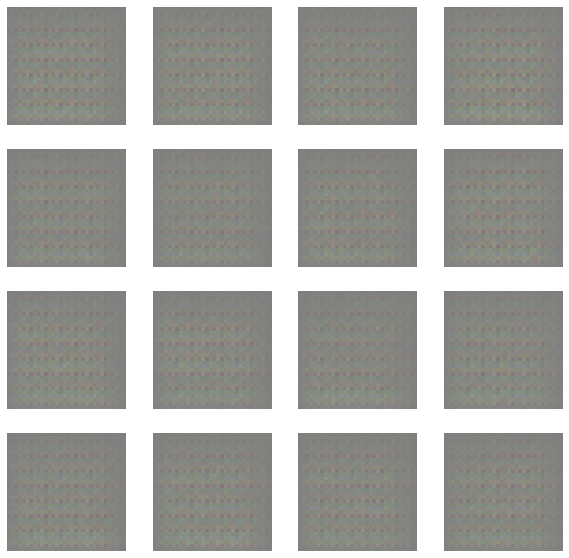

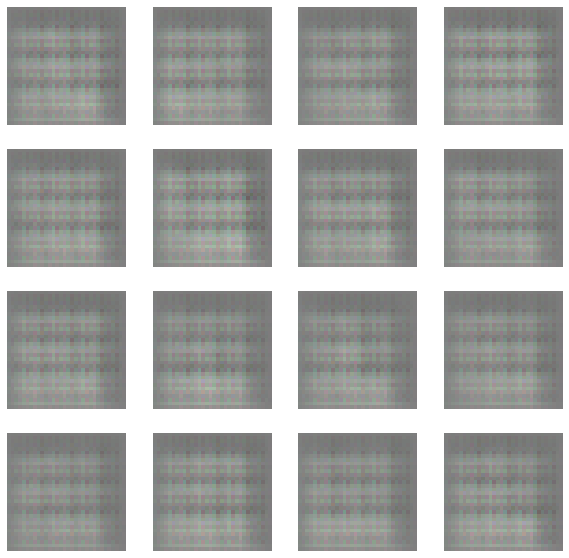

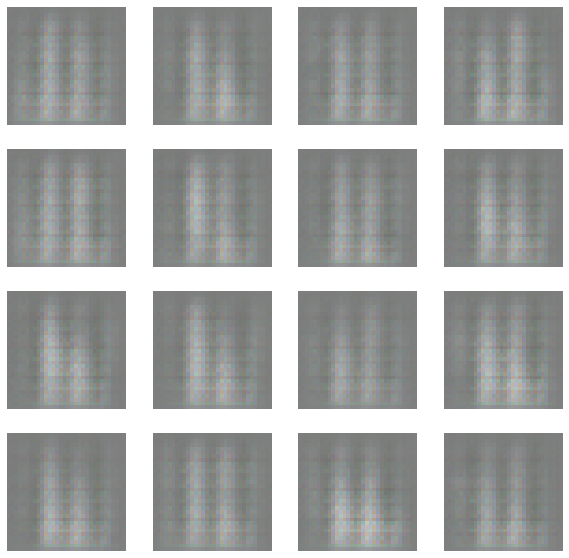

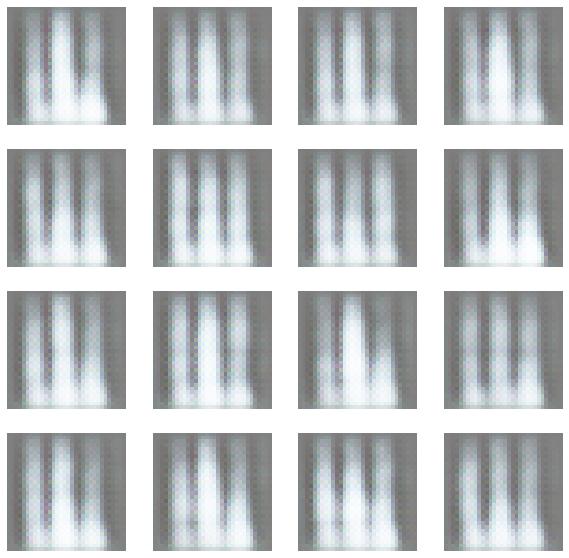

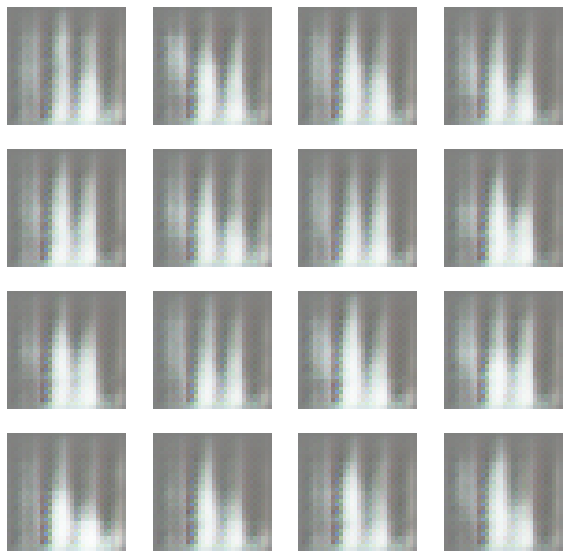

...

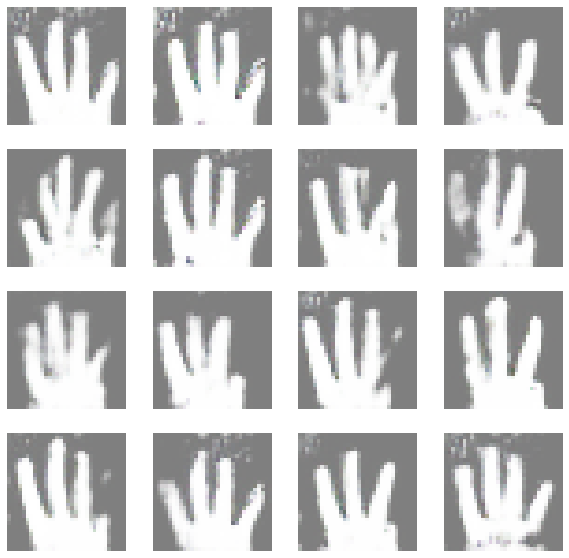

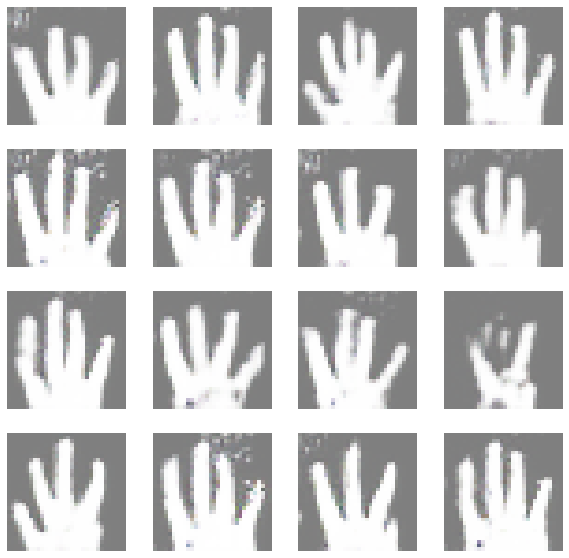

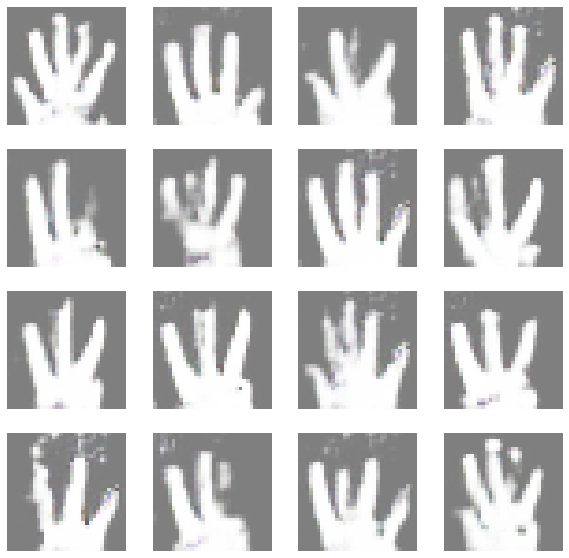

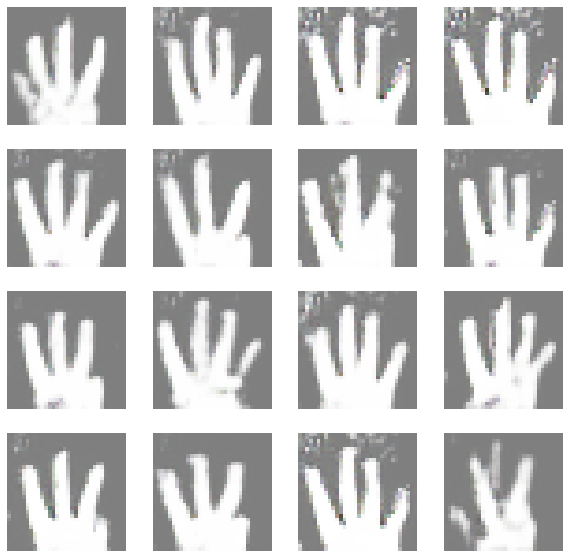

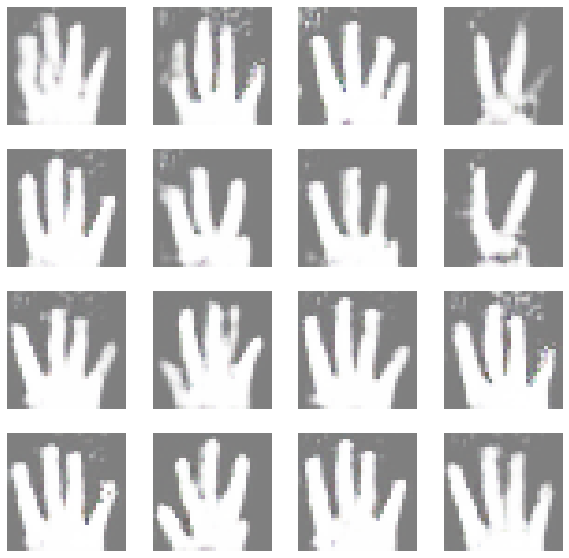

In [19]:
# calculate accuracies for real and fake data    
#real_accuracy = []
#fake_accuracy = []
# size of the latent space
latent_dim = 100
# create the discriminator
d_model = define_discriminator()
# create the generator
g_model = define_generator(latent_dim)
# create the gan
gan_model = define_gan(g_model, d_model)
# load image data
dataset = load_real_samples()
# train model
discriminator_loss, generator_loss, real_accuracy, fake_accuracy = train(g_model, d_model, gan_model, dataset, latent_dim)


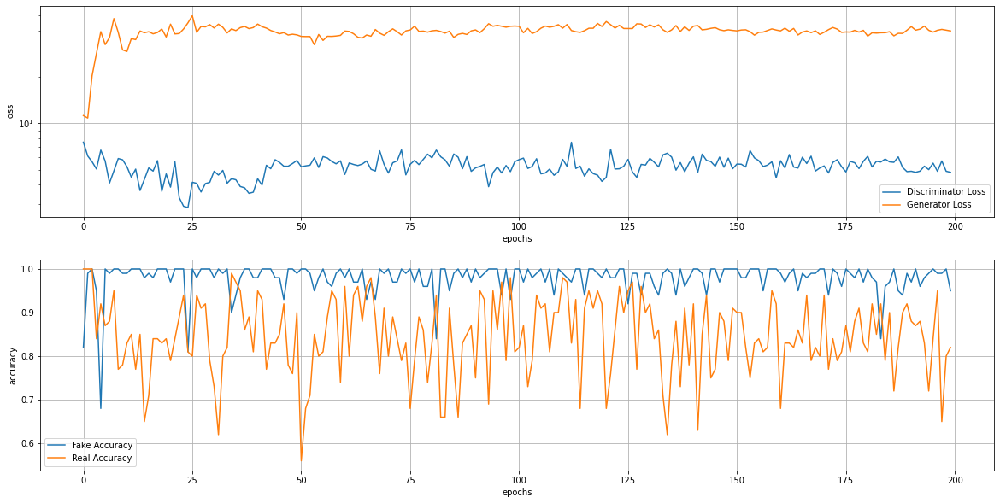

In [21]:
plt.subplots(figsize=(20, 10))

plt.subplot(2, 1, 1)
plt.semilogy(discriminator_loss)
plt.semilogy(generator_loss)

plt.legend(['Discriminator Loss', 'Generator Loss'])
plt.xlabel('epochs')
plt.ylabel('loss')
plt.grid()
plt.subplot(2, 1, 2)
plt.plot(accuracy_fake)
plt.plot(accuracy_real)

plt.legend(['Fake Accuracy', 'Real Accuracy'])
plt.xlabel('epochs')
plt.ylabel('accuracy')
plt.grid()
plt.savefig('Acc_loss.jpg', quality= 60, dpi= 500)
plt.show()

#DCGAN with Onesided lable smoothing

In [12]:
# define the standalone discriminator model
def define_discriminator(in_shape=(64,64,3)):
  model = Sequential()
  # normal
  model.add(Conv2D(3, (5,5), strides=(2,2), padding='same', input_shape=in_shape))
  model.add(LeakyReLU())
  #model.add(BatchNormalization())
	# downsample
  model.add(Conv2D(128, (5,5), strides=(2,2), padding='same'))
  model.add(LeakyReLU())
  #model.add(BatchNormalization())
  # downsample
  model.add(Conv2D(256, (5,5), strides=(2,2), padding='same'))
  model.add(LeakyReLU())
  #model.add(BatchNormalization())
  # downsample
  model.add(Conv2D(512, (5,5), strides=(2,2), padding='same'))
  model.add(LeakyReLU())
  #model.add(BatchNormalization())
  # downsample
  model.add(Conv2D(1024, (5,5), strides=(2,2), padding='same'))
  model.add(LeakyReLU())
  #model.add(BatchNormalization())
  # classifier
  model.add(Flatten())
  #model.add(Dropout(0.4))
  model.add(Dense(1, activation='sigmoid'))
  # compile model
  opt = Adam(learning_rate=0.001, beta_1=0.5)
  model.compile(loss='binary_crossentropy', optimizer=opt, metrics=['accuracy'])
  return model

# define the standalone generator model
def define_generator(latent_dim):
  model = Sequential()
  # foundation for 4x4 image
  n_nodes = 1024 * 4 * 4
  model.add(Dense(n_nodes, input_dim=latent_dim))
  model.add(Reshape((4, 4, 1024)))
  # upsample to 8x8
  model.add(Conv2DTranspose(512, (5,5), strides=(2,2), activation='relu', padding='same'))
  #model.add(BatchNormalization())
  # upsample to 16x16
  model.add(Conv2DTranspose(256, (5,5), strides=(2,2), activation='relu', padding='same'))
  #model.add(BatchNormalization())
  # upsample to 32x32
  model.add(Conv2DTranspose(128, (5,5), strides=(2,2), activation='relu', padding='same'))
  #model.add(BatchNormalization())
  # upsample to 64x64
  model.add(Conv2DTranspose(3, (5,5), strides=(2,2), activation='relu', padding='same'))
  #model.add(BatchNormalization())
  # output layer
  model.add(Conv2D(3, (5,5), activation='tanh', padding='same'))
  #model.add(BatchNormalization())
  return model

# define the combined generator and discriminator model, for updating the generator
def define_gan(g_model, d_model):
	# make weights in the discriminator not trainable
	d_model.trainable = False
	# connect them
	model = Sequential()
	# add generator
	model.add(g_model)
	# add the discriminator
	model.add(d_model)
	# compile model
	opt = Adam(learning_rate=0.0002, beta_1=0.5)
	model.compile(loss='binary_crossentropy', optimizer=opt)
	return model

# load and prepare  images
def load_real_samples():
	# load dataset
	# convert from unsigned ints to floats
	X = X_data.astype('float32')
	# scale from [0,255] to [0,1]
	X = X / 255
	return X

# select real samples
def generate_real_samples(dataset, n_samples):
	# choose random instances
	ix = randint(0, dataset.shape[0], n_samples)
	# retrieve selected images
	X = dataset[ix]
	# generate 'real' class labels (1)
	y = np.ones((n_samples, 1))*0.9		# One sided label smoothing
	return X, y

# generate points in latent space as input for the generator
def generate_latent_points(latent_dim, n_samples):
	# generate points in the latent space
	x_input = randn(latent_dim * n_samples)
	# reshape into a batch of inputs for the network
	x_input = x_input.reshape(n_samples, latent_dim)
	return x_input

# use the generator to generate n fake examples, with class labels
def generate_fake_samples(g_model, latent_dim, n_samples):
	# generate points in latent space
	x_input = generate_latent_points(latent_dim, n_samples)
	# predict outputs
	X = g_model.predict(x_input)
	# create 'fake' class labels (0)
	y = zeros((n_samples, 1))*0.9   # One sided lable smoothing
	return X, y

# create and save a plot of generated images
def save_plot(examples, epoch, n= 4):
    
    examples = (examples + 1) / 2.0
    plt.figure(figsize=(10,10))
    
    for i in range (n*n):
        
        plt.subplot(n, n, 1+i)
        plt.axis('off')
        plt.imshow(examples[i])
        
    filename = 'generated_plot_e%03d.png' % (epoch+1)
    plt.savefig(filename)

# evaluate the discriminator, plot generated images, save generator model
accuracy_real = []
accuracy_fake = []
def summarize_performance(epoch, g_model, d_model, dataset, latent_dim, n_samples=100):
	  
    # prepare real samples
    X_real, y_real = generate_real_samples(dataset, n_samples)
    # evaluate discriminator on real samples
    _, acc_real = d_model.evaluate(X_real, y_real, verbose=0)
    # prepare fake samples
    x_fake, y_fake = generate_fake_samples(g_model, latent_dim, n_samples)
    # evaluate discriminator on fake examples
    _, acc_fake = d_model.evaluate(x_fake, y_fake, verbose=0)
    # summarize discriminator performance
    print('>Accuracy real: %.0f%%, fake: %.0f%%' %(acc_real*100, acc_fake*100))
    # save plot
    save_plot(x_fake, epoch)
    # save the generator model tile file
    filename= 'generator_model_%03d.h5' % (epoch+1)
    g_model.save(filename)
    
    accuracy_real.append(acc_real)
    accuracy_fake.append(acc_fake)
    
    return accuracy_real, accuracy_fake 
    

# train the generator and discriminator
def train(g_model, d_model, gan_model, dataset, latent_dim, n_epochs=200, n_batch=64):
    
    d_loss_total = np.zeros(n_epochs)
    g_loss_total  = np.zeros(n_epochs)
    d_loss        = 0
    
    bat_per_epo = int(dataset.shape[0]/ n_batch)
    half_batch = int(n_batch / 2)
    # manually enumerate epochs
    for i in range (n_epochs):
        # enumerate batches over the training set
        
        g_loss_sum    = 0
        d_loss_sum    = 0
        
        for j in range(bat_per_epo):                        
            # get randomly selected 'real' samples
            X_real, y_real = generate_real_samples(dataset,half_batch)
            # update discriminator model weights
            d_loss1, _ = d_model.train_on_batch(X_real,y_real)
            # generate 'fake' examples
            X_fake, y_fake = generate_fake_samples(g_model, latent_dim, half_batch)
            # update discriminator model weights
            d_loss2, _ = d_model.train_on_batch(X_fake,y_fake)
            # prepare points in latent space as input for the generator
            X_gan = generate_latent_points(latent_dim, n_batch)
            # create inverted labels for the fake samples
            y_gan = ones((n_batch, 1))
            # update the generator via the discriminator's error
            g_loss = gan_model.train_on_batch(X_gan, y_gan)
            # summarize loss on this batch
            print('>%d, %d/%d, d1=%.5f, d2=%.5f, g=%.5f' %
                  (i+1, j+1, bat_per_epo, d_loss1, d_loss2, g_loss))
            
            # Total Discriminator Loss = Real data loss + Fake data loss
            d_loss      = 0.5*(d_loss1 + d_loss2)
            d_loss_sum  = d_loss_sum + d_loss
            g_loss_sum  = g_loss_sum + g_loss
            
        d_loss_total[i] = d_loss_sum
        g_loss_total[i]  = g_loss_sum
        
        # evaluate the model performance, sometimes
        if (i+1) % 1 == 0:
            accuracy_real, accuracy_fake = summarize_performance(i, g_model, d_model, dataset, latent_dim)
    
    return d_loss_total, g_loss_total, accuracy_real, accuracy_fake



/usr/local/lib/python3.8/dist-packages/keras/optimizers/optimizer_v2/adam.py:110: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(Adam, self).__init__(name, **kwargs)


1/1 [==============================] - 0s 99ms/step
>1, 1/15, d1=0.68595, d2=0.69555, g=0.69175
1/1 [==============================] - 0s 17ms/step
>1, 2/15, d1=0.61542, d2=0.69802, g=0.68921
1/1 [==============================] - 0s 11ms/step
>1, 3/15, d1=0.54642, d2=0.70426, g=0.68259
1/1 [==============================] - 0s 11ms/step
>1, 4/15, d1=0.45841, d2=0.72119, g=0.66683
1/1 [==============================] - 0s 21ms/step
>1, 5/15, d1=0.39789, d2=0.75584, g=0.63872
1/1 [==============================] - 0s 13ms/step
>1, 6/15, d1=0.34797, d2=0.80848, g=0.61551
1/1 [==============================] - 0s 13ms/step
>1, 7/15, d1=0.35409, d2=0.85669, g=0.60855
1/1 [==============================] - 0s 12ms/step
>1, 8/15, d1=0.35762, d2=0.84967, g=0.64088
1/1 [==============================] - 0s 13ms/step
>1, 9/15, d1=0.39600, d2=0.78459, g=0.72510
1/1 [==============================] - 0s 12ms/step
>1, 10/15, d1=0.43021, d2=0.69364, g=0.81772
1/1 [==============================] - 

1/1 [==============================] - 0s 13ms/step
>2, 1/15, d1=0.33857, d2=0.67565, g=0.72759
1/1 [==============================] - 0s 14ms/step
>2, 2/15, d1=0.33752, d2=0.68600, g=0.71481
1/1 [==============================] - 0s 14ms/step
>2, 3/15, d1=0.34045, d2=0.68891, g=0.70889
1/1 [==============================] - 0s 13ms/step
>2, 4/15, d1=0.33284, d2=0.68627, g=0.71198
1/1 [==============================] - 0s 14ms/step
>2, 5/15, d1=0.33124, d2=0.67789, g=0.71952
1/1 [==============================] - 0s 12ms/step
>2, 6/15, d1=0.33588, d2=0.67118, g=0.72694
1/1 [==============================] - 0s 13ms/step
>2, 7/15, d1=0.33139, d2=0.66746, g=0.73377
1/1 [==============================] - 0s 18ms/step
>2, 8/15, d1=0.32937, d2=0.66842, g=0.73936
1/1 [==============================] - 0s 12ms/step
>2, 9/15, d1=0.33013, d2=0.67104, g=0.75016
1/1 [==============================] - 0s 14ms/step
>2, 10/15, d1=0.33590, d2=0.66050, g=0.77164
1/1 [==============================] - 

1/1 [==============================] - 0s 14ms/step
>3, 1/15, d1=0.33796, d2=0.44929, g=1.18844
1/1 [==============================] - 0s 13ms/step
>3, 2/15, d1=0.42989, d2=0.46604, g=1.02825
1/1 [==============================] - 0s 12ms/step
>3, 3/15, d1=0.53953, d2=0.56595, g=1.19956
1/1 [==============================] - 0s 12ms/step
>3, 4/15, d1=0.34776, d2=0.31422, g=1.82675
1/1 [==============================] - 0s 12ms/step
>3, 5/15, d1=1.13965, d2=0.43645, g=0.89287
1/1 [==============================] - 0s 12ms/step
>3, 6/15, d1=0.43447, d2=0.71036, g=0.83059
1/1 [==============================] - 0s 12ms/step
>3, 7/15, d1=0.37576, d2=0.75512, g=0.84213
1/1 [==============================] - 0s 13ms/step
>3, 8/15, d1=0.39769, d2=0.65146, g=1.03033
1/1 [==============================] - 0s 13ms/step
>3, 9/15, d1=0.43027, d2=0.42130, g=1.57878
1/1 [==============================] - 0s 12ms/step
>3, 10/15, d1=0.51933, d2=0.29006, g=1.65780
1/1 [==============================] - 

1/1 [==============================] - 0s 12ms/step
>4, 1/15, d1=0.34273, d2=0.24461, g=1.74369
1/1 [==============================] - 0s 12ms/step
>4, 2/15, d1=0.40177, d2=0.23094, g=1.77806
1/1 [==============================] - 0s 12ms/step
>4, 3/15, d1=0.33873, d2=0.22332, g=2.04845
1/1 [==============================] - 0s 15ms/step
>4, 4/15, d1=0.44519, d2=0.30983, g=1.83731
1/1 [==============================] - 0s 14ms/step
>4, 5/15, d1=0.34515, d2=0.25587, g=2.72775
1/1 [==============================] - 0s 17ms/step
>4, 6/15, d1=0.85079, d2=0.48005, g=1.26924
1/1 [==============================] - 0s 12ms/step
>4, 7/15, d1=0.43802, d2=1.34698, g=1.24681
1/1 [==============================] - 0s 12ms/step
>4, 8/15, d1=0.57361, d2=0.51220, g=2.09361
1/1 [==============================] - 0s 12ms/step
>4, 9/15, d1=0.74138, d2=0.10372, g=3.39900
1/1 [==============================] - 0s 13ms/step
>4, 10/15, d1=0.57866, d2=0.23137, g=2.05125
1/1 [==============================] - 

1/1 [==============================] - 0s 12ms/step
>5, 1/15, d1=0.66939, d2=0.43087, g=1.93319
1/1 [==============================] - 0s 13ms/step
>5, 2/15, d1=0.72822, d2=0.45825, g=2.20736
1/1 [==============================] - 0s 12ms/step
>5, 3/15, d1=0.81692, d2=0.51081, g=2.07556
1/1 [==============================] - 0s 15ms/step
>5, 4/15, d1=0.66634, d2=0.56762, g=2.28074
1/1 [==============================] - 0s 13ms/step
>5, 5/15, d1=0.93288, d2=0.53874, g=1.82317
1/1 [==============================] - 0s 13ms/step
>5, 6/15, d1=0.75749, d2=0.43728, g=2.10446
1/1 [==============================] - 0s 15ms/step
>5, 7/15, d1=0.62959, d2=0.38010, g=2.47433
1/1 [==============================] - 0s 13ms/step
>5, 8/15, d1=0.70808, d2=0.45521, g=2.24211
1/1 [==============================] - 0s 16ms/step
>5, 9/15, d1=0.56758, d2=0.32392, g=2.40576
1/1 [==============================] - 0s 13ms/step
>5, 10/15, d1=0.58946, d2=0.22591, g=2.27403
1/1 [==============================] - 

1/1 [==============================] - 0s 13ms/step
>6, 1/15, d1=0.85597, d2=0.44667, g=1.47868
1/1 [==============================] - 0s 13ms/step
>6, 2/15, d1=0.62296, d2=0.53296, g=1.59820
1/1 [==============================] - 0s 13ms/step
>6, 3/15, d1=0.63570, d2=0.42926, g=1.73588
1/1 [==============================] - 0s 15ms/step
>6, 4/15, d1=0.64054, d2=0.39188, g=1.85231
1/1 [==============================] - 0s 13ms/step
>6, 5/15, d1=0.76243, d2=0.38765, g=1.92535
1/1 [==============================] - 0s 12ms/step
>6, 6/15, d1=0.64024, d2=0.32128, g=2.02807
1/1 [==============================] - 0s 14ms/step
>6, 7/15, d1=0.55380, d2=0.27151, g=2.10133
1/1 [==============================] - 0s 13ms/step
>6, 8/15, d1=0.60672, d2=0.23005, g=2.39575
1/1 [==============================] - 0s 12ms/step
>6, 9/15, d1=0.59839, d2=0.21387, g=2.21413
1/1 [==============================] - 0s 12ms/step
>6, 10/15, d1=0.52741, d2=0.25938, g=2.09468
1/1 [==============================] - 

1/1 [==============================] - 0s 12ms/step
>7, 1/15, d1=0.66265, d2=0.32818, g=1.91590
1/1 [==============================] - 0s 12ms/step
>7, 2/15, d1=0.66308, d2=0.44574, g=2.07711
1/1 [==============================] - 0s 12ms/step
>7, 3/15, d1=0.69395, d2=0.24817, g=1.96612
1/1 [==============================] - 0s 12ms/step
>7, 4/15, d1=0.72165, d2=0.33140, g=1.99710
1/1 [==============================] - 0s 13ms/step
>7, 5/15, d1=0.83463, d2=0.31293, g=2.36232
1/1 [==============================] - 0s 19ms/step
>7, 6/15, d1=0.61208, d2=0.24560, g=2.17641
1/1 [==============================] - 0s 13ms/step
>7, 7/15, d1=0.53063, d2=0.25636, g=2.15262
1/1 [==============================] - 0s 13ms/step
>7, 8/15, d1=0.57518, d2=0.40579, g=2.77038
1/1 [==============================] - 0s 14ms/step
>7, 9/15, d1=0.74690, d2=0.27731, g=1.86765
1/1 [==============================] - 0s 13ms/step
>7, 10/15, d1=0.59377, d2=0.59147, g=2.38371
1/1 [==============================] - 

1/1 [==============================] - 0s 17ms/step
>8, 1/15, d1=0.52991, d2=0.13067, g=2.98194
1/1 [==============================] - 0s 12ms/step
>8, 2/15, d1=0.67523, d2=0.11411, g=2.64274
1/1 [==============================] - 0s 12ms/step
>8, 3/15, d1=0.38037, d2=0.12549, g=2.56634
1/1 [==============================] - 0s 13ms/step
>8, 4/15, d1=0.44557, d2=0.17917, g=2.55006
1/1 [==============================] - 0s 15ms/step
>8, 5/15, d1=0.41676, d2=0.22963, g=2.43684
1/1 [==============================] - 0s 18ms/step
>8, 6/15, d1=0.45989, d2=0.20085, g=2.31684
1/1 [==============================] - 0s 15ms/step
>8, 7/15, d1=0.48968, d2=0.21883, g=2.29846
1/1 [==============================] - 0s 14ms/step
>8, 8/15, d1=0.54618, d2=0.19263, g=2.19637
1/1 [==============================] - 0s 13ms/step
>8, 9/15, d1=0.50729, d2=0.21466, g=2.17888
1/1 [==============================] - 0s 12ms/step
>8, 10/15, d1=0.48198, d2=0.29920, g=2.18365
1/1 [==============================] - 

1/1 [==============================] - 0s 13ms/step
>9, 1/15, d1=0.56468, d2=0.22297, g=2.23454
1/1 [==============================] - 0s 14ms/step
>9, 2/15, d1=0.65515, d2=0.26226, g=2.03998
1/1 [==============================] - 0s 12ms/step
>9, 3/15, d1=0.51060, d2=0.28947, g=1.93119
1/1 [==============================] - 0s 15ms/step
>9, 4/15, d1=0.61050, d2=0.48873, g=2.11293
1/1 [==============================] - 0s 13ms/step
>9, 5/15, d1=0.62495, d2=0.49488, g=2.61827
1/1 [==============================] - 0s 14ms/step
>9, 6/15, d1=0.72928, d2=0.32157, g=2.34166
1/1 [==============================] - 0s 12ms/step
>9, 7/15, d1=0.73765, d2=0.81327, g=3.69720
1/1 [==============================] - 0s 17ms/step
>9, 8/15, d1=1.39824, d2=0.22855, g=1.72827
1/1 [==============================] - 0s 13ms/step
>9, 9/15, d1=0.60353, d2=0.66920, g=1.68133
1/1 [==============================] - 0s 12ms/step
>9, 10/15, d1=0.69875, d2=0.35970, g=2.09606
1/1 [==============================] - 

1/1 [==============================] - 0s 13ms/step
>10, 1/15, d1=0.66799, d2=0.26782, g=2.01457
1/1 [==============================] - 0s 13ms/step
>10, 2/15, d1=0.53657, d2=0.28565, g=2.02391
1/1 [==============================] - 0s 16ms/step
>10, 3/15, d1=0.66374, d2=0.26778, g=2.02676
1/1 [==============================] - 0s 15ms/step
>10, 4/15, d1=0.54463, d2=0.22844, g=2.15874
1/1 [==============================] - 0s 15ms/step
>10, 5/15, d1=0.70160, d2=0.20623, g=2.07927
1/1 [==============================] - 0s 14ms/step
>10, 6/15, d1=0.55011, d2=0.19580, g=2.14622
1/1 [==============================] - 0s 12ms/step
>10, 7/15, d1=0.52120, d2=0.22091, g=2.05964
1/1 [==============================] - 0s 15ms/step
>10, 8/15, d1=0.51476, d2=0.20212, g=2.18033
1/1 [==============================] - 0s 15ms/step
>10, 9/15, d1=0.63585, d2=0.26527, g=2.16493
1/1 [==============================] - 0s 15ms/step
>10, 10/15, d1=0.57357, d2=0.21045, g=2.14211
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>11, 1/15, d1=0.62717, d2=0.22547, g=2.24219
1/1 [==============================] - 0s 12ms/step
>11, 2/15, d1=0.55637, d2=0.30487, g=2.16550
1/1 [==============================] - 0s 12ms/step
>11, 3/15, d1=0.55625, d2=0.28450, g=2.29736
1/1 [==============================] - 0s 14ms/step
>11, 4/15, d1=0.70593, d2=0.20732, g=2.17009
1/1 [==============================] - 0s 13ms/step
>11, 5/15, d1=0.59955, d2=0.21937, g=1.79589
1/1 [==============================] - 0s 13ms/step
>11, 6/15, d1=0.56552, d2=0.51815, g=2.05029
1/1 [==============================] - 0s 12ms/step
>11, 7/15, d1=0.66927, d2=0.26622, g=2.42118
1/1 [==============================] - 0s 13ms/step
>11, 8/15, d1=0.80613, d2=0.37446, g=1.82330
1/1 [==============================] - 0s 14ms/step
>11, 9/15, d1=0.58241, d2=0.36851, g=1.88172
1/1 [==============================] - 0s 13ms/step
>11, 10/15, d1=0.62573, d2=0.31282, g=2.17872
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>12, 1/15, d1=0.73437, d2=0.33039, g=1.92417
1/1 [==============================] - 0s 14ms/step
>12, 2/15, d1=0.60887, d2=0.32206, g=2.28065
1/1 [==============================] - 0s 12ms/step
>12, 3/15, d1=0.79735, d2=0.26161, g=2.08559
1/1 [==============================] - 0s 15ms/step
>12, 4/15, d1=0.75733, d2=0.29719, g=2.01291
1/1 [==============================] - 0s 12ms/step
>12, 5/15, d1=0.57331, d2=0.29649, g=2.15407
1/1 [==============================] - 0s 12ms/step
>12, 6/15, d1=0.68336, d2=0.26329, g=2.19130
1/1 [==============================] - 0s 14ms/step
>12, 7/15, d1=0.60765, d2=0.24532, g=1.87102
1/1 [==============================] - 0s 19ms/step
>12, 8/15, d1=0.51955, d2=0.24548, g=2.08106
1/1 [==============================] - 0s 15ms/step
>12, 9/15, d1=0.65776, d2=0.28027, g=2.17817
1/1 [==============================] - 0s 15ms/step
>12, 10/15, d1=0.59207, d2=0.21971, g=2.29524
1/1 [========================

1/1 [==============================] - 0s 15ms/step
>13, 1/15, d1=0.47331, d2=0.15612, g=2.45386
1/1 [==============================] - 0s 14ms/step
>13, 2/15, d1=0.51763, d2=0.21063, g=2.31195
1/1 [==============================] - 0s 14ms/step
>13, 3/15, d1=0.48205, d2=0.20620, g=2.27763
1/1 [==============================] - 0s 15ms/step
>13, 4/15, d1=0.54695, d2=0.20380, g=2.17540
1/1 [==============================] - 0s 14ms/step
>13, 5/15, d1=0.44937, d2=0.21041, g=2.38868
1/1 [==============================] - 0s 13ms/step
>13, 6/15, d1=0.42361, d2=0.13680, g=2.61769
1/1 [==============================] - 0s 15ms/step
>13, 7/15, d1=0.57643, d2=0.18848, g=2.39191
1/1 [==============================] - 0s 14ms/step
>13, 8/15, d1=0.52869, d2=0.28328, g=2.29345
1/1 [==============================] - 0s 14ms/step
>13, 9/15, d1=0.51373, d2=0.14912, g=2.70152
1/1 [==============================] - 0s 16ms/step
>13, 10/15, d1=0.40319, d2=0.11462, g=2.76729
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>14, 1/15, d1=0.37960, d2=0.11133, g=2.65871
1/1 [==============================] - 0s 13ms/step
>14, 2/15, d1=0.49126, d2=0.18745, g=2.49136
1/1 [==============================] - 0s 18ms/step
>14, 3/15, d1=0.41195, d2=0.12590, g=3.27688
1/1 [==============================] - 0s 12ms/step
>14, 4/15, d1=0.52446, d2=0.11304, g=2.78577
1/1 [==============================] - 0s 14ms/step
>14, 5/15, d1=0.49434, d2=0.16124, g=2.67344
1/1 [==============================] - 0s 12ms/step
>14, 6/15, d1=0.42880, d2=0.09211, g=2.83320
1/1 [==============================] - 0s 13ms/step
>14, 7/15, d1=0.48302, d2=0.26507, g=2.46369
1/1 [==============================] - 0s 12ms/step
>14, 8/15, d1=0.43376, d2=0.10133, g=2.96517
1/1 [==============================] - 0s 14ms/step
>14, 9/15, d1=0.57869, d2=0.16373, g=2.64874
1/1 [==============================] - 0s 13ms/step
>14, 10/15, d1=0.51723, d2=0.24606, g=2.27215
1/1 [========================

1/1 [==============================] - 0s 14ms/step
>15, 1/15, d1=0.44385, d2=0.17143, g=2.51918
1/1 [==============================] - 0s 13ms/step
>15, 2/15, d1=0.45887, d2=0.08475, g=2.83097
1/1 [==============================] - 0s 16ms/step
>15, 3/15, d1=0.49428, d2=0.12158, g=2.51633
1/1 [==============================] - 0s 16ms/step
>15, 4/15, d1=0.49525, d2=0.26155, g=2.22218
1/1 [==============================] - 0s 15ms/step
>15, 5/15, d1=0.53060, d2=0.15042, g=2.48430
1/1 [==============================] - 0s 13ms/step
>15, 6/15, d1=0.58430, d2=0.22537, g=2.02406
1/1 [==============================] - 0s 14ms/step
>15, 7/15, d1=0.52923, d2=0.44749, g=2.36235
1/1 [==============================] - 0s 12ms/step
>15, 8/15, d1=0.56369, d2=0.17293, g=2.70639
1/1 [==============================] - 0s 16ms/step
>15, 9/15, d1=1.07387, d2=0.71780, g=1.68093
1/1 [==============================] - 0s 12ms/step
>15, 10/15, d1=0.62330, d2=0.28573, g=2.25234
1/1 [========================

1/1 [==============================] - 0s 15ms/step
>16, 1/15, d1=0.48439, d2=0.20231, g=2.16527
1/1 [==============================] - 0s 12ms/step
>16, 2/15, d1=0.57768, d2=0.18390, g=2.21495
1/1 [==============================] - 0s 14ms/step
>16, 3/15, d1=0.48619, d2=0.17371, g=2.25631
1/1 [==============================] - 0s 13ms/step
>16, 4/15, d1=0.52478, d2=0.15740, g=2.15618
1/1 [==============================] - 0s 15ms/step
>16, 5/15, d1=0.52396, d2=0.12141, g=2.33776
1/1 [==============================] - 0s 12ms/step
>16, 6/15, d1=0.51275, d2=0.19507, g=2.07315
1/1 [==============================] - 0s 14ms/step
>16, 7/15, d1=0.58000, d2=0.14771, g=2.30728
1/1 [==============================] - 0s 13ms/step
>16, 8/15, d1=0.57087, d2=0.14614, g=2.19712
1/1 [==============================] - 0s 15ms/step
>16, 9/15, d1=0.51349, d2=0.17147, g=2.06448
1/1 [==============================] - 0s 19ms/step
>16, 10/15, d1=0.55652, d2=0.20192, g=2.19676
1/1 [========================

1/1 [==============================] - 0s 16ms/step
>17, 1/15, d1=0.73187, d2=0.21423, g=1.93725
1/1 [==============================] - 0s 15ms/step
>17, 2/15, d1=0.70653, d2=0.23704, g=2.01166
1/1 [==============================] - 0s 12ms/step
>17, 3/15, d1=0.62510, d2=0.16442, g=2.07760
1/1 [==============================] - 0s 13ms/step
>17, 4/15, d1=0.56414, d2=0.22158, g=2.04072
1/1 [==============================] - 0s 14ms/step
>17, 5/15, d1=0.56703, d2=0.16044, g=2.19727
1/1 [==============================] - 0s 13ms/step
>17, 6/15, d1=0.46080, d2=0.19558, g=2.26869
1/1 [==============================] - 0s 12ms/step
>17, 7/15, d1=0.44940, d2=0.11539, g=2.55850
1/1 [==============================] - 0s 12ms/step
>17, 8/15, d1=0.59734, d2=0.10961, g=2.29078
1/1 [==============================] - 0s 16ms/step
>17, 9/15, d1=0.54326, d2=0.19762, g=2.16656
1/1 [==============================] - 0s 16ms/step
>17, 10/15, d1=0.48500, d2=0.20800, g=2.14791
1/1 [========================

1/1 [==============================] - 0s 16ms/step
>18, 1/15, d1=0.58361, d2=0.21791, g=2.19704
1/1 [==============================] - 0s 13ms/step
>18, 2/15, d1=0.49388, d2=0.15241, g=2.43634
1/1 [==============================] - 0s 13ms/step
>18, 3/15, d1=0.55302, d2=0.15062, g=2.40034
1/1 [==============================] - 0s 13ms/step
>18, 4/15, d1=0.57929, d2=0.23280, g=2.19221
1/1 [==============================] - 0s 15ms/step
>18, 5/15, d1=0.52401, d2=0.17048, g=2.31568
1/1 [==============================] - 0s 13ms/step
>18, 6/15, d1=0.58671, d2=0.21498, g=2.16621
1/1 [==============================] - 0s 14ms/step
>18, 7/15, d1=0.58509, d2=0.25063, g=2.11454
1/1 [==============================] - 0s 13ms/step
>18, 8/15, d1=0.43970, d2=0.25609, g=2.22252
1/1 [==============================] - 0s 13ms/step
>18, 9/15, d1=0.51775, d2=0.19886, g=2.24028
1/1 [==============================] - 0s 13ms/step
>18, 10/15, d1=0.55317, d2=0.25906, g=2.17646
1/1 [========================

1/1 [==============================] - 0s 16ms/step
>19, 1/15, d1=0.61805, d2=0.12619, g=2.85857
1/1 [==============================] - 0s 12ms/step
>19, 2/15, d1=0.76647, d2=0.23816, g=2.21874
1/1 [==============================] - 0s 12ms/step
>19, 3/15, d1=0.59986, d2=0.18246, g=2.25755
1/1 [==============================] - 0s 13ms/step
>19, 4/15, d1=0.55815, d2=0.15919, g=2.52426
1/1 [==============================] - 0s 12ms/step
>19, 5/15, d1=0.50606, d2=0.11964, g=2.73598
1/1 [==============================] - 0s 15ms/step
>19, 6/15, d1=0.63336, d2=0.15461, g=2.37433
1/1 [==============================] - 0s 15ms/step
>19, 7/15, d1=0.59600, d2=0.19611, g=2.32023
1/1 [==============================] - 0s 13ms/step
>19, 8/15, d1=0.49352, d2=0.15756, g=2.58183
1/1 [==============================] - 0s 12ms/step
>19, 9/15, d1=0.56316, d2=0.17158, g=2.38211
1/1 [==============================] - 0s 14ms/step
>19, 10/15, d1=0.51380, d2=0.13405, g=2.24651
1/1 [========================

1/1 [==============================] - 0s 14ms/step
>20, 1/15, d1=0.44370, d2=0.15280, g=2.41847
1/1 [==============================] - 0s 14ms/step
>20, 2/15, d1=0.50193, d2=0.13874, g=2.25861
1/1 [==============================] - 0s 13ms/step
>20, 3/15, d1=0.53456, d2=0.15518, g=2.29985
1/1 [==============================] - 0s 15ms/step
>20, 4/15, d1=0.42502, d2=0.18846, g=2.29186
1/1 [==============================] - 0s 18ms/step
>20, 5/15, d1=0.51885, d2=0.22800, g=2.02392
1/1 [==============================] - 0s 13ms/step
>20, 6/15, d1=0.48533, d2=0.22532, g=2.44090
1/1 [==============================] - 0s 13ms/step
>20, 7/15, d1=0.52881, d2=0.09898, g=2.76617
1/1 [==============================] - 0s 13ms/step
>20, 8/15, d1=0.53018, d2=0.20678, g=2.13840
1/1 [==============================] - 0s 14ms/step
>20, 9/15, d1=0.53457, d2=0.16379, g=2.23301
1/1 [==============================] - 0s 12ms/step
>20, 10/15, d1=0.40513, d2=0.15392, g=2.21059
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>21, 1/15, d1=0.46355, d2=0.24615, g=2.21352
1/1 [==============================] - 0s 18ms/step
>21, 2/15, d1=0.61719, d2=0.33152, g=2.12897
1/1 [==============================] - 0s 12ms/step
>21, 3/15, d1=0.63930, d2=0.31009, g=1.84723
1/1 [==============================] - 0s 13ms/step
>21, 4/15, d1=0.46567, d2=0.22718, g=2.37943
1/1 [==============================] - 0s 12ms/step
>21, 5/15, d1=0.50481, d2=0.25609, g=2.35465
1/1 [==============================] - 0s 19ms/step
>21, 6/15, d1=0.56864, d2=0.15205, g=2.38377
1/1 [==============================] - 0s 14ms/step
>21, 7/15, d1=0.47232, d2=0.15840, g=2.39607
1/1 [==============================] - 0s 13ms/step
>21, 8/15, d1=0.42272, d2=0.19591, g=2.46515
1/1 [==============================] - 0s 12ms/step
>21, 9/15, d1=0.42240, d2=0.18757, g=2.64011
1/1 [==============================] - 0s 13ms/step
>21, 10/15, d1=0.48258, d2=0.18767, g=2.34453
1/1 [========================

<ipython-input-12-03dba959b318>:102: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(10,10))


1/1 [==============================] - 0s 13ms/step
>22, 1/15, d1=0.44975, d2=0.09121, g=2.91615
1/1 [==============================] - 0s 13ms/step
>22, 2/15, d1=0.51853, d2=0.20781, g=2.41048
1/1 [==============================] - 0s 12ms/step
>22, 3/15, d1=0.41349, d2=0.16532, g=2.85495
1/1 [==============================] - 0s 16ms/step
>22, 4/15, d1=0.58189, d2=0.21292, g=2.43942
1/1 [==============================] - 0s 13ms/step
>22, 5/15, d1=0.43062, d2=0.22343, g=2.84666
1/1 [==============================] - 0s 16ms/step
>22, 6/15, d1=0.52416, d2=0.23118, g=2.60017
1/1 [==============================] - 0s 12ms/step
>22, 7/15, d1=0.50337, d2=0.32380, g=2.84133
1/1 [==============================] - 0s 14ms/step
>22, 8/15, d1=0.58013, d2=0.13952, g=2.60742
1/1 [==============================] - 0s 12ms/step
>22, 9/15, d1=0.40725, d2=0.23595, g=2.94667
1/1 [==============================] - 0s 15ms/step
>22, 10/15, d1=0.78459, d2=0.18039, g=3.34961
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>23, 1/15, d1=0.62623, d2=0.17810, g=2.53414
1/1 [==============================] - 0s 16ms/step
>23, 2/15, d1=0.52481, d2=0.18941, g=2.56442
1/1 [==============================] - 0s 13ms/step
>23, 3/15, d1=0.40414, d2=0.10747, g=2.91833
1/1 [==============================] - 0s 13ms/step
>23, 4/15, d1=0.58013, d2=0.13916, g=3.00070
1/1 [==============================] - 0s 12ms/step
>23, 5/15, d1=0.64489, d2=0.22621, g=2.23523
1/1 [==============================] - 0s 14ms/step
>23, 6/15, d1=0.50387, d2=0.13713, g=2.72241
1/1 [==============================] - 0s 13ms/step
>23, 7/15, d1=0.44973, d2=0.16558, g=2.49553
1/1 [==============================] - 0s 12ms/step
>23, 8/15, d1=0.45298, d2=0.24383, g=2.77211
1/1 [==============================] - 0s 12ms/step
>23, 9/15, d1=0.66437, d2=0.18344, g=2.76837
1/1 [==============================] - 0s 15ms/step
>23, 10/15, d1=0.63060, d2=0.26391, g=2.41986
1/1 [========================

1/1 [==============================] - 0s 15ms/step
>24, 1/15, d1=0.55358, d2=0.09866, g=2.80110
1/1 [==============================] - 0s 13ms/step
>24, 2/15, d1=0.46254, d2=0.13067, g=2.50061
1/1 [==============================] - 0s 15ms/step
>24, 3/15, d1=0.44759, d2=0.19905, g=2.52015
1/1 [==============================] - 0s 14ms/step
>24, 4/15, d1=0.42188, d2=0.13132, g=3.06600
1/1 [==============================] - 0s 13ms/step
>24, 5/15, d1=0.55326, d2=0.16030, g=2.68984
1/1 [==============================] - 0s 22ms/step
>24, 6/15, d1=0.48708, d2=0.12055, g=2.78987
1/1 [==============================] - 0s 17ms/step
>24, 7/15, d1=0.47723, d2=0.10534, g=2.83775
1/1 [==============================] - 0s 19ms/step
>24, 8/15, d1=0.49077, d2=0.08500, g=3.23417
1/1 [==============================] - 0s 13ms/step
>24, 9/15, d1=0.46187, d2=0.16198, g=2.49905
1/1 [==============================] - 0s 14ms/step
>24, 10/15, d1=0.44356, d2=0.03119, g=3.71316
1/1 [========================

1/1 [==============================] - 0s 24ms/step
>25, 1/15, d1=0.42397, d2=0.12889, g=2.86261
1/1 [==============================] - 0s 14ms/step
>25, 2/15, d1=0.43249, d2=0.12863, g=2.74581
1/1 [==============================] - 0s 13ms/step
>25, 3/15, d1=0.39483, d2=0.12724, g=2.76941
1/1 [==============================] - 0s 19ms/step
>25, 4/15, d1=0.43934, d2=0.18552, g=2.65560
1/1 [==============================] - 0s 18ms/step
>25, 5/15, d1=0.42407, d2=0.10721, g=3.29783
1/1 [==============================] - 0s 20ms/step
>25, 6/15, d1=0.45621, d2=0.06137, g=3.09190
1/1 [==============================] - 0s 13ms/step
>25, 7/15, d1=0.41989, d2=0.07644, g=3.04103
1/1 [==============================] - 0s 16ms/step
>25, 8/15, d1=0.45664, d2=0.26897, g=2.49505
1/1 [==============================] - 0s 12ms/step
>25, 9/15, d1=0.53244, d2=0.12219, g=2.79057
1/1 [==============================] - 0s 13ms/step
>25, 10/15, d1=0.40860, d2=0.12202, g=2.65044
1/1 [========================

1/1 [==============================] - 0s 14ms/step
>26, 1/15, d1=0.50006, d2=0.19312, g=2.44853
1/1 [==============================] - 0s 13ms/step
>26, 2/15, d1=0.54502, d2=0.26190, g=2.42475
1/1 [==============================] - 0s 15ms/step
>26, 3/15, d1=0.46178, d2=0.18424, g=2.72497
1/1 [==============================] - 0s 12ms/step
>26, 4/15, d1=0.53903, d2=0.11026, g=2.76242
1/1 [==============================] - 0s 12ms/step
>26, 5/15, d1=0.51892, d2=0.16952, g=2.63159
1/1 [==============================] - 0s 13ms/step
>26, 6/15, d1=0.47320, d2=0.16389, g=2.59208
1/1 [==============================] - 0s 12ms/step
>26, 7/15, d1=0.46982, d2=0.10536, g=2.62665
1/1 [==============================] - 0s 15ms/step
>26, 8/15, d1=0.51172, d2=0.20600, g=2.50923
1/1 [==============================] - 0s 12ms/step
>26, 9/15, d1=0.47878, d2=0.20527, g=2.56980
1/1 [==============================] - 0s 13ms/step
>26, 10/15, d1=0.64545, d2=0.21811, g=2.82503
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>27, 1/15, d1=0.79009, d2=0.10390, g=2.62022
1/1 [==============================] - 0s 14ms/step
>27, 2/15, d1=0.57973, d2=0.18747, g=2.35702
1/1 [==============================] - 0s 12ms/step
>27, 3/15, d1=0.51913, d2=0.20512, g=2.72940
1/1 [==============================] - 0s 12ms/step
>27, 4/15, d1=0.61170, d2=0.28592, g=2.59693
1/1 [==============================] - 0s 16ms/step
>27, 5/15, d1=0.51872, d2=0.16786, g=2.69910
1/1 [==============================] - 0s 12ms/step
>27, 6/15, d1=0.51603, d2=0.18823, g=2.54475
1/1 [==============================] - 0s 12ms/step
>27, 7/15, d1=0.41491, d2=0.15181, g=2.86575
1/1 [==============================] - 0s 12ms/step
>27, 8/15, d1=0.60304, d2=0.23637, g=2.67444
1/1 [==============================] - 0s 12ms/step
>27, 9/15, d1=0.72552, d2=0.29628, g=2.62822
1/1 [==============================] - 0s 12ms/step
>27, 10/15, d1=0.50852, d2=0.14627, g=2.87810
1/1 [========================

1/1 [==============================] - 0s 12ms/step
>28, 1/15, d1=0.59974, d2=0.36446, g=2.69450
1/1 [==============================] - 0s 15ms/step
>28, 2/15, d1=0.56522, d2=0.17949, g=2.54828
1/1 [==============================] - 0s 14ms/step
>28, 3/15, d1=0.65153, d2=0.32800, g=1.96977
1/1 [==============================] - 0s 14ms/step
>28, 4/15, d1=0.48525, d2=0.29874, g=2.93137
1/1 [==============================] - 0s 12ms/step
>28, 5/15, d1=0.77164, d2=0.37835, g=2.13417
1/1 [==============================] - 0s 12ms/step
>28, 6/15, d1=0.55710, d2=0.20409, g=2.67419
1/1 [==============================] - 0s 12ms/step
>28, 7/15, d1=0.66073, d2=0.20031, g=2.44883
1/1 [==============================] - 0s 12ms/step
>28, 8/15, d1=0.50160, d2=0.20330, g=2.84114
1/1 [==============================] - 0s 13ms/step
>28, 9/15, d1=0.64962, d2=0.19760, g=2.40524
1/1 [==============================] - 0s 12ms/step
>28, 10/15, d1=0.62199, d2=0.23244, g=2.56911
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>29, 1/15, d1=0.50943, d2=0.38285, g=2.61414
1/1 [==============================] - 0s 12ms/step
>29, 2/15, d1=0.67419, d2=0.20145, g=2.30291
1/1 [==============================] - 0s 15ms/step
>29, 3/15, d1=0.48956, d2=0.25965, g=2.14527
1/1 [==============================] - 0s 12ms/step
>29, 4/15, d1=0.58108, d2=0.39865, g=2.48658
1/1 [==============================] - 0s 13ms/step
>29, 5/15, d1=0.62940, d2=0.41055, g=2.37061
1/1 [==============================] - 0s 13ms/step
>29, 6/15, d1=0.66565, d2=0.25529, g=2.30933
1/1 [==============================] - 0s 14ms/step
>29, 7/15, d1=0.75496, d2=0.52397, g=1.93219
1/1 [==============================] - 0s 12ms/step
>29, 8/15, d1=0.47166, d2=0.20839, g=2.80084
1/1 [==============================] - 0s 12ms/step
>29, 9/15, d1=0.92194, d2=0.24753, g=1.96927
1/1 [==============================] - 0s 14ms/step
>29, 10/15, d1=0.61031, d2=0.32181, g=2.53111
1/1 [========================

1/1 [==============================] - 0s 15ms/step
>30, 1/15, d1=0.65860, d2=0.20009, g=2.47189
1/1 [==============================] - 0s 12ms/step
>30, 2/15, d1=0.53311, d2=0.20455, g=2.50410
1/1 [==============================] - 0s 12ms/step
>30, 3/15, d1=0.70970, d2=0.23417, g=2.20484
1/1 [==============================] - 0s 21ms/step
>30, 4/15, d1=0.49178, d2=0.15384, g=2.34734
1/1 [==============================] - 0s 13ms/step
>30, 5/15, d1=0.81792, d2=0.37024, g=1.85018
1/1 [==============================] - 0s 17ms/step
>30, 6/15, d1=0.46453, d2=0.26770, g=2.80116
1/1 [==============================] - 0s 15ms/step
>30, 7/15, d1=0.81721, d2=0.24138, g=1.92545
1/1 [==============================] - 0s 12ms/step
>30, 8/15, d1=0.44492, d2=0.24643, g=2.37811
1/1 [==============================] - 0s 12ms/step
>30, 9/15, d1=0.55011, d2=0.14888, g=2.68303
1/1 [==============================] - 0s 12ms/step
>30, 10/15, d1=0.55534, d2=0.14652, g=2.43595
1/1 [========================

1/1 [==============================] - 0s 14ms/step
>31, 1/15, d1=0.66175, d2=0.20867, g=2.27351
1/1 [==============================] - 0s 12ms/step
>31, 2/15, d1=0.49350, d2=0.23117, g=2.28258
1/1 [==============================] - 0s 12ms/step
>31, 3/15, d1=0.56354, d2=0.21817, g=2.31548
1/1 [==============================] - 0s 14ms/step
>31, 4/15, d1=0.56249, d2=0.32888, g=2.00896
1/1 [==============================] - 0s 21ms/step
>31, 5/15, d1=0.53344, d2=0.27367, g=2.53493
1/1 [==============================] - 0s 13ms/step
>31, 6/15, d1=0.60671, d2=0.17972, g=2.18707
1/1 [==============================] - 0s 12ms/step
>31, 7/15, d1=0.50920, d2=0.29776, g=2.34842
1/1 [==============================] - 0s 14ms/step
>31, 8/15, d1=0.71287, d2=0.24106, g=2.21128
1/1 [==============================] - 0s 13ms/step
>31, 9/15, d1=0.47265, d2=0.17474, g=2.17239
1/1 [==============================] - 0s 16ms/step
>31, 10/15, d1=0.54852, d2=0.24400, g=2.13827
1/1 [========================

1/1 [==============================] - 0s 14ms/step
>32, 1/15, d1=0.53782, d2=0.18399, g=2.19877
1/1 [==============================] - 0s 12ms/step
>32, 2/15, d1=0.49775, d2=0.21027, g=2.54465
1/1 [==============================] - 0s 12ms/step
>32, 3/15, d1=0.55558, d2=0.20394, g=2.34048
1/1 [==============================] - 0s 13ms/step
>32, 4/15, d1=0.57915, d2=0.18692, g=2.16191
1/1 [==============================] - 0s 14ms/step
>32, 5/15, d1=0.48083, d2=0.22749, g=2.56946
1/1 [==============================] - 0s 12ms/step
>32, 6/15, d1=0.65367, d2=0.23326, g=2.15176
1/1 [==============================] - 0s 12ms/step
>32, 7/15, d1=0.60754, d2=0.25747, g=2.47920
1/1 [==============================] - 0s 14ms/step
>32, 8/15, d1=0.56905, d2=0.18790, g=2.15513
1/1 [==============================] - 0s 12ms/step
>32, 9/15, d1=0.45558, d2=0.20149, g=2.20455
1/1 [==============================] - 0s 12ms/step
>32, 10/15, d1=0.56167, d2=0.30871, g=2.32685
1/1 [========================

1/1 [==============================] - 0s 15ms/step
>33, 1/15, d1=0.53795, d2=0.24267, g=2.12420
1/1 [==============================] - 0s 14ms/step
>33, 2/15, d1=0.65456, d2=0.29172, g=2.48477
1/1 [==============================] - 0s 15ms/step
>33, 3/15, d1=0.52393, d2=0.23122, g=2.27354
1/1 [==============================] - 0s 16ms/step
>33, 4/15, d1=0.52314, d2=0.20697, g=2.09966
1/1 [==============================] - 0s 15ms/step
>33, 5/15, d1=0.46190, d2=0.31610, g=2.30309
1/1 [==============================] - 0s 13ms/step
>33, 6/15, d1=0.59598, d2=0.15745, g=2.51249
1/1 [==============================] - 0s 14ms/step
>33, 7/15, d1=0.53077, d2=0.22504, g=2.24529
1/1 [==============================] - 0s 14ms/step
>33, 8/15, d1=0.54018, d2=0.31196, g=2.27740
1/1 [==============================] - 0s 12ms/step
>33, 9/15, d1=0.62512, d2=0.42090, g=2.04574
1/1 [==============================] - 0s 15ms/step
>33, 10/15, d1=0.55490, d2=0.22518, g=2.54721
1/1 [========================

1/1 [==============================] - 0s 14ms/step
>34, 1/15, d1=0.63302, d2=0.39573, g=2.56486
1/1 [==============================] - 0s 12ms/step
>34, 2/15, d1=0.79638, d2=0.33519, g=2.15632
1/1 [==============================] - 0s 16ms/step
>34, 3/15, d1=0.50940, d2=0.27590, g=2.52642
1/1 [==============================] - 0s 13ms/step
>34, 4/15, d1=0.75394, d2=0.40913, g=2.05823
1/1 [==============================] - 0s 13ms/step
>34, 5/15, d1=0.52728, d2=0.25072, g=2.26326
1/1 [==============================] - 0s 17ms/step
>34, 6/15, d1=0.76023, d2=0.45358, g=2.11736
1/1 [==============================] - 0s 15ms/step
>34, 7/15, d1=0.59438, d2=0.25126, g=2.31367
1/1 [==============================] - 0s 17ms/step
>34, 8/15, d1=0.67735, d2=0.25417, g=2.18135
1/1 [==============================] - 0s 13ms/step
>34, 9/15, d1=0.51795, d2=0.32296, g=2.05898
1/1 [==============================] - 0s 13ms/step
>34, 10/15, d1=0.49446, d2=0.25701, g=2.61020
1/1 [========================

1/1 [==============================] - 0s 20ms/step
>35, 1/15, d1=0.71622, d2=0.26086, g=1.99335
1/1 [==============================] - 0s 13ms/step
>35, 2/15, d1=0.55519, d2=0.32671, g=2.23703
1/1 [==============================] - 0s 18ms/step
>35, 3/15, d1=0.62495, d2=0.28986, g=2.06588
1/1 [==============================] - 0s 15ms/step
>35, 4/15, d1=0.56201, d2=0.25441, g=2.00865
1/1 [==============================] - 0s 12ms/step
>35, 5/15, d1=0.60331, d2=0.26814, g=2.00534
1/1 [==============================] - 0s 12ms/step
>35, 6/15, d1=0.59275, d2=0.39742, g=1.88802
1/1 [==============================] - 0s 12ms/step
>35, 7/15, d1=0.54275, d2=0.27141, g=2.32281
1/1 [==============================] - 0s 12ms/step
>35, 8/15, d1=0.61788, d2=0.19086, g=2.12632
1/1 [==============================] - 0s 15ms/step
>35, 9/15, d1=0.55341, d2=0.38969, g=2.09697
1/1 [==============================] - 0s 15ms/step
>35, 10/15, d1=0.53035, d2=0.18310, g=2.35442
1/1 [========================

1/1 [==============================] - 0s 16ms/step
>36, 1/15, d1=0.61441, d2=0.34372, g=2.24074
1/1 [==============================] - 0s 15ms/step
>36, 2/15, d1=0.58615, d2=0.26986, g=2.27403
1/1 [==============================] - 0s 12ms/step
>36, 3/15, d1=0.57199, d2=0.21353, g=2.10914
1/1 [==============================] - 0s 14ms/step
>36, 4/15, d1=0.61403, d2=0.34490, g=2.24683
1/1 [==============================] - 0s 12ms/step
>36, 5/15, d1=0.62780, d2=0.33389, g=2.19954
1/1 [==============================] - 0s 12ms/step
>36, 6/15, d1=0.68002, d2=0.20381, g=2.04451
1/1 [==============================] - 0s 12ms/step
>36, 7/15, d1=0.47516, d2=0.31385, g=2.09467
1/1 [==============================] - 0s 12ms/step
>36, 8/15, d1=0.49866, d2=0.22299, g=2.31016
1/1 [==============================] - 0s 13ms/step
>36, 9/15, d1=0.66403, d2=0.22888, g=1.95069
1/1 [==============================] - 0s 13ms/step
>36, 10/15, d1=0.53419, d2=0.33659, g=1.93175
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>37, 1/15, d1=0.65957, d2=0.36176, g=2.46317
1/1 [==============================] - 0s 14ms/step
>37, 2/15, d1=0.73015, d2=0.30541, g=2.18560
1/1 [==============================] - 0s 12ms/step
>37, 3/15, d1=0.55914, d2=0.26768, g=2.35929
1/1 [==============================] - 0s 14ms/step
>37, 4/15, d1=0.60548, d2=0.26933, g=2.21979
1/1 [==============================] - 0s 13ms/step
>37, 5/15, d1=0.65517, d2=0.43817, g=2.15424
1/1 [==============================] - 0s 12ms/step
>37, 6/15, d1=0.62106, d2=0.26998, g=2.17398
1/1 [==============================] - 0s 14ms/step
>37, 7/15, d1=0.56433, d2=0.28955, g=2.03145
1/1 [==============================] - 0s 12ms/step
>37, 8/15, d1=0.61654, d2=0.44016, g=2.08152
1/1 [==============================] - 0s 13ms/step
>37, 9/15, d1=0.75537, d2=0.45472, g=2.16310
1/1 [==============================] - 0s 16ms/step
>37, 10/15, d1=0.54113, d2=0.27300, g=2.36019
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>38, 1/15, d1=0.62328, d2=0.45688, g=2.46237
1/1 [==============================] - 0s 12ms/step
>38, 2/15, d1=0.65995, d2=0.32130, g=2.21619
1/1 [==============================] - 0s 15ms/step
>38, 3/15, d1=0.65272, d2=0.33164, g=2.19261
1/1 [==============================] - 0s 15ms/step
>38, 4/15, d1=0.63442, d2=0.37993, g=1.93362
1/1 [==============================] - 0s 14ms/step
>38, 5/15, d1=0.66149, d2=0.30030, g=1.98303
1/1 [==============================] - 0s 13ms/step
>38, 6/15, d1=0.64666, d2=0.41512, g=1.97431
1/1 [==============================] - 0s 15ms/step
>38, 7/15, d1=0.74283, d2=0.43139, g=1.73776
1/1 [==============================] - 0s 13ms/step
>38, 8/15, d1=0.57100, d2=0.37875, g=1.85483
1/1 [==============================] - 0s 15ms/step
>38, 9/15, d1=0.62154, d2=0.37182, g=2.06268
1/1 [==============================] - 0s 13ms/step
>38, 10/15, d1=0.72433, d2=0.32178, g=1.69941
1/1 [========================

1/1 [==============================] - 0s 15ms/step
>39, 1/15, d1=0.47696, d2=0.43123, g=2.29453
1/1 [==============================] - 0s 13ms/step
>39, 2/15, d1=0.48890, d2=0.35615, g=2.21981
1/1 [==============================] - 0s 14ms/step
>39, 3/15, d1=0.74149, d2=0.21765, g=2.11997
1/1 [==============================] - 0s 13ms/step
>39, 4/15, d1=0.52259, d2=0.34432, g=1.72515
1/1 [==============================] - 0s 16ms/step
>39, 5/15, d1=0.55148, d2=0.39801, g=2.12938
1/1 [==============================] - 0s 15ms/step
>39, 6/15, d1=0.56321, d2=0.62959, g=2.47039
1/1 [==============================] - 0s 15ms/step
>39, 7/15, d1=0.84342, d2=0.17237, g=1.96519
1/1 [==============================] - 0s 13ms/step
>39, 8/15, d1=0.52911, d2=0.43174, g=1.95556
1/1 [==============================] - 0s 16ms/step
>39, 9/15, d1=0.60487, d2=0.28083, g=1.89371
1/1 [==============================] - 0s 19ms/step
>39, 10/15, d1=0.58602, d2=0.43882, g=1.82009
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>40, 1/15, d1=0.46423, d2=0.30994, g=1.90553
1/1 [==============================] - 0s 20ms/step
>40, 2/15, d1=0.58217, d2=0.37296, g=2.04122
1/1 [==============================] - 0s 14ms/step
>40, 3/15, d1=0.55966, d2=0.29904, g=1.53977
1/1 [==============================] - 0s 13ms/step
>40, 4/15, d1=0.55240, d2=0.31801, g=2.01944
1/1 [==============================] - 0s 13ms/step
>40, 5/15, d1=0.58571, d2=0.41873, g=2.05125
1/1 [==============================] - 0s 15ms/step
>40, 6/15, d1=0.65585, d2=0.32944, g=1.89281
1/1 [==============================] - 0s 16ms/step
>40, 7/15, d1=0.59738, d2=0.28828, g=1.76485
1/1 [==============================] - 0s 18ms/step
>40, 8/15, d1=0.57514, d2=0.45244, g=1.85952
1/1 [==============================] - 0s 13ms/step
>40, 9/15, d1=0.69037, d2=0.43631, g=1.85742
1/1 [==============================] - 0s 18ms/step
>40, 10/15, d1=0.73842, d2=0.47474, g=1.73081
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>41, 1/15, d1=0.53869, d2=0.26831, g=2.20615
1/1 [==============================] - 0s 16ms/step
>41, 2/15, d1=0.67098, d2=0.19146, g=2.19276
1/1 [==============================] - 0s 13ms/step
>41, 3/15, d1=0.57877, d2=0.34900, g=2.14556
1/1 [==============================] - 0s 14ms/step
>41, 4/15, d1=0.45035, d2=0.35914, g=2.08659
1/1 [==============================] - 0s 17ms/step
>41, 5/15, d1=0.72491, d2=0.20460, g=1.82508
1/1 [==============================] - 0s 17ms/step
>41, 6/15, d1=0.52745, d2=0.56550, g=1.51015
1/1 [==============================] - 0s 16ms/step
>41, 7/15, d1=0.54747, d2=0.42734, g=2.56515
1/1 [==============================] - 0s 15ms/step
>41, 8/15, d1=0.85620, d2=0.46472, g=1.77030
1/1 [==============================] - 0s 15ms/step
>41, 9/15, d1=0.72570, d2=0.54951, g=1.72248
1/1 [==============================] - 0s 17ms/step
>41, 10/15, d1=0.62504, d2=0.38267, g=1.65699
1/1 [========================

1/1 [==============================] - 0s 16ms/step
>42, 1/15, d1=0.64276, d2=0.32543, g=1.71337
1/1 [==============================] - 0s 19ms/step
>42, 2/15, d1=0.52332, d2=0.41922, g=2.21629
1/1 [==============================] - 0s 17ms/step
>42, 3/15, d1=0.70323, d2=0.32646, g=1.95811
1/1 [==============================] - 0s 16ms/step
>42, 4/15, d1=0.56197, d2=0.36072, g=1.86832
1/1 [==============================] - 0s 13ms/step
>42, 5/15, d1=0.61085, d2=0.29817, g=1.92726
1/1 [==============================] - 0s 14ms/step
>42, 6/15, d1=0.51901, d2=0.21396, g=2.15755
1/1 [==============================] - 0s 15ms/step
>42, 7/15, d1=0.53564, d2=0.32488, g=1.82043
1/1 [==============================] - 0s 16ms/step
>42, 8/15, d1=0.49138, d2=0.34344, g=2.19319
1/1 [==============================] - 0s 15ms/step
>42, 9/15, d1=0.71762, d2=0.34047, g=1.75876
1/1 [==============================] - 0s 15ms/step
>42, 10/15, d1=0.50333, d2=0.40055, g=2.01317
1/1 [========================

1/1 [==============================] - 0s 14ms/step
>43, 1/15, d1=0.57362, d2=0.50456, g=2.00843
1/1 [==============================] - 0s 13ms/step
>43, 2/15, d1=0.61501, d2=0.36932, g=2.12361
1/1 [==============================] - 0s 13ms/step
>43, 3/15, d1=0.68940, d2=0.29696, g=2.06415
1/1 [==============================] - 0s 17ms/step
>43, 4/15, d1=0.53090, d2=0.52619, g=2.07284
1/1 [==============================] - 0s 15ms/step
>43, 5/15, d1=0.68511, d2=0.15801, g=2.47813
1/1 [==============================] - 0s 14ms/step
>43, 6/15, d1=0.52801, d2=0.19070, g=2.06174
1/1 [==============================] - 0s 18ms/step
>43, 7/15, d1=0.44908, d2=0.25990, g=2.20219
1/1 [==============================] - 0s 14ms/step
>43, 8/15, d1=0.49326, d2=0.41891, g=2.18319
1/1 [==============================] - 0s 15ms/step
>43, 9/15, d1=0.67763, d2=0.21377, g=2.00597
1/1 [==============================] - 0s 16ms/step
>43, 10/15, d1=0.46884, d2=0.37608, g=1.93182
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>44, 1/15, d1=0.53406, d2=0.21786, g=2.19639
1/1 [==============================] - 0s 14ms/step
>44, 2/15, d1=0.55161, d2=0.32596, g=1.83942
1/1 [==============================] - 0s 13ms/step
>44, 3/15, d1=0.49664, d2=0.47730, g=1.96359
1/1 [==============================] - 0s 13ms/step
>44, 4/15, d1=0.69547, d2=0.35700, g=1.78457
1/1 [==============================] - 0s 13ms/step
>44, 5/15, d1=0.62711, d2=0.42590, g=1.81629
1/1 [==============================] - 0s 14ms/step
>44, 6/15, d1=0.62232, d2=0.27817, g=1.70952
1/1 [==============================] - 0s 12ms/step
>44, 7/15, d1=0.60799, d2=0.46636, g=1.93356
1/1 [==============================] - 0s 13ms/step
>44, 8/15, d1=0.64852, d2=0.20700, g=2.00085
1/1 [==============================] - 0s 18ms/step
>44, 9/15, d1=0.59825, d2=0.48430, g=1.67908
1/1 [==============================] - 0s 16ms/step
>44, 10/15, d1=0.60191, d2=0.46465, g=2.46434
1/1 [========================

1/1 [==============================] - 0s 16ms/step
>45, 1/15, d1=0.55266, d2=0.31757, g=2.48630
1/1 [==============================] - 0s 15ms/step
>45, 2/15, d1=0.75436, d2=0.54380, g=1.42778
1/1 [==============================] - 0s 16ms/step
>45, 3/15, d1=0.72316, d2=0.54100, g=1.78642
1/1 [==============================] - 0s 15ms/step
>45, 4/15, d1=0.58351, d2=0.36977, g=2.30400
1/1 [==============================] - 0s 16ms/step
>45, 5/15, d1=0.83361, d2=0.48873, g=1.56790
1/1 [==============================] - 0s 14ms/step
>45, 6/15, d1=0.67207, d2=0.30720, g=1.84948
1/1 [==============================] - 0s 17ms/step
>45, 7/15, d1=0.51762, d2=0.29310, g=1.96669
1/1 [==============================] - 0s 17ms/step
>45, 8/15, d1=0.58419, d2=0.40938, g=1.76139
1/1 [==============================] - 0s 18ms/step
>45, 9/15, d1=0.74410, d2=0.50233, g=1.81735
1/1 [==============================] - 0s 19ms/step
>45, 10/15, d1=0.68284, d2=0.34162, g=1.77755
1/1 [========================

1/1 [==============================] - 0s 14ms/step
>46, 1/15, d1=0.59634, d2=0.39502, g=1.78487
1/1 [==============================] - 0s 13ms/step
>46, 2/15, d1=0.56509, d2=0.37844, g=1.94040
1/1 [==============================] - 0s 14ms/step
>46, 3/15, d1=0.55150, d2=0.36992, g=2.01075
1/1 [==============================] - 0s 14ms/step
>46, 4/15, d1=0.57796, d2=0.30219, g=1.99554
1/1 [==============================] - 0s 14ms/step
>46, 5/15, d1=0.67265, d2=0.54697, g=1.79030
1/1 [==============================] - 0s 16ms/step
>46, 6/15, d1=0.56142, d2=0.30207, g=2.37362
1/1 [==============================] - 0s 15ms/step
>46, 7/15, d1=0.70956, d2=0.20498, g=1.84061
1/1 [==============================] - 0s 15ms/step
>46, 8/15, d1=0.48799, d2=0.56719, g=2.13329
1/1 [==============================] - 0s 17ms/step
>46, 9/15, d1=0.56874, d2=0.31938, g=2.09474
1/1 [==============================] - 0s 15ms/step
>46, 10/15, d1=0.69122, d2=0.42392, g=2.06681
1/1 [========================

1/1 [==============================] - 0s 14ms/step
>47, 1/15, d1=0.67592, d2=0.39191, g=1.98992
1/1 [==============================] - 0s 15ms/step
>47, 2/15, d1=0.57832, d2=0.15826, g=2.12552
1/1 [==============================] - 0s 14ms/step
>47, 3/15, d1=0.45340, d2=0.38667, g=2.17984
1/1 [==============================] - 0s 15ms/step
>47, 4/15, d1=0.49586, d2=0.42996, g=2.19924
1/1 [==============================] - 0s 13ms/step
>47, 5/15, d1=0.81924, d2=0.19520, g=2.57944
1/1 [==============================] - 0s 15ms/step
>47, 6/15, d1=0.50339, d2=0.24722, g=1.95524
1/1 [==============================] - 0s 13ms/step
>47, 7/15, d1=0.50800, d2=0.37292, g=2.14913
1/1 [==============================] - 0s 13ms/step
>47, 8/15, d1=0.47618, d2=0.34872, g=2.28496
1/1 [==============================] - 0s 15ms/step
>47, 9/15, d1=0.77049, d2=0.41165, g=1.72699
1/1 [==============================] - 0s 13ms/step
>47, 10/15, d1=0.60866, d2=0.27596, g=1.84561
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>48, 1/15, d1=0.72280, d2=0.25049, g=1.86006
1/1 [==============================] - 0s 16ms/step
>48, 2/15, d1=0.62601, d2=0.51335, g=1.46055
1/1 [==============================] - 0s 15ms/step
>48, 3/15, d1=0.50982, d2=0.42568, g=2.25155
1/1 [==============================] - 0s 14ms/step
>48, 4/15, d1=0.73971, d2=0.16902, g=1.93184
1/1 [==============================] - 0s 14ms/step
>48, 5/15, d1=0.51637, d2=0.43217, g=1.96349
1/1 [==============================] - 0s 17ms/step
>48, 6/15, d1=0.49970, d2=0.34007, g=2.03851
1/1 [==============================] - 0s 16ms/step
>48, 7/15, d1=0.50258, d2=0.27037, g=2.38889
1/1 [==============================] - 0s 15ms/step
>48, 8/15, d1=0.66645, d2=0.40963, g=1.53265
1/1 [==============================] - 0s 13ms/step
>48, 9/15, d1=0.47136, d2=0.27803, g=2.36341
1/1 [==============================] - 0s 17ms/step
>48, 10/15, d1=0.53167, d2=0.17323, g=2.67105
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>49, 1/15, d1=0.67780, d2=0.39365, g=1.79204
1/1 [==============================] - 0s 13ms/step
>49, 2/15, d1=0.45610, d2=0.44464, g=2.12236
1/1 [==============================] - 0s 18ms/step
>49, 3/15, d1=0.61779, d2=0.29236, g=1.81860
1/1 [==============================] - 0s 16ms/step
>49, 4/15, d1=0.61697, d2=0.34525, g=2.36650
1/1 [==============================] - 0s 12ms/step
>49, 5/15, d1=0.51537, d2=0.24075, g=2.66133
1/1 [==============================] - 0s 12ms/step
>49, 6/15, d1=0.62484, d2=0.28813, g=1.85020
1/1 [==============================] - 0s 13ms/step
>49, 7/15, d1=0.49907, d2=0.36533, g=1.89005
1/1 [==============================] - 0s 19ms/step
>49, 8/15, d1=0.67074, d2=0.34726, g=1.82566
1/1 [==============================] - 0s 16ms/step
>49, 9/15, d1=0.59877, d2=0.44897, g=1.96335
1/1 [==============================] - 0s 15ms/step
>49, 10/15, d1=0.70865, d2=0.35957, g=1.96476
1/1 [========================

1/1 [==============================] - 0s 14ms/step
>50, 1/15, d1=0.40544, d2=0.28813, g=2.28685
1/1 [==============================] - 0s 12ms/step
>50, 2/15, d1=0.52622, d2=0.20914, g=2.45236
1/1 [==============================] - 0s 16ms/step
>50, 3/15, d1=0.52415, d2=0.24798, g=2.17855
1/1 [==============================] - 0s 15ms/step
>50, 4/15, d1=0.43862, d2=0.27475, g=2.28095
1/1 [==============================] - 0s 15ms/step
>50, 5/15, d1=0.51802, d2=0.52313, g=2.11247
1/1 [==============================] - 0s 11ms/step
>50, 6/15, d1=0.71511, d2=0.42214, g=1.89539
1/1 [==============================] - 0s 11ms/step
>50, 7/15, d1=0.78062, d2=0.37362, g=1.79715
1/1 [==============================] - 0s 12ms/step
>50, 8/15, d1=0.45836, d2=0.37494, g=1.87498
1/1 [==============================] - 0s 13ms/step
>50, 9/15, d1=0.59350, d2=0.42010, g=2.03574
1/1 [==============================] - 0s 12ms/step
>50, 10/15, d1=0.71307, d2=0.46328, g=1.60019
1/1 [========================

1/1 [==============================] - 0s 15ms/step
>51, 1/15, d1=0.40063, d2=0.11660, g=2.57404
1/1 [==============================] - 0s 13ms/step
>51, 2/15, d1=0.40017, d2=0.49168, g=2.40966
1/1 [==============================] - 0s 12ms/step
>51, 3/15, d1=0.56863, d2=0.10851, g=2.79003
1/1 [==============================] - 0s 14ms/step
>51, 4/15, d1=0.56515, d2=0.40560, g=2.09559
1/1 [==============================] - 0s 12ms/step
>51, 5/15, d1=0.50540, d2=0.31334, g=2.11849
1/1 [==============================] - 0s 12ms/step
>51, 6/15, d1=0.53896, d2=0.32133, g=1.94235
1/1 [==============================] - 0s 12ms/step
>51, 7/15, d1=0.57048, d2=0.41848, g=2.05283
1/1 [==============================] - 0s 13ms/step
>51, 8/15, d1=0.61711, d2=0.42597, g=1.93388
1/1 [==============================] - 0s 11ms/step
>51, 9/15, d1=0.57355, d2=0.32328, g=1.85518
1/1 [==============================] - 0s 12ms/step
>51, 10/15, d1=0.56766, d2=0.30072, g=1.73072
1/1 [========================

1/1 [==============================] - 0s 16ms/step
>52, 1/15, d1=0.47467, d2=0.52854, g=2.06268
1/1 [==============================] - 0s 12ms/step
>52, 2/15, d1=0.58145, d2=0.25963, g=2.81778
1/1 [==============================] - 0s 12ms/step
>52, 3/15, d1=0.52245, d2=0.11200, g=2.72599
1/1 [==============================] - 0s 13ms/step
>52, 4/15, d1=0.46039, d2=0.19049, g=2.45893
1/1 [==============================] - 0s 14ms/step
>52, 5/15, d1=0.40850, d2=0.29493, g=2.33623
1/1 [==============================] - 0s 16ms/step
>52, 6/15, d1=0.51218, d2=0.32494, g=2.32777
1/1 [==============================] - 0s 12ms/step
>52, 7/15, d1=0.62182, d2=0.61270, g=2.26477
1/1 [==============================] - 0s 13ms/step
>52, 8/15, d1=0.70745, d2=0.60198, g=1.77818
1/1 [==============================] - 0s 15ms/step
>52, 9/15, d1=0.61127, d2=0.38528, g=2.27862
1/1 [==============================] - 0s 12ms/step
>52, 10/15, d1=0.58100, d2=0.28226, g=2.12585
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>53, 1/15, d1=0.45926, d2=0.23433, g=2.65323
1/1 [==============================] - 0s 14ms/step
>53, 2/15, d1=0.61344, d2=0.60160, g=2.21497
1/1 [==============================] - 0s 12ms/step
>53, 3/15, d1=0.52689, d2=0.12862, g=2.65842
1/1 [==============================] - 0s 14ms/step
>53, 4/15, d1=0.67134, d2=0.33918, g=2.07865
1/1 [==============================] - 0s 14ms/step
>53, 5/15, d1=0.45663, d2=0.37705, g=2.66250
1/1 [==============================] - 0s 17ms/step
>53, 6/15, d1=0.60218, d2=0.49152, g=2.32037
1/1 [==============================] - 0s 14ms/step
>53, 7/15, d1=0.56436, d2=0.26897, g=2.37902
1/1 [==============================] - 0s 12ms/step
>53, 8/15, d1=0.53233, d2=0.39974, g=1.86112
1/1 [==============================] - 0s 14ms/step
>53, 9/15, d1=0.51986, d2=0.31853, g=2.33565
1/1 [==============================] - 0s 13ms/step
>53, 10/15, d1=0.55500, d2=0.27188, g=2.17094
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>54, 1/15, d1=0.47842, d2=0.35415, g=2.34408
1/1 [==============================] - 0s 16ms/step
>54, 2/15, d1=0.74960, d2=0.70489, g=1.82615
1/1 [==============================] - 0s 15ms/step
>54, 3/15, d1=0.61971, d2=0.40783, g=2.27199
1/1 [==============================] - 0s 15ms/step
>54, 4/15, d1=0.70549, d2=0.42097, g=2.35665
1/1 [==============================] - 0s 21ms/step
>54, 5/15, d1=0.65110, d2=0.46768, g=1.85238
1/1 [==============================] - 0s 14ms/step
>54, 6/15, d1=0.54968, d2=0.42549, g=2.74741
1/1 [==============================] - 0s 16ms/step
>54, 7/15, d1=0.88566, d2=0.29639, g=1.79477
1/1 [==============================] - 0s 13ms/step
>54, 8/15, d1=0.56843, d2=0.52562, g=1.85172
1/1 [==============================] - 0s 16ms/step
>54, 9/15, d1=0.61069, d2=0.26090, g=2.22423
1/1 [==============================] - 0s 15ms/step
>54, 10/15, d1=0.62287, d2=0.38802, g=2.08841
1/1 [========================

1/1 [==============================] - 0s 28ms/step
>55, 1/15, d1=0.61889, d2=0.27858, g=1.59421
1/1 [==============================] - 0s 21ms/step
>55, 2/15, d1=0.51456, d2=0.39273, g=1.90628
1/1 [==============================] - 0s 28ms/step
>55, 3/15, d1=0.70103, d2=0.40872, g=1.89344
1/1 [==============================] - 0s 21ms/step
>55, 4/15, d1=0.55016, d2=0.36251, g=2.07704
1/1 [==============================] - 0s 20ms/step
>55, 5/15, d1=0.60061, d2=0.49178, g=1.84405
1/1 [==============================] - 0s 21ms/step
>55, 6/15, d1=0.74323, d2=0.25578, g=1.94527
1/1 [==============================] - 0s 21ms/step
>55, 7/15, d1=0.52763, d2=0.45360, g=2.31433
1/1 [==============================] - 0s 24ms/step
>55, 8/15, d1=0.68298, d2=0.45619, g=1.92854
1/1 [==============================] - 0s 19ms/step
>55, 9/15, d1=0.60774, d2=0.26427, g=2.01792
1/1 [==============================] - 0s 22ms/step
>55, 10/15, d1=0.48890, d2=0.32216, g=2.29521
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>56, 1/15, d1=0.58215, d2=0.37054, g=1.95256
1/1 [==============================] - 0s 14ms/step
>56, 2/15, d1=0.60317, d2=0.36939, g=1.87681
1/1 [==============================] - 0s 23ms/step
>56, 3/15, d1=0.57375, d2=0.31786, g=2.12818
1/1 [==============================] - 0s 14ms/step
>56, 4/15, d1=0.61701, d2=0.27704, g=2.13811
1/1 [==============================] - 0s 16ms/step
>56, 5/15, d1=0.52881, d2=0.47068, g=2.40728
1/1 [==============================] - 0s 17ms/step
>56, 6/15, d1=0.85887, d2=0.27914, g=2.11290
1/1 [==============================] - 0s 17ms/step
>56, 7/15, d1=0.52957, d2=0.35794, g=2.31090
1/1 [==============================] - 0s 17ms/step
>56, 8/15, d1=0.62416, d2=0.44781, g=2.34223
1/1 [==============================] - 0s 18ms/step
>56, 9/15, d1=0.58189, d2=0.19771, g=1.93805
1/1 [==============================] - 0s 22ms/step
>56, 10/15, d1=0.50570, d2=0.42539, g=2.05835
1/1 [========================

1/1 [==============================] - 0s 18ms/step
>57, 1/15, d1=0.75262, d2=0.33456, g=1.98044
1/1 [==============================] - 0s 20ms/step
>57, 2/15, d1=0.56019, d2=0.49561, g=1.94348
1/1 [==============================] - 0s 17ms/step
>57, 3/15, d1=0.64916, d2=0.23536, g=2.49761
1/1 [==============================] - 0s 14ms/step
>57, 4/15, d1=0.73906, d2=0.49414, g=1.76058
1/1 [==============================] - 0s 13ms/step
>57, 5/15, d1=0.41481, d2=0.33720, g=2.31154
1/1 [==============================] - 0s 15ms/step
>57, 6/15, d1=0.62894, d2=0.30770, g=1.99573
1/1 [==============================] - 0s 15ms/step
>57, 7/15, d1=0.55525, d2=0.44488, g=2.21089
1/1 [==============================] - 0s 15ms/step
>57, 8/15, d1=0.62783, d2=0.34676, g=2.01028
1/1 [==============================] - 0s 17ms/step
>57, 9/15, d1=0.54551, d2=0.30331, g=1.98962
1/1 [==============================] - 0s 16ms/step
>57, 10/15, d1=0.53988, d2=0.25156, g=2.04124
1/1 [========================

1/1 [==============================] - 0s 18ms/step
>58, 1/15, d1=0.72282, d2=0.49532, g=1.74222
1/1 [==============================] - 0s 13ms/step
>58, 2/15, d1=0.61378, d2=0.39444, g=1.89535
1/1 [==============================] - 0s 18ms/step
>58, 3/15, d1=0.60682, d2=0.29496, g=2.21887
1/1 [==============================] - 0s 13ms/step
>58, 4/15, d1=0.73595, d2=0.28621, g=1.79419
1/1 [==============================] - 0s 22ms/step
>58, 5/15, d1=0.46235, d2=0.40383, g=1.85126
1/1 [==============================] - 0s 14ms/step
>58, 6/15, d1=0.57917, d2=0.20031, g=2.42639
1/1 [==============================] - 0s 20ms/step
>58, 7/15, d1=0.53174, d2=0.21380, g=2.41807
1/1 [==============================] - 0s 18ms/step
>58, 8/15, d1=0.56948, d2=0.29478, g=2.19288
1/1 [==============================] - 0s 16ms/step
>58, 9/15, d1=0.46934, d2=0.30765, g=2.17689
1/1 [==============================] - 0s 14ms/step
>58, 10/15, d1=0.73488, d2=0.49469, g=1.88242
1/1 [========================

1/1 [==============================] - 0s 14ms/step
>59, 1/15, d1=0.66348, d2=0.41934, g=2.11336
1/1 [==============================] - 0s 13ms/step
>59, 2/15, d1=0.67271, d2=0.34926, g=1.81710
1/1 [==============================] - 0s 17ms/step
>59, 3/15, d1=0.45787, d2=0.42248, g=1.96110
1/1 [==============================] - 0s 15ms/step
>59, 4/15, d1=0.70987, d2=0.30671, g=2.06518
1/1 [==============================] - 0s 16ms/step
>59, 5/15, d1=0.69091, d2=0.27995, g=1.65847
1/1 [==============================] - 0s 17ms/step
>59, 6/15, d1=0.48821, d2=0.47742, g=1.85260
1/1 [==============================] - 0s 20ms/step
>59, 7/15, d1=0.48962, d2=0.27069, g=3.00906
1/1 [==============================] - 0s 17ms/step
>59, 8/15, d1=0.94445, d2=0.57300, g=2.03844
1/1 [==============================] - 0s 13ms/step
>59, 9/15, d1=0.70882, d2=0.34860, g=1.95570
1/1 [==============================] - 0s 14ms/step
>59, 10/15, d1=0.70557, d2=0.62551, g=1.57873
1/1 [========================

1/1 [==============================] - 0s 14ms/step
>60, 1/15, d1=0.43219, d2=0.35989, g=1.90564
1/1 [==============================] - 0s 13ms/step
>60, 2/15, d1=0.65593, d2=0.35609, g=1.81354
1/1 [==============================] - 0s 15ms/step
>60, 3/15, d1=0.49273, d2=0.25975, g=1.95722
1/1 [==============================] - 0s 14ms/step
>60, 4/15, d1=0.54232, d2=0.41151, g=1.99021
1/1 [==============================] - 0s 15ms/step
>60, 5/15, d1=0.69160, d2=0.24474, g=2.20586
1/1 [==============================] - 0s 18ms/step
>60, 6/15, d1=0.51528, d2=0.27136, g=2.11763
1/1 [==============================] - 0s 17ms/step
>60, 7/15, d1=0.54299, d2=0.35001, g=2.12047
1/1 [==============================] - 0s 13ms/step
>60, 8/15, d1=0.68871, d2=0.38135, g=1.84258
1/1 [==============================] - 0s 17ms/step
>60, 9/15, d1=0.56500, d2=0.29022, g=1.84323
1/1 [==============================] - 0s 18ms/step
>60, 10/15, d1=0.62235, d2=0.50253, g=1.75056
1/1 [========================

1/1 [==============================] - 0s 14ms/step
>61, 1/15, d1=0.54632, d2=0.26683, g=1.97820
1/1 [==============================] - 0s 15ms/step
>61, 2/15, d1=0.44675, d2=0.26889, g=2.22638
1/1 [==============================] - 0s 22ms/step
>61, 3/15, d1=0.65319, d2=0.47376, g=1.69795
1/1 [==============================] - 0s 14ms/step
>61, 4/15, d1=0.49301, d2=0.35881, g=2.13466
1/1 [==============================] - 0s 14ms/step
>61, 5/15, d1=0.58829, d2=0.31141, g=2.13036
1/1 [==============================] - 0s 18ms/step
>61, 6/15, d1=0.64187, d2=0.36531, g=1.86918
1/1 [==============================] - 0s 14ms/step
>61, 7/15, d1=0.57566, d2=0.21253, g=2.18093
1/1 [==============================] - 0s 15ms/step
>61, 8/15, d1=0.46223, d2=0.25304, g=2.21501
1/1 [==============================] - 0s 13ms/step
>61, 9/15, d1=0.50576, d2=0.15274, g=2.30814
1/1 [==============================] - 0s 17ms/step
>61, 10/15, d1=0.60079, d2=0.22696, g=2.04329
1/1 [========================

1/1 [==============================] - 0s 14ms/step
>62, 1/15, d1=0.63443, d2=0.24909, g=2.18326
1/1 [==============================] - 0s 13ms/step
>62, 2/15, d1=0.55433, d2=0.27975, g=2.02397
1/1 [==============================] - 0s 13ms/step
>62, 3/15, d1=0.51509, d2=0.32359, g=2.23598
1/1 [==============================] - 0s 15ms/step
>62, 4/15, d1=0.52718, d2=0.37580, g=2.19010
1/1 [==============================] - 0s 13ms/step
>62, 5/15, d1=0.60156, d2=0.24877, g=2.07833
1/1 [==============================] - 0s 13ms/step
>62, 6/15, d1=0.53555, d2=0.39115, g=2.15382
1/1 [==============================] - 0s 14ms/step
>62, 7/15, d1=0.52662, d2=0.10691, g=2.52551
1/1 [==============================] - 0s 15ms/step
>62, 8/15, d1=0.57733, d2=0.25375, g=2.14284
1/1 [==============================] - 0s 12ms/step
>62, 9/15, d1=0.50582, d2=0.26945, g=2.22175
1/1 [==============================] - 0s 12ms/step
>62, 10/15, d1=0.50296, d2=0.49673, g=2.31200
1/1 [========================

1/1 [==============================] - 0s 14ms/step
>63, 1/15, d1=0.50691, d2=0.33100, g=2.03374
1/1 [==============================] - 0s 13ms/step
>63, 2/15, d1=0.62001, d2=0.20468, g=2.47278
1/1 [==============================] - 0s 13ms/step
>63, 3/15, d1=0.46287, d2=0.17126, g=2.51545
1/1 [==============================] - 0s 14ms/step
>63, 4/15, d1=0.45718, d2=0.15833, g=2.48667
1/1 [==============================] - 0s 14ms/step
>63, 5/15, d1=0.54867, d2=0.47556, g=2.23181
1/1 [==============================] - 0s 15ms/step
>63, 6/15, d1=0.47874, d2=0.28970, g=2.93431
1/1 [==============================] - 0s 14ms/step
>63, 7/15, d1=0.78626, d2=0.34791, g=1.95197
1/1 [==============================] - 0s 12ms/step
>63, 8/15, d1=0.53274, d2=0.45283, g=1.95772
1/1 [==============================] - 0s 12ms/step
>63, 9/15, d1=0.57800, d2=0.35065, g=2.71234
1/1 [==============================] - 0s 12ms/step
>63, 10/15, d1=0.78373, d2=0.29000, g=2.27422
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>64, 1/15, d1=0.58123, d2=0.31739, g=1.93968
1/1 [==============================] - 0s 12ms/step
>64, 2/15, d1=0.54279, d2=0.36851, g=2.11657
1/1 [==============================] - 0s 16ms/step
>64, 3/15, d1=0.45561, d2=0.22419, g=2.34452
1/1 [==============================] - 0s 14ms/step
>64, 4/15, d1=0.75569, d2=0.35369, g=1.82042
1/1 [==============================] - 0s 15ms/step
>64, 5/15, d1=0.44606, d2=0.62829, g=2.36228
1/1 [==============================] - 0s 16ms/step
>64, 6/15, d1=0.69234, d2=0.14759, g=2.49164
1/1 [==============================] - 0s 14ms/step
>64, 7/15, d1=0.63428, d2=0.28617, g=1.74732
1/1 [==============================] - 0s 17ms/step
>64, 8/15, d1=0.46206, d2=0.32850, g=2.76962
1/1 [==============================] - 0s 14ms/step
>64, 9/15, d1=0.65418, d2=0.39541, g=2.18969
1/1 [==============================] - 0s 12ms/step
>64, 10/15, d1=0.58450, d2=0.20151, g=2.29779
1/1 [========================

1/1 [==============================] - 0s 12ms/step
>65, 1/15, d1=0.67510, d2=0.37385, g=2.29515
1/1 [==============================] - 0s 17ms/step
>65, 2/15, d1=0.54732, d2=0.22834, g=2.45960
1/1 [==============================] - 0s 12ms/step
>65, 3/15, d1=0.58957, d2=0.40728, g=2.26897
1/1 [==============================] - 0s 27ms/step
>65, 4/15, d1=0.53387, d2=0.30576, g=2.57412
1/1 [==============================] - 0s 14ms/step
>65, 5/15, d1=0.56135, d2=0.27614, g=2.14865
1/1 [==============================] - 0s 14ms/step
>65, 6/15, d1=0.55604, d2=0.31208, g=1.95416
1/1 [==============================] - 0s 12ms/step
>65, 7/15, d1=0.54757, d2=0.40247, g=2.01796
1/1 [==============================] - 0s 12ms/step
>65, 8/15, d1=0.58413, d2=0.31386, g=1.99023
1/1 [==============================] - 0s 13ms/step
>65, 9/15, d1=0.59379, d2=0.58426, g=2.12346
1/1 [==============================] - 0s 13ms/step
>65, 10/15, d1=0.74832, d2=0.32259, g=1.95684
1/1 [========================

1/1 [==============================] - 0s 14ms/step
>66, 1/15, d1=0.47744, d2=0.36848, g=2.36648
1/1 [==============================] - 0s 13ms/step
>66, 2/15, d1=0.73199, d2=0.22463, g=2.26911
1/1 [==============================] - 0s 13ms/step
>66, 3/15, d1=0.48451, d2=0.42462, g=2.43341
1/1 [==============================] - 0s 12ms/step
>66, 4/15, d1=0.61449, d2=0.27142, g=2.12294
1/1 [==============================] - 0s 14ms/step
>66, 5/15, d1=0.55774, d2=0.43198, g=2.26125
1/1 [==============================] - 0s 12ms/step
>66, 6/15, d1=0.57135, d2=0.26649, g=2.06056
1/1 [==============================] - 0s 13ms/step
>66, 7/15, d1=0.51708, d2=0.34069, g=2.08069
1/1 [==============================] - 0s 15ms/step
>66, 8/15, d1=0.63395, d2=0.35325, g=1.95310
1/1 [==============================] - 0s 13ms/step
>66, 9/15, d1=0.60609, d2=0.34982, g=2.14962
1/1 [==============================] - 0s 12ms/step
>66, 10/15, d1=0.52327, d2=0.24288, g=2.64647
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>67, 1/15, d1=0.57668, d2=0.24716, g=2.88457
1/1 [==============================] - 0s 13ms/step
>67, 2/15, d1=0.55490, d2=0.27523, g=2.39065
1/1 [==============================] - 0s 14ms/step
>67, 3/15, d1=0.64351, d2=0.24269, g=2.20786
1/1 [==============================] - 0s 14ms/step
>67, 4/15, d1=0.54992, d2=0.47009, g=2.21686
1/1 [==============================] - 0s 12ms/step
>67, 5/15, d1=0.62824, d2=0.36419, g=1.94366
1/1 [==============================] - 0s 12ms/step
>67, 6/15, d1=0.64206, d2=0.40382, g=1.84018
1/1 [==============================] - 0s 15ms/step
>67, 7/15, d1=0.51624, d2=0.37836, g=2.22591
1/1 [==============================] - 0s 13ms/step
>67, 8/15, d1=0.78298, d2=0.43048, g=1.68564
1/1 [==============================] - 0s 14ms/step
>67, 9/15, d1=0.50115, d2=0.26027, g=2.39179
1/1 [==============================] - 0s 13ms/step
>67, 10/15, d1=0.60247, d2=0.14990, g=2.49368
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>68, 1/15, d1=0.59039, d2=0.50250, g=2.02080
1/1 [==============================] - 0s 15ms/step
>68, 2/15, d1=0.56582, d2=0.21680, g=2.49379
1/1 [==============================] - 0s 14ms/step
>68, 3/15, d1=0.54359, d2=0.39842, g=2.20249
1/1 [==============================] - 0s 17ms/step
>68, 4/15, d1=0.47291, d2=0.25300, g=2.53817
1/1 [==============================] - 0s 13ms/step
>68, 5/15, d1=0.64582, d2=0.34163, g=2.17218
1/1 [==============================] - 0s 12ms/step
>68, 6/15, d1=0.68917, d2=0.26336, g=1.92043
1/1 [==============================] - 0s 13ms/step
>68, 7/15, d1=0.52255, d2=0.59388, g=1.94186
1/1 [==============================] - 0s 14ms/step
>68, 8/15, d1=0.62804, d2=0.23288, g=2.56006
1/1 [==============================] - 0s 19ms/step
>68, 9/15, d1=0.64346, d2=0.21920, g=2.40426
1/1 [==============================] - 0s 16ms/step
>68, 10/15, d1=0.49887, d2=0.32245, g=2.97366
1/1 [========================

1/1 [==============================] - 0s 14ms/step
>69, 1/15, d1=0.69187, d2=0.36706, g=1.98447
1/1 [==============================] - 0s 12ms/step
>69, 2/15, d1=0.68929, d2=0.49571, g=2.25294
1/1 [==============================] - 0s 12ms/step
>69, 3/15, d1=0.65527, d2=0.36972, g=2.23508
1/1 [==============================] - 0s 14ms/step
>69, 4/15, d1=0.65046, d2=0.38314, g=1.98783
1/1 [==============================] - 0s 27ms/step
>69, 5/15, d1=0.59812, d2=0.32641, g=2.00503
1/1 [==============================] - 0s 14ms/step
>69, 6/15, d1=0.57194, d2=0.18192, g=2.08165
1/1 [==============================] - 0s 23ms/step
>69, 7/15, d1=0.53889, d2=0.46764, g=2.07058
1/1 [==============================] - 0s 14ms/step
>69, 8/15, d1=0.59359, d2=0.33279, g=2.28365
1/1 [==============================] - 0s 12ms/step
>69, 9/15, d1=0.51994, d2=0.27726, g=2.29838
1/1 [==============================] - 0s 14ms/step
>69, 10/15, d1=0.53861, d2=0.27492, g=2.32533
1/1 [========================

1/1 [==============================] - 0s 15ms/step
>70, 1/15, d1=0.50159, d2=0.43089, g=2.09472
1/1 [==============================] - 0s 15ms/step
>70, 2/15, d1=0.62693, d2=0.33513, g=1.99690
1/1 [==============================] - 0s 13ms/step
>70, 3/15, d1=0.60903, d2=0.31343, g=2.04266
1/1 [==============================] - 0s 13ms/step
>70, 4/15, d1=0.50623, d2=0.29150, g=1.87117
1/1 [==============================] - 0s 15ms/step
>70, 5/15, d1=0.49097, d2=0.34674, g=2.40090
1/1 [==============================] - 0s 20ms/step
>70, 6/15, d1=0.70727, d2=0.28457, g=1.97024
1/1 [==============================] - 0s 19ms/step
>70, 7/15, d1=0.52074, d2=0.35859, g=2.10960
1/1 [==============================] - 0s 17ms/step
>70, 8/15, d1=0.51351, d2=0.32990, g=2.38764
1/1 [==============================] - 0s 18ms/step
>70, 9/15, d1=0.62146, d2=0.24940, g=2.13816
1/1 [==============================] - 0s 17ms/step
>70, 10/15, d1=0.52957, d2=0.38155, g=1.98686
1/1 [========================

1/1 [==============================] - 0s 15ms/step
>71, 1/15, d1=0.55493, d2=0.22783, g=1.77961
1/1 [==============================] - 0s 14ms/step
>71, 2/15, d1=0.42774, d2=0.44779, g=2.26280
1/1 [==============================] - 0s 16ms/step
>71, 3/15, d1=0.72669, d2=0.28821, g=2.07801
1/1 [==============================] - 0s 15ms/step
>71, 4/15, d1=0.45055, d2=0.39180, g=2.08700
1/1 [==============================] - 0s 13ms/step
>71, 5/15, d1=0.53697, d2=0.24739, g=2.39977
1/1 [==============================] - 0s 15ms/step
>71, 6/15, d1=0.51374, d2=0.37246, g=2.18929
1/1 [==============================] - 0s 16ms/step
>71, 7/15, d1=0.72263, d2=0.38854, g=2.25813
1/1 [==============================] - 0s 17ms/step
>71, 8/15, d1=0.64409, d2=0.24942, g=2.11873
1/1 [==============================] - 0s 13ms/step
>71, 9/15, d1=0.48707, d2=0.43905, g=2.19550
1/1 [==============================] - 0s 14ms/step
>71, 10/15, d1=0.66976, d2=0.20308, g=2.26796
1/1 [========================

1/1 [==============================] - 0s 14ms/step
>72, 1/15, d1=0.52833, d2=0.27582, g=2.73203
1/1 [==============================] - 0s 15ms/step
>72, 2/15, d1=0.61621, d2=0.23140, g=1.77215
1/1 [==============================] - 0s 14ms/step
>72, 3/15, d1=0.46320, d2=0.32890, g=2.21493
1/1 [==============================] - 0s 19ms/step
>72, 4/15, d1=0.47038, d2=0.36966, g=2.69598
1/1 [==============================] - 0s 16ms/step
>72, 5/15, d1=0.81129, d2=0.30319, g=2.23467
1/1 [==============================] - 0s 12ms/step
>72, 6/15, d1=0.59094, d2=0.41116, g=2.12669
1/1 [==============================] - 0s 15ms/step
>72, 7/15, d1=0.66019, d2=0.36731, g=2.19240
1/1 [==============================] - 0s 17ms/step
>72, 8/15, d1=0.55415, d2=0.37113, g=2.17749
1/1 [==============================] - 0s 19ms/step
>72, 9/15, d1=0.55612, d2=0.24276, g=1.94720
1/1 [==============================] - 0s 18ms/step
>72, 10/15, d1=0.62784, d2=0.31237, g=1.61991
1/1 [========================

1/1 [==============================] - 0s 14ms/step
>73, 1/15, d1=0.46044, d2=0.23817, g=3.07779
1/1 [==============================] - 0s 14ms/step
>73, 2/15, d1=0.51111, d2=0.19870, g=2.66102
1/1 [==============================] - 0s 13ms/step
>73, 3/15, d1=0.47553, d2=0.37889, g=2.26643
1/1 [==============================] - 0s 15ms/step
>73, 4/15, d1=0.67256, d2=0.21249, g=2.31214
1/1 [==============================] - 0s 12ms/step
>73, 5/15, d1=0.45944, d2=0.26739, g=2.28657
1/1 [==============================] - 0s 14ms/step
>73, 6/15, d1=0.61223, d2=0.39035, g=1.96499
1/1 [==============================] - 0s 13ms/step
>73, 7/15, d1=0.50305, d2=0.31147, g=2.61942
1/1 [==============================] - 0s 17ms/step
>73, 8/15, d1=0.63564, d2=0.27273, g=2.40611
1/1 [==============================] - 0s 15ms/step
>73, 9/15, d1=0.51582, d2=0.37034, g=2.33746
1/1 [==============================] - 0s 18ms/step
>73, 10/15, d1=0.60795, d2=0.29168, g=2.18721
1/1 [========================

1/1 [==============================] - 0s 17ms/step
>74, 1/15, d1=0.64716, d2=0.42651, g=2.19265
1/1 [==============================] - 0s 18ms/step
>74, 2/15, d1=0.44622, d2=0.29024, g=2.46262
1/1 [==============================] - 0s 21ms/step
>74, 3/15, d1=0.65745, d2=0.31124, g=2.10996
1/1 [==============================] - 0s 29ms/step
>74, 4/15, d1=0.57068, d2=0.30849, g=2.17722
1/1 [==============================] - 0s 19ms/step
>74, 5/15, d1=0.66293, d2=0.19339, g=1.99979
1/1 [==============================] - 0s 19ms/step
>74, 6/15, d1=0.45087, d2=0.33474, g=1.97818
1/1 [==============================] - 0s 18ms/step
>74, 7/15, d1=0.49439, d2=0.47184, g=2.37138
1/1 [==============================] - 0s 18ms/step
>74, 8/15, d1=0.68966, d2=0.31968, g=2.33190
1/1 [==============================] - 0s 17ms/step
>74, 9/15, d1=0.62275, d2=0.31873, g=1.82696
1/1 [==============================] - 0s 15ms/step
>74, 10/15, d1=0.50020, d2=0.48007, g=2.05030
1/1 [========================

1/1 [==============================] - 0s 15ms/step
>75, 1/15, d1=0.60539, d2=0.39316, g=2.15753
1/1 [==============================] - 0s 13ms/step
>75, 2/15, d1=0.55796, d2=0.24653, g=2.43183
1/1 [==============================] - 0s 14ms/step
>75, 3/15, d1=0.52162, d2=0.26811, g=2.25956
1/1 [==============================] - 0s 15ms/step
>75, 4/15, d1=0.64718, d2=0.12121, g=2.61477
1/1 [==============================] - 0s 13ms/step
>75, 5/15, d1=0.39291, d2=0.24985, g=2.48256
1/1 [==============================] - 0s 14ms/step
>75, 6/15, d1=0.46312, d2=0.22019, g=2.58522
1/1 [==============================] - 0s 18ms/step
>75, 7/15, d1=0.57383, d2=0.49574, g=2.13340
1/1 [==============================] - 0s 20ms/step
>75, 8/15, d1=0.54791, d2=0.27184, g=2.27722
1/1 [==============================] - 0s 15ms/step
>75, 9/15, d1=0.63245, d2=0.23890, g=1.92719
1/1 [==============================] - 0s 20ms/step
>75, 10/15, d1=0.48434, d2=0.34082, g=1.99782
1/1 [========================

1/1 [==============================] - 0s 14ms/step
>76, 1/15, d1=0.60970, d2=0.47117, g=2.04271
1/1 [==============================] - 0s 13ms/step
>76, 2/15, d1=0.58647, d2=0.35138, g=2.08192
1/1 [==============================] - 0s 16ms/step
>76, 3/15, d1=0.67867, d2=0.28344, g=1.97704
1/1 [==============================] - 0s 15ms/step
>76, 4/15, d1=0.53407, d2=0.47358, g=2.65880
1/1 [==============================] - 0s 13ms/step
>76, 5/15, d1=0.73048, d2=0.29017, g=2.10770
1/1 [==============================] - 0s 15ms/step
>76, 6/15, d1=0.55927, d2=0.47208, g=2.20442
1/1 [==============================] - 0s 19ms/step
>76, 7/15, d1=0.69689, d2=0.20987, g=1.94382
1/1 [==============================] - 0s 20ms/step
>76, 8/15, d1=0.56509, d2=0.37745, g=2.05779
1/1 [==============================] - 0s 24ms/step
>76, 9/15, d1=0.54875, d2=0.27702, g=2.12528
1/1 [==============================] - 0s 16ms/step
>76, 10/15, d1=0.58250, d2=0.31767, g=1.95641
1/1 [========================

1/1 [==============================] - 0s 14ms/step
>77, 1/15, d1=0.54117, d2=0.46564, g=2.06004
1/1 [==============================] - 0s 14ms/step
>77, 2/15, d1=0.49105, d2=0.24633, g=2.32839
1/1 [==============================] - 0s 12ms/step
>77, 3/15, d1=0.57931, d2=0.27731, g=2.00485
1/1 [==============================] - 0s 14ms/step
>77, 4/15, d1=0.60601, d2=0.45170, g=2.04421
1/1 [==============================] - 0s 15ms/step
>77, 5/15, d1=0.51664, d2=0.32343, g=2.47478
1/1 [==============================] - 0s 15ms/step
>77, 6/15, d1=0.64462, d2=0.19270, g=2.63086
1/1 [==============================] - 0s 13ms/step
>77, 7/15, d1=0.60675, d2=0.35282, g=1.82496
1/1 [==============================] - 0s 12ms/step
>77, 8/15, d1=0.40434, d2=0.23741, g=2.92904
1/1 [==============================] - 0s 11ms/step
>77, 9/15, d1=0.74861, d2=0.21400, g=2.32579
1/1 [==============================] - 0s 16ms/step
>77, 10/15, d1=0.46717, d2=0.28211, g=2.03487
1/1 [========================

1/1 [==============================] - 0s 15ms/step
>78, 1/15, d1=0.50551, d2=0.41259, g=2.69651
1/1 [==============================] - 0s 12ms/step
>78, 2/15, d1=0.82631, d2=0.43313, g=1.90963
1/1 [==============================] - 0s 12ms/step
>78, 3/15, d1=0.50691, d2=0.47257, g=2.18203
1/1 [==============================] - 0s 12ms/step
>78, 4/15, d1=0.71722, d2=0.26906, g=2.10168
1/1 [==============================] - 0s 12ms/step
>78, 5/15, d1=0.54469, d2=0.41100, g=2.79530
1/1 [==============================] - 0s 12ms/step
>78, 6/15, d1=0.70085, d2=0.27506, g=2.31559
1/1 [==============================] - 0s 18ms/step
>78, 7/15, d1=0.60283, d2=0.40666, g=2.17817
1/1 [==============================] - 0s 14ms/step
>78, 8/15, d1=0.49503, d2=0.25191, g=2.95145
1/1 [==============================] - 0s 17ms/step
>78, 9/15, d1=0.78280, d2=0.23602, g=1.72657
1/1 [==============================] - 0s 14ms/step
>78, 10/15, d1=0.40619, d2=0.30137, g=2.08119
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>79, 1/15, d1=0.58462, d2=0.21568, g=2.25256
1/1 [==============================] - 0s 12ms/step
>79, 2/15, d1=0.45078, d2=0.29951, g=2.63457
1/1 [==============================] - 0s 12ms/step
>79, 3/15, d1=0.55083, d2=0.20340, g=2.23233
1/1 [==============================] - 0s 14ms/step
>79, 4/15, d1=0.63723, d2=0.35753, g=2.04695
1/1 [==============================] - 0s 14ms/step
>79, 5/15, d1=0.55845, d2=0.48385, g=2.36480
1/1 [==============================] - 0s 13ms/step
>79, 6/15, d1=0.67274, d2=0.36824, g=2.36387
1/1 [==============================] - 0s 17ms/step
>79, 7/15, d1=0.62627, d2=0.33605, g=2.65451
1/1 [==============================] - 0s 12ms/step
>79, 8/15, d1=0.69793, d2=0.13751, g=2.54834
1/1 [==============================] - 0s 13ms/step
>79, 9/15, d1=0.42674, d2=0.36117, g=2.54318
1/1 [==============================] - 0s 13ms/step
>79, 10/15, d1=0.57376, d2=0.33960, g=2.25224
1/1 [========================

1/1 [==============================] - 0s 16ms/step
>80, 1/15, d1=0.57032, d2=0.25361, g=1.88531
1/1 [==============================] - 0s 15ms/step
>80, 2/15, d1=0.49504, d2=0.29868, g=2.20376
1/1 [==============================] - 0s 13ms/step
>80, 3/15, d1=0.41233, d2=0.34683, g=2.50637
1/1 [==============================] - 0s 18ms/step
>80, 4/15, d1=0.69131, d2=0.31922, g=1.92216
1/1 [==============================] - 0s 16ms/step
>80, 5/15, d1=0.50585, d2=0.42563, g=2.54470
1/1 [==============================] - 0s 14ms/step
>80, 6/15, d1=0.58597, d2=0.26235, g=2.63036
1/1 [==============================] - 0s 13ms/step
>80, 7/15, d1=0.60283, d2=0.11991, g=2.44584
1/1 [==============================] - 0s 13ms/step
>80, 8/15, d1=0.49699, d2=0.49469, g=2.32875
1/1 [==============================] - 0s 15ms/step
>80, 9/15, d1=0.59769, d2=0.17962, g=2.75611
1/1 [==============================] - 0s 18ms/step
>80, 10/15, d1=0.58824, d2=0.29341, g=2.37881
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>81, 1/15, d1=0.48215, d2=0.29399, g=2.25966
1/1 [==============================] - 0s 14ms/step
>81, 2/15, d1=0.50647, d2=0.30157, g=2.77060
1/1 [==============================] - 0s 16ms/step
>81, 3/15, d1=0.65452, d2=0.25066, g=1.89632
1/1 [==============================] - 0s 15ms/step
>81, 4/15, d1=0.48984, d2=0.37077, g=2.38954
1/1 [==============================] - 0s 14ms/step
>81, 5/15, d1=0.69932, d2=0.39489, g=2.40865
1/1 [==============================] - 0s 13ms/step
>81, 6/15, d1=0.63569, d2=0.31397, g=2.22023
1/1 [==============================] - 0s 14ms/step
>81, 7/15, d1=0.56236, d2=0.20567, g=2.37826
1/1 [==============================] - 0s 16ms/step
>81, 8/15, d1=0.49907, d2=0.30391, g=1.93468
1/1 [==============================] - 0s 18ms/step
>81, 9/15, d1=0.57052, d2=0.26383, g=2.81552
1/1 [==============================] - 0s 14ms/step
>81, 10/15, d1=0.51483, d2=0.11057, g=2.82529
1/1 [========================

1/1 [==============================] - 0s 15ms/step
>82, 1/15, d1=0.55306, d2=0.22254, g=2.48322
1/1 [==============================] - 0s 13ms/step
>82, 2/15, d1=0.54021, d2=0.24941, g=2.32222
1/1 [==============================] - 0s 12ms/step
>82, 3/15, d1=0.50375, d2=0.40106, g=2.77866
1/1 [==============================] - 0s 13ms/step
>82, 4/15, d1=0.68227, d2=0.21330, g=2.14920
1/1 [==============================] - 0s 18ms/step
>82, 5/15, d1=0.57411, d2=0.41440, g=2.34538
1/1 [==============================] - 0s 26ms/step
>82, 6/15, d1=0.49676, d2=0.32278, g=2.66132
1/1 [==============================] - 0s 16ms/step
>82, 7/15, d1=0.67780, d2=0.33015, g=2.37064
1/1 [==============================] - 0s 15ms/step
>82, 8/15, d1=0.57103, d2=0.28511, g=2.97709
1/1 [==============================] - 0s 23ms/step
>82, 9/15, d1=0.62352, d2=0.26499, g=2.42148
1/1 [==============================] - 0s 18ms/step
>82, 10/15, d1=0.60315, d2=0.23921, g=2.51328
1/1 [========================

1/1 [==============================] - 0s 15ms/step
>83, 1/15, d1=0.54888, d2=0.24773, g=2.76830
1/1 [==============================] - 0s 12ms/step
>83, 2/15, d1=0.54797, d2=0.36387, g=2.52212
1/1 [==============================] - 0s 14ms/step
>83, 3/15, d1=0.60498, d2=0.24271, g=2.15339
1/1 [==============================] - 0s 16ms/step
>83, 4/15, d1=0.54672, d2=0.37104, g=2.29644
1/1 [==============================] - 0s 18ms/step
>83, 5/15, d1=0.69174, d2=0.50152, g=2.53403
1/1 [==============================] - 0s 14ms/step
>83, 6/15, d1=0.56495, d2=0.28926, g=2.63788
1/1 [==============================] - 0s 16ms/step
>83, 7/15, d1=0.63090, d2=0.33843, g=2.19588
1/1 [==============================] - 0s 18ms/step
>83, 8/15, d1=0.54886, d2=0.37612, g=2.11644
1/1 [==============================] - 0s 17ms/step
>83, 9/15, d1=0.65154, d2=0.42214, g=2.43798
1/1 [==============================] - 0s 18ms/step
>83, 10/15, d1=0.66799, d2=0.23058, g=2.20184
1/1 [========================

1/1 [==============================] - 0s 15ms/step
>84, 1/15, d1=0.51720, d2=0.23602, g=2.80735
1/1 [==============================] - 0s 18ms/step
>84, 2/15, d1=0.78028, d2=0.28272, g=1.91276
1/1 [==============================] - 0s 14ms/step
>84, 3/15, d1=0.43512, d2=0.26454, g=2.31491
1/1 [==============================] - 0s 14ms/step
>84, 4/15, d1=0.48521, d2=0.30456, g=2.43109
1/1 [==============================] - 0s 14ms/step
>84, 5/15, d1=0.71992, d2=0.38429, g=2.37780
1/1 [==============================] - 0s 16ms/step
>84, 6/15, d1=0.58100, d2=0.29392, g=2.36194
1/1 [==============================] - 0s 19ms/step
>84, 7/15, d1=0.54437, d2=0.23864, g=2.45076
1/1 [==============================] - 0s 15ms/step
>84, 8/15, d1=0.64518, d2=0.29771, g=1.80317
1/1 [==============================] - 0s 14ms/step
>84, 9/15, d1=0.59617, d2=0.30642, g=2.40418
1/1 [==============================] - 0s 14ms/step
>84, 10/15, d1=0.46351, d2=0.33532, g=3.03775
1/1 [========================

1/1 [==============================] - 0s 18ms/step
>85, 1/15, d1=0.69930, d2=0.37995, g=2.20711
1/1 [==============================] - 0s 13ms/step
>85, 2/15, d1=0.54650, d2=0.27289, g=2.46435
1/1 [==============================] - 0s 15ms/step
>85, 3/15, d1=0.60940, d2=0.29653, g=2.14581
1/1 [==============================] - 0s 19ms/step
>85, 4/15, d1=0.66893, d2=0.25661, g=2.45782
1/1 [==============================] - 0s 14ms/step
>85, 5/15, d1=0.68801, d2=0.29959, g=1.94273
1/1 [==============================] - 0s 14ms/step
>85, 6/15, d1=0.43601, d2=0.29986, g=2.52459
1/1 [==============================] - 0s 18ms/step
>85, 7/15, d1=0.49915, d2=0.18431, g=2.47165
1/1 [==============================] - 0s 18ms/step
>85, 8/15, d1=0.52514, d2=0.26741, g=2.30906
1/1 [==============================] - 0s 19ms/step
>85, 9/15, d1=0.61961, d2=0.41700, g=2.19488
1/1 [==============================] - 0s 15ms/step
>85, 10/15, d1=0.59018, d2=0.23776, g=2.19295
1/1 [========================

1/1 [==============================] - 0s 15ms/step
>86, 1/15, d1=0.74590, d2=0.36246, g=2.18442
1/1 [==============================] - 0s 13ms/step
>86, 2/15, d1=0.53091, d2=0.27127, g=2.33542
1/1 [==============================] - 0s 15ms/step
>86, 3/15, d1=0.65953, d2=0.50823, g=2.24389
1/1 [==============================] - 0s 17ms/step
>86, 4/15, d1=0.58567, d2=0.18681, g=2.85077
1/1 [==============================] - 0s 13ms/step
>86, 5/15, d1=0.64180, d2=0.19930, g=2.21166
1/1 [==============================] - 0s 13ms/step
>86, 6/15, d1=0.50144, d2=0.32603, g=2.40970
1/1 [==============================] - 0s 13ms/step
>86, 7/15, d1=0.50193, d2=0.38435, g=2.88408
1/1 [==============================] - 0s 14ms/step
>86, 8/15, d1=0.68588, d2=0.11984, g=2.42991
1/1 [==============================] - 0s 14ms/step
>86, 9/15, d1=0.47231, d2=0.24529, g=2.36433
1/1 [==============================] - 0s 13ms/step
>86, 10/15, d1=0.60005, d2=0.24212, g=2.10849
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>87, 1/15, d1=0.58855, d2=0.22272, g=2.30516
1/1 [==============================] - 0s 14ms/step
>87, 2/15, d1=0.53481, d2=0.18511, g=2.47392
1/1 [==============================] - 0s 22ms/step
>87, 3/15, d1=0.46733, d2=0.48336, g=2.40908
1/1 [==============================] - 0s 18ms/step
>87, 4/15, d1=0.80179, d2=0.23499, g=2.32247
1/1 [==============================] - 0s 14ms/step
>87, 5/15, d1=0.48972, d2=0.24247, g=1.97935
1/1 [==============================] - 0s 14ms/step
>87, 6/15, d1=0.63322, d2=0.44400, g=1.85555
1/1 [==============================] - 0s 13ms/step
>87, 7/15, d1=0.48442, d2=0.35632, g=2.28133
1/1 [==============================] - 0s 18ms/step
>87, 8/15, d1=0.70291, d2=0.31336, g=2.12979
1/1 [==============================] - 0s 16ms/step
>87, 9/15, d1=0.50661, d2=0.18018, g=2.50162
1/1 [==============================] - 0s 18ms/step
>87, 10/15, d1=0.50962, d2=0.38376, g=2.29813
1/1 [========================

1/1 [==============================] - 0s 14ms/step
>88, 1/15, d1=0.74757, d2=0.20705, g=1.80094
1/1 [==============================] - 0s 14ms/step
>88, 2/15, d1=0.39770, d2=0.39895, g=2.54696
1/1 [==============================] - 0s 13ms/step
>88, 3/15, d1=0.51660, d2=0.26260, g=2.66588
1/1 [==============================] - 0s 18ms/step
>88, 4/15, d1=1.00267, d2=0.32888, g=1.73681
1/1 [==============================] - 0s 16ms/step
>88, 5/15, d1=0.48876, d2=0.43112, g=2.24173
1/1 [==============================] - 0s 13ms/step
>88, 6/15, d1=0.71844, d2=0.61071, g=2.81155
1/1 [==============================] - 0s 15ms/step
>88, 7/15, d1=0.95734, d2=0.25959, g=1.92642
1/1 [==============================] - 0s 16ms/step
>88, 8/15, d1=0.39301, d2=0.37725, g=2.52763
1/1 [==============================] - 0s 13ms/step
>88, 9/15, d1=0.62713, d2=0.19315, g=2.58212
1/1 [==============================] - 0s 16ms/step
>88, 10/15, d1=0.65089, d2=0.18965, g=1.94629
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>89, 1/15, d1=0.52578, d2=0.33334, g=2.45141
1/1 [==============================] - 0s 15ms/step
>89, 2/15, d1=0.67724, d2=0.35787, g=2.40568
1/1 [==============================] - 0s 17ms/step
>89, 3/15, d1=0.65383, d2=0.40246, g=2.23620
1/1 [==============================] - 0s 20ms/step
>89, 4/15, d1=0.60871, d2=0.35075, g=2.44223
1/1 [==============================] - 0s 18ms/step
>89, 5/15, d1=0.63139, d2=0.22841, g=2.46159
1/1 [==============================] - 0s 16ms/step
>89, 6/15, d1=0.53992, d2=0.38800, g=2.11595
1/1 [==============================] - 0s 16ms/step
>89, 7/15, d1=0.61539, d2=0.31962, g=2.44262
1/1 [==============================] - 0s 16ms/step
>89, 8/15, d1=0.54052, d2=0.24680, g=2.42821
1/1 [==============================] - 0s 13ms/step
>89, 9/15, d1=0.70310, d2=0.40003, g=1.96489
1/1 [==============================] - 0s 14ms/step
>89, 10/15, d1=0.41931, d2=0.21596, g=2.44914
1/1 [========================

1/1 [==============================] - 0s 14ms/step
>90, 1/15, d1=0.67545, d2=0.39676, g=2.26484
1/1 [==============================] - 0s 15ms/step
>90, 2/15, d1=0.67562, d2=0.33547, g=2.05936
1/1 [==============================] - 0s 14ms/step
>90, 3/15, d1=0.46807, d2=0.22868, g=2.49916
1/1 [==============================] - 0s 14ms/step
>90, 4/15, d1=0.62484, d2=0.44844, g=2.47360
1/1 [==============================] - 0s 15ms/step
>90, 5/15, d1=0.69925, d2=0.39409, g=2.29480
1/1 [==============================] - 0s 16ms/step
>90, 6/15, d1=0.51209, d2=0.22073, g=2.04603
1/1 [==============================] - 0s 15ms/step
>90, 7/15, d1=0.58726, d2=0.15708, g=2.33437
1/1 [==============================] - 0s 16ms/step
>90, 8/15, d1=0.58874, d2=0.29486, g=2.19587
1/1 [==============================] - 0s 18ms/step
>90, 9/15, d1=0.46812, d2=0.28814, g=2.57715
1/1 [==============================] - 0s 16ms/step
>90, 10/15, d1=0.73867, d2=0.37495, g=1.78383
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>91, 1/15, d1=0.61590, d2=0.36687, g=2.72145
1/1 [==============================] - 0s 13ms/step
>91, 2/15, d1=0.61269, d2=0.21514, g=2.63222
1/1 [==============================] - 0s 19ms/step
>91, 3/15, d1=0.54608, d2=0.26051, g=2.38525
1/1 [==============================] - 0s 18ms/step
>91, 4/15, d1=0.63360, d2=0.34193, g=2.25785
1/1 [==============================] - 0s 16ms/step
>91, 5/15, d1=0.54002, d2=0.26363, g=2.25762
1/1 [==============================] - 0s 15ms/step
>91, 6/15, d1=0.47579, d2=0.27129, g=2.71738
1/1 [==============================] - 0s 17ms/step
>91, 7/15, d1=0.58669, d2=0.25769, g=2.19020
1/1 [==============================] - 0s 13ms/step
>91, 8/15, d1=0.53455, d2=0.37598, g=2.64175
1/1 [==============================] - 0s 16ms/step
>91, 9/15, d1=0.74749, d2=0.38878, g=2.03240
1/1 [==============================] - 0s 13ms/step
>91, 10/15, d1=0.56312, d2=0.27324, g=2.25462
1/1 [========================

1/1 [==============================] - 0s 16ms/step
>92, 1/15, d1=0.41931, d2=0.12672, g=2.72881
1/1 [==============================] - 0s 13ms/step
>92, 2/15, d1=0.59820, d2=0.40610, g=2.37318
1/1 [==============================] - 0s 13ms/step
>92, 3/15, d1=0.50770, d2=0.33810, g=3.13188
1/1 [==============================] - 0s 12ms/step
>92, 4/15, d1=0.75840, d2=0.19946, g=2.17899
1/1 [==============================] - 0s 14ms/step
>92, 5/15, d1=0.50240, d2=0.43127, g=2.41990
1/1 [==============================] - 0s 19ms/step
>92, 6/15, d1=0.59542, d2=0.19673, g=2.68346
1/1 [==============================] - 0s 18ms/step
>92, 7/15, d1=0.62550, d2=0.16690, g=2.25274
1/1 [==============================] - 0s 15ms/step
>92, 8/15, d1=0.42039, d2=0.34778, g=2.88710
1/1 [==============================] - 0s 18ms/step
>92, 9/15, d1=0.55861, d2=0.24382, g=2.19347
1/1 [==============================] - 0s 22ms/step
>92, 10/15, d1=0.56771, d2=0.29450, g=2.54751
1/1 [========================

1/1 [==============================] - 0s 16ms/step
>93, 1/15, d1=0.55106, d2=0.19778, g=2.76611
1/1 [==============================] - 0s 13ms/step
>93, 2/15, d1=0.61662, d2=0.16906, g=2.49185
1/1 [==============================] - 0s 14ms/step
>93, 3/15, d1=0.52476, d2=0.47110, g=2.48631
1/1 [==============================] - 0s 12ms/step
>93, 4/15, d1=0.52876, d2=0.16179, g=3.06989
1/1 [==============================] - 0s 13ms/step
>93, 5/15, d1=0.66968, d2=0.22755, g=2.63312
1/1 [==============================] - 0s 14ms/step
>93, 6/15, d1=0.49431, d2=0.28629, g=2.48646
1/1 [==============================] - 0s 17ms/step
>93, 7/15, d1=0.45211, d2=0.30471, g=2.34243
1/1 [==============================] - 0s 13ms/step
>93, 8/15, d1=0.51541, d2=0.19408, g=2.69807
1/1 [==============================] - 0s 12ms/step
>93, 9/15, d1=0.60824, d2=0.26404, g=2.39000
1/1 [==============================] - 0s 16ms/step
>93, 10/15, d1=0.53725, d2=0.31207, g=2.45551
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>94, 1/15, d1=0.58056, d2=0.26221, g=2.74373
1/1 [==============================] - 0s 14ms/step
>94, 2/15, d1=0.71596, d2=0.38296, g=2.06899
1/1 [==============================] - 0s 16ms/step
>94, 3/15, d1=0.60977, d2=0.21330, g=2.61437
1/1 [==============================] - 0s 12ms/step
>94, 4/15, d1=0.53159, d2=0.19443, g=2.46693
1/1 [==============================] - 0s 12ms/step
>94, 5/15, d1=0.57209, d2=0.34307, g=2.36018
1/1 [==============================] - 0s 12ms/step
>94, 6/15, d1=0.43145, d2=0.23844, g=2.58470
1/1 [==============================] - 0s 14ms/step
>94, 7/15, d1=0.69169, d2=0.32680, g=2.97721
1/1 [==============================] - 0s 13ms/step
>94, 8/15, d1=0.75103, d2=0.26293, g=1.96516
1/1 [==============================] - 0s 13ms/step
>94, 9/15, d1=0.46577, d2=0.35105, g=2.18164
1/1 [==============================] - 0s 17ms/step
>94, 10/15, d1=0.52341, d2=0.29897, g=2.41077
1/1 [========================

1/1 [==============================] - 0s 14ms/step
>95, 1/15, d1=0.56841, d2=0.23294, g=2.52176
1/1 [==============================] - 0s 14ms/step
>95, 2/15, d1=0.54517, d2=0.29243, g=2.50612
1/1 [==============================] - 0s 14ms/step
>95, 3/15, d1=0.61079, d2=0.24984, g=2.57293
1/1 [==============================] - 0s 14ms/step
>95, 4/15, d1=0.51093, d2=0.18424, g=2.23130
1/1 [==============================] - 0s 12ms/step
>95, 5/15, d1=0.56676, d2=0.34867, g=2.35314
1/1 [==============================] - 0s 15ms/step
>95, 6/15, d1=0.46209, d2=0.29112, g=2.94677
1/1 [==============================] - 0s 12ms/step
>95, 7/15, d1=0.75738, d2=0.26923, g=2.09674
1/1 [==============================] - 0s 13ms/step
>95, 8/15, d1=0.73509, d2=0.39657, g=2.51598
1/1 [==============================] - 0s 14ms/step
>95, 9/15, d1=0.56868, d2=0.38047, g=2.19241
1/1 [==============================] - 0s 19ms/step
>95, 10/15, d1=0.57529, d2=0.23107, g=2.17967
1/1 [========================

1/1 [==============================] - 0s 15ms/step
>96, 1/15, d1=0.50538, d2=0.16596, g=2.60174
1/1 [==============================] - 0s 13ms/step
>96, 2/15, d1=0.57971, d2=0.26760, g=2.20986
1/1 [==============================] - 0s 14ms/step
>96, 3/15, d1=0.46891, d2=0.36280, g=2.79521
1/1 [==============================] - 0s 16ms/step
>96, 4/15, d1=0.62091, d2=0.20846, g=2.57901
1/1 [==============================] - 0s 17ms/step
>96, 5/15, d1=0.49602, d2=0.26864, g=2.84896
1/1 [==============================] - 0s 17ms/step
>96, 6/15, d1=0.53278, d2=0.15212, g=2.54248
1/1 [==============================] - 0s 14ms/step
>96, 7/15, d1=0.68431, d2=0.33903, g=2.35211
1/1 [==============================] - 0s 12ms/step
>96, 8/15, d1=0.44414, d2=0.26427, g=2.39401
1/1 [==============================] - 0s 14ms/step
>96, 9/15, d1=0.64052, d2=0.25465, g=2.43972
1/1 [==============================] - 0s 17ms/step
>96, 10/15, d1=0.49439, d2=0.36284, g=2.66497
1/1 [========================

1/1 [==============================] - 0s 12ms/step
>97, 1/15, d1=0.45256, d2=0.10209, g=3.02628
1/1 [==============================] - 0s 14ms/step
>97, 2/15, d1=0.70782, d2=0.23335, g=2.47627
1/1 [==============================] - 0s 12ms/step
>97, 3/15, d1=0.53032, d2=0.23112, g=2.86810
1/1 [==============================] - 0s 13ms/step
>97, 4/15, d1=0.64980, d2=0.42544, g=2.18518
1/1 [==============================] - 0s 17ms/step
>97, 5/15, d1=0.69415, d2=0.37000, g=2.19274
1/1 [==============================] - 0s 18ms/step
>97, 6/15, d1=0.57752, d2=0.30478, g=2.19848
1/1 [==============================] - 0s 12ms/step
>97, 7/15, d1=0.49443, d2=0.28024, g=2.59291
1/1 [==============================] - 0s 13ms/step
>97, 8/15, d1=0.70686, d2=0.26731, g=1.97101
1/1 [==============================] - 0s 12ms/step
>97, 9/15, d1=0.58356, d2=0.41167, g=2.03580
1/1 [==============================] - 0s 22ms/step
>97, 10/15, d1=0.60950, d2=0.36896, g=2.50729
1/1 [========================

1/1 [==============================] - 0s 16ms/step
>98, 1/15, d1=0.75009, d2=0.31715, g=2.13528
1/1 [==============================] - 0s 12ms/step
>98, 2/15, d1=0.47074, d2=0.33538, g=2.55669
1/1 [==============================] - 0s 13ms/step
>98, 3/15, d1=0.66513, d2=0.11960, g=2.52205
1/1 [==============================] - 0s 12ms/step
>98, 4/15, d1=0.51714, d2=0.21468, g=2.37023
1/1 [==============================] - 0s 17ms/step
>98, 5/15, d1=0.52318, d2=0.26715, g=2.82670
1/1 [==============================] - 0s 14ms/step
>98, 6/15, d1=0.69305, d2=0.23953, g=2.00396
1/1 [==============================] - 0s 18ms/step
>98, 7/15, d1=0.56770, d2=0.35371, g=2.28607
1/1 [==============================] - 0s 14ms/step
>98, 8/15, d1=0.59270, d2=0.24586, g=2.60221
1/1 [==============================] - 0s 13ms/step
>98, 9/15, d1=0.49412, d2=0.22207, g=2.55646
1/1 [==============================] - 0s 14ms/step
>98, 10/15, d1=0.54962, d2=0.35096, g=2.45439
1/1 [========================

1/1 [==============================] - 0s 13ms/step
>99, 1/15, d1=0.61084, d2=0.22144, g=2.10575
1/1 [==============================] - 0s 13ms/step
>99, 2/15, d1=0.48469, d2=0.31573, g=2.41164
1/1 [==============================] - 0s 17ms/step
>99, 3/15, d1=0.56601, d2=0.37654, g=2.77543
1/1 [==============================] - 0s 14ms/step
>99, 4/15, d1=0.61630, d2=0.18512, g=2.30048
1/1 [==============================] - 0s 14ms/step
>99, 5/15, d1=0.48690, d2=0.32706, g=2.34895
1/1 [==============================] - 0s 16ms/step
>99, 6/15, d1=0.61633, d2=0.23618, g=2.57386
1/1 [==============================] - 0s 12ms/step
>99, 7/15, d1=0.50632, d2=0.20793, g=2.97559
1/1 [==============================] - 0s 12ms/step
>99, 8/15, d1=0.53883, d2=0.26927, g=2.12098
1/1 [==============================] - 0s 14ms/step
>99, 9/15, d1=0.43139, d2=0.21942, g=2.87292
1/1 [==============================] - 0s 14ms/step
>99, 10/15, d1=0.79687, d2=0.32999, g=2.59470
1/1 [========================

1/1 [==============================] - 0s 15ms/step
>100, 1/15, d1=0.56929, d2=0.12720, g=2.97729
1/1 [==============================] - 0s 12ms/step
>100, 2/15, d1=0.65531, d2=0.17030, g=2.04098
1/1 [==============================] - 0s 13ms/step
>100, 3/15, d1=0.62371, d2=0.54832, g=2.43632
1/1 [==============================] - 0s 14ms/step
>100, 4/15, d1=0.69976, d2=0.28377, g=2.84209
1/1 [==============================] - 0s 14ms/step
>100, 5/15, d1=0.71875, d2=0.42547, g=2.08788
1/1 [==============================] - 0s 17ms/step
>100, 6/15, d1=0.57133, d2=0.31113, g=2.66887
1/1 [==============================] - 0s 17ms/step
>100, 7/15, d1=0.66962, d2=0.21297, g=2.65921
1/1 [==============================] - 0s 13ms/step
>100, 8/15, d1=0.52417, d2=0.33319, g=2.51778
1/1 [==============================] - 0s 12ms/step
>100, 9/15, d1=0.52356, d2=0.22155, g=2.50208
1/1 [==============================] - 0s 14ms/step
>100, 10/15, d1=0.56010, d2=0.30061, g=2.47282
1/1 [==============

1/1 [==============================] - 0s 14ms/step
>101, 1/15, d1=0.59571, d2=0.12277, g=2.53997
1/1 [==============================] - 0s 12ms/step
>101, 2/15, d1=0.72985, d2=0.52684, g=2.07372
1/1 [==============================] - 0s 15ms/step
>101, 3/15, d1=0.49366, d2=0.24545, g=2.75849
1/1 [==============================] - 0s 13ms/step
>101, 4/15, d1=0.77563, d2=0.19734, g=2.28858
1/1 [==============================] - 0s 13ms/step
>101, 5/15, d1=0.57470, d2=0.46751, g=1.93600
1/1 [==============================] - 0s 13ms/step
>101, 6/15, d1=0.55267, d2=0.15976, g=2.44230
1/1 [==============================] - 0s 20ms/step
>101, 7/15, d1=0.52618, d2=0.20455, g=2.34630
1/1 [==============================] - 0s 18ms/step
>101, 8/15, d1=0.52565, d2=0.34428, g=2.45970
1/1 [==============================] - 0s 18ms/step
>101, 9/15, d1=0.60745, d2=0.34353, g=3.03861
1/1 [==============================] - 0s 14ms/step
>101, 10/15, d1=0.71164, d2=0.19745, g=2.21510
1/1 [==============

1/1 [==============================] - 0s 15ms/step
>102, 1/15, d1=0.58609, d2=0.27319, g=2.61434
1/1 [==============================] - 0s 14ms/step
>102, 2/15, d1=0.52297, d2=0.34113, g=2.06020
1/1 [==============================] - 0s 16ms/step
>102, 3/15, d1=0.46741, d2=0.26739, g=2.75139
1/1 [==============================] - 0s 16ms/step
>102, 4/15, d1=0.83837, d2=0.25992, g=2.04157
1/1 [==============================] - 0s 12ms/step
>102, 5/15, d1=0.55833, d2=0.57126, g=1.80329
1/1 [==============================] - 0s 15ms/step
>102, 6/15, d1=0.54058, d2=0.25331, g=2.28818
1/1 [==============================] - 0s 13ms/step
>102, 7/15, d1=0.53761, d2=0.15524, g=2.57053
1/1 [==============================] - 0s 12ms/step
>102, 8/15, d1=0.57166, d2=0.35795, g=2.14324
1/1 [==============================] - 0s 12ms/step
>102, 9/15, d1=0.53063, d2=0.27341, g=2.57783
1/1 [==============================] - 0s 12ms/step
>102, 10/15, d1=0.54143, d2=0.13919, g=2.60778
1/1 [==============

1/1 [==============================] - 0s 15ms/step
>103, 1/15, d1=0.75019, d2=0.30411, g=1.94074
1/1 [==============================] - 0s 13ms/step
>103, 2/15, d1=0.56923, d2=0.43461, g=2.56752
1/1 [==============================] - 0s 14ms/step
>103, 3/15, d1=0.55076, d2=0.20997, g=2.68198
1/1 [==============================] - 0s 14ms/step
>103, 4/15, d1=0.60901, d2=0.20171, g=2.51075
1/1 [==============================] - 0s 16ms/step
>103, 5/15, d1=0.57448, d2=0.22272, g=2.35440
1/1 [==============================] - 0s 14ms/step
>103, 6/15, d1=0.46035, d2=0.24197, g=2.50559
1/1 [==============================] - 0s 12ms/step
>103, 7/15, d1=0.60663, d2=0.33732, g=2.32828
1/1 [==============================] - 0s 12ms/step
>103, 8/15, d1=0.63094, d2=0.31135, g=1.97024
1/1 [==============================] - 0s 13ms/step
>103, 9/15, d1=0.41517, d2=0.29960, g=2.72910
1/1 [==============================] - 0s 13ms/step
>103, 10/15, d1=0.81848, d2=0.29512, g=1.98782
1/1 [==============

1/1 [==============================] - 0s 19ms/step
>104, 1/15, d1=0.63650, d2=0.29195, g=1.67823
1/1 [==============================] - 0s 13ms/step
>104, 2/15, d1=0.50567, d2=0.43760, g=2.94028
1/1 [==============================] - 0s 15ms/step
>104, 3/15, d1=0.81128, d2=0.22034, g=2.17236
1/1 [==============================] - 0s 17ms/step
>104, 4/15, d1=0.51771, d2=0.27132, g=2.25894
1/1 [==============================] - 0s 17ms/step
>104, 5/15, d1=0.51833, d2=0.26806, g=2.62035
1/1 [==============================] - 0s 17ms/step
>104, 6/15, d1=0.63588, d2=0.32676, g=2.24998
1/1 [==============================] - 0s 16ms/step
>104, 7/15, d1=0.44603, d2=0.41996, g=2.63960
1/1 [==============================] - 0s 16ms/step
>104, 8/15, d1=0.56501, d2=0.17954, g=2.36781
1/1 [==============================] - 0s 12ms/step
>104, 9/15, d1=0.48462, d2=0.25563, g=2.62945
1/1 [==============================] - 0s 17ms/step
>104, 10/15, d1=0.75256, d2=0.26810, g=2.00161
1/1 [==============

1/1 [==============================] - 0s 15ms/step
>105, 1/15, d1=0.58767, d2=0.30409, g=2.41709
1/1 [==============================] - 0s 15ms/step
>105, 2/15, d1=0.54242, d2=0.27211, g=2.50306
1/1 [==============================] - 0s 12ms/step
>105, 3/15, d1=0.60107, d2=0.16682, g=2.51035
1/1 [==============================] - 0s 14ms/step
>105, 4/15, d1=0.63408, d2=0.32961, g=2.13462
1/1 [==============================] - 0s 13ms/step
>105, 5/15, d1=0.47691, d2=0.17710, g=2.46090
1/1 [==============================] - 0s 12ms/step
>105, 6/15, d1=0.45608, d2=0.26714, g=2.77030
1/1 [==============================] - 0s 12ms/step
>105, 7/15, d1=0.75024, d2=0.23970, g=1.79265
1/1 [==============================] - 0s 17ms/step
>105, 8/15, d1=0.40153, d2=0.29360, g=2.21340
1/1 [==============================] - 0s 12ms/step
>105, 9/15, d1=0.53788, d2=0.25154, g=2.41369
1/1 [==============================] - 0s 13ms/step
>105, 10/15, d1=0.67447, d2=0.30077, g=2.40239
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>106, 1/15, d1=0.57097, d2=0.44654, g=2.37135
1/1 [==============================] - 0s 15ms/step
>106, 2/15, d1=0.63935, d2=0.21269, g=2.42474
1/1 [==============================] - 0s 17ms/step
>106, 3/15, d1=0.66438, d2=0.28206, g=2.61832
1/1 [==============================] - 0s 12ms/step
>106, 4/15, d1=0.52161, d2=0.25195, g=2.89093
1/1 [==============================] - 0s 13ms/step
>106, 5/15, d1=0.70567, d2=0.38804, g=2.17504
1/1 [==============================] - 0s 13ms/step
>106, 6/15, d1=0.55686, d2=0.28066, g=2.01490
1/1 [==============================] - 0s 13ms/step
>106, 7/15, d1=0.65502, d2=0.30919, g=2.20105
1/1 [==============================] - 0s 16ms/step
>106, 8/15, d1=0.59041, d2=0.31292, g=2.77019
1/1 [==============================] - 0s 17ms/step
>106, 9/15, d1=0.66271, d2=0.26136, g=2.20359
1/1 [==============================] - 0s 14ms/step
>106, 10/15, d1=0.53259, d2=0.31385, g=2.40909
1/1 [==============

1/1 [==============================] - 0s 12ms/step
>107, 1/15, d1=0.52692, d2=0.23985, g=2.32469
1/1 [==============================] - 0s 14ms/step
>107, 2/15, d1=0.57214, d2=0.30111, g=3.04559
1/1 [==============================] - 0s 12ms/step
>107, 3/15, d1=0.65291, d2=0.17455, g=1.93100
1/1 [==============================] - 0s 14ms/step
>107, 4/15, d1=0.52755, d2=0.35082, g=2.42714
1/1 [==============================] - 0s 13ms/step
>107, 5/15, d1=0.64221, d2=0.34823, g=2.86118
1/1 [==============================] - 0s 12ms/step
>107, 6/15, d1=0.86336, d2=0.50173, g=2.26962
1/1 [==============================] - 0s 14ms/step
>107, 7/15, d1=0.61540, d2=0.30093, g=2.59802
1/1 [==============================] - 0s 12ms/step
>107, 8/15, d1=0.58161, d2=0.18108, g=2.18301
1/1 [==============================] - 0s 20ms/step
>107, 9/15, d1=0.50105, d2=0.39387, g=2.42133
1/1 [==============================] - 0s 19ms/step
>107, 10/15, d1=0.62456, d2=0.25824, g=2.40663
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>108, 1/15, d1=0.49691, d2=0.20753, g=2.44696
1/1 [==============================] - 0s 13ms/step
>108, 2/15, d1=0.50248, d2=0.17907, g=2.44889
1/1 [==============================] - 0s 14ms/step
>108, 3/15, d1=0.48518, d2=0.28806, g=2.49559
1/1 [==============================] - 0s 14ms/step
>108, 4/15, d1=0.48671, d2=0.11666, g=3.12754
1/1 [==============================] - 0s 19ms/step
>108, 5/15, d1=0.74344, d2=0.18420, g=2.52981
1/1 [==============================] - 0s 17ms/step
>108, 6/15, d1=0.44489, d2=0.28321, g=2.69922
1/1 [==============================] - 0s 14ms/step
>108, 7/15, d1=0.55653, d2=0.28617, g=2.43258
1/1 [==============================] - 0s 12ms/step
>108, 8/15, d1=0.55975, d2=0.27666, g=2.56757
1/1 [==============================] - 0s 13ms/step
>108, 9/15, d1=0.53422, d2=0.28351, g=2.48861
1/1 [==============================] - 0s 17ms/step
>108, 10/15, d1=0.52262, d2=0.35128, g=2.60045
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>109, 1/15, d1=0.58424, d2=0.36609, g=2.34161
1/1 [==============================] - 0s 15ms/step
>109, 2/15, d1=0.63554, d2=0.19789, g=2.09298
1/1 [==============================] - 0s 14ms/step
>109, 3/15, d1=0.54389, d2=0.29080, g=2.37746
1/1 [==============================] - 0s 16ms/step
>109, 4/15, d1=0.55887, d2=0.35954, g=2.97648
1/1 [==============================] - 0s 19ms/step
>109, 5/15, d1=0.83381, d2=0.35042, g=1.86582
1/1 [==============================] - 0s 16ms/step
>109, 6/15, d1=0.51244, d2=0.42984, g=2.20426
1/1 [==============================] - 0s 14ms/step
>109, 7/15, d1=0.63268, d2=0.27231, g=2.80073
1/1 [==============================] - 0s 14ms/step
>109, 8/15, d1=0.56177, d2=0.23262, g=2.46300
1/1 [==============================] - 0s 16ms/step
>109, 9/15, d1=0.60740, d2=0.38477, g=2.45611
1/1 [==============================] - 0s 14ms/step
>109, 10/15, d1=0.53237, d2=0.21682, g=2.51687
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>110, 1/15, d1=0.69769, d2=0.29795, g=2.11377
1/1 [==============================] - 0s 17ms/step
>110, 2/15, d1=0.49482, d2=0.26220, g=2.45244
1/1 [==============================] - 0s 12ms/step
>110, 3/15, d1=0.70687, d2=0.42201, g=2.14301
1/1 [==============================] - 0s 13ms/step
>110, 4/15, d1=0.45906, d2=0.20345, g=3.09669
1/1 [==============================] - 0s 19ms/step
>110, 5/15, d1=0.77248, d2=0.35054, g=1.58955
1/1 [==============================] - 0s 15ms/step
>110, 6/15, d1=0.51521, d2=0.72717, g=2.51824
1/1 [==============================] - 0s 16ms/step
>110, 7/15, d1=0.54963, d2=0.16280, g=3.20398
1/1 [==============================] - 0s 18ms/step
>110, 8/15, d1=0.86039, d2=0.23722, g=2.05096
1/1 [==============================] - 0s 14ms/step
>110, 9/15, d1=0.67830, d2=0.52236, g=1.80259
1/1 [==============================] - 0s 17ms/step
>110, 10/15, d1=0.60742, d2=0.41794, g=2.03843
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>111, 1/15, d1=0.43195, d2=0.19322, g=2.77787
1/1 [==============================] - 0s 12ms/step
>111, 2/15, d1=0.58847, d2=0.23605, g=2.14477
1/1 [==============================] - 0s 17ms/step
>111, 3/15, d1=0.50930, d2=0.51256, g=2.65301
1/1 [==============================] - 0s 14ms/step
>111, 4/15, d1=0.76708, d2=0.20909, g=2.23685
1/1 [==============================] - 0s 17ms/step
>111, 5/15, d1=0.49317, d2=0.24396, g=2.26766
1/1 [==============================] - 0s 12ms/step
>111, 6/15, d1=0.37016, d2=0.23234, g=3.07522
1/1 [==============================] - 0s 14ms/step
>111, 7/15, d1=0.67526, d2=0.14813, g=2.06533
1/1 [==============================] - 0s 12ms/step
>111, 8/15, d1=0.58949, d2=0.33278, g=2.29053
1/1 [==============================] - 0s 14ms/step
>111, 9/15, d1=0.58259, d2=0.16280, g=2.16152
1/1 [==============================] - 0s 14ms/step
>111, 10/15, d1=0.63421, d2=0.33283, g=2.35312
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>112, 1/15, d1=0.53897, d2=0.24104, g=2.35574
1/1 [==============================] - 0s 13ms/step
>112, 2/15, d1=0.54155, d2=0.26652, g=2.40247
1/1 [==============================] - 0s 16ms/step
>112, 3/15, d1=0.49603, d2=0.25704, g=2.80322
1/1 [==============================] - 0s 12ms/step
>112, 4/15, d1=0.75198, d2=0.21019, g=1.98762
1/1 [==============================] - 0s 13ms/step
>112, 5/15, d1=0.44180, d2=0.30187, g=2.42249
1/1 [==============================] - 0s 14ms/step
>112, 6/15, d1=0.45808, d2=0.34417, g=2.85251
1/1 [==============================] - 0s 14ms/step
>112, 7/15, d1=0.74895, d2=0.24725, g=2.47768
1/1 [==============================] - 0s 13ms/step
>112, 8/15, d1=0.54132, d2=0.18557, g=2.21277
1/1 [==============================] - 0s 13ms/step
>112, 9/15, d1=0.59383, d2=0.31928, g=2.13204
1/1 [==============================] - 0s 17ms/step
>112, 10/15, d1=0.63317, d2=0.37075, g=1.80630
1/1 [==============

1/1 [==============================] - 0s 14ms/step
>113, 1/15, d1=0.64683, d2=0.32683, g=2.18801
1/1 [==============================] - 0s 18ms/step
>113, 2/15, d1=0.61581, d2=0.32307, g=1.88034
1/1 [==============================] - 0s 15ms/step
>113, 3/15, d1=0.47020, d2=0.25027, g=2.40491
1/1 [==============================] - 0s 12ms/step
>113, 4/15, d1=0.74924, d2=0.58919, g=1.93654
1/1 [==============================] - 0s 15ms/step
>113, 5/15, d1=0.56968, d2=0.23590, g=2.54615
1/1 [==============================] - 0s 16ms/step
>113, 6/15, d1=0.53347, d2=0.23997, g=2.87839
1/1 [==============================] - 0s 14ms/step
>113, 7/15, d1=0.74206, d2=0.34595, g=2.18039
1/1 [==============================] - 0s 16ms/step
>113, 8/15, d1=0.50719, d2=0.20777, g=2.30687
1/1 [==============================] - 0s 12ms/step
>113, 9/15, d1=0.55944, d2=0.23197, g=2.34543
1/1 [==============================] - 0s 13ms/step
>113, 10/15, d1=0.62142, d2=0.28152, g=1.78190
1/1 [==============

1/1 [==============================] - 0s 14ms/step
>114, 1/15, d1=0.73016, d2=0.16680, g=2.44670
1/1 [==============================] - 0s 12ms/step
>114, 2/15, d1=0.52119, d2=0.20920, g=2.58962
1/1 [==============================] - 0s 16ms/step
>114, 3/15, d1=0.51550, d2=0.44224, g=2.53804
1/1 [==============================] - 0s 12ms/step
>114, 4/15, d1=0.67037, d2=0.24102, g=2.29140
1/1 [==============================] - 0s 12ms/step
>114, 5/15, d1=0.52569, d2=0.32842, g=2.34444
1/1 [==============================] - 0s 13ms/step
>114, 6/15, d1=0.48462, d2=0.19754, g=2.71020
1/1 [==============================] - 0s 19ms/step
>114, 7/15, d1=0.61911, d2=0.31372, g=2.29227
1/1 [==============================] - 0s 12ms/step
>114, 8/15, d1=0.51218, d2=0.18167, g=2.52657
1/1 [==============================] - 0s 15ms/step
>114, 9/15, d1=0.69735, d2=0.53697, g=2.01294
1/1 [==============================] - 0s 12ms/step
>114, 10/15, d1=0.57811, d2=0.29777, g=2.16797
1/1 [==============

1/1 [==============================] - 0s 14ms/step
>115, 1/15, d1=0.80377, d2=0.26005, g=2.51266
1/1 [==============================] - 0s 13ms/step
>115, 2/15, d1=0.47181, d2=0.44000, g=3.05469
1/1 [==============================] - 0s 21ms/step
>115, 3/15, d1=0.53955, d2=0.18700, g=2.80317
1/1 [==============================] - 0s 17ms/step
>115, 4/15, d1=0.72844, d2=0.16486, g=2.84405
1/1 [==============================] - 0s 12ms/step
>115, 5/15, d1=0.72948, d2=0.31577, g=2.14274
1/1 [==============================] - 0s 13ms/step
>115, 6/15, d1=0.54908, d2=0.40124, g=2.36854
1/1 [==============================] - 0s 14ms/step
>115, 7/15, d1=0.45794, d2=0.21258, g=2.83410
1/1 [==============================] - 0s 14ms/step
>115, 8/15, d1=0.51576, d2=0.18142, g=2.92917
1/1 [==============================] - 0s 18ms/step
>115, 9/15, d1=0.62367, d2=0.20854, g=1.96035
1/1 [==============================] - 0s 19ms/step
>115, 10/15, d1=0.42540, d2=0.30652, g=2.53488
1/1 [==============

1/1 [==============================] - 0s 15ms/step
>116, 1/15, d1=0.52089, d2=0.24835, g=2.83932
1/1 [==============================] - 0s 15ms/step
>116, 2/15, d1=0.50982, d2=0.23362, g=2.79929
1/1 [==============================] - 0s 21ms/step
>116, 3/15, d1=0.65327, d2=0.21160, g=2.27267
1/1 [==============================] - 0s 12ms/step
>116, 4/15, d1=0.51724, d2=0.35070, g=2.19336
1/1 [==============================] - 0s 15ms/step
>116, 5/15, d1=0.53719, d2=0.22898, g=2.30002
1/1 [==============================] - 0s 13ms/step
>116, 6/15, d1=0.60195, d2=0.23415, g=2.33267
1/1 [==============================] - 0s 14ms/step
>116, 7/15, d1=0.50424, d2=0.28656, g=2.47752
1/1 [==============================] - 0s 15ms/step
>116, 8/15, d1=0.55535, d2=0.37744, g=2.34279
1/1 [==============================] - 0s 13ms/step
>116, 9/15, d1=0.60100, d2=0.16474, g=2.18343
1/1 [==============================] - 0s 14ms/step
>116, 10/15, d1=0.55061, d2=0.40156, g=2.26106
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>117, 1/15, d1=0.66710, d2=0.28015, g=2.10729
1/1 [==============================] - 0s 13ms/step
>117, 2/15, d1=0.54873, d2=0.39703, g=2.51708
1/1 [==============================] - 0s 14ms/step
>117, 3/15, d1=0.53651, d2=0.13569, g=2.88981
1/1 [==============================] - 0s 13ms/step
>117, 4/15, d1=0.79650, d2=0.33604, g=1.49969
1/1 [==============================] - 0s 20ms/step
>117, 5/15, d1=0.43573, d2=0.38511, g=2.67672
1/1 [==============================] - 0s 16ms/step
>117, 6/15, d1=0.56875, d2=0.11721, g=2.86790
1/1 [==============================] - 0s 16ms/step
>117, 7/15, d1=0.46212, d2=0.26995, g=2.57584
1/1 [==============================] - 0s 15ms/step
>117, 8/15, d1=0.51548, d2=0.22746, g=2.28071
1/1 [==============================] - 0s 16ms/step
>117, 9/15, d1=0.53263, d2=0.20576, g=2.63983
1/1 [==============================] - 0s 12ms/step
>117, 10/15, d1=0.52291, d2=0.19922, g=2.87631
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>118, 1/15, d1=0.61296, d2=0.32086, g=2.63258
1/1 [==============================] - 0s 15ms/step
>118, 2/15, d1=0.61159, d2=0.24693, g=2.29460
1/1 [==============================] - 0s 12ms/step
>118, 3/15, d1=0.53446, d2=0.28621, g=2.37537
1/1 [==============================] - 0s 13ms/step
>118, 4/15, d1=0.49738, d2=0.32868, g=2.65493
1/1 [==============================] - 0s 14ms/step
>118, 5/15, d1=0.70543, d2=0.24392, g=2.29581
1/1 [==============================] - 0s 15ms/step
>118, 6/15, d1=0.54929, d2=0.24016, g=2.62588
1/1 [==============================] - 0s 15ms/step
>118, 7/15, d1=0.55878, d2=0.21492, g=2.78730
1/1 [==============================] - 0s 13ms/step
>118, 8/15, d1=0.70686, d2=0.45478, g=2.24533
1/1 [==============================] - 0s 14ms/step
>118, 9/15, d1=0.49576, d2=0.23919, g=2.57610
1/1 [==============================] - 0s 15ms/step
>118, 10/15, d1=0.67382, d2=0.26583, g=2.36163
1/1 [==============

1/1 [==============================] - 0s 15ms/step
>119, 1/15, d1=0.55314, d2=0.22088, g=2.21417
1/1 [==============================] - 0s 14ms/step
>119, 2/15, d1=0.61312, d2=0.29792, g=2.18729
1/1 [==============================] - 0s 20ms/step
>119, 3/15, d1=0.60693, d2=0.39638, g=2.70074
1/1 [==============================] - 0s 21ms/step
>119, 4/15, d1=0.56716, d2=0.44504, g=2.73029
1/1 [==============================] - 0s 13ms/step
>119, 5/15, d1=0.64448, d2=0.19865, g=2.47057
1/1 [==============================] - 0s 16ms/step
>119, 6/15, d1=0.66290, d2=0.31008, g=2.38008
1/1 [==============================] - 0s 16ms/step
>119, 7/15, d1=0.62455, d2=0.49319, g=2.04071
1/1 [==============================] - 0s 13ms/step
>119, 8/15, d1=0.64699, d2=0.43985, g=2.52270
1/1 [==============================] - 0s 12ms/step
>119, 9/15, d1=0.76187, d2=0.17911, g=2.12399
1/1 [==============================] - 0s 20ms/step
>119, 10/15, d1=0.44806, d2=0.44730, g=2.31737
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>120, 1/15, d1=0.53990, d2=0.28118, g=2.35559
1/1 [==============================] - 0s 19ms/step
>120, 2/15, d1=0.78806, d2=0.28026, g=2.10488
1/1 [==============================] - 0s 14ms/step
>120, 3/15, d1=0.52826, d2=0.30553, g=2.39752
1/1 [==============================] - 0s 13ms/step
>120, 4/15, d1=0.48208, d2=0.16193, g=2.44806
1/1 [==============================] - 0s 14ms/step
>120, 5/15, d1=0.62140, d2=0.26706, g=2.10576
1/1 [==============================] - 0s 18ms/step
>120, 6/15, d1=0.60535, d2=0.33736, g=2.39897
1/1 [==============================] - 0s 12ms/step
>120, 7/15, d1=0.44188, d2=0.23672, g=3.02068
1/1 [==============================] - 0s 13ms/step
>120, 8/15, d1=0.81252, d2=0.24551, g=1.87002
1/1 [==============================] - 0s 16ms/step
>120, 9/15, d1=0.54771, d2=0.41013, g=2.09541
1/1 [==============================] - 0s 12ms/step
>120, 10/15, d1=0.67402, d2=0.28878, g=1.93275
1/1 [==============

1/1 [==============================] - 0s 15ms/step
>121, 1/15, d1=0.57565, d2=0.23070, g=2.60721
1/1 [==============================] - 0s 14ms/step
>121, 2/15, d1=0.53700, d2=0.23444, g=2.53990
1/1 [==============================] - 0s 13ms/step
>121, 3/15, d1=0.65560, d2=0.21310, g=2.44596
1/1 [==============================] - 0s 13ms/step
>121, 4/15, d1=0.58222, d2=0.30642, g=2.30734
1/1 [==============================] - 0s 12ms/step
>121, 5/15, d1=0.50203, d2=0.17514, g=2.67337
1/1 [==============================] - 0s 14ms/step
>121, 6/15, d1=0.62552, d2=0.26127, g=2.28309
1/1 [==============================] - 0s 18ms/step
>121, 7/15, d1=0.64956, d2=0.26267, g=1.87397
1/1 [==============================] - 0s 14ms/step
>121, 8/15, d1=0.44430, d2=0.33063, g=2.72998
1/1 [==============================] - 0s 12ms/step
>121, 9/15, d1=0.56955, d2=0.13823, g=2.47807
1/1 [==============================] - 0s 13ms/step
>121, 10/15, d1=0.50901, d2=0.27331, g=2.46969
1/1 [==============

1/1 [==============================] - 0s 14ms/step
>122, 1/15, d1=0.55979, d2=0.31803, g=2.32339
1/1 [==============================] - 0s 12ms/step
>122, 2/15, d1=0.54741, d2=0.34364, g=2.30450
1/1 [==============================] - 0s 14ms/step
>122, 3/15, d1=0.58029, d2=0.33270, g=2.29963
1/1 [==============================] - 0s 13ms/step
>122, 4/15, d1=0.57416, d2=0.50297, g=2.92808
1/1 [==============================] - 0s 12ms/step
>122, 5/15, d1=0.72442, d2=0.16035, g=2.42656
1/1 [==============================] - 0s 12ms/step
>122, 6/15, d1=0.51767, d2=0.33012, g=2.52728
1/1 [==============================] - 0s 12ms/step
>122, 7/15, d1=0.54193, d2=0.29899, g=2.66170
1/1 [==============================] - 0s 19ms/step
>122, 8/15, d1=0.63152, d2=0.53536, g=2.89424
1/1 [==============================] - 0s 15ms/step
>122, 9/15, d1=0.65910, d2=0.28148, g=2.33783
1/1 [==============================] - 0s 14ms/step
>122, 10/15, d1=0.49381, d2=0.20036, g=2.35051
1/1 [==============

1/1 [==============================] - 0s 12ms/step
>123, 1/15, d1=0.53072, d2=0.34082, g=2.33420
1/1 [==============================] - 0s 12ms/step
>123, 2/15, d1=0.51298, d2=0.21646, g=2.76990
1/1 [==============================] - 0s 14ms/step
>123, 3/15, d1=0.70243, d2=0.36034, g=2.09341
1/1 [==============================] - 0s 18ms/step
>123, 4/15, d1=0.59176, d2=0.28946, g=2.27148
1/1 [==============================] - 0s 14ms/step
>123, 5/15, d1=0.49194, d2=0.23216, g=2.88984
1/1 [==============================] - 0s 12ms/step
>123, 6/15, d1=0.58222, d2=0.27184, g=2.06156
1/1 [==============================] - 0s 14ms/step
>123, 7/15, d1=0.50028, d2=0.19870, g=2.45403
1/1 [==============================] - 0s 12ms/step
>123, 8/15, d1=0.57621, d2=0.21176, g=2.91562
1/1 [==============================] - 0s 17ms/step
>123, 9/15, d1=0.58546, d2=0.17481, g=2.27601
1/1 [==============================] - 0s 17ms/step
>123, 10/15, d1=0.42758, d2=0.32454, g=2.46188
1/1 [==============

1/1 [==============================] - 0s 14ms/step
>124, 1/15, d1=0.53916, d2=0.51050, g=2.62132
1/1 [==============================] - 0s 12ms/step
>124, 2/15, d1=0.60746, d2=0.21920, g=2.54713
1/1 [==============================] - 0s 17ms/step
>124, 3/15, d1=0.53557, d2=0.32856, g=2.85497
1/1 [==============================] - 0s 17ms/step
>124, 4/15, d1=0.69083, d2=0.19676, g=1.96089
1/1 [==============================] - 0s 16ms/step
>124, 5/15, d1=0.49346, d2=0.32447, g=2.42263
1/1 [==============================] - 0s 14ms/step
>124, 6/15, d1=0.65091, d2=0.25171, g=2.18912
1/1 [==============================] - 0s 20ms/step
>124, 7/15, d1=0.75757, d2=0.28636, g=2.24139
1/1 [==============================] - 0s 20ms/step
>124, 8/15, d1=0.42460, d2=0.31336, g=2.79981
1/1 [==============================] - 0s 16ms/step
>124, 9/15, d1=0.59022, d2=0.26820, g=2.50597
1/1 [==============================] - 0s 13ms/step
>124, 10/15, d1=0.56325, d2=0.30272, g=2.74594
1/1 [==============

1/1 [==============================] - 0s 15ms/step
>125, 1/15, d1=0.58094, d2=0.36575, g=1.83994
1/1 [==============================] - 0s 13ms/step
>125, 2/15, d1=0.60765, d2=0.35805, g=2.38571
1/1 [==============================] - 0s 22ms/step
>125, 3/15, d1=0.70431, d2=0.32058, g=2.41871
1/1 [==============================] - 0s 12ms/step
>125, 4/15, d1=0.60366, d2=0.29091, g=2.36520
1/1 [==============================] - 0s 14ms/step
>125, 5/15, d1=0.60643, d2=0.25015, g=2.30108
1/1 [==============================] - 0s 12ms/step
>125, 6/15, d1=0.60467, d2=0.47666, g=2.44171
1/1 [==============================] - 0s 14ms/step
>125, 7/15, d1=0.70201, d2=0.26320, g=2.31944
1/1 [==============================] - 0s 16ms/step
>125, 8/15, d1=0.58847, d2=0.30319, g=2.44010
1/1 [==============================] - 0s 12ms/step
>125, 9/15, d1=0.55039, d2=0.33215, g=2.11140
1/1 [==============================] - 0s 12ms/step
>125, 10/15, d1=0.56430, d2=0.21088, g=2.42599
1/1 [==============

1/1 [==============================] - 0s 14ms/step
>126, 1/15, d1=0.49880, d2=0.22203, g=2.39090
1/1 [==============================] - 0s 12ms/step
>126, 2/15, d1=0.65095, d2=0.29479, g=2.37388
1/1 [==============================] - 0s 16ms/step
>126, 3/15, d1=0.48519, d2=0.22587, g=2.26494
1/1 [==============================] - 0s 20ms/step
>126, 4/15, d1=0.51751, d2=0.34144, g=2.61025
1/1 [==============================] - 0s 16ms/step
>126, 5/15, d1=0.49092, d2=0.16978, g=2.69288
1/1 [==============================] - 0s 16ms/step
>126, 6/15, d1=0.66833, d2=0.31407, g=1.86294
1/1 [==============================] - 0s 14ms/step
>126, 7/15, d1=0.56263, d2=0.32038, g=2.21701
1/1 [==============================] - 0s 20ms/step
>126, 8/15, d1=0.50259, d2=0.19494, g=2.74356
1/1 [==============================] - 0s 23ms/step
>126, 9/15, d1=0.59292, d2=0.21856, g=2.04923
1/1 [==============================] - 0s 13ms/step
>126, 10/15, d1=0.48242, d2=0.31902, g=2.57057
1/1 [==============

1/1 [==============================] - 0s 15ms/step
>127, 1/15, d1=0.62313, d2=0.36785, g=2.18487
1/1 [==============================] - 0s 14ms/step
>127, 2/15, d1=0.57293, d2=0.22830, g=2.39994
1/1 [==============================] - 0s 14ms/step
>127, 3/15, d1=0.54362, d2=0.33233, g=2.30869
1/1 [==============================] - 0s 14ms/step
>127, 4/15, d1=0.61392, d2=0.33888, g=2.73369
1/1 [==============================] - 0s 18ms/step
>127, 5/15, d1=0.52636, d2=0.15072, g=2.94842
1/1 [==============================] - 0s 18ms/step
>127, 6/15, d1=0.52874, d2=0.25128, g=2.66919
1/1 [==============================] - 0s 15ms/step
>127, 7/15, d1=0.52114, d2=0.20497, g=2.18556
1/1 [==============================] - 0s 17ms/step
>127, 8/15, d1=0.49137, d2=0.31046, g=2.89663
1/1 [==============================] - 0s 20ms/step
>127, 9/15, d1=0.61575, d2=0.21600, g=2.14791
1/1 [==============================] - 0s 12ms/step
>127, 10/15, d1=0.44964, d2=0.26971, g=2.65266
1/1 [==============

1/1 [==============================] - 0s 18ms/step
>128, 1/15, d1=0.74587, d2=0.70069, g=2.15185
1/1 [==============================] - 0s 13ms/step
>128, 2/15, d1=1.16202, d2=0.39624, g=1.74003
1/1 [==============================] - 0s 12ms/step
>128, 3/15, d1=0.61740, d2=0.45931, g=2.18109
1/1 [==============================] - 0s 16ms/step
>128, 4/15, d1=0.66480, d2=0.23489, g=1.93959
1/1 [==============================] - 0s 16ms/step
>128, 5/15, d1=0.55225, d2=0.43538, g=2.15073
1/1 [==============================] - 0s 18ms/step
>128, 6/15, d1=0.73385, d2=0.28131, g=2.12184
1/1 [==============================] - 0s 12ms/step
>128, 7/15, d1=0.63523, d2=0.27379, g=2.19821
1/1 [==============================] - 0s 14ms/step
>128, 8/15, d1=0.52914, d2=0.35773, g=1.98040
1/1 [==============================] - 0s 14ms/step
>128, 9/15, d1=0.51497, d2=0.25818, g=2.03415
1/1 [==============================] - 0s 14ms/step
>128, 10/15, d1=0.57608, d2=0.18681, g=2.32638
1/1 [==============

1/1 [==============================] - 0s 14ms/step
>129, 1/15, d1=0.54656, d2=0.38201, g=2.17689
1/1 [==============================] - 0s 29ms/step
>129, 2/15, d1=0.56904, d2=0.24875, g=2.23990
1/1 [==============================] - 0s 26ms/step
>129, 3/15, d1=0.55103, d2=0.32314, g=2.59983
1/1 [==============================] - 0s 18ms/step
>129, 4/15, d1=0.74188, d2=0.36996, g=2.00228
1/1 [==============================] - 0s 19ms/step
>129, 5/15, d1=0.55999, d2=0.39379, g=2.27165
1/1 [==============================] - 0s 18ms/step
>129, 6/15, d1=0.81249, d2=0.23473, g=2.12682
1/1 [==============================] - 0s 20ms/step
>129, 7/15, d1=0.47337, d2=0.26679, g=2.07192
1/1 [==============================] - 0s 26ms/step
>129, 8/15, d1=0.55557, d2=0.25546, g=2.25782
1/1 [==============================] - 0s 22ms/step
>129, 9/15, d1=0.57999, d2=0.17340, g=2.18459
1/1 [==============================] - 0s 22ms/step
>129, 10/15, d1=0.51918, d2=0.32371, g=2.37802
1/1 [==============

1/1 [==============================] - 0s 27ms/step
>130, 1/15, d1=0.66431, d2=0.27004, g=2.15004
1/1 [==============================] - 0s 20ms/step
>130, 2/15, d1=0.49293, d2=0.15225, g=2.46377
1/1 [==============================] - 0s 21ms/step
>130, 3/15, d1=0.44411, d2=0.25834, g=2.10160
1/1 [==============================] - 0s 16ms/step
>130, 4/15, d1=0.60041, d2=0.23992, g=2.58751
1/1 [==============================] - 0s 12ms/step
>130, 5/15, d1=0.59659, d2=0.21218, g=2.37503
1/1 [==============================] - 0s 15ms/step
>130, 6/15, d1=0.55996, d2=0.32506, g=2.26100
1/1 [==============================] - 0s 13ms/step
>130, 7/15, d1=0.67090, d2=0.27654, g=2.28478
1/1 [==============================] - 0s 16ms/step
>130, 8/15, d1=0.70725, d2=0.33044, g=2.47224
1/1 [==============================] - 0s 13ms/step
>130, 9/15, d1=0.54764, d2=0.27540, g=2.41621
1/1 [==============================] - 0s 13ms/step
>130, 10/15, d1=0.47548, d2=0.23651, g=2.62724
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>131, 1/15, d1=0.59393, d2=0.28450, g=2.19263
1/1 [==============================] - 0s 13ms/step
>131, 2/15, d1=0.42059, d2=0.21044, g=3.05655
1/1 [==============================] - 0s 14ms/step
>131, 3/15, d1=0.75505, d2=0.22425, g=2.35797
1/1 [==============================] - 0s 13ms/step
>131, 4/15, d1=0.54191, d2=0.31484, g=2.21597
1/1 [==============================] - 0s 15ms/step
>131, 5/15, d1=0.60537, d2=0.25985, g=2.31940
1/1 [==============================] - 0s 12ms/step
>131, 6/15, d1=0.50812, d2=0.21884, g=2.33592
1/1 [==============================] - 0s 15ms/step
>131, 7/15, d1=0.64050, d2=0.29601, g=2.37873
1/1 [==============================] - 0s 12ms/step
>131, 8/15, d1=0.59891, d2=0.27776, g=2.13330
1/1 [==============================] - 0s 13ms/step
>131, 9/15, d1=0.62801, d2=0.24450, g=2.33892
1/1 [==============================] - 0s 15ms/step
>131, 10/15, d1=0.51692, d2=0.19721, g=2.10302
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>132, 1/15, d1=0.57543, d2=0.27659, g=2.60272
1/1 [==============================] - 0s 19ms/step
>132, 2/15, d1=0.66522, d2=0.21909, g=2.20696
1/1 [==============================] - 0s 16ms/step
>132, 3/15, d1=0.48722, d2=0.35954, g=2.27243
1/1 [==============================] - 0s 12ms/step
>132, 4/15, d1=0.50932, d2=0.20992, g=2.64056
1/1 [==============================] - 0s 15ms/step
>132, 5/15, d1=0.77308, d2=0.35963, g=2.28647
1/1 [==============================] - 0s 13ms/step
>132, 6/15, d1=0.56158, d2=0.36801, g=2.14844
1/1 [==============================] - 0s 13ms/step
>132, 7/15, d1=0.73261, d2=0.32407, g=2.32384
1/1 [==============================] - 0s 14ms/step
>132, 8/15, d1=0.77014, d2=0.31979, g=1.77959
1/1 [==============================] - 0s 16ms/step
>132, 9/15, d1=0.57456, d2=0.38642, g=2.17475
1/1 [==============================] - 0s 13ms/step
>132, 10/15, d1=0.63946, d2=0.34714, g=2.55668
1/1 [==============

1/1 [==============================] - 0s 15ms/step
>133, 1/15, d1=0.58023, d2=0.22268, g=2.47140
1/1 [==============================] - 0s 12ms/step
>133, 2/15, d1=0.54849, d2=0.25120, g=2.09193
1/1 [==============================] - 0s 14ms/step
>133, 3/15, d1=0.57686, d2=0.28601, g=2.13829
1/1 [==============================] - 0s 17ms/step
>133, 4/15, d1=0.57323, d2=0.32240, g=2.65096
1/1 [==============================] - 0s 14ms/step
>133, 5/15, d1=0.54526, d2=0.22257, g=2.61333
1/1 [==============================] - 0s 18ms/step
>133, 6/15, d1=0.67872, d2=0.24975, g=1.98190
1/1 [==============================] - 0s 17ms/step
>133, 7/15, d1=0.57695, d2=0.33323, g=2.22732
1/1 [==============================] - 0s 14ms/step
>133, 8/15, d1=0.50432, d2=0.16154, g=2.39901
1/1 [==============================] - 0s 24ms/step
>133, 9/15, d1=0.59847, d2=0.20131, g=2.36113
1/1 [==============================] - 0s 19ms/step
>133, 10/15, d1=0.59110, d2=0.31154, g=2.41063
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>134, 1/15, d1=0.53730, d2=0.24972, g=2.23564
1/1 [==============================] - 0s 14ms/step
>134, 2/15, d1=0.75869, d2=0.31704, g=2.08707
1/1 [==============================] - 0s 16ms/step
>134, 3/15, d1=0.60945, d2=0.42201, g=2.30792
1/1 [==============================] - 0s 14ms/step
>134, 4/15, d1=0.59812, d2=0.23086, g=2.30282
1/1 [==============================] - 0s 13ms/step
>134, 5/15, d1=0.59643, d2=0.20196, g=2.21839
1/1 [==============================] - 0s 15ms/step
>134, 6/15, d1=0.62935, d2=0.47515, g=2.53769
1/1 [==============================] - 0s 17ms/step
>134, 7/15, d1=0.48005, d2=0.16740, g=2.70425
1/1 [==============================] - 0s 16ms/step
>134, 8/15, d1=0.62815, d2=0.27028, g=2.50349
1/1 [==============================] - 0s 13ms/step
>134, 9/15, d1=0.68088, d2=0.28911, g=2.37614
1/1 [==============================] - 0s 15ms/step
>134, 10/15, d1=0.55567, d2=0.29901, g=2.19740
1/1 [==============

1/1 [==============================] - 0s 14ms/step
>135, 1/15, d1=0.67941, d2=0.22822, g=2.41161
1/1 [==============================] - 0s 12ms/step
>135, 2/15, d1=0.57536, d2=0.36768, g=2.08108
1/1 [==============================] - 0s 14ms/step
>135, 3/15, d1=0.52472, d2=0.29855, g=3.15698
1/1 [==============================] - 0s 16ms/step
>135, 4/15, d1=0.68106, d2=0.18606, g=2.36016
1/1 [==============================] - 0s 14ms/step
>135, 5/15, d1=0.53444, d2=0.28372, g=2.42258
1/1 [==============================] - 0s 16ms/step
>135, 6/15, d1=0.60144, d2=0.33087, g=1.97527
1/1 [==============================] - 0s 14ms/step
>135, 7/15, d1=0.60803, d2=0.31727, g=2.67715
1/1 [==============================] - 0s 19ms/step
>135, 8/15, d1=0.64432, d2=0.25014, g=2.41679
1/1 [==============================] - 0s 16ms/step
>135, 9/15, d1=0.49244, d2=0.22986, g=2.54271
1/1 [==============================] - 0s 17ms/step
>135, 10/15, d1=0.66161, d2=0.40903, g=2.11817
1/1 [==============

1/1 [==============================] - 0s 17ms/step
>136, 1/15, d1=0.60900, d2=0.15379, g=2.58573
1/1 [==============================] - 0s 13ms/step
>136, 2/15, d1=0.52491, d2=0.23701, g=2.62836
1/1 [==============================] - 0s 16ms/step
>136, 3/15, d1=0.46409, d2=0.29279, g=2.43780
1/1 [==============================] - 0s 16ms/step
>136, 4/15, d1=0.55076, d2=0.20319, g=2.67480
1/1 [==============================] - 0s 15ms/step
>136, 5/15, d1=0.71336, d2=0.28638, g=2.18475
1/1 [==============================] - 0s 18ms/step
>136, 6/15, d1=0.52901, d2=0.23123, g=2.22247
1/1 [==============================] - 0s 21ms/step
>136, 7/15, d1=0.54495, d2=0.34649, g=2.39837
1/1 [==============================] - 0s 22ms/step
>136, 8/15, d1=0.56609, d2=0.23034, g=2.47633
1/1 [==============================] - 0s 18ms/step
>136, 9/15, d1=0.61152, d2=0.23781, g=2.17995
1/1 [==============================] - 0s 12ms/step
>136, 10/15, d1=0.48759, d2=0.33561, g=2.07352
1/1 [==============

1/1 [==============================] - 0s 14ms/step
>137, 1/15, d1=0.59719, d2=0.37240, g=2.76477
1/1 [==============================] - 0s 15ms/step
>137, 2/15, d1=0.74940, d2=0.37467, g=2.60457
1/1 [==============================] - 0s 18ms/step
>137, 3/15, d1=0.59900, d2=0.15951, g=2.84112
1/1 [==============================] - 0s 18ms/step
>137, 4/15, d1=0.58272, d2=0.32922, g=2.49597
1/1 [==============================] - 0s 14ms/step
>137, 5/15, d1=0.50507, d2=0.27055, g=2.59578
1/1 [==============================] - 0s 14ms/step
>137, 6/15, d1=0.63787, d2=0.28283, g=2.61458
1/1 [==============================] - 0s 16ms/step
>137, 7/15, d1=0.70246, d2=0.31996, g=2.00323
1/1 [==============================] - 0s 19ms/step
>137, 8/15, d1=0.61363, d2=0.36333, g=2.30123
1/1 [==============================] - 0s 18ms/step
>137, 9/15, d1=0.59174, d2=0.23243, g=2.52745
1/1 [==============================] - 0s 13ms/step
>137, 10/15, d1=0.52079, d2=0.27453, g=2.17427
1/1 [==============

1/1 [==============================] - 0s 15ms/step
>138, 1/15, d1=0.60498, d2=0.39755, g=2.24036
1/1 [==============================] - 0s 15ms/step
>138, 2/15, d1=0.60852, d2=0.31609, g=2.47547
1/1 [==============================] - 0s 12ms/step
>138, 3/15, d1=0.55630, d2=0.18634, g=2.28034
1/1 [==============================] - 0s 13ms/step
>138, 4/15, d1=0.51841, d2=0.29233, g=2.37435
1/1 [==============================] - 0s 20ms/step
>138, 5/15, d1=0.71630, d2=0.32955, g=2.12371
1/1 [==============================] - 0s 20ms/step
>138, 6/15, d1=0.45503, d2=0.20009, g=2.65959
1/1 [==============================] - 0s 18ms/step
>138, 7/15, d1=0.76554, d2=0.32885, g=2.07274
1/1 [==============================] - 0s 12ms/step
>138, 8/15, d1=0.56464, d2=0.41537, g=2.05810
1/1 [==============================] - 0s 14ms/step
>138, 9/15, d1=0.49591, d2=0.25897, g=2.99404
1/1 [==============================] - 0s 16ms/step
>138, 10/15, d1=0.82259, d2=0.28748, g=1.86932
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>139, 1/15, d1=0.59780, d2=0.32686, g=2.38605
1/1 [==============================] - 0s 14ms/step
>139, 2/15, d1=0.76124, d2=0.36453, g=2.49113
1/1 [==============================] - 0s 16ms/step
>139, 3/15, d1=0.63966, d2=0.27605, g=2.36574
1/1 [==============================] - 0s 18ms/step
>139, 4/15, d1=0.72321, d2=0.20714, g=2.21105
1/1 [==============================] - 0s 17ms/step
>139, 5/15, d1=0.46368, d2=0.24152, g=2.50554
1/1 [==============================] - 0s 12ms/step
>139, 6/15, d1=0.59023, d2=0.30351, g=2.18194
1/1 [==============================] - 0s 12ms/step
>139, 7/15, d1=0.58989, d2=0.26546, g=2.84569
1/1 [==============================] - 0s 16ms/step
>139, 8/15, d1=0.67531, d2=0.20089, g=2.33237
1/1 [==============================] - 0s 19ms/step
>139, 9/15, d1=0.50418, d2=0.23373, g=2.40809
1/1 [==============================] - 0s 19ms/step
>139, 10/15, d1=0.55625, d2=0.39141, g=2.22418
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>140, 1/15, d1=0.59930, d2=0.26934, g=2.38938
1/1 [==============================] - 0s 13ms/step
>140, 2/15, d1=0.51197, d2=0.21802, g=2.45713
1/1 [==============================] - 0s 13ms/step
>140, 3/15, d1=0.57894, d2=0.29166, g=2.36780
1/1 [==============================] - 0s 14ms/step
>140, 4/15, d1=0.59164, d2=0.27726, g=2.30475
1/1 [==============================] - 0s 14ms/step
>140, 5/15, d1=0.73351, d2=0.28658, g=1.96961
1/1 [==============================] - 0s 15ms/step
>140, 6/15, d1=0.51516, d2=0.23201, g=2.25266
1/1 [==============================] - 0s 22ms/step
>140, 7/15, d1=0.75628, d2=0.34275, g=2.09384
1/1 [==============================] - 0s 20ms/step
>140, 8/15, d1=0.45941, d2=0.28298, g=2.22311
1/1 [==============================] - 0s 18ms/step
>140, 9/15, d1=0.69973, d2=0.34971, g=2.10359
1/1 [==============================] - 0s 18ms/step
>140, 10/15, d1=0.58648, d2=0.36520, g=2.08250
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>141, 1/15, d1=0.51108, d2=0.23328, g=2.40674
1/1 [==============================] - 0s 14ms/step
>141, 2/15, d1=0.72184, d2=0.31856, g=2.06777
1/1 [==============================] - 0s 14ms/step
>141, 3/15, d1=0.62514, d2=0.32745, g=2.18277
1/1 [==============================] - 0s 13ms/step
>141, 4/15, d1=0.60901, d2=0.35953, g=2.25514
1/1 [==============================] - 0s 16ms/step
>141, 5/15, d1=0.65190, d2=0.35732, g=2.16672
1/1 [==============================] - 0s 18ms/step
>141, 6/15, d1=0.55686, d2=0.24811, g=2.01262
1/1 [==============================] - 0s 13ms/step
>141, 7/15, d1=0.55014, d2=0.39836, g=2.26972
1/1 [==============================] - 0s 12ms/step
>141, 8/15, d1=0.56215, d2=0.24040, g=2.14018
1/1 [==============================] - 0s 12ms/step
>141, 9/15, d1=0.70567, d2=0.31637, g=1.91879
1/1 [==============================] - 0s 19ms/step
>141, 10/15, d1=0.44812, d2=0.27702, g=2.63906
1/1 [==============

1/1 [==============================] - 0s 15ms/step
>142, 1/15, d1=0.46204, d2=0.14940, g=2.78293
1/1 [==============================] - 0s 12ms/step
>142, 2/15, d1=0.64968, d2=0.26287, g=2.48589
1/1 [==============================] - 0s 16ms/step
>142, 3/15, d1=0.67838, d2=0.27161, g=1.89022
1/1 [==============================] - 0s 17ms/step
>142, 4/15, d1=0.51433, d2=0.31432, g=2.18125
1/1 [==============================] - 0s 14ms/step
>142, 5/15, d1=0.56981, d2=0.35758, g=2.59693
1/1 [==============================] - 0s 20ms/step
>142, 6/15, d1=0.66367, d2=0.23025, g=2.45513
1/1 [==============================] - 0s 18ms/step
>142, 7/15, d1=0.63926, d2=0.44078, g=2.26816
1/1 [==============================] - 0s 14ms/step
>142, 8/15, d1=0.54293, d2=0.19595, g=2.76984
1/1 [==============================] - 0s 14ms/step
>142, 9/15, d1=0.70987, d2=0.28643, g=1.70944
1/1 [==============================] - 0s 13ms/step
>142, 10/15, d1=0.58999, d2=0.44041, g=2.15432
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>143, 1/15, d1=0.52922, d2=0.28519, g=2.58046
1/1 [==============================] - 0s 16ms/step
>143, 2/15, d1=0.55357, d2=0.23106, g=2.85567
1/1 [==============================] - 0s 16ms/step
>143, 3/15, d1=0.65350, d2=0.26435, g=2.37858
1/1 [==============================] - 0s 12ms/step
>143, 4/15, d1=0.49924, d2=0.13912, g=2.74307
1/1 [==============================] - 0s 12ms/step
>143, 5/15, d1=0.79025, d2=0.32267, g=2.12304
1/1 [==============================] - 0s 12ms/step
>143, 6/15, d1=0.39894, d2=0.30159, g=3.47986
1/1 [==============================] - 0s 18ms/step
>143, 7/15, d1=0.77206, d2=0.22706, g=2.23031
1/1 [==============================] - 0s 15ms/step
>143, 8/15, d1=0.70957, d2=0.45524, g=2.00830
1/1 [==============================] - 0s 12ms/step
>143, 9/15, d1=0.54991, d2=0.28124, g=3.05226
1/1 [==============================] - 0s 19ms/step
>143, 10/15, d1=0.74571, d2=0.21202, g=2.26517
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>144, 1/15, d1=0.65944, d2=0.26101, g=2.30277
1/1 [==============================] - 0s 15ms/step
>144, 2/15, d1=0.47771, d2=0.24218, g=2.48396
1/1 [==============================] - 0s 14ms/step
>144, 3/15, d1=0.66981, d2=0.25806, g=2.64413
1/1 [==============================] - 0s 13ms/step
>144, 4/15, d1=0.54156, d2=0.17904, g=2.59096
1/1 [==============================] - 0s 14ms/step
>144, 5/15, d1=0.50647, d2=0.24526, g=2.81387
1/1 [==============================] - 0s 15ms/step
>144, 6/15, d1=0.50668, d2=0.25895, g=3.15334
1/1 [==============================] - 0s 17ms/step
>144, 7/15, d1=0.91184, d2=0.23007, g=1.97664
1/1 [==============================] - 0s 14ms/step
>144, 8/15, d1=0.49577, d2=0.45899, g=2.27286
1/1 [==============================] - 0s 13ms/step
>144, 9/15, d1=0.59627, d2=0.18912, g=2.53790
1/1 [==============================] - 0s 17ms/step
>144, 10/15, d1=0.56757, d2=0.24520, g=2.53048
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>145, 1/15, d1=0.62411, d2=0.28697, g=2.38388
1/1 [==============================] - 0s 13ms/step
>145, 2/15, d1=0.60099, d2=0.21924, g=2.44251
1/1 [==============================] - 0s 13ms/step
>145, 3/15, d1=0.62997, d2=0.23100, g=2.26963
1/1 [==============================] - 0s 13ms/step
>145, 4/15, d1=0.54090, d2=0.37594, g=2.32092
1/1 [==============================] - 0s 14ms/step
>145, 5/15, d1=0.60922, d2=0.22437, g=2.61011
1/1 [==============================] - 0s 13ms/step
>145, 6/15, d1=0.70912, d2=0.26694, g=1.90088
1/1 [==============================] - 0s 14ms/step
>145, 7/15, d1=0.57587, d2=0.28683, g=2.46036
1/1 [==============================] - 0s 21ms/step
>145, 8/15, d1=0.57483, d2=0.20346, g=2.17102
1/1 [==============================] - 0s 18ms/step
>145, 9/15, d1=0.44707, d2=0.33360, g=2.29337
1/1 [==============================] - 0s 16ms/step
>145, 10/15, d1=0.64841, d2=0.32223, g=2.07935
1/1 [==============

1/1 [==============================] - 0s 20ms/step
>146, 1/15, d1=0.65378, d2=0.25046, g=2.08824
1/1 [==============================] - 0s 16ms/step
>146, 2/15, d1=0.53221, d2=0.22252, g=2.17772
1/1 [==============================] - 0s 15ms/step
>146, 3/15, d1=0.60071, d2=0.34728, g=2.37942
1/1 [==============================] - 0s 14ms/step
>146, 4/15, d1=0.85987, d2=0.27883, g=1.97570
1/1 [==============================] - 0s 14ms/step
>146, 5/15, d1=0.47419, d2=0.49979, g=2.27357
1/1 [==============================] - 0s 15ms/step
>146, 6/15, d1=0.61061, d2=0.20853, g=2.23546
1/1 [==============================] - 0s 14ms/step
>146, 7/15, d1=0.61276, d2=0.18648, g=2.49251
1/1 [==============================] - 0s 14ms/step
>146, 8/15, d1=0.68267, d2=0.31082, g=2.23981
1/1 [==============================] - 0s 13ms/step
>146, 9/15, d1=0.46900, d2=0.23604, g=2.44819
1/1 [==============================] - 0s 14ms/step
>146, 10/15, d1=0.62931, d2=0.22904, g=2.60825
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>147, 1/15, d1=0.63614, d2=0.21664, g=2.04402
1/1 [==============================] - 0s 15ms/step
>147, 2/15, d1=0.55077, d2=0.32729, g=2.15567
1/1 [==============================] - 0s 20ms/step
>147, 3/15, d1=0.71203, d2=0.29466, g=2.46578
1/1 [==============================] - 0s 18ms/step
>147, 4/15, d1=0.66559, d2=0.30822, g=2.28948
1/1 [==============================] - 0s 19ms/step
>147, 5/15, d1=0.51048, d2=0.31523, g=2.47192
1/1 [==============================] - 0s 17ms/step
>147, 6/15, d1=0.53623, d2=0.14339, g=2.52962
1/1 [==============================] - 0s 12ms/step
>147, 7/15, d1=0.62086, d2=0.26589, g=2.46597
1/1 [==============================] - 0s 13ms/step
>147, 8/15, d1=0.44782, d2=0.18141, g=2.80598
1/1 [==============================] - 0s 14ms/step
>147, 9/15, d1=0.60293, d2=0.25278, g=1.97457
1/1 [==============================] - 0s 16ms/step
>147, 10/15, d1=0.66059, d2=0.34809, g=2.45466
1/1 [==============

1/1 [==============================] - 0s 14ms/step
>148, 1/15, d1=0.53485, d2=0.25603, g=2.47286
1/1 [==============================] - 0s 13ms/step
>148, 2/15, d1=0.78178, d2=0.27623, g=2.27632
1/1 [==============================] - 0s 16ms/step
>148, 3/15, d1=0.52745, d2=0.40243, g=2.47776
1/1 [==============================] - 0s 13ms/step
>148, 4/15, d1=0.55807, d2=0.27387, g=2.81065
1/1 [==============================] - 0s 12ms/step
>148, 5/15, d1=0.66865, d2=0.14492, g=2.47730
1/1 [==============================] - 0s 12ms/step
>148, 6/15, d1=0.60324, d2=0.31832, g=2.05831
1/1 [==============================] - 0s 12ms/step
>148, 7/15, d1=0.51192, d2=0.29653, g=2.63641
1/1 [==============================] - 0s 14ms/step
>148, 8/15, d1=0.77737, d2=0.36393, g=1.90571
1/1 [==============================] - 0s 17ms/step
>148, 9/15, d1=0.64189, d2=0.39191, g=1.95037
1/1 [==============================] - 0s 19ms/step
>148, 10/15, d1=0.54807, d2=0.39176, g=2.31245
1/1 [==============

1/1 [==============================] - 0s 15ms/step
>149, 1/15, d1=0.61182, d2=0.21272, g=2.43423
1/1 [==============================] - 0s 14ms/step
>149, 2/15, d1=0.49644, d2=0.28012, g=2.66723
1/1 [==============================] - 0s 20ms/step
>149, 3/15, d1=0.66038, d2=0.31830, g=2.06203
1/1 [==============================] - 0s 18ms/step
>149, 4/15, d1=0.63917, d2=0.33773, g=2.22955
1/1 [==============================] - 0s 19ms/step
>149, 5/15, d1=0.51199, d2=0.25156, g=2.81747
1/1 [==============================] - 0s 18ms/step
>149, 6/15, d1=0.65504, d2=0.40237, g=2.38085
1/1 [==============================] - 0s 18ms/step
>149, 7/15, d1=0.62257, d2=0.20768, g=2.63207
1/1 [==============================] - 0s 18ms/step
>149, 8/15, d1=0.64671, d2=0.20216, g=2.51425
1/1 [==============================] - 0s 27ms/step
>149, 9/15, d1=0.51378, d2=0.22396, g=2.15037
1/1 [==============================] - 0s 20ms/step
>149, 10/15, d1=0.46290, d2=0.33026, g=2.52221
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>150, 1/15, d1=0.79353, d2=0.38663, g=1.99334
1/1 [==============================] - 0s 15ms/step
>150, 2/15, d1=0.49465, d2=0.17123, g=2.60884
1/1 [==============================] - 0s 14ms/step
>150, 3/15, d1=0.54772, d2=0.17220, g=2.55014
1/1 [==============================] - 0s 14ms/step
>150, 4/15, d1=0.67391, d2=0.42212, g=2.22283
1/1 [==============================] - 0s 12ms/step
>150, 5/15, d1=0.61575, d2=0.26451, g=2.31870
1/1 [==============================] - 0s 16ms/step
>150, 6/15, d1=0.58998, d2=0.27994, g=2.36043
1/1 [==============================] - 0s 12ms/step
>150, 7/15, d1=0.49921, d2=0.22858, g=2.74420
1/1 [==============================] - 0s 14ms/step
>150, 8/15, d1=0.65473, d2=0.18824, g=1.99169
1/1 [==============================] - 0s 14ms/step
>150, 9/15, d1=0.56042, d2=0.23072, g=2.27648
1/1 [==============================] - 0s 12ms/step
>150, 10/15, d1=0.59723, d2=0.33406, g=2.09711
1/1 [==============

1/1 [==============================] - 0s 15ms/step
>151, 1/15, d1=0.52884, d2=0.20089, g=2.29931
1/1 [==============================] - 0s 12ms/step
>151, 2/15, d1=0.64939, d2=0.21879, g=2.28284
1/1 [==============================] - 0s 16ms/step
>151, 3/15, d1=0.57067, d2=0.23831, g=2.03241
1/1 [==============================] - 0s 17ms/step
>151, 4/15, d1=0.45076, d2=0.30317, g=2.97742
1/1 [==============================] - 0s 14ms/step
>151, 5/15, d1=0.76934, d2=0.19362, g=2.10158
1/1 [==============================] - 0s 17ms/step
>151, 6/15, d1=0.56151, d2=0.29764, g=2.04927
1/1 [==============================] - 0s 13ms/step
>151, 7/15, d1=0.38816, d2=0.25682, g=2.70527
1/1 [==============================] - 0s 19ms/step
>151, 8/15, d1=0.68119, d2=0.30189, g=2.05653
1/1 [==============================] - 0s 19ms/step
>151, 9/15, d1=0.56960, d2=0.33810, g=2.51108
1/1 [==============================] - 0s 15ms/step
>151, 10/15, d1=0.63853, d2=0.17999, g=2.39610
1/1 [==============

1/1 [==============================] - 0s 15ms/step
>152, 1/15, d1=0.47474, d2=0.16647, g=2.57682
1/1 [==============================] - 0s 14ms/step
>152, 2/15, d1=0.79677, d2=0.30547, g=2.07038
1/1 [==============================] - 0s 19ms/step
>152, 3/15, d1=0.54154, d2=0.53695, g=1.98514
1/1 [==============================] - 0s 27ms/step
>152, 4/15, d1=0.55205, d2=0.25426, g=2.54487
1/1 [==============================] - 0s 16ms/step
>152, 5/15, d1=0.58350, d2=0.14175, g=2.14119
1/1 [==============================] - 0s 18ms/step
>152, 6/15, d1=0.55707, d2=0.27691, g=2.38750
1/1 [==============================] - 0s 18ms/step
>152, 7/15, d1=0.61475, d2=0.29412, g=2.02913
1/1 [==============================] - 0s 15ms/step
>152, 8/15, d1=0.57169, d2=0.41248, g=2.71091
1/1 [==============================] - 0s 12ms/step
>152, 9/15, d1=0.68356, d2=0.37647, g=2.17102
1/1 [==============================] - 0s 13ms/step
>152, 10/15, d1=0.52841, d2=0.32897, g=2.50730
1/1 [==============

1/1 [==============================] - 0s 14ms/step
>153, 1/15, d1=0.65716, d2=0.41588, g=2.30850
1/1 [==============================] - 0s 15ms/step
>153, 2/15, d1=0.75373, d2=0.36037, g=2.00265
1/1 [==============================] - 0s 16ms/step
>153, 3/15, d1=0.60994, d2=0.38413, g=1.75608
1/1 [==============================] - 0s 13ms/step
>153, 4/15, d1=0.55020, d2=0.28406, g=2.42006
1/1 [==============================] - 0s 13ms/step
>153, 5/15, d1=0.50268, d2=0.16195, g=2.59656
1/1 [==============================] - 0s 14ms/step
>153, 6/15, d1=0.83757, d2=0.29344, g=1.94217
1/1 [==============================] - 0s 26ms/step
>153, 7/15, d1=0.62315, d2=0.48645, g=1.64078
1/1 [==============================] - 0s 17ms/step
>153, 8/15, d1=0.47890, d2=0.30705, g=2.34323
1/1 [==============================] - 0s 13ms/step
>153, 9/15, d1=0.65144, d2=0.20545, g=2.14262
1/1 [==============================] - 0s 15ms/step
>153, 10/15, d1=0.61931, d2=0.33890, g=2.46174
1/1 [==============

1/1 [==============================] - 0s 21ms/step
>154, 1/15, d1=0.54058, d2=0.21671, g=2.53985
1/1 [==============================] - 0s 14ms/step
>154, 2/15, d1=0.63890, d2=0.20427, g=2.21323
1/1 [==============================] - 0s 14ms/step
>154, 3/15, d1=0.52998, d2=0.27671, g=2.03311
1/1 [==============================] - 0s 16ms/step
>154, 4/15, d1=0.47825, d2=0.17727, g=2.63421
1/1 [==============================] - 0s 12ms/step
>154, 5/15, d1=0.67252, d2=0.32764, g=2.68823
1/1 [==============================] - 0s 14ms/step
>154, 6/15, d1=0.71306, d2=0.30314, g=2.27632
1/1 [==============================] - 0s 12ms/step
>154, 7/15, d1=0.80904, d2=0.52335, g=2.13346
1/1 [==============================] - 0s 12ms/step
>154, 8/15, d1=0.51440, d2=0.29311, g=2.40844
1/1 [==============================] - 0s 13ms/step
>154, 9/15, d1=0.56218, d2=0.25168, g=2.31893
1/1 [==============================] - 0s 15ms/step
>154, 10/15, d1=0.60712, d2=0.32653, g=2.08184
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>155, 1/15, d1=0.67681, d2=0.34646, g=2.11166
1/1 [==============================] - 0s 12ms/step
>155, 2/15, d1=0.53719, d2=0.20512, g=2.34011
1/1 [==============================] - 0s 18ms/step
>155, 3/15, d1=0.63190, d2=0.25920, g=2.09343
1/1 [==============================] - 0s 15ms/step
>155, 4/15, d1=0.58047, d2=0.31151, g=2.52317
1/1 [==============================] - 0s 18ms/step
>155, 5/15, d1=0.66941, d2=0.39188, g=2.17215
1/1 [==============================] - 0s 18ms/step
>155, 6/15, d1=0.46056, d2=0.21592, g=2.63005
1/1 [==============================] - 0s 15ms/step
>155, 7/15, d1=0.76498, d2=0.34109, g=1.92276
1/1 [==============================] - 0s 12ms/step
>155, 8/15, d1=0.51066, d2=0.42573, g=2.44338
1/1 [==============================] - 0s 13ms/step
>155, 9/15, d1=0.70108, d2=0.23821, g=2.30987
1/1 [==============================] - 0s 13ms/step
>155, 10/15, d1=0.50096, d2=0.30208, g=2.71012
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>156, 1/15, d1=0.61902, d2=0.25461, g=2.30283
1/1 [==============================] - 0s 14ms/step
>156, 2/15, d1=0.56259, d2=0.17402, g=2.46307
1/1 [==============================] - 0s 16ms/step
>156, 3/15, d1=0.47775, d2=0.23476, g=2.60387
1/1 [==============================] - 0s 16ms/step
>156, 4/15, d1=0.55614, d2=0.22333, g=2.47445
1/1 [==============================] - 0s 13ms/step
>156, 5/15, d1=0.73515, d2=0.34028, g=1.93821
1/1 [==============================] - 0s 20ms/step
>156, 6/15, d1=0.50474, d2=0.28468, g=2.18688
1/1 [==============================] - 0s 19ms/step
>156, 7/15, d1=0.59077, d2=0.22003, g=2.55997
1/1 [==============================] - 0s 14ms/step
>156, 8/15, d1=0.64276, d2=0.25868, g=2.23246
1/1 [==============================] - 0s 12ms/step
>156, 9/15, d1=0.64546, d2=0.40956, g=2.13228
1/1 [==============================] - 0s 23ms/step
>156, 10/15, d1=0.58167, d2=0.24106, g=2.53617
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>157, 1/15, d1=0.56980, d2=0.13618, g=2.48687
1/1 [==============================] - 0s 12ms/step
>157, 2/15, d1=0.63779, d2=0.33665, g=2.02934
1/1 [==============================] - 0s 16ms/step
>157, 3/15, d1=0.47468, d2=0.21011, g=2.34400
1/1 [==============================] - 0s 16ms/step
>157, 4/15, d1=0.60869, d2=0.22630, g=1.90899
1/1 [==============================] - 0s 14ms/step
>157, 5/15, d1=0.45141, d2=0.28783, g=2.38799
1/1 [==============================] - 0s 17ms/step
>157, 6/15, d1=0.64586, d2=0.28924, g=2.35362
1/1 [==============================] - 0s 13ms/step
>157, 7/15, d1=0.65713, d2=0.28470, g=1.74756
1/1 [==============================] - 0s 18ms/step
>157, 8/15, d1=0.49039, d2=0.30371, g=2.33040
1/1 [==============================] - 0s 26ms/step
>157, 9/15, d1=0.58663, d2=0.17880, g=2.24293
1/1 [==============================] - 0s 15ms/step
>157, 10/15, d1=0.60973, d2=0.34423, g=2.36210
1/1 [==============

1/1 [==============================] - 0s 15ms/step
>158, 1/15, d1=0.55643, d2=0.22684, g=2.54064
1/1 [==============================] - 0s 13ms/step
>158, 2/15, d1=0.72232, d2=0.31727, g=1.82880
1/1 [==============================] - 0s 13ms/step
>158, 3/15, d1=0.47370, d2=0.42707, g=2.32821
1/1 [==============================] - 0s 14ms/step
>158, 4/15, d1=0.57658, d2=0.27516, g=2.37162
1/1 [==============================] - 0s 15ms/step
>158, 5/15, d1=0.60385, d2=0.29112, g=2.39517
1/1 [==============================] - 0s 12ms/step
>158, 6/15, d1=0.60258, d2=0.28882, g=2.12636
1/1 [==============================] - 0s 20ms/step
>158, 7/15, d1=0.68200, d2=0.25975, g=2.09275
1/1 [==============================] - 0s 14ms/step
>158, 8/15, d1=0.49459, d2=0.34286, g=2.46473
1/1 [==============================] - 0s 12ms/step
>158, 9/15, d1=0.77672, d2=0.44697, g=1.91501
1/1 [==============================] - 0s 17ms/step
>158, 10/15, d1=0.58103, d2=0.35149, g=2.19479
1/1 [==============

1/1 [==============================] - 0s 16ms/step
>159, 1/15, d1=0.51718, d2=0.20653, g=2.41713
1/1 [==============================] - 0s 13ms/step
>159, 2/15, d1=0.57258, d2=0.29470, g=2.65923
1/1 [==============================] - 0s 13ms/step
>159, 3/15, d1=0.59059, d2=0.14071, g=2.68334
1/1 [==============================] - 0s 21ms/step
>159, 4/15, d1=0.63982, d2=0.25477, g=1.91215
1/1 [==============================] - 0s 14ms/step
>159, 5/15, d1=0.50156, d2=0.29915, g=2.31768
1/1 [==============================] - 0s 14ms/step
>159, 6/15, d1=0.64432, d2=0.26267, g=2.68436
1/1 [==============================] - 0s 21ms/step
>159, 7/15, d1=0.64391, d2=0.24096, g=1.93771
1/1 [==============================] - 0s 16ms/step
>159, 8/15, d1=0.51292, d2=0.30304, g=2.23613
1/1 [==============================] - 0s 12ms/step
>159, 9/15, d1=0.68152, d2=0.28454, g=2.04593
1/1 [==============================] - 0s 23ms/step
>159, 10/15, d1=0.52869, d2=0.32487, g=2.35883
1/1 [==============

1/1 [==============================] - 0s 12ms/step
>160, 1/15, d1=0.55696, d2=0.25098, g=2.22964
1/1 [==============================] - 0s 13ms/step
>160, 2/15, d1=0.59722, d2=0.41974, g=2.65427
1/1 [==============================] - 0s 25ms/step
>160, 3/15, d1=0.60078, d2=0.24125, g=2.29158
1/1 [==============================] - 0s 15ms/step
>160, 4/15, d1=0.69256, d2=0.23368, g=2.07238
1/1 [==============================] - 0s 21ms/step
>160, 5/15, d1=0.58321, d2=0.32223, g=2.40410
1/1 [==============================] - 0s 14ms/step
>160, 6/15, d1=0.58077, d2=0.22501, g=2.33238
1/1 [==============================] - 0s 19ms/step
>160, 7/15, d1=0.50074, d2=0.29126, g=2.64787
1/1 [==============================] - 0s 19ms/step
>160, 8/15, d1=0.65387, d2=0.18189, g=2.14543
1/1 [==============================] - 0s 18ms/step
>160, 9/15, d1=0.53518, d2=0.26156, g=1.96549
1/1 [==============================] - 0s 17ms/step
>160, 10/15, d1=0.55156, d2=0.24435, g=2.73531
1/1 [==============

1/1 [==============================] - 0s 14ms/step
>161, 1/15, d1=0.55659, d2=0.26107, g=2.45841
1/1 [==============================] - 0s 13ms/step
>161, 2/15, d1=0.58550, d2=0.21618, g=2.13827
1/1 [==============================] - 0s 13ms/step
>161, 3/15, d1=0.67445, d2=0.40056, g=1.94869
1/1 [==============================] - 0s 14ms/step
>161, 4/15, d1=0.55844, d2=0.31590, g=2.61466
1/1 [==============================] - 0s 18ms/step
>161, 5/15, d1=0.60714, d2=0.24360, g=2.37098
1/1 [==============================] - 0s 13ms/step
>161, 6/15, d1=0.63528, d2=0.28111, g=2.37724
1/1 [==============================] - 0s 15ms/step
>161, 7/15, d1=0.58133, d2=0.33004, g=2.49499
1/1 [==============================] - 0s 14ms/step
>161, 8/15, d1=0.58251, d2=0.20723, g=2.31114
1/1 [==============================] - 0s 21ms/step
>161, 9/15, d1=0.70954, d2=0.36722, g=2.35445
1/1 [==============================] - 0s 13ms/step
>161, 10/15, d1=0.58201, d2=0.29361, g=2.31367
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>162, 1/15, d1=0.48112, d2=0.33922, g=2.70191
1/1 [==============================] - 0s 13ms/step
>162, 2/15, d1=0.77529, d2=0.27179, g=2.31218
1/1 [==============================] - 0s 14ms/step
>162, 3/15, d1=0.63645, d2=0.21706, g=2.26506
1/1 [==============================] - 0s 20ms/step
>162, 4/15, d1=0.54647, d2=0.28216, g=2.27373
1/1 [==============================] - 0s 16ms/step
>162, 5/15, d1=0.46313, d2=0.14010, g=2.58512
1/1 [==============================] - 0s 18ms/step
>162, 6/15, d1=0.49283, d2=0.28494, g=2.96443
1/1 [==============================] - 0s 17ms/step
>162, 7/15, d1=0.94422, d2=0.29603, g=1.77684
1/1 [==============================] - 0s 18ms/step
>162, 8/15, d1=0.43088, d2=0.30856, g=2.32320
1/1 [==============================] - 0s 16ms/step
>162, 9/15, d1=0.68789, d2=0.31690, g=2.61380
1/1 [==============================] - 0s 29ms/step
>162, 10/15, d1=0.81954, d2=0.23004, g=2.67714
1/1 [==============

1/1 [==============================] - 0s 12ms/step
>163, 1/15, d1=0.60714, d2=0.42373, g=2.10162
1/1 [==============================] - 0s 14ms/step
>163, 2/15, d1=0.66105, d2=0.24577, g=2.24916
1/1 [==============================] - 0s 12ms/step
>163, 3/15, d1=0.57034, d2=0.33108, g=2.43977
1/1 [==============================] - 0s 13ms/step
>163, 4/15, d1=0.57223, d2=0.24578, g=2.79067
1/1 [==============================] - 0s 12ms/step
>163, 5/15, d1=0.62315, d2=0.14530, g=2.32942
1/1 [==============================] - 0s 12ms/step
>163, 6/15, d1=0.62789, d2=0.45592, g=2.04197
1/1 [==============================] - 0s 16ms/step
>163, 7/15, d1=0.54531, d2=0.35613, g=2.67691
1/1 [==============================] - 0s 12ms/step
>163, 8/15, d1=0.68874, d2=0.23874, g=2.53913
1/1 [==============================] - 0s 13ms/step
>163, 9/15, d1=0.62826, d2=0.25325, g=2.02449
1/1 [==============================] - 0s 16ms/step
>163, 10/15, d1=0.56824, d2=0.31078, g=2.16108
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>164, 1/15, d1=0.50119, d2=0.19663, g=2.65519
1/1 [==============================] - 0s 12ms/step
>164, 2/15, d1=0.62076, d2=0.23357, g=2.05636
1/1 [==============================] - 0s 14ms/step
>164, 3/15, d1=0.45537, d2=0.25366, g=2.32523
1/1 [==============================] - 0s 21ms/step
>164, 4/15, d1=0.53097, d2=0.12878, g=2.47430
1/1 [==============================] - 0s 16ms/step
>164, 5/15, d1=0.64882, d2=0.25163, g=2.30089
1/1 [==============================] - 0s 15ms/step
>164, 6/15, d1=0.44856, d2=0.22197, g=2.57279
1/1 [==============================] - 0s 15ms/step
>164, 7/15, d1=0.61837, d2=0.22625, g=2.13749
1/1 [==============================] - 0s 12ms/step
>164, 8/15, d1=0.61111, d2=0.33986, g=2.37583
1/1 [==============================] - 0s 18ms/step
>164, 9/15, d1=0.48316, d2=0.31248, g=2.93200
1/1 [==============================] - 0s 21ms/step
>164, 10/15, d1=0.80134, d2=0.35565, g=1.98499
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>165, 1/15, d1=0.66183, d2=0.16239, g=2.18723
1/1 [==============================] - 0s 12ms/step
>165, 2/15, d1=0.42746, d2=0.22746, g=2.29454
1/1 [==============================] - 0s 24ms/step
>165, 3/15, d1=0.64452, d2=0.37545, g=2.60710
1/1 [==============================] - 0s 13ms/step
>165, 4/15, d1=0.52951, d2=0.13144, g=2.65170
1/1 [==============================] - 0s 17ms/step
>165, 5/15, d1=0.71107, d2=0.23293, g=1.89023
1/1 [==============================] - 0s 14ms/step
>165, 6/15, d1=0.55031, d2=0.54410, g=2.58819
1/1 [==============================] - 0s 18ms/step
>165, 7/15, d1=0.61141, d2=0.26492, g=2.74101
1/1 [==============================] - 0s 16ms/step
>165, 8/15, d1=0.66629, d2=0.25047, g=2.46426
1/1 [==============================] - 0s 17ms/step
>165, 9/15, d1=0.61816, d2=0.27331, g=2.10248
1/1 [==============================] - 0s 19ms/step
>165, 10/15, d1=0.45870, d2=0.23648, g=2.63938
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>166, 1/15, d1=0.51392, d2=0.51692, g=3.11224
1/1 [==============================] - 0s 13ms/step
>166, 2/15, d1=0.71732, d2=0.11999, g=2.65909
1/1 [==============================] - 0s 12ms/step
>166, 3/15, d1=0.50990, d2=0.21077, g=2.33897
1/1 [==============================] - 0s 14ms/step
>166, 4/15, d1=0.48401, d2=0.31194, g=2.21762
1/1 [==============================] - 0s 15ms/step
>166, 5/15, d1=0.68565, d2=0.29555, g=2.64197
1/1 [==============================] - 0s 12ms/step
>166, 6/15, d1=0.56132, d2=0.19365, g=2.43640
1/1 [==============================] - 0s 13ms/step
>166, 7/15, d1=0.49388, d2=0.22170, g=2.38960
1/1 [==============================] - 0s 13ms/step
>166, 8/15, d1=0.53754, d2=0.23366, g=2.57364
1/1 [==============================] - 0s 13ms/step
>166, 9/15, d1=0.60573, d2=0.35948, g=2.76791
1/1 [==============================] - 0s 15ms/step
>166, 10/15, d1=0.58223, d2=0.21688, g=2.61042
1/1 [==============

1/1 [==============================] - 0s 15ms/step
>167, 1/15, d1=0.78323, d2=0.17923, g=2.16559
1/1 [==============================] - 0s 14ms/step
>167, 2/15, d1=0.57257, d2=0.32706, g=2.20120
1/1 [==============================] - 0s 12ms/step
>167, 3/15, d1=0.52630, d2=0.37192, g=2.34853
1/1 [==============================] - 0s 13ms/step
>167, 4/15, d1=0.44542, d2=0.16408, g=3.09166
1/1 [==============================] - 0s 14ms/step
>167, 5/15, d1=0.80345, d2=0.26369, g=2.11032
1/1 [==============================] - 0s 15ms/step
>167, 6/15, d1=0.51867, d2=0.29712, g=2.12712
1/1 [==============================] - 0s 14ms/step
>167, 7/15, d1=0.60251, d2=0.30578, g=2.17470
1/1 [==============================] - 0s 13ms/step
>167, 8/15, d1=0.66343, d2=0.28427, g=2.13545
1/1 [==============================] - 0s 12ms/step
>167, 9/15, d1=0.57379, d2=0.18772, g=2.44511
1/1 [==============================] - 0s 13ms/step
>167, 10/15, d1=0.65362, d2=0.30643, g=2.50746
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>168, 1/15, d1=0.49072, d2=0.19238, g=2.35019
1/1 [==============================] - 0s 12ms/step
>168, 2/15, d1=0.62186, d2=0.23414, g=2.04336
1/1 [==============================] - 0s 13ms/step
>168, 3/15, d1=0.49213, d2=0.28919, g=2.40760
1/1 [==============================] - 0s 14ms/step
>168, 4/15, d1=0.47996, d2=0.29439, g=2.57273
1/1 [==============================] - 0s 16ms/step
>168, 5/15, d1=0.70252, d2=0.27293, g=2.24006
1/1 [==============================] - 0s 12ms/step
>168, 6/15, d1=0.65070, d2=0.40074, g=2.58989
1/1 [==============================] - 0s 14ms/step
>168, 7/15, d1=0.59616, d2=0.18888, g=2.36475
1/1 [==============================] - 0s 16ms/step
>168, 8/15, d1=0.58412, d2=0.23803, g=1.96796
1/1 [==============================] - 0s 19ms/step
>168, 9/15, d1=0.61771, d2=0.35236, g=2.01736
1/1 [==============================] - 0s 17ms/step
>168, 10/15, d1=0.44038, d2=0.21065, g=2.70133
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>169, 1/15, d1=0.47804, d2=0.32658, g=2.31332
1/1 [==============================] - 0s 12ms/step
>169, 2/15, d1=0.67142, d2=0.22211, g=2.90314
1/1 [==============================] - 0s 25ms/step
>169, 3/15, d1=0.61622, d2=0.19727, g=2.20294
1/1 [==============================] - 0s 17ms/step
>169, 4/15, d1=0.60071, d2=0.43179, g=2.34394
1/1 [==============================] - 0s 13ms/step
>169, 5/15, d1=0.55343, d2=0.11747, g=2.88781
1/1 [==============================] - 0s 12ms/step
>169, 6/15, d1=0.49076, d2=0.15830, g=2.41506
1/1 [==============================] - 0s 14ms/step
>169, 7/15, d1=0.57367, d2=0.38241, g=2.21505
1/1 [==============================] - 0s 18ms/step
>169, 8/15, d1=0.47938, d2=0.27958, g=2.97427
1/1 [==============================] - 0s 17ms/step
>169, 9/15, d1=0.66167, d2=0.20513, g=2.62563
1/1 [==============================] - 0s 16ms/step
>169, 10/15, d1=0.63187, d2=0.33126, g=2.40807
1/1 [==============

1/1 [==============================] - 0s 12ms/step
>170, 1/15, d1=0.74398, d2=0.42942, g=1.82951
1/1 [==============================] - 0s 15ms/step
>170, 2/15, d1=0.49437, d2=0.22629, g=2.28597
1/1 [==============================] - 0s 13ms/step
>170, 3/15, d1=0.68618, d2=0.36162, g=2.02668
1/1 [==============================] - 0s 15ms/step
>170, 4/15, d1=0.67528, d2=0.27387, g=2.05707
1/1 [==============================] - 0s 12ms/step
>170, 5/15, d1=0.53201, d2=0.38878, g=2.52503
1/1 [==============================] - 0s 17ms/step
>170, 6/15, d1=0.51878, d2=0.09292, g=3.06870
1/1 [==============================] - 0s 16ms/step
>170, 7/15, d1=0.83449, d2=0.33111, g=2.05669
1/1 [==============================] - 0s 12ms/step
>170, 8/15, d1=0.50078, d2=0.25349, g=2.59307
1/1 [==============================] - 0s 12ms/step
>170, 9/15, d1=0.61777, d2=0.10247, g=2.32117
1/1 [==============================] - 0s 12ms/step
>170, 10/15, d1=0.42466, d2=0.12407, g=2.78201
1/1 [==============

1/1 [==============================] - 0s 14ms/step
>171, 1/15, d1=0.58871, d2=0.28697, g=2.68435
1/1 [==============================] - 0s 13ms/step
>171, 2/15, d1=0.64542, d2=0.19095, g=2.40583
1/1 [==============================] - 0s 14ms/step
>171, 3/15, d1=0.61105, d2=0.36442, g=2.76016
1/1 [==============================] - 0s 14ms/step
>171, 4/15, d1=0.74223, d2=0.30940, g=2.35777
1/1 [==============================] - 0s 13ms/step
>171, 5/15, d1=0.58572, d2=0.25132, g=2.21932
1/1 [==============================] - 0s 16ms/step
>171, 6/15, d1=0.57249, d2=0.36484, g=2.40474
1/1 [==============================] - 0s 17ms/step
>171, 7/15, d1=0.60283, d2=0.34798, g=2.62131
1/1 [==============================] - 0s 16ms/step
>171, 8/15, d1=0.77795, d2=0.22023, g=2.13333
1/1 [==============================] - 0s 13ms/step
>171, 9/15, d1=0.52928, d2=0.45908, g=2.71038
1/1 [==============================] - 0s 19ms/step
>171, 10/15, d1=0.61389, d2=0.17629, g=2.74807
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>172, 1/15, d1=0.63933, d2=0.32690, g=2.35328
1/1 [==============================] - 0s 13ms/step
>172, 2/15, d1=0.55840, d2=0.19727, g=2.39447
1/1 [==============================] - 0s 16ms/step
>172, 3/15, d1=0.64380, d2=0.28550, g=2.35352
1/1 [==============================] - 0s 12ms/step
>172, 4/15, d1=0.51491, d2=0.21172, g=2.48968
1/1 [==============================] - 0s 18ms/step
>172, 5/15, d1=0.63330, d2=0.31964, g=2.18256
1/1 [==============================] - 0s 13ms/step
>172, 6/15, d1=0.57233, d2=0.22250, g=2.68071
1/1 [==============================] - 0s 17ms/step
>172, 7/15, d1=0.51994, d2=0.29830, g=2.89498
1/1 [==============================] - 0s 12ms/step
>172, 8/15, d1=0.53943, d2=0.23150, g=2.24038
1/1 [==============================] - 0s 12ms/step
>172, 9/15, d1=0.48256, d2=0.14818, g=2.87911
1/1 [==============================] - 0s 15ms/step
>172, 10/15, d1=0.64396, d2=0.19199, g=2.12552
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>173, 1/15, d1=0.57869, d2=0.21078, g=2.69615
1/1 [==============================] - 0s 16ms/step
>173, 2/15, d1=0.82269, d2=0.33323, g=2.05570
1/1 [==============================] - 0s 25ms/step
>173, 3/15, d1=0.64387, d2=0.32316, g=2.30867
1/1 [==============================] - 0s 13ms/step
>173, 4/15, d1=0.52211, d2=0.29085, g=2.95129
1/1 [==============================] - 0s 16ms/step
>173, 5/15, d1=0.78171, d2=0.14860, g=2.34799
1/1 [==============================] - 0s 12ms/step
>173, 6/15, d1=0.52712, d2=0.32875, g=2.06532
1/1 [==============================] - 0s 17ms/step
>173, 7/15, d1=0.55296, d2=0.39008, g=2.67889
1/1 [==============================] - 0s 17ms/step
>173, 8/15, d1=0.64951, d2=0.17104, g=2.48292
1/1 [==============================] - 0s 16ms/step
>173, 9/15, d1=0.59434, d2=0.13626, g=2.23022
1/1 [==============================] - 0s 12ms/step
>173, 10/15, d1=0.48557, d2=0.22720, g=2.76292
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>174, 1/15, d1=0.46695, d2=0.17796, g=2.57154
1/1 [==============================] - 0s 20ms/step
>174, 2/15, d1=0.77593, d2=0.45405, g=1.83080
1/1 [==============================] - 0s 17ms/step
>174, 3/15, d1=0.56393, d2=0.40163, g=2.43399
1/1 [==============================] - 0s 12ms/step
>174, 4/15, d1=0.60849, d2=0.18883, g=2.39666
1/1 [==============================] - 0s 14ms/step
>174, 5/15, d1=0.55358, d2=0.23215, g=2.81464
1/1 [==============================] - 0s 17ms/step
>174, 6/15, d1=0.70642, d2=0.24682, g=1.97923
1/1 [==============================] - 0s 12ms/step
>174, 7/15, d1=0.48693, d2=0.35616, g=2.86141
1/1 [==============================] - 0s 16ms/step
>174, 8/15, d1=0.63947, d2=0.20624, g=2.74841
1/1 [==============================] - 0s 12ms/step
>174, 9/15, d1=0.55445, d2=0.18697, g=2.53846
1/1 [==============================] - 0s 12ms/step
>174, 10/15, d1=0.49065, d2=0.12846, g=2.22467
1/1 [==============

1/1 [==============================] - 0s 14ms/step
>175, 1/15, d1=0.62873, d2=0.20010, g=2.69774
1/1 [==============================] - 0s 13ms/step
>175, 2/15, d1=0.59060, d2=0.27269, g=2.48763
1/1 [==============================] - 0s 15ms/step
>175, 3/15, d1=0.70037, d2=0.29752, g=1.96396
1/1 [==============================] - 0s 12ms/step
>175, 4/15, d1=0.50963, d2=0.58516, g=2.17367
1/1 [==============================] - 0s 13ms/step
>175, 5/15, d1=0.71608, d2=0.33279, g=2.30638
1/1 [==============================] - 0s 14ms/step
>175, 6/15, d1=0.77471, d2=0.25270, g=2.60540
1/1 [==============================] - 0s 15ms/step
>175, 7/15, d1=0.55644, d2=0.24341, g=3.18155
1/1 [==============================] - 0s 14ms/step
>175, 8/15, d1=0.92574, d2=0.33102, g=2.10473
1/1 [==============================] - 0s 20ms/step
>175, 9/15, d1=0.63750, d2=0.26848, g=2.35079
1/1 [==============================] - 0s 18ms/step
>175, 10/15, d1=0.55978, d2=0.34422, g=2.44625
1/1 [==============

1/1 [==============================] - 0s 12ms/step
>176, 1/15, d1=0.58019, d2=0.25645, g=2.34426
1/1 [==============================] - 0s 17ms/step
>176, 2/15, d1=0.47573, d2=0.15691, g=2.64434
1/1 [==============================] - 0s 18ms/step
>176, 3/15, d1=0.64308, d2=0.19376, g=2.04874
1/1 [==============================] - 0s 18ms/step
>176, 4/15, d1=0.62945, d2=0.35215, g=2.14143
1/1 [==============================] - 0s 16ms/step
>176, 5/15, d1=0.52349, d2=0.30161, g=2.68260
1/1 [==============================] - 0s 13ms/step
>176, 6/15, d1=0.60871, d2=0.17407, g=2.67183
1/1 [==============================] - 0s 18ms/step
>176, 7/15, d1=0.56429, d2=0.13498, g=2.35364
1/1 [==============================] - 0s 27ms/step
>176, 8/15, d1=0.45993, d2=0.28000, g=2.47873
1/1 [==============================] - 0s 13ms/step
>176, 9/15, d1=0.63332, d2=0.31641, g=2.46211
1/1 [==============================] - 0s 12ms/step
>176, 10/15, d1=0.58172, d2=0.18521, g=2.18671
1/1 [==============

1/1 [==============================] - 0s 12ms/step
>177, 1/15, d1=0.52167, d2=0.24271, g=2.41565
1/1 [==============================] - 0s 13ms/step
>177, 2/15, d1=0.57962, d2=0.26921, g=2.47966
1/1 [==============================] - 0s 16ms/step
>177, 3/15, d1=0.51376, d2=0.19521, g=2.17432
1/1 [==============================] - 0s 14ms/step
>177, 4/15, d1=0.69231, d2=0.45788, g=2.28656
1/1 [==============================] - 0s 13ms/step
>177, 5/15, d1=0.70706, d2=0.25689, g=2.32702
1/1 [==============================] - 0s 12ms/step
>177, 6/15, d1=0.67612, d2=0.26348, g=2.01725
1/1 [==============================] - 0s 12ms/step
>177, 7/15, d1=0.53074, d2=0.28332, g=2.42189
1/1 [==============================] - 0s 19ms/step
>177, 8/15, d1=0.65671, d2=0.23607, g=2.01643
1/1 [==============================] - 0s 14ms/step
>177, 9/15, d1=0.54014, d2=0.37372, g=2.12787
1/1 [==============================] - 0s 14ms/step
>177, 10/15, d1=0.48992, d2=0.23068, g=2.63308
1/1 [==============

1/1 [==============================] - 0s 18ms/step
>178, 1/15, d1=0.52715, d2=0.35478, g=2.73056
1/1 [==============================] - 0s 13ms/step
>178, 2/15, d1=0.75501, d2=0.31959, g=1.71365
1/1 [==============================] - 0s 12ms/step
>178, 3/15, d1=0.70405, d2=0.46097, g=1.80489
1/1 [==============================] - 0s 16ms/step
>178, 4/15, d1=0.45723, d2=0.26844, g=2.62813
1/1 [==============================] - 0s 19ms/step
>178, 5/15, d1=0.69283, d2=0.25161, g=2.06508
1/1 [==============================] - 0s 12ms/step
>178, 6/15, d1=0.43699, d2=0.24947, g=2.60414
1/1 [==============================] - 0s 20ms/step
>178, 7/15, d1=0.70092, d2=0.27017, g=2.39431
1/1 [==============================] - 0s 12ms/step
>178, 8/15, d1=0.52436, d2=0.28955, g=2.41278
1/1 [==============================] - 0s 14ms/step
>178, 9/15, d1=0.64424, d2=0.26789, g=2.28334
1/1 [==============================] - 0s 15ms/step
>178, 10/15, d1=0.59832, d2=0.18353, g=2.44556
1/1 [==============

1/1 [==============================] - 0s 19ms/step
>179, 1/15, d1=0.50735, d2=0.17481, g=2.60466
1/1 [==============================] - 0s 12ms/step
>179, 2/15, d1=0.56180, d2=0.17264, g=2.34490
1/1 [==============================] - 0s 14ms/step
>179, 3/15, d1=0.55420, d2=0.31801, g=2.71627
1/1 [==============================] - 0s 19ms/step
>179, 4/15, d1=0.61343, d2=0.18179, g=2.54517
1/1 [==============================] - 0s 18ms/step
>179, 5/15, d1=0.59325, d2=0.33139, g=2.40075
1/1 [==============================] - 0s 14ms/step
>179, 6/15, d1=0.62883, d2=0.43219, g=2.42077
1/1 [==============================] - 0s 14ms/step
>179, 7/15, d1=0.58201, d2=0.16975, g=2.73358
1/1 [==============================] - 0s 17ms/step
>179, 8/15, d1=0.61962, d2=0.24535, g=2.32856
1/1 [==============================] - 0s 21ms/step
>179, 9/15, d1=0.58352, d2=0.18807, g=2.12062
1/1 [==============================] - 0s 14ms/step
>179, 10/15, d1=0.45679, d2=0.24325, g=2.32385
1/1 [==============

1/1 [==============================] - 0s 12ms/step
>180, 1/15, d1=0.52658, d2=0.26614, g=2.30448
1/1 [==============================] - 0s 15ms/step
>180, 2/15, d1=0.56292, d2=0.22308, g=2.69225
1/1 [==============================] - 0s 14ms/step
>180, 3/15, d1=0.52777, d2=0.13822, g=2.59611
1/1 [==============================] - 0s 13ms/step
>180, 4/15, d1=0.62459, d2=0.28231, g=2.03749
1/1 [==============================] - 0s 12ms/step
>180, 5/15, d1=0.59510, d2=0.37389, g=2.05241
1/1 [==============================] - 0s 12ms/step
>180, 6/15, d1=0.52029, d2=0.27598, g=2.38937
1/1 [==============================] - 0s 18ms/step
>180, 7/15, d1=0.60476, d2=0.14041, g=2.30050
1/1 [==============================] - 0s 18ms/step
>180, 8/15, d1=0.64503, d2=0.49132, g=2.22915
1/1 [==============================] - 0s 13ms/step
>180, 9/15, d1=0.47425, d2=0.19034, g=2.69592
1/1 [==============================] - 0s 14ms/step
>180, 10/15, d1=0.67693, d2=0.16391, g=2.44986
1/1 [==============

1/1 [==============================] - 0s 15ms/step
>181, 1/15, d1=0.45284, d2=0.14186, g=2.97054
1/1 [==============================] - 0s 15ms/step
>181, 2/15, d1=0.67867, d2=0.26705, g=2.10974
1/1 [==============================] - 0s 12ms/step
>181, 3/15, d1=0.63180, d2=0.46334, g=2.49618
1/1 [==============================] - 0s 12ms/step
>181, 4/15, d1=0.53807, d2=0.15515, g=2.52571
1/1 [==============================] - 0s 14ms/step
>181, 5/15, d1=0.57971, d2=0.29455, g=2.85387
1/1 [==============================] - 0s 15ms/step
>181, 6/15, d1=0.47819, d2=0.28135, g=3.01970
1/1 [==============================] - 0s 12ms/step
>181, 7/15, d1=0.76225, d2=0.23203, g=2.00092
1/1 [==============================] - 0s 13ms/step
>181, 8/15, d1=0.60298, d2=0.43577, g=1.97535
1/1 [==============================] - 0s 13ms/step
>181, 9/15, d1=0.66454, d2=0.35989, g=2.21765
1/1 [==============================] - 0s 15ms/step
>181, 10/15, d1=0.56752, d2=0.21304, g=2.38259
1/1 [==============

1/1 [==============================] - 0s 14ms/step
>182, 1/15, d1=0.60223, d2=0.22829, g=2.46056
1/1 [==============================] - 0s 14ms/step
>182, 2/15, d1=0.47537, d2=0.28165, g=2.85421
1/1 [==============================] - 0s 16ms/step
>182, 3/15, d1=0.53572, d2=0.16696, g=2.55630
1/1 [==============================] - 0s 16ms/step
>182, 4/15, d1=0.75386, d2=0.52647, g=2.31204
1/1 [==============================] - 0s 16ms/step
>182, 5/15, d1=0.49728, d2=0.15363, g=2.53195
1/1 [==============================] - 0s 19ms/step
>182, 6/15, d1=0.62485, d2=0.25188, g=2.36518
1/1 [==============================] - 0s 17ms/step
>182, 7/15, d1=0.73721, d2=0.29278, g=1.87801
1/1 [==============================] - 0s 14ms/step
>182, 8/15, d1=0.56336, d2=0.32916, g=2.39722
1/1 [==============================] - 0s 15ms/step
>182, 9/15, d1=0.64829, d2=0.29730, g=2.55325
1/1 [==============================] - 0s 15ms/step
>182, 10/15, d1=0.56975, d2=0.26626, g=2.75998
1/1 [==============

1/1 [==============================] - 0s 14ms/step
>183, 1/15, d1=0.50923, d2=0.15726, g=2.45897
1/1 [==============================] - 0s 14ms/step
>183, 2/15, d1=0.81697, d2=0.40432, g=1.99146
1/1 [==============================] - 0s 17ms/step
>183, 3/15, d1=0.51889, d2=0.39418, g=2.74854
1/1 [==============================] - 0s 12ms/step
>183, 4/15, d1=0.71151, d2=0.39779, g=2.22815
1/1 [==============================] - 0s 13ms/step
>183, 5/15, d1=0.74749, d2=0.39707, g=2.33463
1/1 [==============================] - 0s 16ms/step
>183, 6/15, d1=0.56820, d2=0.27183, g=2.54067
1/1 [==============================] - 0s 34ms/step
>183, 7/15, d1=0.69421, d2=0.34518, g=2.33911
1/1 [==============================] - 0s 14ms/step
>183, 8/15, d1=0.66238, d2=0.24183, g=2.17067
1/1 [==============================] - 0s 13ms/step
>183, 9/15, d1=0.51071, d2=0.19377, g=2.46989
1/1 [==============================] - 0s 14ms/step
>183, 10/15, d1=0.62292, d2=0.20700, g=2.27543
1/1 [==============

1/1 [==============================] - 0s 12ms/step
>184, 1/15, d1=0.66410, d2=0.36547, g=1.79797
1/1 [==============================] - 0s 12ms/step
>184, 2/15, d1=0.46594, d2=0.37585, g=2.76255
1/1 [==============================] - 0s 18ms/step
>184, 3/15, d1=0.65241, d2=0.21557, g=2.44656
1/1 [==============================] - 0s 15ms/step
>184, 4/15, d1=0.59343, d2=0.26447, g=1.99560
1/1 [==============================] - 0s 17ms/step
>184, 5/15, d1=0.47484, d2=0.18690, g=2.37046
1/1 [==============================] - 0s 16ms/step
>184, 6/15, d1=0.55434, d2=0.24983, g=2.77717
1/1 [==============================] - 0s 14ms/step
>184, 7/15, d1=0.54609, d2=0.31493, g=2.54152
1/1 [==============================] - 0s 14ms/step
>184, 8/15, d1=0.57979, d2=0.22837, g=2.23965
1/1 [==============================] - 0s 15ms/step
>184, 9/15, d1=0.63776, d2=0.28537, g=2.36303
1/1 [==============================] - 0s 21ms/step
>184, 10/15, d1=0.76141, d2=0.23429, g=2.05956
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>185, 1/15, d1=0.71818, d2=0.18307, g=2.71457
1/1 [==============================] - 0s 12ms/step
>185, 2/15, d1=0.55143, d2=0.23378, g=2.43141
1/1 [==============================] - 0s 12ms/step
>185, 3/15, d1=0.82506, d2=0.46219, g=1.99607
1/1 [==============================] - 0s 15ms/step
>185, 4/15, d1=0.49493, d2=0.29715, g=2.48331
1/1 [==============================] - 0s 20ms/step
>185, 5/15, d1=0.68021, d2=0.30374, g=2.46231
1/1 [==============================] - 0s 16ms/step
>185, 6/15, d1=0.62665, d2=0.34351, g=2.39730
1/1 [==============================] - 0s 23ms/step
>185, 7/15, d1=0.52964, d2=0.16765, g=2.60398
1/1 [==============================] - 0s 12ms/step
>185, 8/15, d1=0.74500, d2=0.34394, g=2.03500
1/1 [==============================] - 0s 12ms/step
>185, 9/15, d1=0.57921, d2=0.35542, g=2.21833
1/1 [==============================] - 0s 19ms/step
>185, 10/15, d1=0.57668, d2=0.22823, g=2.28842
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>186, 1/15, d1=0.51470, d2=0.20505, g=2.71089
1/1 [==============================] - 0s 12ms/step
>186, 2/15, d1=0.60680, d2=0.21317, g=2.60908
1/1 [==============================] - 0s 12ms/step
>186, 3/15, d1=0.55790, d2=0.11005, g=2.79591
1/1 [==============================] - 0s 13ms/step
>186, 4/15, d1=0.50146, d2=0.17792, g=2.42293
1/1 [==============================] - 0s 16ms/step
>186, 5/15, d1=0.43394, d2=0.24678, g=2.33286
1/1 [==============================] - 0s 12ms/step
>186, 6/15, d1=0.48100, d2=0.21013, g=2.58263
1/1 [==============================] - 0s 13ms/step
>186, 7/15, d1=0.73626, d2=0.30587, g=2.09984
1/1 [==============================] - 0s 12ms/step
>186, 8/15, d1=0.45140, d2=0.29899, g=2.82786
1/1 [==============================] - 0s 18ms/step
>186, 9/15, d1=0.52175, d2=0.16550, g=2.66490
1/1 [==============================] - 0s 14ms/step
>186, 10/15, d1=0.46578, d2=0.18070, g=2.50051
1/1 [==============

1/1 [==============================] - 0s 14ms/step
>187, 1/15, d1=0.67915, d2=0.30125, g=2.42000
1/1 [==============================] - 0s 14ms/step
>187, 2/15, d1=0.56239, d2=0.20093, g=2.38583
1/1 [==============================] - 0s 13ms/step
>187, 3/15, d1=0.49800, d2=0.19387, g=2.65059
1/1 [==============================] - 0s 14ms/step
>187, 4/15, d1=0.57524, d2=0.26731, g=2.29171
1/1 [==============================] - 0s 14ms/step
>187, 5/15, d1=0.62049, d2=0.30576, g=2.02504
1/1 [==============================] - 0s 17ms/step
>187, 6/15, d1=0.49333, d2=0.32031, g=2.85467
1/1 [==============================] - 0s 13ms/step
>187, 7/15, d1=0.83612, d2=0.33045, g=2.11262
1/1 [==============================] - 0s 12ms/step
>187, 8/15, d1=0.51253, d2=0.26358, g=2.27713
1/1 [==============================] - 0s 19ms/step
>187, 9/15, d1=0.51256, d2=0.24968, g=2.46880
1/1 [==============================] - 0s 22ms/step
>187, 10/15, d1=0.59399, d2=0.21338, g=2.83087
1/1 [==============

1/1 [==============================] - 0s 15ms/step
>188, 1/15, d1=0.60476, d2=0.35112, g=2.11851
1/1 [==============================] - 0s 12ms/step
>188, 2/15, d1=0.53486, d2=0.31124, g=2.50566
1/1 [==============================] - 0s 16ms/step
>188, 3/15, d1=0.80570, d2=0.30841, g=2.29195
1/1 [==============================] - 0s 18ms/step
>188, 4/15, d1=0.67069, d2=0.38766, g=2.46975
1/1 [==============================] - 0s 17ms/step
>188, 5/15, d1=0.64973, d2=0.15509, g=2.67204
1/1 [==============================] - 0s 19ms/step
>188, 6/15, d1=0.49464, d2=0.19245, g=2.31802
1/1 [==============================] - 0s 17ms/step
>188, 7/15, d1=0.52813, d2=0.25513, g=2.23524
1/1 [==============================] - 0s 24ms/step
>188, 8/15, d1=0.48948, d2=0.22739, g=2.57305
1/1 [==============================] - 0s 17ms/step
>188, 9/15, d1=0.64047, d2=0.24335, g=2.19143
1/1 [==============================] - 0s 13ms/step
>188, 10/15, d1=0.49590, d2=0.27889, g=2.47813
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>189, 1/15, d1=0.62056, d2=0.38214, g=2.06723
1/1 [==============================] - 0s 12ms/step
>189, 2/15, d1=0.61906, d2=0.30833, g=2.20924
1/1 [==============================] - 0s 12ms/step
>189, 3/15, d1=0.45514, d2=0.16145, g=2.74892
1/1 [==============================] - 0s 13ms/step
>189, 4/15, d1=0.74053, d2=0.45915, g=1.99152
1/1 [==============================] - 0s 14ms/step
>189, 5/15, d1=0.67836, d2=0.35514, g=2.82615
1/1 [==============================] - 0s 19ms/step
>189, 6/15, d1=0.54345, d2=0.06826, g=2.99347
1/1 [==============================] - 0s 19ms/step
>189, 7/15, d1=0.46820, d2=0.30448, g=2.97430
1/1 [==============================] - 0s 14ms/step
>189, 8/15, d1=0.51318, d2=0.20611, g=2.49794
1/1 [==============================] - 0s 15ms/step
>189, 9/15, d1=0.51728, d2=0.18067, g=2.52619
1/1 [==============================] - 0s 21ms/step
>189, 10/15, d1=0.54097, d2=0.31788, g=2.63474
1/1 [==============

1/1 [==============================] - 0s 14ms/step
>190, 1/15, d1=0.46349, d2=0.19556, g=2.98129
1/1 [==============================] - 0s 12ms/step
>190, 2/15, d1=0.48840, d2=0.08686, g=3.01825
1/1 [==============================] - 0s 14ms/step
>190, 3/15, d1=0.51127, d2=0.21007, g=2.83544
1/1 [==============================] - 0s 15ms/step
>190, 4/15, d1=0.71280, d2=0.27489, g=2.29146
1/1 [==============================] - 0s 19ms/step
>190, 5/15, d1=0.57465, d2=0.26827, g=2.45064
1/1 [==============================] - 0s 16ms/step
>190, 6/15, d1=0.47500, d2=0.19379, g=2.47042
1/1 [==============================] - 0s 17ms/step
>190, 7/15, d1=0.61107, d2=0.23466, g=2.16187
1/1 [==============================] - 0s 14ms/step
>190, 8/15, d1=0.61194, d2=0.26347, g=2.15501
1/1 [==============================] - 0s 13ms/step
>190, 9/15, d1=0.47597, d2=0.29697, g=2.42419
1/1 [==============================] - 0s 20ms/step
>190, 10/15, d1=0.58084, d2=0.26431, g=2.58678
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>191, 1/15, d1=0.56946, d2=0.32294, g=2.09378
1/1 [==============================] - 0s 12ms/step
>191, 2/15, d1=0.44016, d2=0.16959, g=2.71871
1/1 [==============================] - 0s 17ms/step
>191, 3/15, d1=0.61407, d2=0.15835, g=2.11178
1/1 [==============================] - 0s 14ms/step
>191, 4/15, d1=0.49215, d2=0.28105, g=2.59341
1/1 [==============================] - 0s 14ms/step
>191, 5/15, d1=0.62850, d2=0.27364, g=2.18308
1/1 [==============================] - 0s 16ms/step
>191, 6/15, d1=0.62262, d2=0.29736, g=2.31617
1/1 [==============================] - 0s 18ms/step
>191, 7/15, d1=0.58236, d2=0.27506, g=2.31353
1/1 [==============================] - 0s 19ms/step
>191, 8/15, d1=0.52704, d2=0.39046, g=2.43752
1/1 [==============================] - 0s 15ms/step
>191, 9/15, d1=0.72932, d2=0.23416, g=2.21355
1/1 [==============================] - 0s 17ms/step
>191, 10/15, d1=0.47392, d2=0.15287, g=2.10006
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>192, 1/15, d1=0.80862, d2=0.33579, g=1.66144
1/1 [==============================] - 0s 13ms/step
>192, 2/15, d1=0.82761, d2=0.72491, g=1.96544
1/1 [==============================] - 0s 14ms/step
>192, 3/15, d1=0.76138, d2=0.38088, g=2.25831
1/1 [==============================] - 0s 13ms/step
>192, 4/15, d1=0.58771, d2=0.24185, g=2.38353
1/1 [==============================] - 0s 17ms/step
>192, 5/15, d1=0.54812, d2=0.27900, g=2.45327
1/1 [==============================] - 0s 14ms/step
>192, 6/15, d1=0.65592, d2=0.28993, g=2.22354
1/1 [==============================] - 0s 18ms/step
>192, 7/15, d1=0.61139, d2=0.36450, g=2.09808
1/1 [==============================] - 0s 13ms/step
>192, 8/15, d1=0.58070, d2=0.18948, g=2.63333
1/1 [==============================] - 0s 12ms/step
>192, 9/15, d1=0.54945, d2=0.16641, g=2.43914
1/1 [==============================] - 0s 15ms/step
>192, 10/15, d1=0.56124, d2=0.29339, g=2.26741
1/1 [==============

1/1 [==============================] - 0s 14ms/step
>193, 1/15, d1=0.43851, d2=0.23524, g=2.51221
1/1 [==============================] - 0s 13ms/step
>193, 2/15, d1=0.63319, d2=0.29349, g=2.26755
1/1 [==============================] - 0s 13ms/step
>193, 3/15, d1=0.53660, d2=0.14122, g=2.79551
1/1 [==============================] - 0s 14ms/step
>193, 4/15, d1=0.67810, d2=0.28726, g=2.08454
1/1 [==============================] - 0s 17ms/step
>193, 5/15, d1=0.49595, d2=0.26246, g=2.37070
1/1 [==============================] - 0s 16ms/step
>193, 6/15, d1=0.67016, d2=0.25802, g=1.91984
1/1 [==============================] - 0s 16ms/step
>193, 7/15, d1=0.47549, d2=0.27721, g=2.38796
1/1 [==============================] - 0s 16ms/step
>193, 8/15, d1=0.58596, d2=0.17446, g=2.36751
1/1 [==============================] - 0s 21ms/step
>193, 9/15, d1=0.57533, d2=0.23851, g=2.34945
1/1 [==============================] - 0s 12ms/step
>193, 10/15, d1=0.50435, d2=0.19159, g=2.56583
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>194, 1/15, d1=0.66106, d2=0.18007, g=2.54756
1/1 [==============================] - 0s 12ms/step
>194, 2/15, d1=0.57763, d2=0.23084, g=2.48487
1/1 [==============================] - 0s 12ms/step
>194, 3/15, d1=0.61129, d2=0.43403, g=2.82578
1/1 [==============================] - 0s 12ms/step
>194, 4/15, d1=0.58253, d2=0.28690, g=2.41265
1/1 [==============================] - 0s 12ms/step
>194, 5/15, d1=0.68501, d2=0.20717, g=2.29843
1/1 [==============================] - 0s 20ms/step
>194, 6/15, d1=0.59871, d2=0.48839, g=2.45266
1/1 [==============================] - 0s 21ms/step
>194, 7/15, d1=0.55611, d2=0.37223, g=2.73754
1/1 [==============================] - 0s 18ms/step
>194, 8/15, d1=0.90898, d2=0.25139, g=2.25762
1/1 [==============================] - 0s 14ms/step
>194, 9/15, d1=0.56253, d2=0.19359, g=2.11865
1/1 [==============================] - 0s 16ms/step
>194, 10/15, d1=0.52529, d2=0.38194, g=2.63755
1/1 [==============

1/1 [==============================] - 0s 14ms/step
>195, 1/15, d1=0.58587, d2=0.18716, g=2.58102
1/1 [==============================] - 0s 12ms/step
>195, 2/15, d1=0.56614, d2=0.26338, g=2.54664
1/1 [==============================] - 0s 18ms/step
>195, 3/15, d1=0.59249, d2=0.23156, g=2.32974
1/1 [==============================] - 0s 18ms/step
>195, 4/15, d1=0.58303, d2=0.36477, g=2.22344
1/1 [==============================] - 0s 15ms/step
>195, 5/15, d1=0.52499, d2=0.27210, g=2.64287
1/1 [==============================] - 0s 19ms/step
>195, 6/15, d1=0.66663, d2=0.19814, g=2.61901
1/1 [==============================] - 0s 15ms/step
>195, 7/15, d1=0.73076, d2=0.28217, g=1.70319
1/1 [==============================] - 0s 16ms/step
>195, 8/15, d1=0.42397, d2=0.34878, g=2.41253
1/1 [==============================] - 0s 16ms/step
>195, 9/15, d1=0.54656, d2=0.12603, g=3.00709
1/1 [==============================] - 0s 19ms/step
>195, 10/15, d1=0.67915, d2=0.24528, g=1.87263
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>196, 1/15, d1=0.78590, d2=0.28565, g=2.58343
1/1 [==============================] - 0s 12ms/step
>196, 2/15, d1=0.67401, d2=0.27094, g=2.10606
1/1 [==============================] - 0s 12ms/step
>196, 3/15, d1=0.52746, d2=0.44819, g=2.79958
1/1 [==============================] - 0s 13ms/step
>196, 4/15, d1=0.68334, d2=0.18609, g=2.44728
1/1 [==============================] - 0s 17ms/step
>196, 5/15, d1=0.46835, d2=0.29231, g=2.48140
1/1 [==============================] - 0s 17ms/step
>196, 6/15, d1=0.57789, d2=0.20937, g=2.48614
1/1 [==============================] - 0s 18ms/step
>196, 7/15, d1=0.56526, d2=0.25174, g=2.19878
1/1 [==============================] - 0s 17ms/step
>196, 8/15, d1=0.63520, d2=0.40497, g=2.18326
1/1 [==============================] - 0s 14ms/step
>196, 9/15, d1=0.53905, d2=0.23045, g=2.52474
1/1 [==============================] - 0s 17ms/step
>196, 10/15, d1=0.63708, d2=0.25101, g=2.42846
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>197, 1/15, d1=0.55492, d2=0.21451, g=2.14106
1/1 [==============================] - 0s 14ms/step
>197, 2/15, d1=0.45095, d2=0.31741, g=2.39763
1/1 [==============================] - 0s 20ms/step
>197, 3/15, d1=0.59284, d2=0.33046, g=3.04224
1/1 [==============================] - 0s 15ms/step
>197, 4/15, d1=0.78244, d2=0.13987, g=1.95746
1/1 [==============================] - 0s 16ms/step
>197, 5/15, d1=0.55588, d2=0.39261, g=2.08708
1/1 [==============================] - 0s 12ms/step
>197, 6/15, d1=0.53095, d2=0.25133, g=2.97829
1/1 [==============================] - 0s 18ms/step
>197, 7/15, d1=0.74445, d2=0.21854, g=1.97287
1/1 [==============================] - 0s 14ms/step
>197, 8/15, d1=0.57536, d2=0.34633, g=2.32705
1/1 [==============================] - 0s 22ms/step
>197, 9/15, d1=0.61999, d2=0.22362, g=2.61082
1/1 [==============================] - 0s 15ms/step
>197, 10/15, d1=0.64132, d2=0.39910, g=3.28036
1/1 [==============

1/1 [==============================] - 0s 15ms/step
>198, 1/15, d1=0.57391, d2=0.28912, g=2.85574
1/1 [==============================] - 0s 13ms/step
>198, 2/15, d1=0.67585, d2=0.17628, g=2.03731
1/1 [==============================] - 0s 17ms/step
>198, 3/15, d1=0.58557, d2=0.35597, g=2.72153
1/1 [==============================] - 0s 18ms/step
>198, 4/15, d1=0.70775, d2=0.32405, g=2.44290
1/1 [==============================] - 0s 12ms/step
>198, 5/15, d1=0.62003, d2=0.20603, g=2.10697
1/1 [==============================] - 0s 24ms/step
>198, 6/15, d1=0.46377, d2=0.22983, g=3.10875
1/1 [==============================] - 0s 12ms/step
>198, 7/15, d1=0.69255, d2=0.25895, g=2.18713
1/1 [==============================] - 0s 23ms/step
>198, 8/15, d1=0.45525, d2=0.18382, g=2.79650
1/1 [==============================] - 0s 18ms/step
>198, 9/15, d1=0.62690, d2=0.19555, g=2.54867
1/1 [==============================] - 0s 18ms/step
>198, 10/15, d1=0.56970, d2=0.27960, g=2.43184
1/1 [==============

1/1 [==============================] - 0s 13ms/step
>199, 1/15, d1=0.64934, d2=0.25181, g=2.55153
1/1 [==============================] - 0s 14ms/step
>199, 2/15, d1=0.50078, d2=0.20489, g=2.53130
1/1 [==============================] - 0s 14ms/step
>199, 3/15, d1=0.57467, d2=0.22983, g=2.47853
1/1 [==============================] - 0s 14ms/step
>199, 4/15, d1=0.55499, d2=0.32408, g=2.39044
1/1 [==============================] - 0s 14ms/step
>199, 5/15, d1=0.62051, d2=0.17005, g=2.39712
1/1 [==============================] - 0s 16ms/step
>199, 6/15, d1=0.50082, d2=0.23077, g=2.41187
1/1 [==============================] - 0s 14ms/step
>199, 7/15, d1=0.71160, d2=0.29466, g=2.21621
1/1 [==============================] - 0s 12ms/step
>199, 8/15, d1=0.65076, d2=0.22395, g=2.15853
1/1 [==============================] - 0s 21ms/step
>199, 9/15, d1=0.53128, d2=0.28336, g=2.23571
1/1 [==============================] - 0s 18ms/step
>199, 10/15, d1=0.52135, d2=0.30588, g=2.59359
1/1 [==============

1/1 [==============================] - 0s 14ms/step
>200, 1/15, d1=0.70719, d2=0.28231, g=2.13065
1/1 [==============================] - 0s 13ms/step
>200, 2/15, d1=0.55919, d2=0.30101, g=2.63167
1/1 [==============================] - 0s 12ms/step
>200, 3/15, d1=0.67338, d2=0.20676, g=2.25957
1/1 [==============================] - 0s 12ms/step
>200, 4/15, d1=0.58134, d2=0.20289, g=2.36968
1/1 [==============================] - 0s 12ms/step
>200, 5/15, d1=0.48478, d2=0.26389, g=2.61693
1/1 [==============================] - 0s 24ms/step
>200, 6/15, d1=0.47705, d2=0.22040, g=2.81009
1/1 [==============================] - 0s 17ms/step
>200, 7/15, d1=0.53927, d2=0.20759, g=2.48187
1/1 [==============================] - 0s 16ms/step
>200, 8/15, d1=0.81282, d2=0.29506, g=2.36728
1/1 [==============================] - 0s 12ms/step
>200, 9/15, d1=0.43192, d2=0.20140, g=2.51922
1/1 [==============================] - 0s 13ms/step
>200, 10/15, d1=0.71792, d2=0.23332, g=2.27347
1/1 [==============

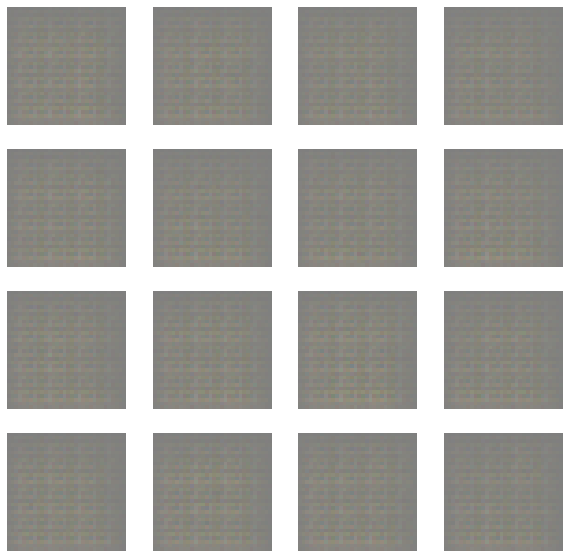

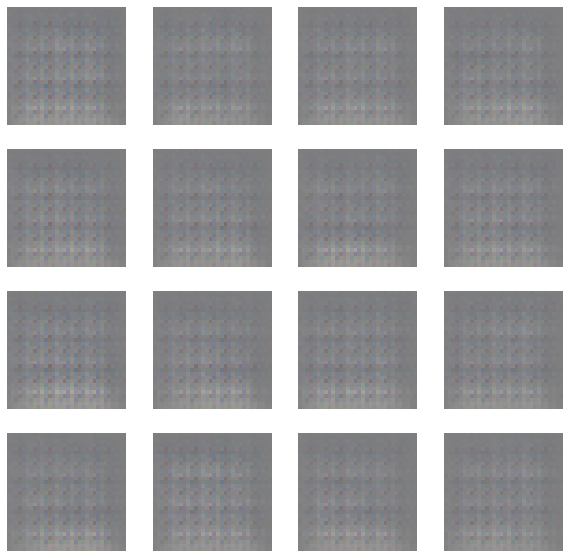

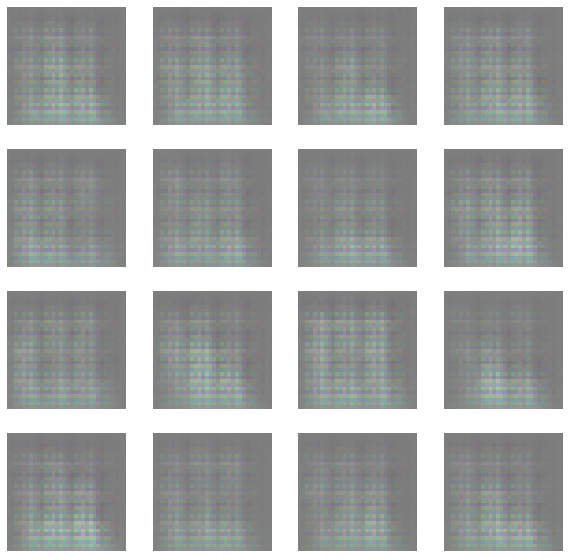

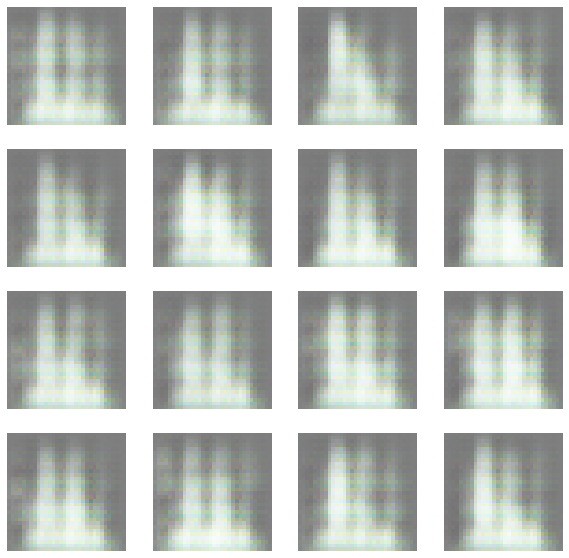

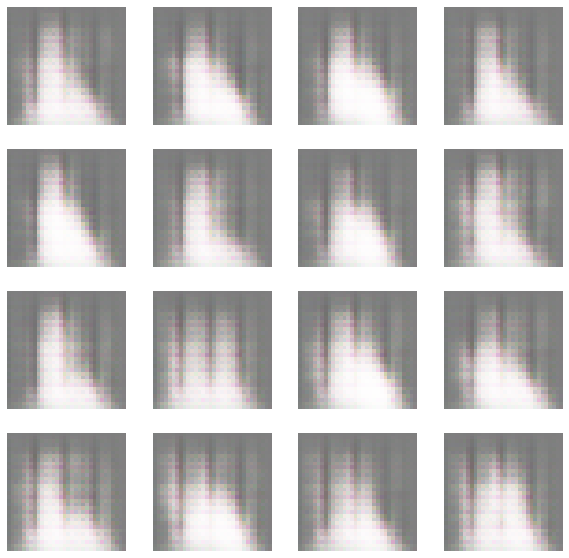

...

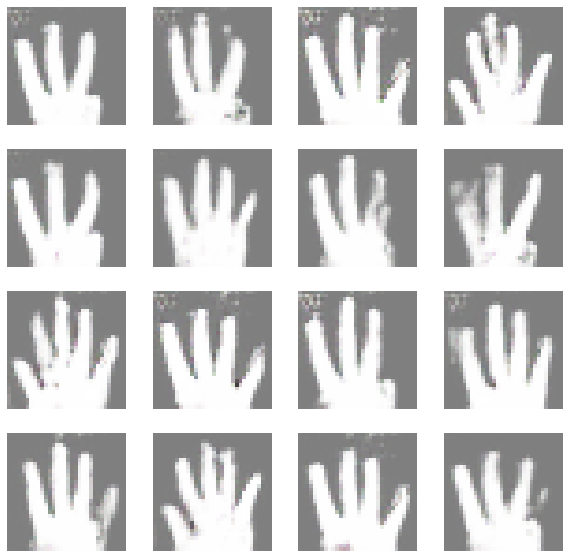

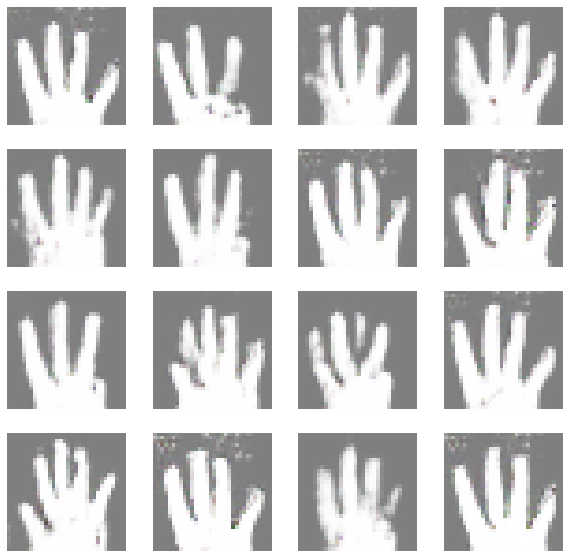

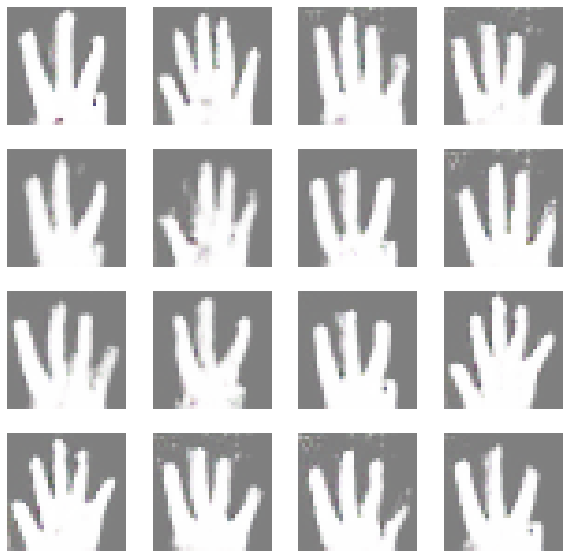

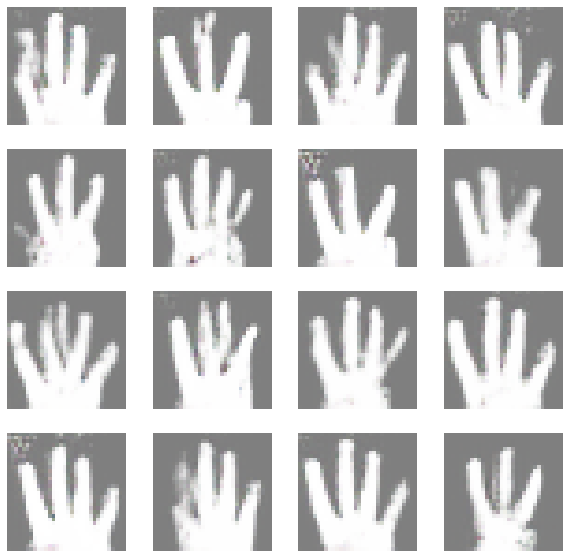

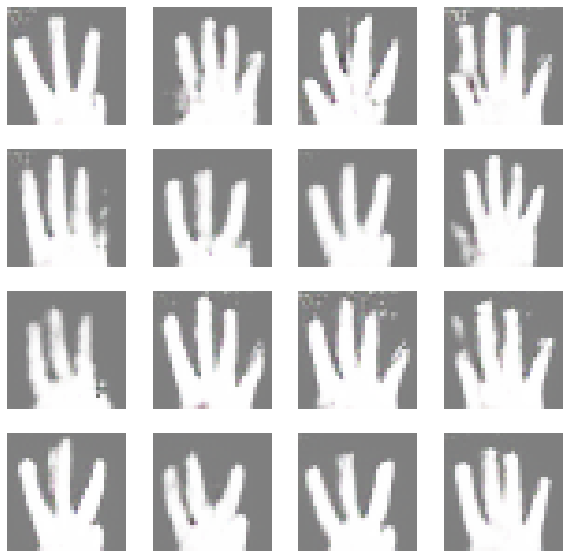

In [14]:
# calculate accuracies for real and fake data    
#real_accuracy = []
#fake_accuracy = []
# size of the latent space
latent_dim = 100
# create the discriminator
d_model = define_discriminator()
# create the generator
g_model = define_generator(latent_dim)
# create the gan
gan_model = define_gan(g_model, d_model)
# load image data
dataset = load_real_samples()
# train model
discriminator_loss, generator_loss, real_accuracy, fake_accuracy = train(g_model, d_model, gan_model, dataset, latent_dim)


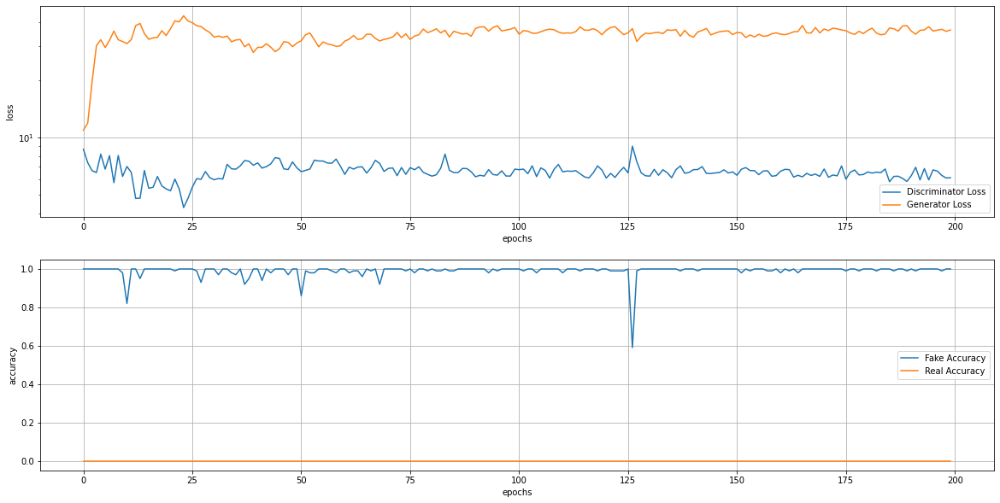

In [16]:
plt.subplots(figsize=(20, 10))

plt.subplot(2, 1, 1)
plt.semilogy(discriminator_loss)
plt.semilogy(generator_loss)

plt.legend(['Discriminator Loss', 'Generator Loss'])
plt.xlabel('epochs')
plt.ylabel('loss')
plt.grid()
plt.subplot(2, 1, 2)
plt.plot(accuracy_fake)
plt.plot(accuracy_real)

plt.legend(['Fake Accuracy', 'Real Accuracy'])
plt.xlabel('epochs')
plt.ylabel('accuracy')
plt.grid()
plt.savefig('Acc_loss.jpg', quality= 60, dpi= 500)
plt.show()

#discriminator and generator models

In [ ]:
def define_discriminator(in_shape=(64,64,3)):
  model = Sequential()
  # normal
  model.add(Conv2D(3, (5,5), padding='same', input_shape=in_shape))
  model.add(LeakyReLU(alpha=0.2))
  model.add(BatchNormalization())
	# downsample
  model.add(Conv2D(128, (5,5), strides=(2,2), padding='same'))
  model.add(LeakyReLU(alpha=0.2))
  model.add(BatchNormalization())
  # downsample
  model.add(Conv2D(256, (5,5), strides=(2,2), padding='same'))
  model.add(LeakyReLU(alpha=0.2))
  model.add(BatchNormalization())
  # downsample
  model.add(Conv2D(512, (5,5), strides=(2,2), padding='same'))
  model.add(LeakyReLU(alpha=0.2))
  model.add(BatchNormalization())
  # downsample
  model.add(Conv2D(1024, (5,5), strides=(2,2), padding='same'))
  model.add(LeakyReLU(alpha=0.2))
  model.add(BatchNormalization())
  # classifier
  model.add(Flatten())
  model.add(Dropout(0.4))
  model.add(Dense(1, activation='sigmoid'))
  # compile model
  opt = Adam(lr=0.0002, beta_1=0.5)
  model.compile(loss='binary_crossentropy', optimizer=opt, metrics=['accuracy'])
  return model

X = define_discriminator()
X.summary()

Model: "sequential_22"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_37 (Conv2D)          (None, 64, 64, 3)         228       
                                                                 
 leaky_re_lu_61 (LeakyReLU)  (None, 64, 64, 3)         0         
                                                                 
 batch_normalization_16 (Bat  (None, 64, 64, 3)        12        
 chNormalization)                                                
                                                                 
 conv2d_38 (Conv2D)          (None, 32, 32, 128)       9728      
                                                                 
 leaky_re_lu_62 (LeakyReLU)  (None, 32, 32, 128)       0         
                                                                 
 batch_normalization_17 (Bat  (None, 32, 32, 128)      512       
 chNormalization)                                    

In [ ]:
# define the standalone generator model
def define_generator(latent_dim):
  model = Sequential()
  # foundation for 4x4 image
  n_nodes = 1024 * 4 * 4
  model.add(Dense(n_nodes, input_dim=latent_dim))
  model.add(Reshape((4, 4, 1024)))
  # upsample to 8x8
  model.add(Conv2DTranspose(512, (5,5), strides=(2,2), activation='relu', padding='same'))
  model.add(BatchNormalization())
  # upsample to 16x16
  model.add(Conv2DTranspose(256, (5,5), strides=(2,2), activation='relu', padding='same'))
  model.add(BatchNormalization())
  # upsample to 32x32
  model.add(Conv2DTranspose(128, (5,5), strides=(2,2), activation='relu', padding='same'))
  model.add(BatchNormalization())
  # upsample to 64x64
  model.add(Conv2DTranspose(3, (5,5), strides=(2,2), activation='relu', padding='same'))
  model.add(BatchNormalization())
  # output layer
  model.add(Conv2D(3, (5,5), activation='tanh', padding='same'))
  model.add(BatchNormalization())
  return model

X = define_generator(100)
X.summary()

Model: "sequential_23"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_19 (Dense)            (None, 16384)             1654784   
                                                                 
 reshape_10 (Reshape)        (None, 4, 4, 1024)        0         
                                                                 
 conv2d_transpose_35 (Conv2D  (None, 8, 8, 512)        13107712  
 Transpose)                                                      
                                                                 
 batch_normalization_21 (Bat  (None, 8, 8, 512)        2048      
 chNormalization)                                                
                                                                 
 conv2d_transpose_36 (Conv2D  (None, 16, 16, 256)      3277056   
 Transpose)                                                      
                                                     